In [1]:
# Simulation relevant stuff
machine = 'mac'
#machine = 'magny'
machine = 'virgo'

if machine == 'magny':
    basedir = "/hits/universe/GigaGalaxy/level4_MHD/"
    filedir = "/home/extmilan/masterthesis/files/"
    plotdir = "/home/extmilan/masterthesis/plots/"
elif machine == 'mac': 
    basedir = "/Users/smilanov/Desktop/Auriga/level4/"
    filedir = "/Users/smilanov/Documents/masterthesis/auriga_files/files/"
    plotdir = "/Users/smilanov/Documents/masterthesis/auriga_files/plots/"
elif machine == 'virgo': 
    basedir = "/virgo/simulations/Auriga/level4_MHD/"
    filedir = "/u/milas/masterthesis/masterproject/files/"
    plotdir = "/u/milas/masterthesis/masterproject/plots/"
    


In [233]:
import sys
sys.path.append("..")
from galpy.potential import NFWPotential as NFWpot
from galpy.potential import HernquistPotential as HEpot
from galpy.potential import DoubleExponentialDiskPotential as DEpot
from galpy.potential import MiyamotoNagaiPotential as MNpot
from galpy.potential import MN3ExponentialDiskPotential as MN3pot
from galpy.potential import MWPotential2014
from galpy.potential import evaluatePotentials, MiyamotoNagaiPotential, NFWPotential, HernquistPotential, plotPotentials, plotDensities, plotRotcurve


from galpy.potential import evaluateDensities, evaluatePotentials
from galpy.potential import plotDensities
from galpy.potential import plotRotcurve
from galpy.util import bovy_conversion

import emcee

import numpy as np

from scipy import optimize as opt
from scipy import integrate

from astropy import units as u
from astropy import constants as const

from IPython.display import display

import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm, SymLogNorm

from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.mplot3d import Axes3D
import copy

from areposnap.gadget import gadget_readsnap
from areposnap.gadget_subfind import load_subfind


import datetime
import random

%matplotlib inline


import matplotlib
from matplotlib import pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import rcParams
import copy

from areposnap.gadget import gadget_readsnap
from areposnap.gadget_subfind import load_subfind

from auriga_basics import *
from decomposition import *
import matplotlib.pyplot as plt

from matplotlib import rcParams
import copy

from scipy import stats

%matplotlib inline

rcParams['font.size'] = 16
rcParams['lines.linewidth'] = 1.5
rcParams['axes.linewidth'] = 1.5
rcParams['ytick.major.width'] = 1.5
rcParams['xtick.major.width'] = 1.5
rcParams['image.cmap'] = 'magma'
rcParams['figure.figsize'] = (6.5,5.)

cmap = copy.copy(plt.cm.get_cmap(rcParams['image.cmap']))
cmap.set_bad((0,0,0))
%config InlineBackend.figure_format = 'retina'

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

Build the potential
---
- Disk: Miyamoto Nagai (http://adsabs.harvard.edu/abs/1975PASJ...27..533M 
- Spheroid: Hernquist (http://adsabs.harvard.edu/abs/1990ApJ...356..359H)
- Halo: NFW (http://iopscience.iop.org/article/10.1086/304888/pdf)

$v_{circ} = \sqrt{R\frac{\partial\Phi}{\partial R}}$

Miyamoto Nagai potential
--

$\Phi_{MN} (R,z) = -\frac{GM}{\sqrt{R^2 + \left(a + \sqrt{z^2 + b^2}\right)^2}}$

$\rho_{MN} (R,z) = \frac{b^2M}{4\pi}
\frac{aR^2 + \left(a + 3\sqrt{z^2 + b^2}\right)\left(a + \sqrt{z^2 + b^2}\right)^2}
{\left[R^2 + \left(a + \sqrt{z^2 + b^2}\right)^2\right]^{5/2}\left(z^2 + b^2\right)^{3/2}}$

$
v_{circ_{MN}}(R,z)     = R \sqrt{
\frac
{ GM }
{ \left(R^2 + \left(a + \sqrt{z^2+b^2}\right)^2\right)^{3/2} }
}
$

Hernquist potential
--
$\Phi_H(r) = -\frac
{GM}
{r+a}
$

$\rho_H(r) = \frac{M}{2\pi}\frac{r}{a}\frac{1}{\left(r+a\right)^3}
$

$M_H(r) = M \frac{r^2}{(r+a)^2}$

$v_{circ_H}(r) = \frac
{\sqrt{GMr} }
{r+a} 
= \sqrt{\frac{GM(<r)}{r}}
$
    last equation part only valid in spherical symmetric systems
    
NFW potential 
--

1. fit MND and HB
2. calculate their circular velocities
3. calculate total velocity and get circular velocity of NFW by subtracting: $v_{circ_{NFW}} = \sqrt{v_{circ_{tot}}^2 - v_{circ_{MND}}^2 - v_{circ_{HB}}^2}$
4. setup galpy potential with fixed MND and HB with fitted vals and just fit NFW parameters to pot vals
5. (possible check: fit also v0 of NFW and compare to 'real' one)



In [195]:
#make all physical output in galpy
mp= MiyamotoNagaiPotential(amp=3*10**10*u.Msun,a = 3.*u.kpc,b=0.5*u.kpc)#, ro = 8. * u.kpc, vo = 150. * u.km/u.s)

v0 =  mp.vcirc(8.*u.kpc) 
print(v0)
print(evaluateDensities(mp, R = 7.*u.kpc, z = 1. * u.kpc)/10.)#*bovy_conversion.dens_in_msolpc3(v0,8.))
print(mp.dens(R=7./8., z=1./8.))#*bovy_conversion.dens_in_msolpc3(v0,8.))

111.365654234
0.000307918375157
0.00307918375157


In [196]:
mp.dens

<bound method Potential.dens of <galpy.potential.MiyamotoNagaiPotential.MiyamotoNagaiPotential object at 0x2b9aa60c2630>>

In [197]:
mass_10Msun = 3
b_kpc = 0.5
a_kpc = 3.
R_kpc= 7.
z_kpc = 1.


first_fac_10Msun_kpc2 = (mass_10Msun * b_kpc**2) / (4. * np.pi) # * 10^10M_sun
bzsqrt_kpc = np.sqrt(z_kpc**2 + b_kpc**2)
abz_sqrt_kpc = (a_kpc + bzsqrt_kpc)
numerator_kpc3 = a_kpc * R_kpc**2 + (a_kpc + 3. * bzsqrt_kpc) * abz_sqrt_kpc**2
denominator_kpc8 = (R_kpc**2 + abz_sqrt_kpc**2)**(5./2.) * bzsqrt_kpc**3
rho_10Msun_kpc_3 = first_fac_10Msun_kpc2 * numerator_kpc3 / denominator_kpc8 # * 10^10 M_sun if not specific density
print(rho_10Msun_kpc_3)

a = a_kpc
b = b_kpc
z = z_kpc
R = R_kpc
b2 = b**2

amp = mass_10Msun
sqrtbz= np.sqrt(b2+z**2.)
asqrtbz= a+sqrtbz

rho_galp = amp/4./np.pi*b2 *((a*R**2.+a+3.*sqrtbz)*asqrtbz**2.)/ (R**2.+asqrtbz**2.)**2.5/sqrtbz**3.
print(rho_galp)

0.000307918375157
0.00314332710711


In [198]:
1/2/3/4*5

0.20833333333333331

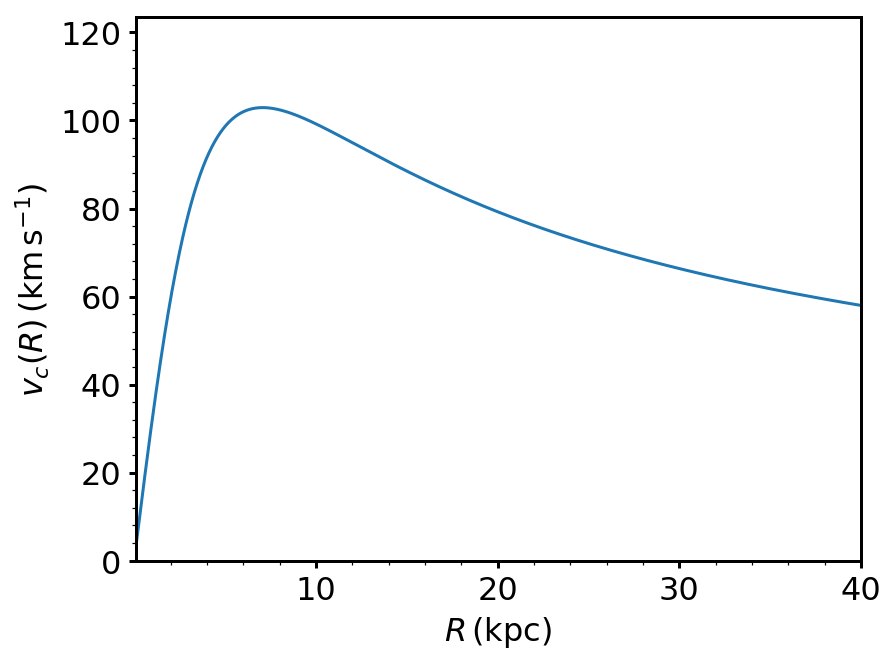

In [127]:
plotRotcurve(mp)

In [113]:
args = (R_kpc_disk, z_kpc_disk, M_disk_10Msun, dR_kpc, dz_kpc, _REFR0_kpc) 
R_kpc_data              = args[0]
z_kpc_data              = args[1]
m_disk_stars_10Msun_arr = args[2]
dR_kpc                  = args[3]
dz_kpc                  = args[4]


rho_10Msun_kpc3, Rbins_kpc, zbins_kpc = disk_dens(R_kpc_data, z_kpc_data, dR_kpc, dz_kpc, m_disk_stars_10Msun_arr)
inbin_R = (Rbins_kpc < 7.3) * (Rbins_kpc > 6.7) 
inbin_z = (zbins_kpc <1.3) * (zbins_kpc >0.7)
rho_data = rho_10Msun_kpc3[inbin_z, inbin_R]
print(rho_data)

[ 0.00059181]


In [285]:
# try disk fit with differential evolution
## PART FOR THE FIT TO THE DENSITY
def disk_dens(R_kpc, z_kpc, dR_kpc, dz_kpc, M_10Msun): 
    
    Rmin_kpc, Rmax_kpc = np.min(R_kpc), np.max(R_kpc)
    zmin_kpc, zmax_kpc = np.min(z_kpc), np.max(z_kpc)
    
    Rbins, zbins = np.arange(Rmin_kpc, Rmax_kpc+ dR_kpc, dR_kpc), np.arange(zmin_kpc, zmax_kpc+dz_kpc, dz_kpc)
    mbins, volbins = np.full((len(zbins), len(Rbins)), np.nan), np.full((len(zbins), len(Rbins)), np.nan) 
    for i in range(len(zbins)):
        for j in range(len(Rbins)):
            inbin = (Rbins[j] <= R_kpc) & (R_kpc < (Rbins[j] + dR_kpc)) & (zbins[i] <= z_kpc) & (z_kpc < (zbins[i] + dz_kpc))
            if np.sum(inbin) == 0:
                mbins[i,j] = np.nan
                volbins[i,j] = np.nan
            else:
                mbins[i,j] = np.sum(M_10Msun[inbin])
                volbins[i,j] = np.pi * dz_kpc * (2. * Rbins[j] * dR_kpc + dR_kpc**2)

    rho = mbins / volbins
    return(rho, Rbins, zbins)  

def rel_rho_error_scipydifferentialevolution(x,*args):
    
    # read fitting parameters:
    a_MND_kpc = x[0]
    b_MND_kpc = x[1]
        
    # read data:
    
    R_kpc_data              = args[0]
    z_kpc_data              = args[1]
    m_disk_stars_10Msun_arr = args[2]
    dR_kpc                  = args[3]
    dz_kpc                  = args[4]
    _REFR0_kpc              = args[5]
    
    # calculate data 
    
    rho_10Msun_kpc3, Rbins_kpc, zbins_kpc = disk_dens(R_kpc_data, z_kpc_data, dR_kpc, dz_kpc, m_disk_stars_10Msun_arr)
    disk_mass_10Msun = np.sum(m_disk_stars_10Msun_arr)

    vcirc_data = np.sqrt(const.G * disk_mass_10Msun * 1e10 * u.Msun / (_REFR0_kpc * u.kpc))
    vcirc_data = vcirc_data.to(u.km/u.s)
    vcirc_data = vcirc_data.value
    # setup potential (and check if parameters are physical):
    try:
        disk_pot_galpy_model = MiyamotoNagaiPotential(amp = disk_mass_10Msun*10**10*u.Msun, a = a_MND_kpc * u.kpc, b = b_MND_kpc * u.kpc)
    except Exception as e:
        return np.inf

    rho_model_Msun_pc3 = np.full((len(zbins_kpc), len(Rbins_kpc)), np.nan) 
    for iz in range(len(zbins_kpc)):
        for jR in range(len(Rbins_kpc)):
            rho_model_Msun_pc3[iz,jR] = evaluateDensities(disk_pot_galpy_model, R = Rbins_kpc[jR] * u.kpc, z = zbins_kpc[iz] * u.kpc) 

    rho_model_10Msun_kpc3 = rho_model_Msun_pc3 / 10.
    print(np.shape(rho_model_10Msun_kpc3))
    print('a and b: {}, {}'.format(a_MND_kpc, b_MND_kpc))
    #calculate sum of relative error squares:
    print('Rho mean galpy: {}'.format(np.mean(rho_model_10Msun_kpc3)))
    print('Rho mean data: {}'.format(np.mean(rho_10Msun_kpc3[np.isfinite(rho_10Msun_kpc3)])))
    
    # check for circular velocity
    vcirc8 = disk_pot_galpy_model.vcirc(_REFR0_kpc*u.kpc)
    print(vcirc8, vcirc_data)
    vcirc_err = (vcirc8-vcirc_data) / vcirc_data
    vcirc_err_squares = ((vcirc8-vcirc_data) / vcirc_data)**2
    print('Circular velocity ar R=8kpc: {} km/s and its error compared to the data: {} km/s'.format(vcirc8, vcirc_err))   
    print('Multiply rho error with {}'.format(vcirc_err_squares))
    errors = ((rho_model_10Msun_kpc3 - rho_10Msun_kpc3) / rho_10Msun_kpc3)
    #errors = errors[np.isfinite(errors)]
    error_squares = ((rho_model_10Msun_kpc3 - rho_10Msun_kpc3) / (rho_10Msun_kpc3*rho_model_10Msun_kpc3))**2
    #abs_err = np.abs(rho_model_10Msun_kpc3 - rho_10Msun_kpc3)
    #err = np.sum(error_squares[np.isfinite(abs_err)])
    for iz, zval in enumerate(zbins_kpc):
        for jR in range(len(Rbins_kpc)):
            if np.abs(zval) <= 2.:
                error_squares[iz, jR] = np.where( np.abs(errors[iz, jR])<2., error_squares[iz, jR], np.nan)
    #error_squares = error_squares[(np.abs(errors)<2.)]
    err = np.sum(error_squares[np.isfinite(error_squares)]) 
    err_w_vcirc = err * vcirc_err_squares
    print('Error: {}'.format(err))
    print('Error multiplied by vcirc error: {}'.format(err_w_vcirc))
    

    
    
    # plot results 
    z_fit_max = np.abs(rho_model_10Msun_kpc3).max()
    z_max = np.abs(rho_10Msun_kpc3[np.isfinite(rho_10Msun_kpc3)]).max()
    
    if z_max > z_fit_max:
        zmax = z_max
    else:
        zmax = z_fit_max
    zmin = 1e-8
    print('data max: {}, fit max: {}, chosen max: {}'.format(z_max, z_fit_max, zmax))

    fig, axes = plt.subplots(1,3, figsize = (13,5))#, sharey= True)
    axes[0].set_title("data")
    im0 = axes[0].imshow(rho_10Msun_kpc3, vmin = zmin, vmax = zmax, norm=LogNorm(), cmap=cmap)
    #axes[0].axis('equal')
    cbar0 = plt.colorbar(im0, ax= axes[0])
    im0.cmap.set_under('black')
    #axes[0].set_ylabel('z [kpc]')
    #axes[0].set_xlabel('R [kpc]')
    

    axes[1].set_title("fit")
    im1 = axes[1].imshow(rho_model_10Msun_kpc3, vmin = zmin, vmax = zmax, norm=LogNorm(), cmap=cmap)
    im1.cmap.set_under('black')
    #axes[1].axis('equal')
    cbar1 = plt.colorbar(im1, ax = axes[1])
    cbar1.set_label('$\\rho\ [10^{10} \mathrm{M}_\odot \mathrm{kpc}^{-3}]$')
    #axes[1].set_xlabel('R [kpc]')
    
    axes[2].set_title("relative errors")
    im2 = axes[2].imshow(errors, vmin = -2, vmax = 2, cmap=plt.cm.RdBu_r)
    im2.cmap.set_under('black')
    #axes[2].axis('equal')
    cbar2 = plt.colorbar(im2, ax = axes[2])
    cbar2.set_label('$\Delta \\rho$')
    #axes[2].set_xlabel('R [kpc]')
    
    fig.tight_layout()
    #fig.savefig(plotdir + '/potential/MND_best_fit_snap_{}.png'.format(snapnr), format = 'png', dpi = 300, bbox_inches = 'tight')
    plt.show()

    return err_w_vcirc




(21, 49)
a and b: 9.555996857580801, 3.609140499007257
Rho mean galpy: 0.00011447325246136126
Rho mean data: 0.00033879189738258395
43.8311992085 117.1251829752916
Circular velocity ar R=8kpc: 43.83119920846145 km/s and its error compared to the data: -0.6257747642732993 km/s
Multiply rho error with 0.3915940556013032
Error: 83969939165774.34
Error multiplied by vcirc error: 32882129026520.29
data max: 0.019812705986395618, fit max: 0.0005024510419715715, chosen max: 0.019812705986395618
/u/milas/conda-envs/auriga/lib/python3.6/site-packages/matplotlib/colors.py:929: RuntimeWarning: invalid value encountered in less_equal
  mask |= resdat <= 0



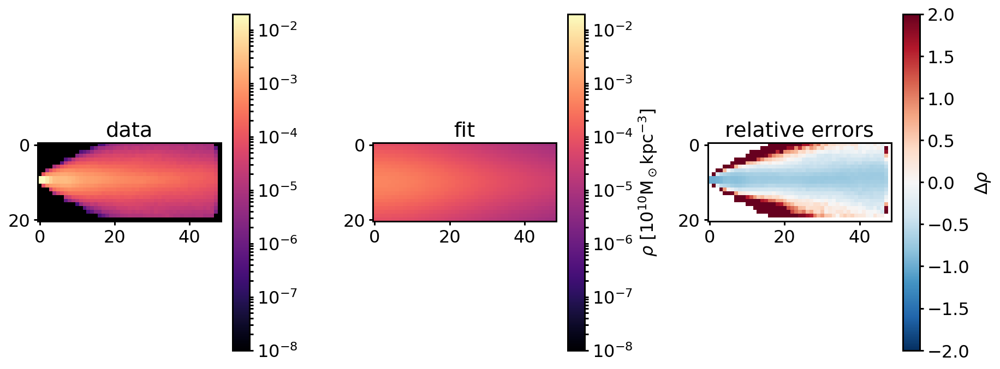

(21, 49)
a and b: 7.281003636613052, 4.301189454451629
Rho mean galpy: 0.00013435833148834863
Rho mean data: 0.00033879189738258395
50.1815779278 117.1251829752916
Circular velocity ar R=8kpc: 50.18157792776451 km/s and its error compared to the data: -0.5715560338689019 km/s
Multiply rho error with 0.3266762998519493
Error: 84306707626877.75
Error multiplied by vcirc error: 27541003300248.535
data max: 0.019812705986395618, fit max: 0.0006130712504817005, chosen max: 0.019812705986395618


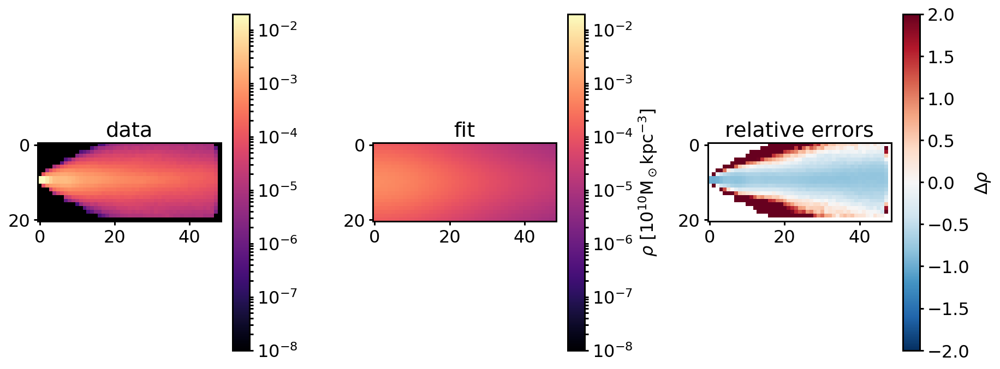

(21, 49)
a and b: 7.999844205146043, 2.9019818989673603
Rho mean galpy: 0.0001491368148533918
Rho mean data: 0.00033879189738258395
53.2984247496 117.1251829752916
Circular velocity ar R=8kpc: 53.298424749610284 km/s and its error compared to the data: -0.5449447898761962 km/s
Multiply rho error with 0.2969648240132116
Error: 83838885476527.1
Error multiplied by vcirc error: 24897199871000.67
data max: 0.019812705986395618, fit max: 0.0009018116453301912, chosen max: 0.019812705986395618


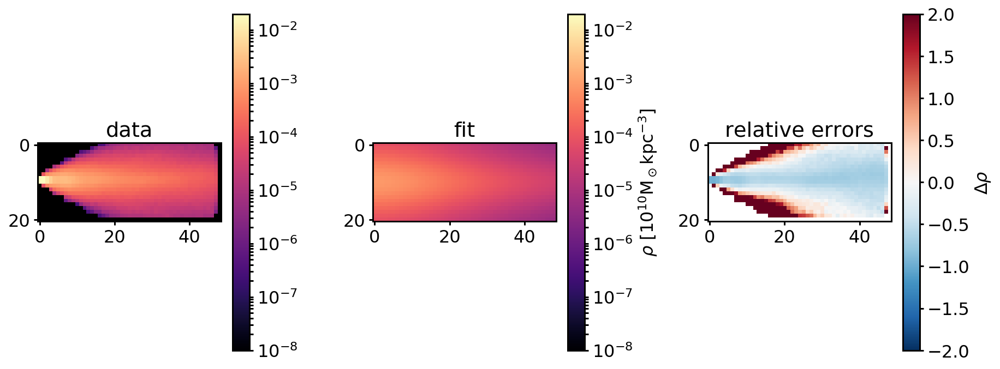

(21, 49)
a and b: 5.782463671082977, 4.486555964681105
Rho mean galpy: 0.00015784243257189638
Rho mean data: 0.00033879189738258395
56.4285342466 117.1251829752916
Circular velocity ar R=8kpc: 56.428534246578124 km/s and its error compared to the data: -0.5182203108405634 km/s
Multiply rho error with 0.26855229056769014
Error: 84425575395958.72
Error multiplied by vcirc error: 22672681655079.938
data max: 0.019812705986395618, fit max: 0.0008038111743362949, chosen max: 0.019812705986395618


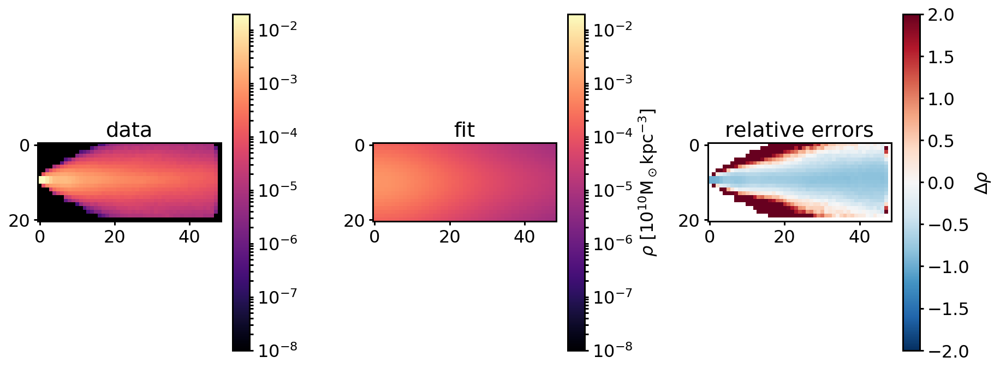

(21, 49)
a and b: 2.883849809867378, 1.9760185563291488
Rho mean galpy: 0.00040704799829796513
Rho mean data: 0.00033879189738258395
92.5420401457 117.1251829752916
Circular velocity ar R=8kpc: 92.54204014573078 km/s and its error compared to the data: -0.20988776457021036 km/s
Multiply rho error with 0.04405287371628005
Error: 88701572067629.02
Error multiplied by vcirc error: 3907559152730.775
data max: 0.019812705986395618, fit max: 0.00787155858076976, chosen max: 0.019812705986395618


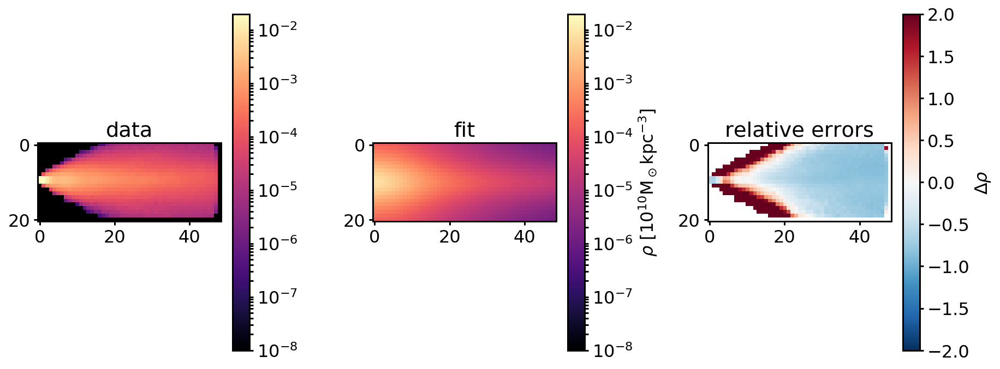

(21, 49)
a and b: 4.881686615560215, 1.394710182527348
Rho mean galpy: 0.00028681940316868914
Rho mean data: 0.00033879189738258395
81.7365713938 117.1251829752916
Circular velocity ar R=8kpc: 81.73657139384194 km/s and its error compared to the data: -0.3021434902596066 km/s
Multiply rho error with 0.09129068870625698
Error: 91005261836576.08
Error multiplied by vcirc error: 8307933028954.275
data max: 0.019812705986395618, fit max: 0.005331990381235583, chosen max: 0.019812705986395618


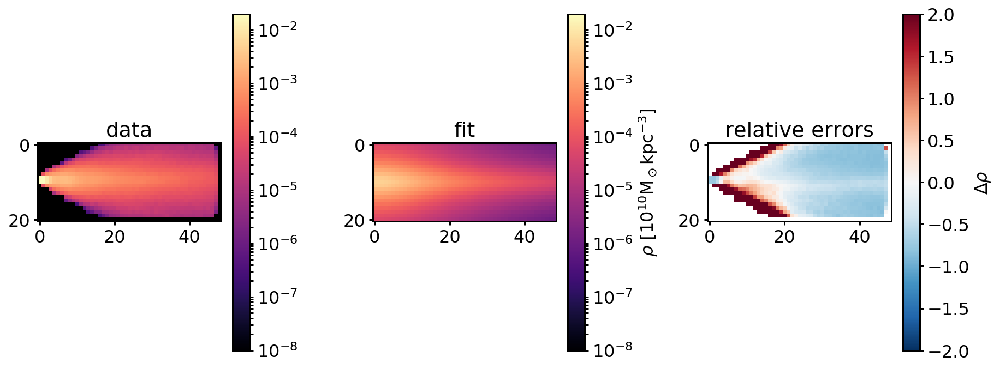

(21, 49)
a and b: 4.45327379746734, 3.8068168046655693
Rho mean galpy: 0.00021394620508888136
Rho mean data: 0.00033879189738258395
67.9657305426 117.1251829752916
Circular velocity ar R=8kpc: 67.9657305425735 km/s and its error compared to the data: -0.41971718791755175 km/s
Multiply rho error with 0.17616251783341744
Error: 84414916337802.66
Error multiplied by vcirc error: 14870744204764.602
data max: 0.019812705986395618, fit max: 0.0015012083232720937, chosen max: 0.019812705986395618


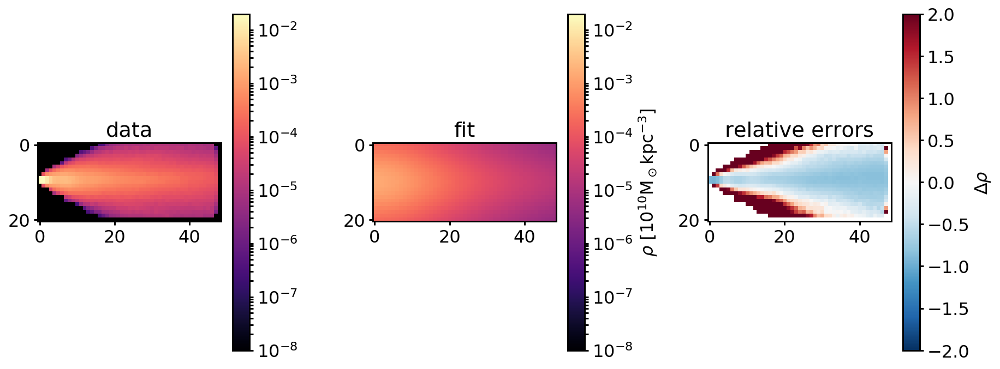

(21, 49)
a and b: 2.0796458298947376, 3.8949953829890416
Rho mean galpy: 0.0003297518778818748
Rho mean data: 0.00033879189738258395
83.9993372189 117.1251829752916
Circular velocity ar R=8kpc: 83.99933721889379 km/s and its error compared to the data: -0.28282428180612484 km/s
Multiply rho error with 0.07998957437915032
Error: 85527088118058.22
Error multiplied by vcirc error: 6841275376451.562
data max: 0.019812705986395618, fit max: 0.003359324698011917, chosen max: 0.019812705986395618


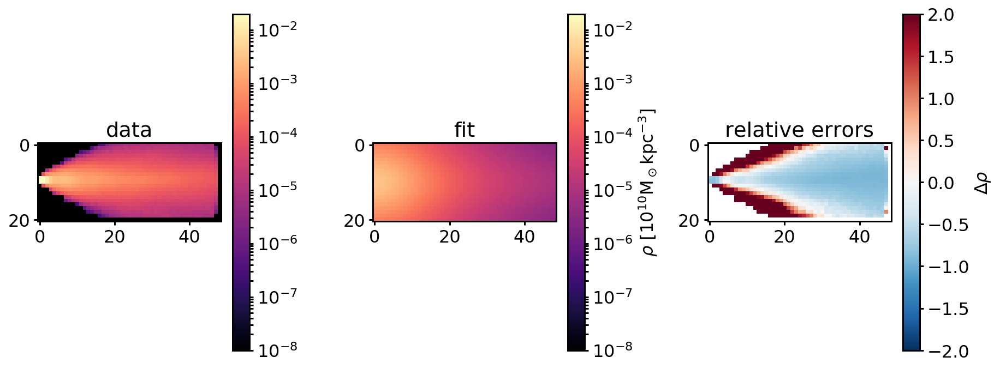

(21, 49)
a and b: 8.948888425241686, 2.7769990584492334
Rho mean galpy: 0.00013552800391367843
Rho mean data: 0.00033879189738258395
49.5546866281 117.1251829752916
Circular velocity ar R=8kpc: 49.55468662814024 km/s and its error compared to the data: -0.5769083525052494 km/s
Multiply rho error with 0.33282324719032114
Error: 83675542952922.12
Error multiplied by vcirc error: 27849165916004.734
data max: 0.019812705986395618, fit max: 0.0007834231279231614, chosen max: 0.019812705986395618


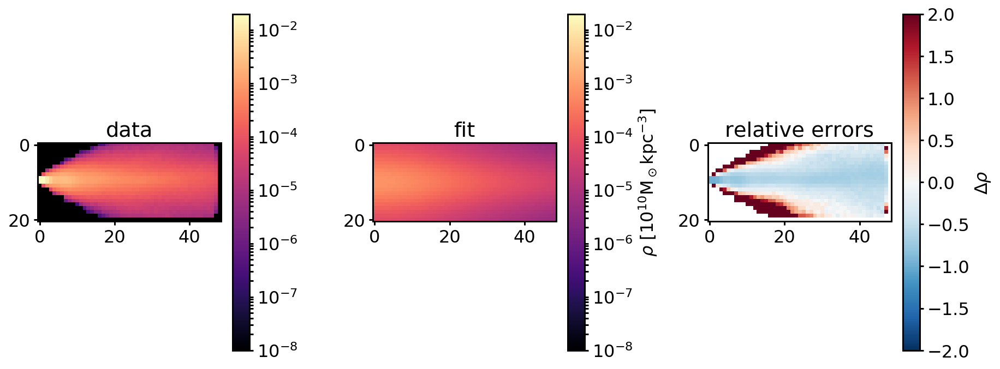

(21, 49)
a and b: 3.6882756318433456, 2.614297478361204
Rho mean galpy: 0.00030134066514282817
Rho mean data: 0.00033879189738258395
81.5418870291 117.1251829752916
Circular velocity ar R=8kpc: 81.54188702905581 km/s and its error compared to the data: -0.30380568074538106 km/s
Multiply rho error with 0.0922978916531644
Error: 84740422782177.88
Error multiplied by vcirc error: 7821362360592.798
data max: 0.019812705986395618, fit max: 0.003572801264584189, chosen max: 0.019812705986395618


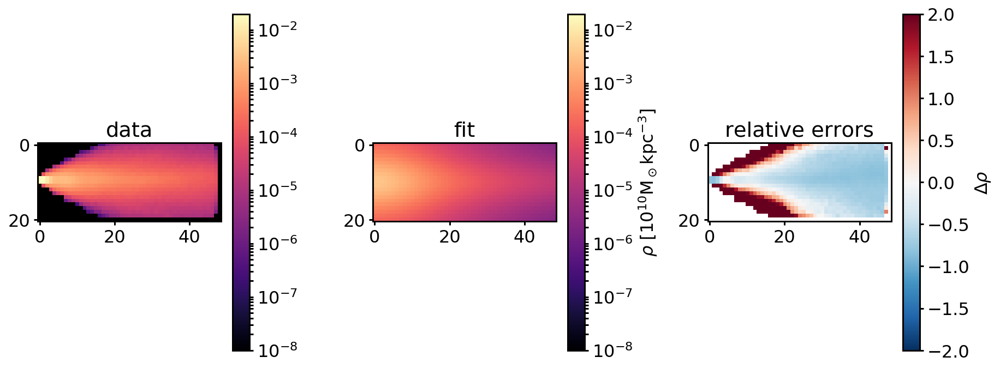

(21, 49)
a and b: 8.020157267166482, 1.726179161520416
Rho mean galpy: 0.00017009965798065114
Rho mean data: 0.00033879189738258395
59.1910039253 117.1251829752916
Circular velocity ar R=8kpc: 59.191003925337334 km/s and its error compared to the data: -0.49463469407920496 km/s
Multiply rho error with 0.24466348058682869
Error: 83807784333151.25
Error multiplied by vcirc error: 20504704215219.074
data max: 0.019812705986395618, fit max: 0.0016762222249179985, chosen max: 0.019812705986395618


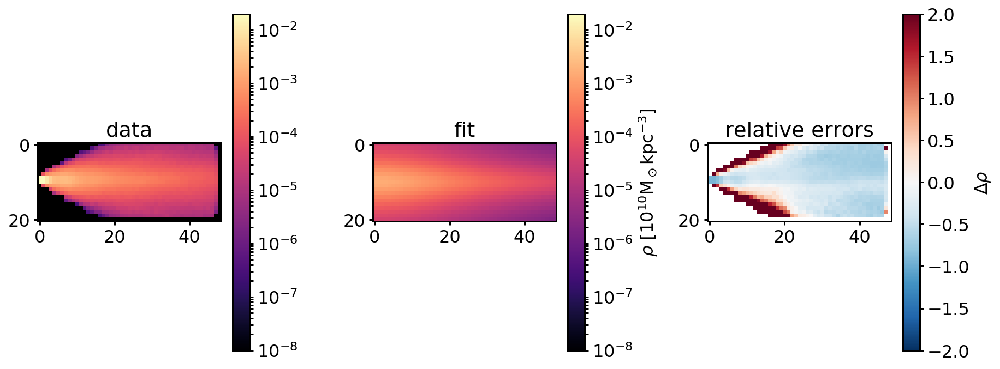

(21, 49)
a and b: 4.018530626824805, 2.082481443612984
Rho mean galpy: 0.00030820563279704315
Rho mean data: 0.00033879189738258395
83.0477664213 117.1251829752916
Circular velocity ar R=8kpc: 83.04776642133841 km/s and its error compared to the data: -0.2909486729351967 km/s
Multiply rho error with 0.08465113028275208
Error: 85453713375412.4
Error multiplied by vcirc error: 7233753424086.989
data max: 0.019812705986395618, fit max: 0.004401889794872406, chosen max: 0.019812705986395618


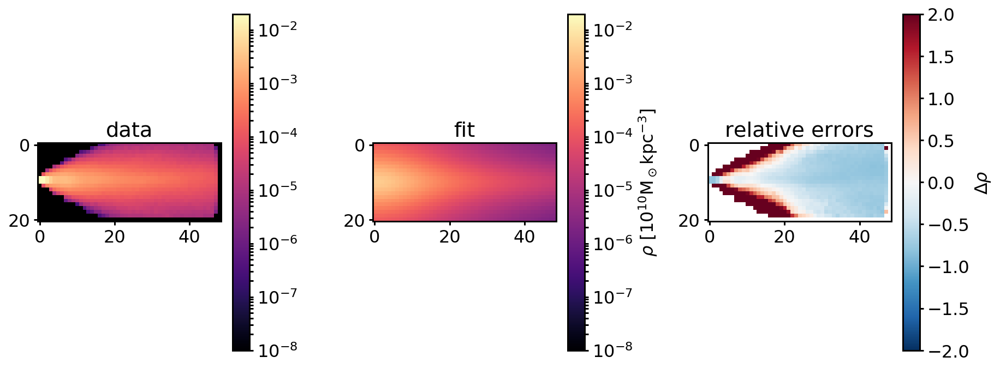

(21, 49)
a and b: 9.278867501065829, 0.32980530549484754
Rho mean galpy: 0.0001742648429566938
Rho mean data: 0.00033879189738258395
59.946056052 117.1251829752916
Circular velocity ar R=8kpc: 59.9460560520067 km/s and its error compared to the data: -0.4881881545094127 km/s
Multiply rho error with 0.23832767420330622
Error: 1970987711151386.0
Error multiplied by vcirc error: 469740917082007.75
data max: 0.019812705986395618, fit max: 0.007123391687249311, chosen max: 0.019812705986395618


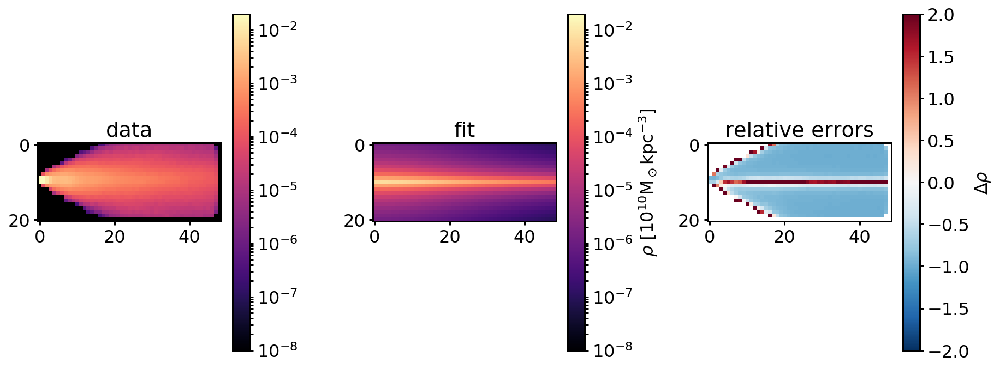

(21, 49)
a and b: 4.379617520425708, 4.512552921151464
Rho mean galpy: 0.00019205626617349106
Rho mean data: 0.00033879189738258395
64.0652090087 117.1251829752916
Circular velocity ar R=8kpc: 64.06520900869396 km/s and its error compared to the data: -0.4530193474941339 km/s
Multiply rho error with 0.20522652920401085
Error: 84533617740759.88
Error multiplied by vcirc error: 17348540969994.746
data max: 0.019812705986395618, fit max: 0.0011459003694464585, chosen max: 0.019812705986395618


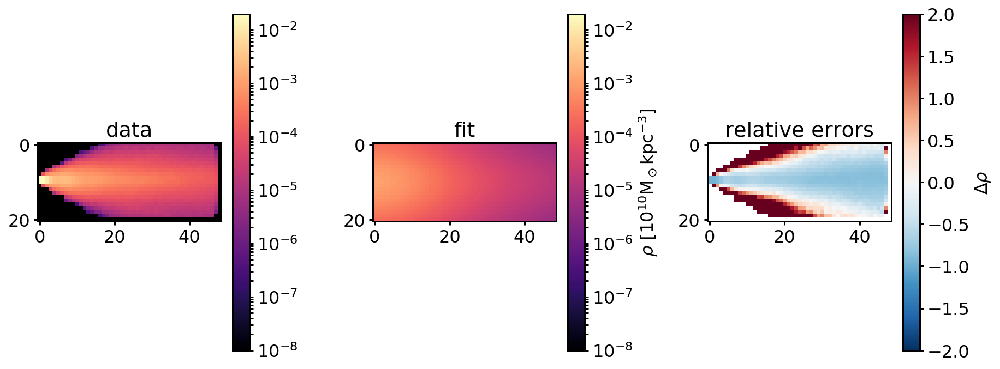

(21, 49)
a and b: 0.15429294788824865, 0.5831774943713857
Rho mean galpy: 0.0037452318969445142
Rho mean data: 0.00033879189738258395
116.384206132 117.1251829752916
Circular velocity ar R=8kpc: 116.38420613192858 km/s and its error compared to the data: -0.006326366580954066 km/s
Multiply rho error with 4.002291411661244e-05
Error: 3.0544902972289696e+16
Error multiplied by vcirc error: 1222496028360.2104
data max: 0.019812705986395618, fit max: 1.4880192574152882, chosen max: 1.4880192574152882


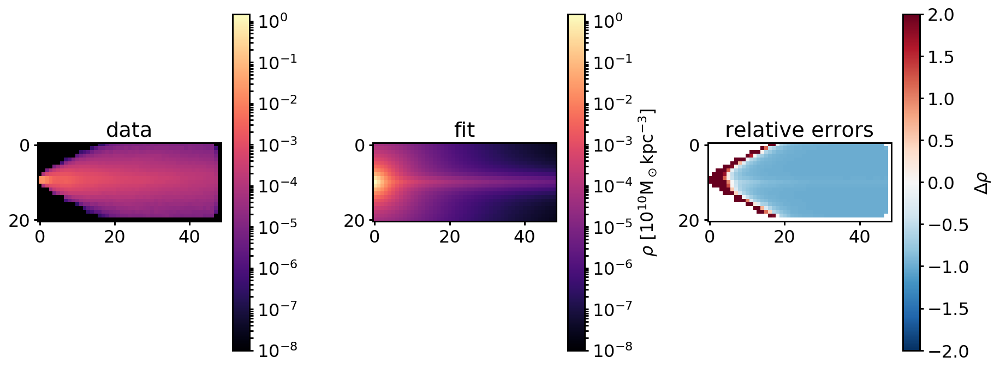

(21, 49)
a and b: 1.0007868140687215, 3.4125626567435363
Rho mean galpy: 0.0004910293132471304
Rho mean data: 0.00033879189738258395
95.9638333812 117.1251829752916
Circular velocity ar R=8kpc: 95.96383338122168 km/s and its error compared to the data: -0.18067292666286855 km/s
Multiply rho error with 0.03264270642892628
Error: 91311455878634.12
Error multiplied by vcirc error: 2980653047844.1084
data max: 0.019812705986395618, fit max: 0.0077561146898106085, chosen max: 0.019812705986395618


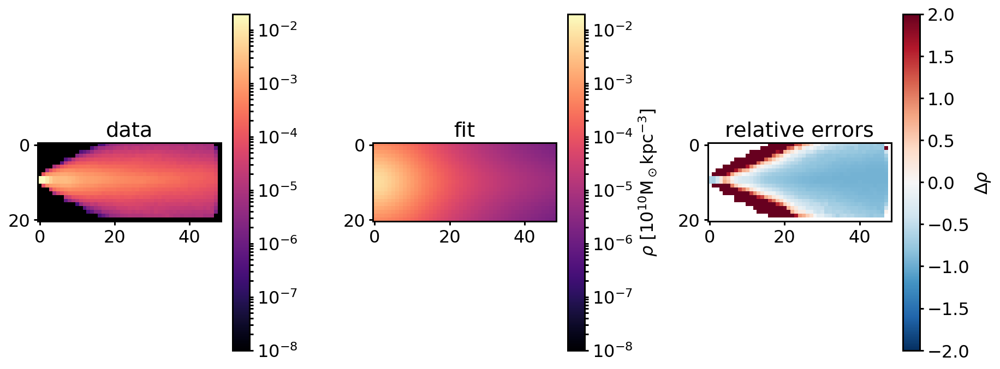

(21, 49)
a and b: 6.965746194193525, 3.3171131986786664
Rho mean galpy: 0.00016062703027599066
Rho mean data: 0.00033879189738258395
56.3576003148 117.1251829752916
Circular velocity ar R=8kpc: 56.357600314784015 km/s and its error compared to the data: -0.5188259357795577 km/s
Multiply rho error with 0.26918035163753373
Error: 84087108393286.66
Error multiplied by vcirc error: 22634597405488.316
data max: 0.019812705986395618, fit max: 0.0009519981014183273, chosen max: 0.019812705986395618


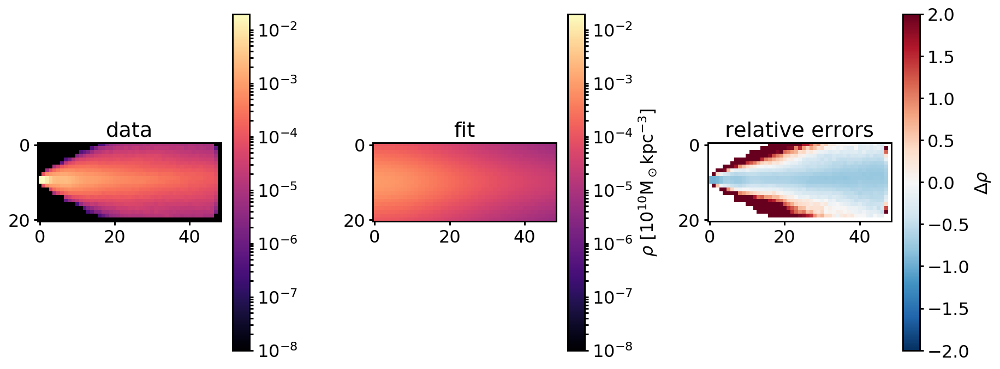

(21, 49)
a and b: 2.4660519144240247, 2.3556024206519575
Rho mean galpy: 0.00041978570763230615
Rho mean data: 0.00033879189738258395
92.8361975433 117.1251829752916
Circular velocity ar R=8kpc: 92.83619754334538 km/s and its error compared to the data: -0.20737628591000923 km/s
Multiply rho error with 0.04300492395782989
Error: 87380792673335.62
Error multiplied by vcirc error: 3757804344291.6978
data max: 0.019812705986395618, fit max: 0.007313784559804764, chosen max: 0.019812705986395618


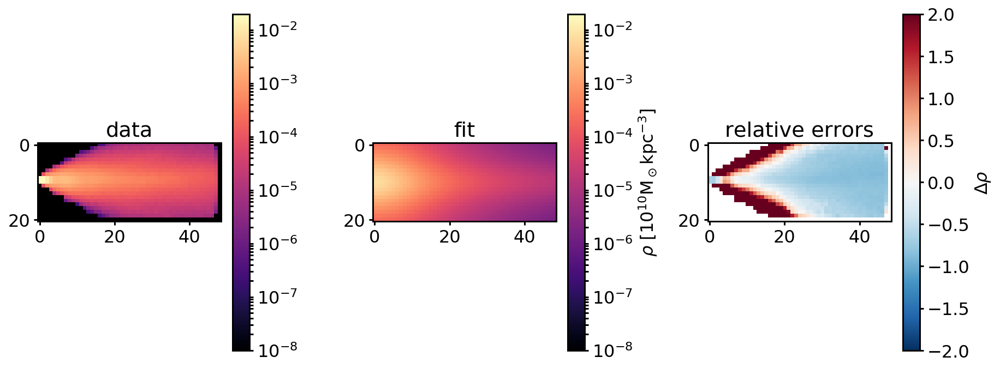

(21, 49)
a and b: 6.294551949156033, 4.893439898332792
Rho mean galpy: 0.00013880232990201826
Rho mean data: 0.00033879189738258395
51.9569997579 117.1251829752916
Circular velocity ar R=8kpc: 51.95699975789966 km/s and its error compared to the data: -0.5563977068120324 km/s
Multiply rho error with 0.3095784081456883
Error: 84448380494550.05
Error multiplied by vcirc error: 26143395203984.2
data max: 0.019812705986395618, fit max: 0.0006212464856908071, chosen max: 0.019812705986395618


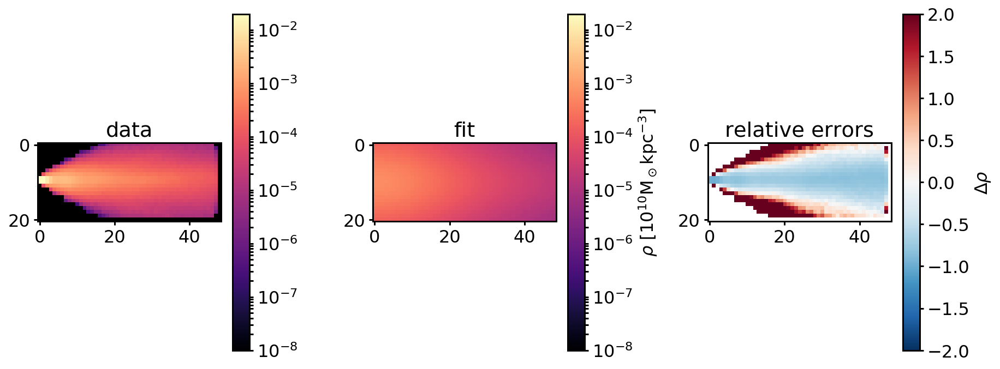

(21, 49)
a and b: 3.35802072792631, 1.1242559840340332
Rho mean galpy: 0.0004193411164735673
Rho mean data: 0.00033879189738258395
95.4385609294 117.1251829752916
Circular velocity ar R=8kpc: 95.43856092942895 km/s and its error compared to the data: -0.1851576364276639 km/s
Multiply rho error with 0.034283350327478965
Error: 125391622461067.34
Error multiplied by vcirc error: 4298844920963.752
data max: 0.019812705986395618, fit max: 0.013467298269764399, chosen max: 0.019812705986395618


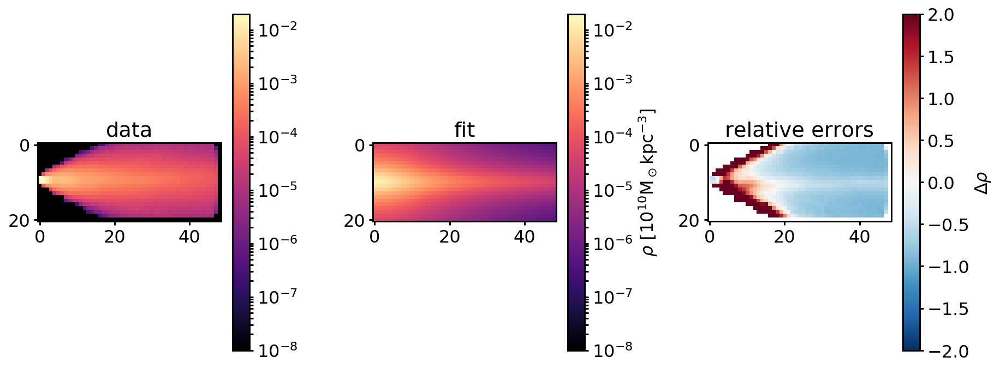

(21, 49)
a and b: 1.3051690852464093, 4.780863953048826
Rho mean galpy: 0.00032200827339752135
Rho mean data: 0.00033879189738258395
83.1602737734 117.1251829752916
Circular velocity ar R=8kpc: 83.16027377336118 km/s and its error compared to the data: -0.28998809939187503 km/s
Multiply rho error with 0.084093097788912
Error: 86726405986388.66
Error multiplied by vcirc error: 7293092139494.264
data max: 0.019812705986395618, fit max: 0.002943598500272924, chosen max: 0.019812705986395618


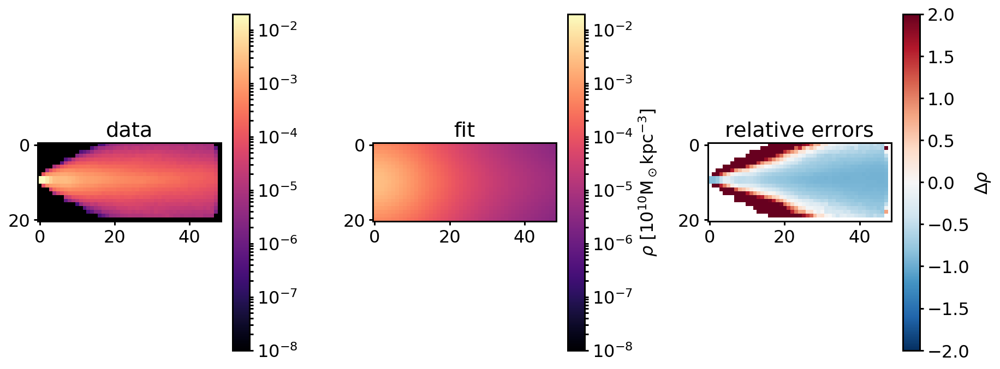

(21, 49)
a and b: 7.517282193199649, 3.041434612417878
Rho mean galpy: 0.00015543881768068145
Rho mean data: 0.00033879189738258395
54.9670560665 117.1251829752916
Circular velocity ar R=8kpc: 54.96705606649184 km/s and its error compared to the data: -0.5306982267162175 km/s
Multiply rho error with 0.28164060783973777
Error: 83943256522083.48
Error multiplied by vcirc error: 23641829790926.625
data max: 0.019812705986395618, fit max: 0.0009434301518878769, chosen max: 0.019812705986395618


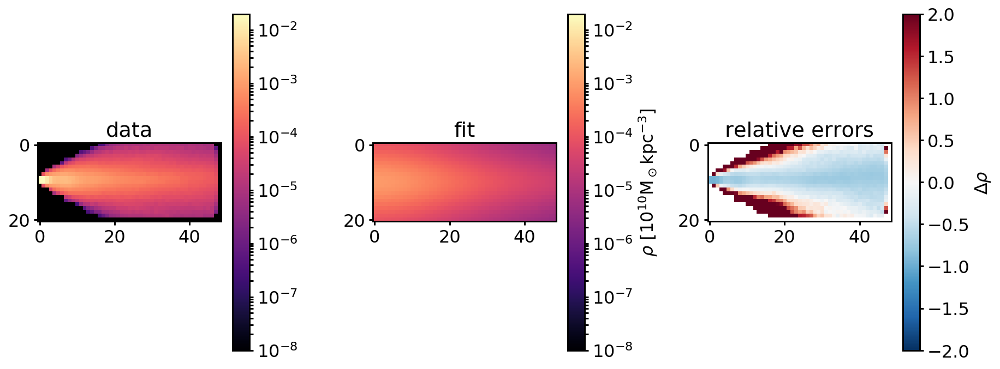

(21, 49)
a and b: 8.529011220838996, 1.7746081945444323
Rho mean galpy: 0.00015883277984721613
Rho mean data: 0.00033879189738258395
56.2514085196 117.1251829752916
Circular velocity ar R=8kpc: 56.2514085196396 km/s and its error compared to the data: -0.5197325878969492 km/s
Multiply rho error with 0.27012196292206003
Error: 83535845587756.6
Error multiplied by vcirc error: 22564866584518.918
data max: 0.019812705986395618, fit max: 0.0014484390644928522, chosen max: 0.019812705986395618


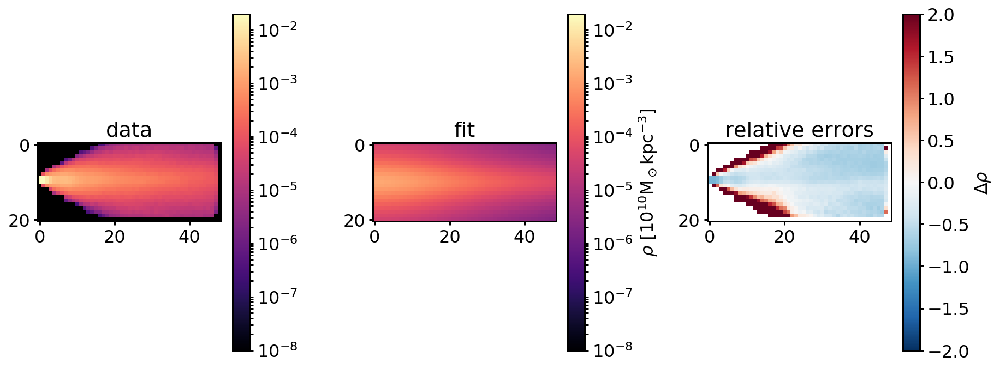

(21, 49)
a and b: 1.6843706523836195, 0.2623607737350828
Rho mean galpy: 0.0011380447374990568
Rho mean data: 0.00033879189738258395
112.179157755 117.1251829752916
Circular velocity ar R=8kpc: 112.17915775509526 km/s and its error compared to the data: -0.04222853783067074 km/s
Multiply rho error with 0.0017832494073163896
Error: 4.84156682753066e+16
Error multiplied by vcirc error: 86337211756767.42
data max: 0.019812705986395618, fit max: 0.256294187883289, chosen max: 0.256294187883289


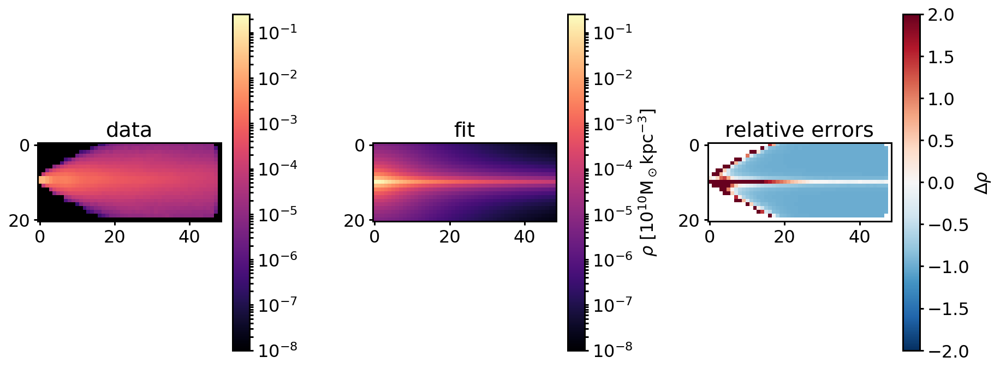

(21, 49)
a and b: 0.7062737139254986, 1.5312495234193841
Rho mean galpy: 0.001045079692048434
Rho mean data: 0.00033879189738258395
110.692377131 117.1251829752916
Circular velocity ar R=8kpc: 110.6923771308292 km/s and its error compared to the data: -0.054922482774856715 km/s
Multiply rho error with 0.0030164791141544327
Error: 242700516560780.78
Error multiplied by vcirc error: 732101039200.0873
data max: 0.019812705986395618, fit max: 0.062030308403512244, chosen max: 0.062030308403512244


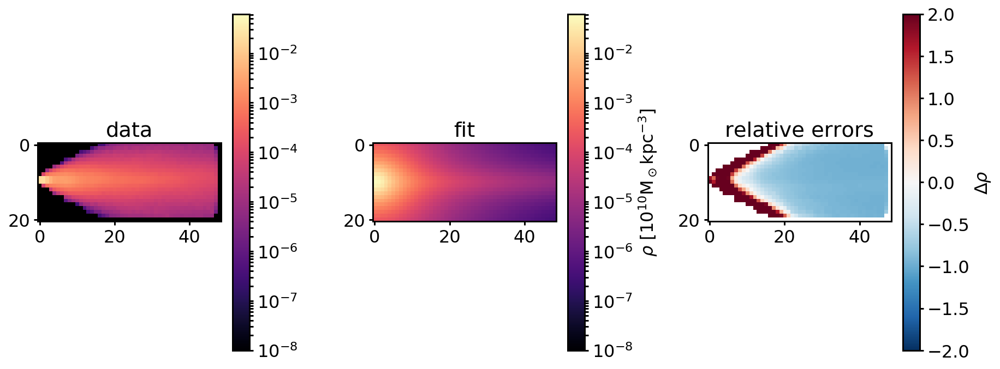

(21, 49)
a and b: 2.240586776951381, 0.6452087393131127
Rho mean galpy: 0.0006611616626923151
Rho mean data: 0.00033879189738258395
106.857805347 117.1251829752916
Circular velocity ar R=8kpc: 106.85780534701657 km/s and its error compared to the data: -0.08766157172570656 km/s
Multiply rho error with 0.007684551157421195
Error: 916889260166741.9
Error multiplied by vcirc error: 7045882425441.399
data max: 0.019812705986395618, fit max: 0.054379673125686125, chosen max: 0.054379673125686125


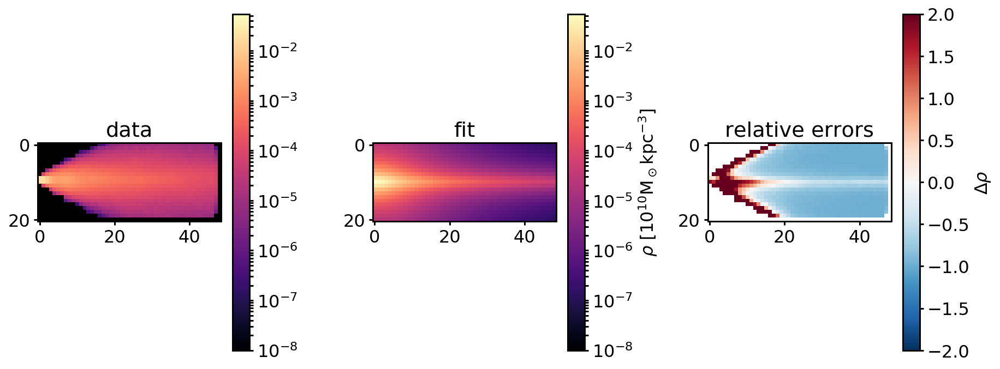

(21, 49)
a and b: 5.321398486906492, 0.9724107584200505
Rho mean galpy: 0.0002769052789348419
Rho mean data: 0.00033879189738258395
81.6070371923 117.1251829752916
Circular velocity ar R=8kpc: 81.60703719229534 km/s and its error compared to the data: -0.3032494368908612 km/s
Multiply rho error with 0.0919602209746244
Error: 118356844024682.36
Error multiplied by vcirc error: 10884121530368.943
data max: 0.019812705986395618, fit max: 0.006892762754918244, chosen max: 0.019812705986395618


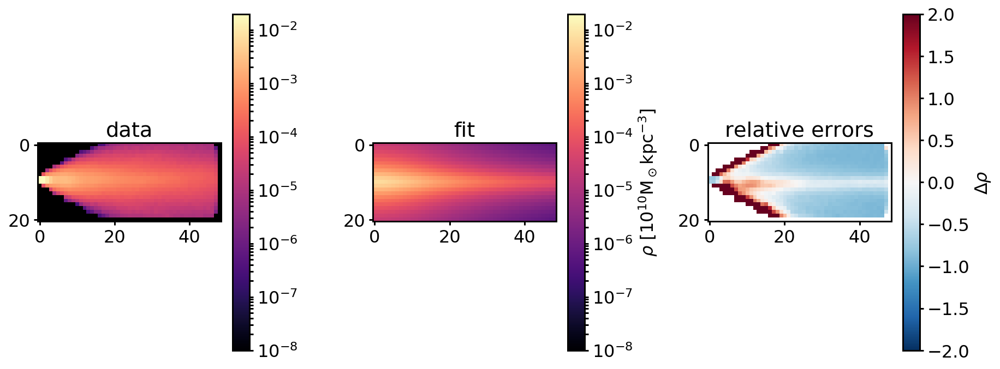

(21, 49)
a and b: 6.498888363431323, 2.5468444204528975
Rho mean galpy: 0.00018988371596314777
Rho mean data: 0.00033879189738258395
63.1554225271 117.1251829752916
Circular velocity ar R=8kpc: 63.155422527119796 km/s and its error compared to the data: -0.46078698941761403 km/s
Multiply rho error with 0.21232464961654834
Error: 83886567539250.38
Error multiplied by vcirc error: 17811186060306.254
data max: 0.019812705986395618, fit max: 0.0015221452700733469, chosen max: 0.019812705986395618


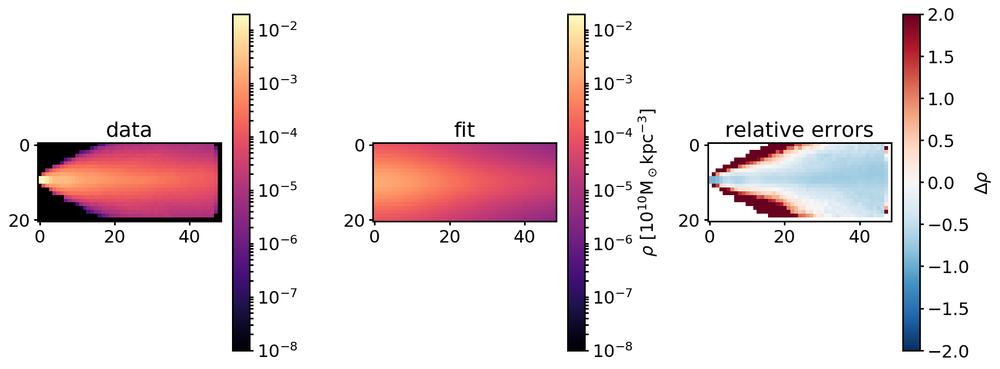

(21, 49)
a and b: 5.673309904999833, 4.123346051821551
Rho mean galpy: 0.00016950530080299555
Rho mean data: 0.00033879189738258395
58.9178997385 117.1251829752916
Circular velocity ar R=8kpc: 58.9178997384817 km/s and its error compared to the data: -0.4969664230884415 km/s
Multiply rho error with 0.24697562567731987
Error: 84371508170434.31
Error multiplied by vcirc error: 20837706019732.12
data max: 0.019812705986395618, fit max: 0.0009445274825499846, chosen max: 0.019812705986395618


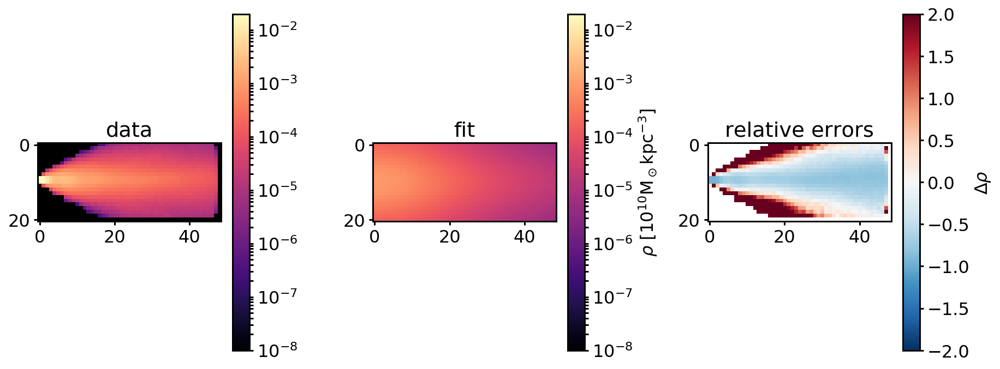

(21, 49)
a and b: 9.77972712508691, 0.790930631707484
Rho mean galpy: 0.00014773842499517473
Rho mean data: 0.00033879189738258395
54.907859078 117.1251829752916
Circular velocity ar R=8kpc: 54.907859077966435 km/s and its error compared to the data: -0.5312036431178968 km/s
Multiply rho error with 0.2821773104617259
Error: 123174299929508.14
Error multiplied by vcirc error: 34756992672114.56
data max: 0.019812705986395618, fit max: 0.002640475516750716, chosen max: 0.019812705986395618


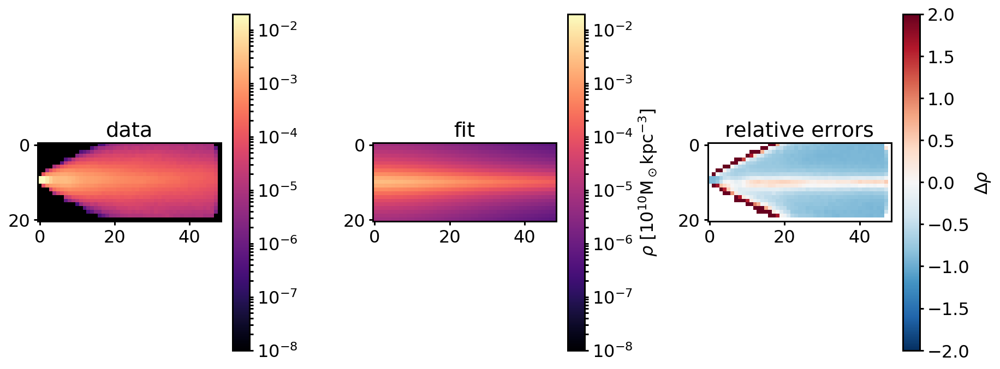

(21, 49)
a and b: 3.7932627950721036, 3.256642467325592
Rho mean galpy: 0.00026362581400928985
Rho mean data: 0.00033879189738258395
76.1134800582 117.1251829752916
Circular velocity ar R=8kpc: 76.11348005820375 km/s and its error compared to the data: -0.35015273295871446 km/s
Multiply rho error with 0.1226069363984568
Error: 84481123802700.6
Error multiplied by vcirc error: 10357971772947.865
data max: 0.019812705986395618, fit max: 0.0024109776269565556, chosen max: 0.019812705986395618


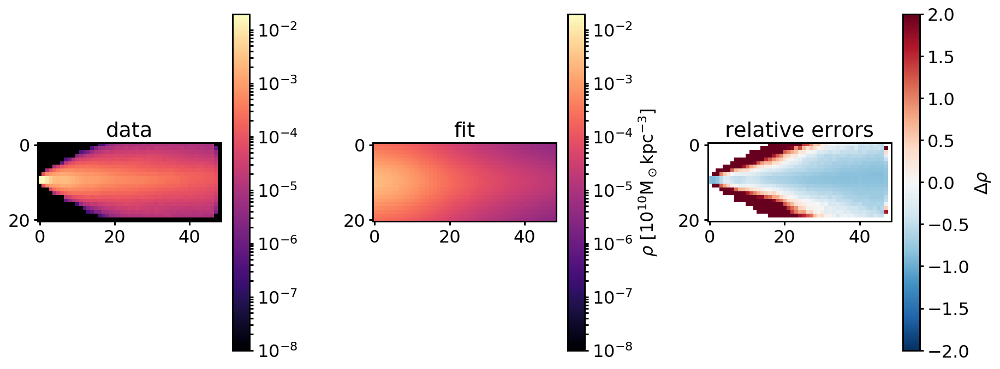

(21, 49)
a and b: 7.281003636613052, 1.20193456331392
Rho mean galpy: 0.00019736850308249706
Rho mean data: 0.00033879189738258395
66.5619933999 117.1251829752916
Circular velocity ar R=8kpc: 66.56199339994126 km/s and its error compared to the data: -0.43170211811764686 km/s
Multiply rho error with 0.18636671878726271
Error: 90339654507086.14
Error multiplied by vcirc error: 16836304986860.594
data max: 0.019812705986395618, fit max: 0.003011157640527383, chosen max: 0.019812705986395618


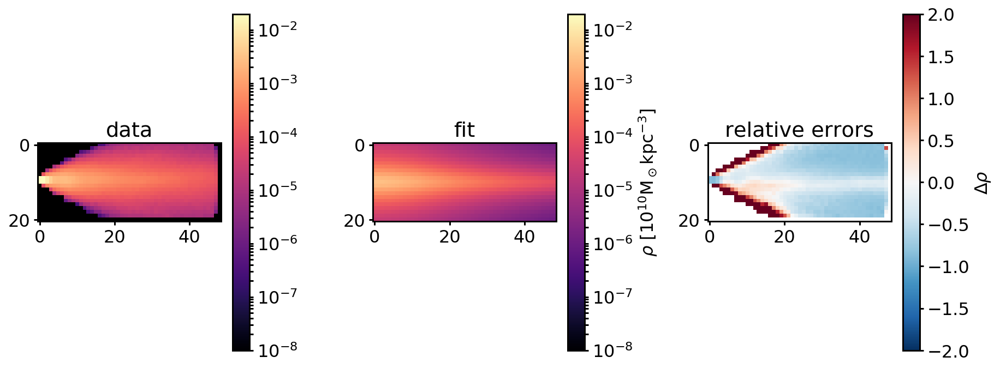

(21, 49)
a and b: 5.148344405257571, 0.5863264683750267
Rho mean galpy: 0.00029797901015382914
Rho mean data: 0.00033879189738258395
85.8198952854 117.1251829752916
Circular velocity ar R=8kpc: 85.81989528543916 km/s and its error compared to the data: -0.26728058727094167 km/s
Multiply rho error with 0.07143891233189947
Error: 414431626057637.1
Error multiplied by vcirc error: 29606544601498.082
data max: 0.019812705986395618, fit max: 0.012667901761729694, chosen max: 0.019812705986395618


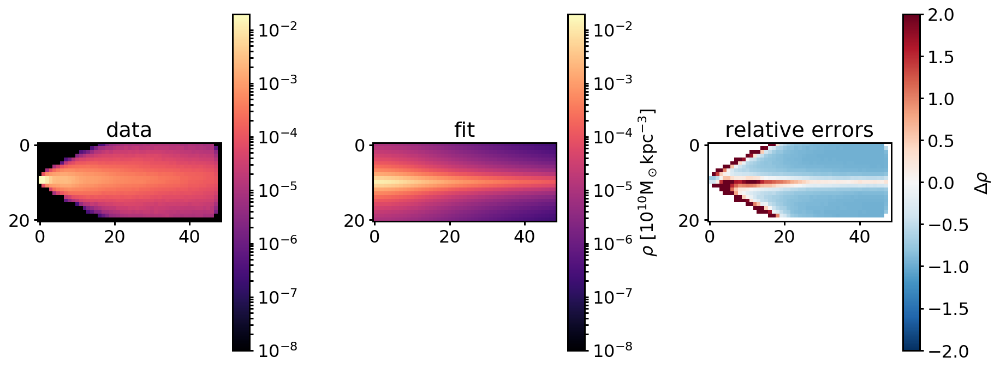

(21, 49)
a and b: 2.6595343746410776, 3.3716670685352996
Rho mean galpy: 0.0003239028036662165
Rho mean data: 0.00033879189738258395
83.5727755463 117.1251829752916
Circular velocity ar R=8kpc: 83.572775546342 km/s and its error compared to the data: -0.2864662114212254 km/s
Multiply rho error with 0.08206289028603021
Error: 85072134251815.52
Error multiplied by vcirc error: 6981265219505.17
data max: 0.019812705986395618, fit max: 0.0035014512015239378, chosen max: 0.019812705986395618


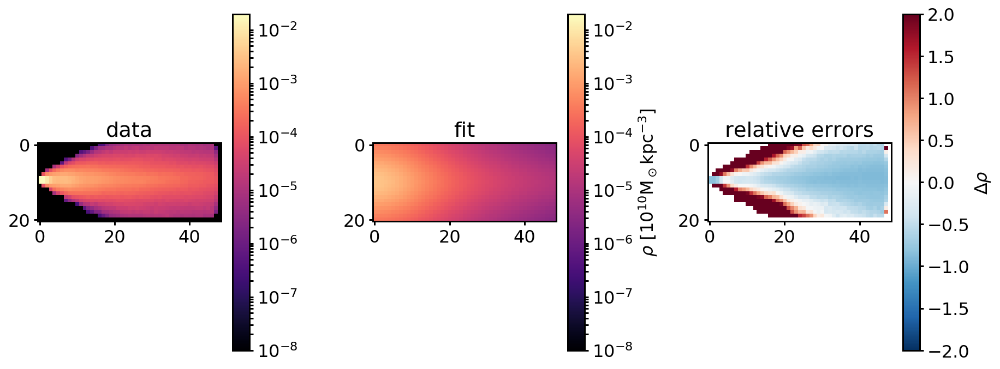

(21, 49)
a and b: 4.278750194437538, 0.3193979138508731
Rho mean galpy: 0.0004037172400607911
Rho mean data: 0.00033879189738258395
94.5526448434 117.1251829752916
Circular velocity ar R=8kpc: 94.55264484335078 km/s and its error compared to the data: -0.1927214759331702 km/s
Multiply rho error with 0.0371415672858595
Error: 5313866113678940.0
Error multiplied by vcirc error: 197365315809255.1
data max: 0.019812705986395618, fit max: 0.03418068939419611, chosen max: 0.03418068939419611


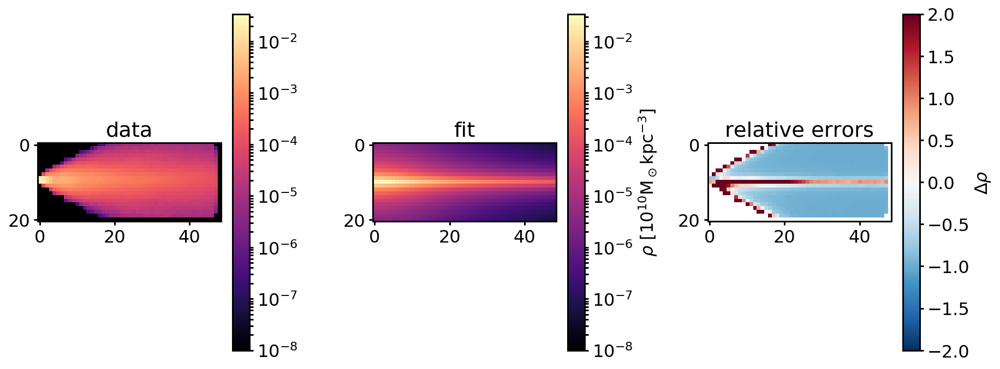

(21, 49)
a and b: 7.723082753841113, 3.460433383919745
Rho mean galpy: 0.0001433405067778605
Rho mean data: 0.00033879189738258395
51.9776349615 117.1251829752916
Circular velocity ar R=8kpc: 51.977634961532544 km/s and its error compared to the data: -0.556221526053047 km/s
Multiply rho error with 0.3093823860447804
Error: 84075901668775.81
Error multiplied by vcirc error: 26011603067152.195
data max: 0.019812705986395618, fit max: 0.0007592134476542568, chosen max: 0.019812705986395618


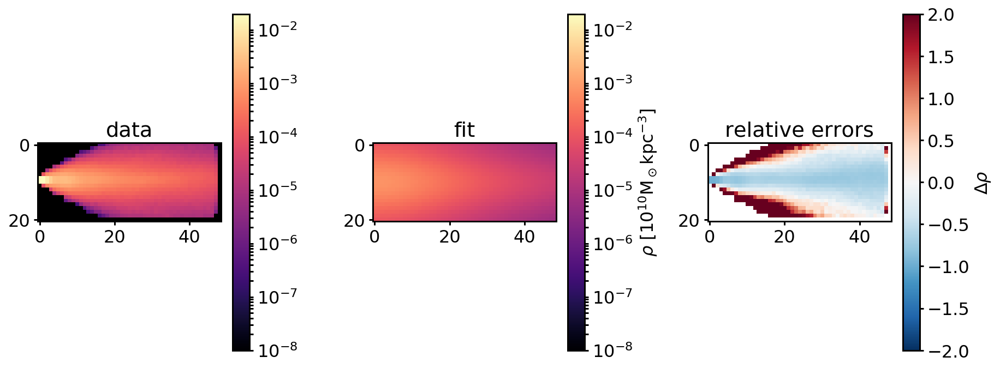

(21, 49)
a and b: 1.2010335556513074, 1.8717966425839563
Rho mean galpy: 0.0007214621482628833
Rho mean data: 0.00033879189738258395
105.639326944 117.1251829752916
Circular velocity ar R=8kpc: 105.63932694446481 km/s and its error compared to the data: -0.09806478623175176 km/s
Multiply rho error with 0.00961670229867917
Error: 117799265746477.16
Error multiplied by vcirc error: 1132840469686.8652
data max: 0.019812705986395618, fit max: 0.025335212850736966, chosen max: 0.025335212850736966


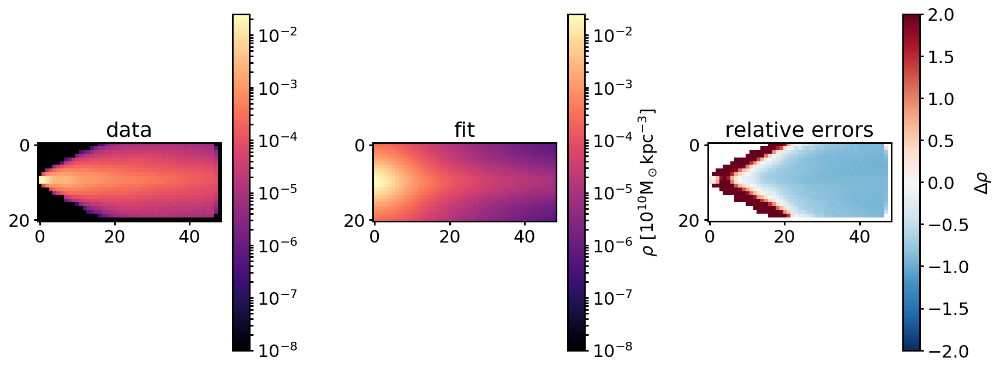

(21, 49)
a and b: 7.96874198113068, 1.766467610507157
Rho mean galpy: 0.00017053848844210339
Rho mean data: 0.00033879189738258395
59.2516018588 117.1251829752916
Circular velocity ar R=8kpc: 59.251601858779225 km/s and its error compared to the data: -0.49411731658699926 km/s
Multiply rho error with 0.24415192255113685
Error: 83751501912481.22
Error multiplied by vcirc error: 20448090208477.504
data max: 0.019812705986395618, fit max: 0.001652258615291612, chosen max: 0.019812705986395618


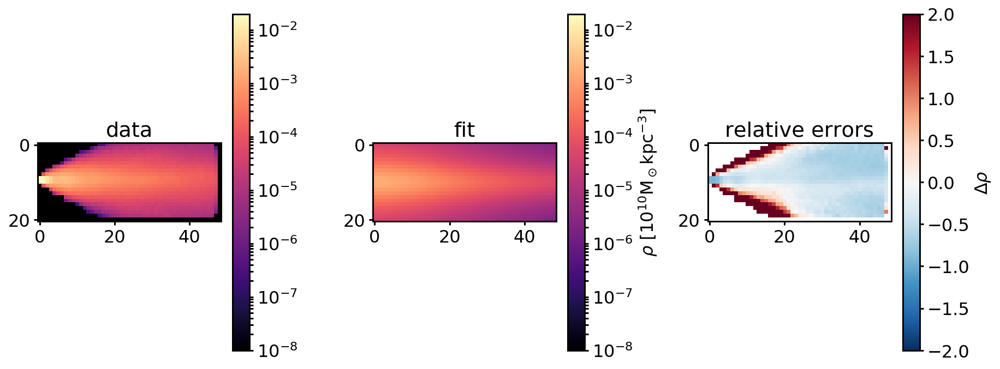

(21, 49)
a and b: 7.461655107733706, 1.5912421133225692
Rho mean galpy: 0.0001856067271643965
Rho mean data: 0.00033879189738258395
63.1133373548 117.1251829752916
Circular velocity ar R=8kpc: 63.11333735482603 km/s and its error compared to the data: -0.4611463072963545 km/s
Multiply rho error with 0.2126559167330638
Error: 84550391421033.16
Error multiplied by vcirc error: 17980140997779.18
data max: 0.019812705986395618, fit max: 0.002103275714714601, chosen max: 0.019812705986395618


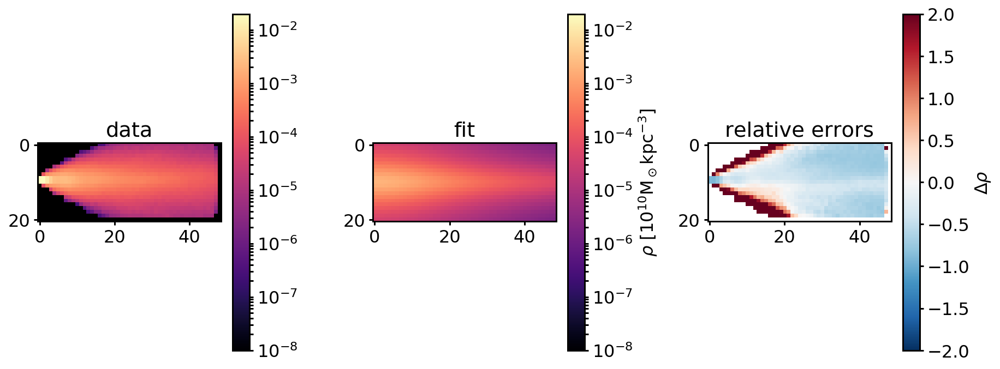

(21, 49)
a and b: 4.096416502244899, 1.8118040526807713
Rho mean galpy: 0.0003165227840539801
Rho mean data: 0.00033879189738258395
84.5015664895 117.1251829752916
Circular velocity ar R=8kpc: 84.50156648954322 km/s and its error compared to the data: -0.2785363118077737 km/s
Multiply rho error with 0.07758247699547735
Error: 86809821151376.44
Error multiplied by vcirc error: 6734920952458.166
data max: 0.019812705986395618, fit max: 0.0051724081376195675, chosen max: 0.019812705986395618


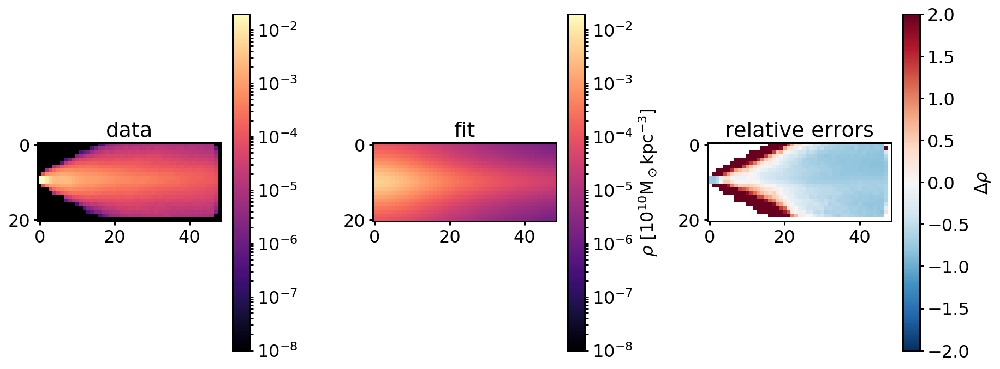

(21, 49)
a and b: 8.020157267166482, 0.2534290857154433
Rho mean galpy: 0.0002296471056290804
Rho mean data: 0.00033879189738258395
67.8798390837 117.1251829752916
Circular velocity ar R=8kpc: 67.87983908368696 km/s and its error compared to the data: -0.4204505183312567 km/s
Multiply rho error with 0.17677863836502242
Error: 6272414219422571.0
Error multiplied by vcirc error: 1108828844970927.0
data max: 0.019812705986395618, fit max: 0.012415171331008189, chosen max: 0.019812705986395618


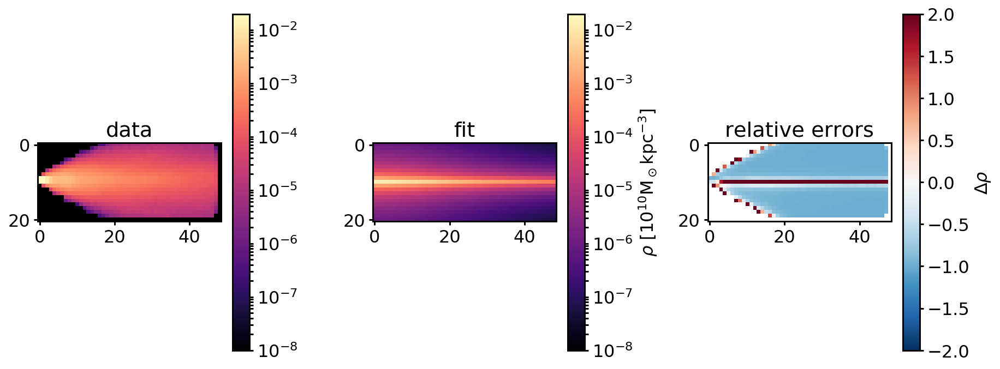

(21, 49)
a and b: 1.787154552944632, 1.236404530007751
Rho mean galpy: 0.0006849475372152128
Rho mean data: 0.00033879189738258395
105.964536321 117.1251829752916
Circular velocity ar R=8kpc: 105.96453632133442 km/s and its error compared to the data: -0.0952881896996617 km/s
Multiply rho error with 0.009079839096238714
Error: 170553065082165.84
Error multiplied by vcirc error: 1548594388316.3953
data max: 0.019812705986395618, fit max: 0.032470450301568775, chosen max: 0.032470450301568775


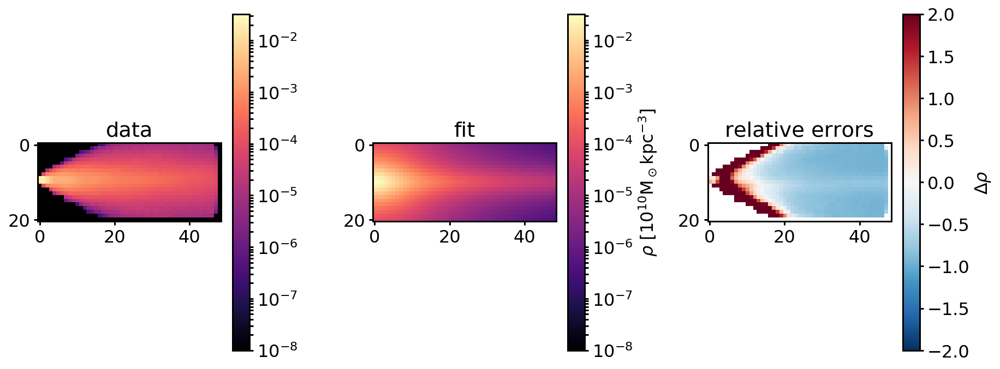

(21, 49)
a and b: 3.4466867416652494, 1.822299013060693
Rho mean galpy: 0.0003647223114213292
Rho mean data: 0.00033879189738258395
89.389675618 117.1251829752916
Circular velocity ar R=8kpc: 89.38967561803608 km/s and its error compared to the data: -0.23680225424370538 km/s
Multiply rho error with 0.05607530761490048
Error: 88350352683803.19
Error multiplied by vcirc error: 4954273204629.212
data max: 0.019812705986395618, fit max: 0.006777559533258297, chosen max: 0.019812705986395618


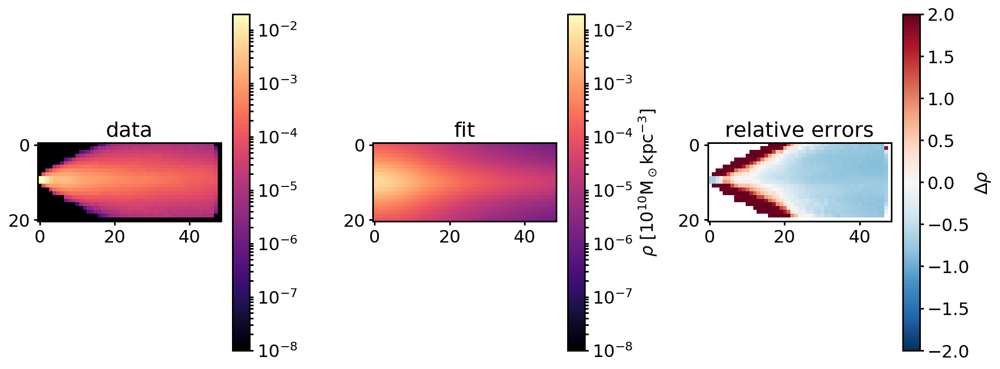

(21, 49)
a and b: 2.8518127772529867, 4.512552921151464
Rho mean galpy: 0.00024826956331110763
Rho mean data: 0.00033879189738258395
73.91435656 117.1251829752916
Circular velocity ar R=8kpc: 73.91435656000303 km/s and its error compared to the data: -0.3689285712740718 km/s
Multiply rho error with 0.13610829070232788
Error: 84856701015498.06
Error multiplied by vcirc error: 11549700529857.932
data max: 0.019812705986395618, fit max: 0.0018446185280118516, chosen max: 0.019812705986395618


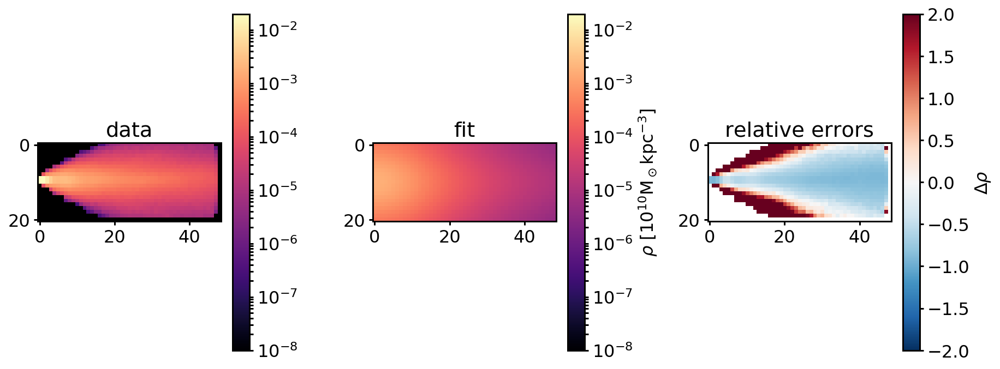

(21, 49)
a and b: 6.1405665589112, 3.120663011679971
Rho mean galpy: 0.00018458150389414775
Rho mean data: 0.00033879189738258395
61.9035890008 117.1251829752916
Circular velocity ar R=8kpc: 61.90358900084713 km/s and its error compared to the data: -0.4714749857517308 km/s
Multiply rho error with 0.22228866218959475
Error: 84093737654781.69
Error multiplied by vcirc error: 18693084441804.17
data max: 0.019812705986395618, fit max: 0.0012691497739486554, chosen max: 0.019812705986395618


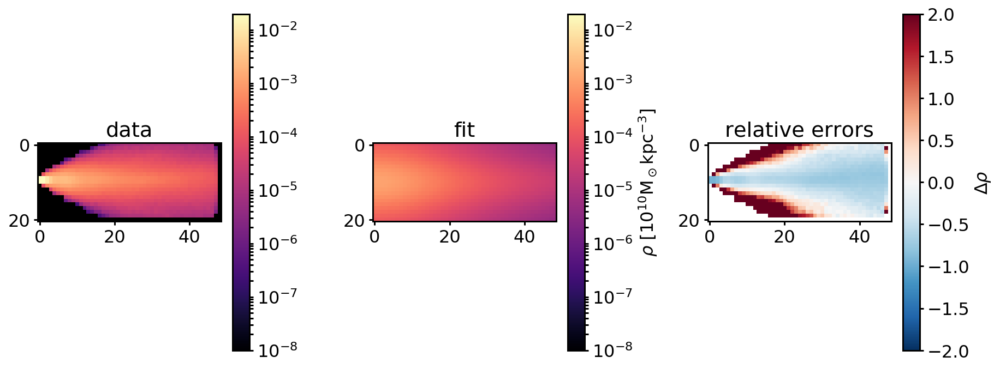

(21, 49)
a and b: 6.322815725221252, 1.7855203201627954
Rho mean galpy: 0.0002141751059101251
Rho mean data: 0.00033879189738258395
68.939321586 117.1251829752916
Circular velocity ar R=8kpc: 68.93932158597251 km/s and its error compared to the data: -0.4114047907142586 km/s
Multiply rho error with 0.16925390182264294
Error: 84497160525126.6
Error multiplied by vcirc error: 14301474111811.877
data max: 0.019812705986395618, fit max: 0.0024898137710963456, chosen max: 0.019812705986395618


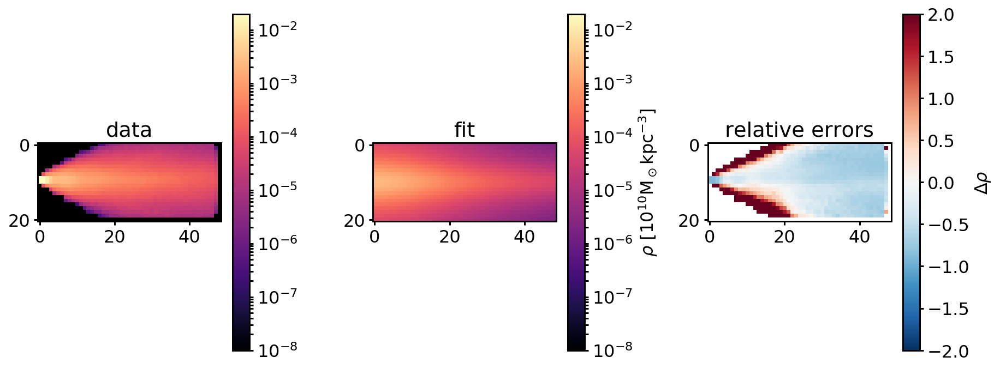

(21, 49)
a and b: 0.6882050407851636, 3.3171131986786664
Rho mean galpy: 0.0005577349301903165
Rho mean data: 0.00033879189738258395
99.0363161178 117.1251829752916
Circular velocity ar R=8kpc: 99.0363161178175 km/s and its error compared to the data: -0.15444045761952035 km/s
Multiply rho error with 0.023851854949726862
Error: 97755462985969.14
Error multiplied by vcirc error: 2331649123684.729
data max: 0.019812705986395618, fit max: 0.010099052756516869, chosen max: 0.019812705986395618


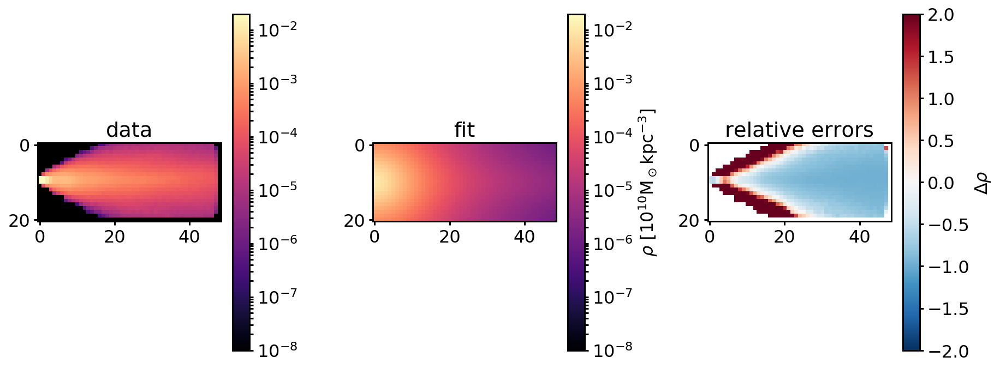

(21, 49)
a and b: 3.055558605922504, 2.197938601709067
Rho mean galpy: 0.00037366425674124047
Rho mean data: 0.00033879189738258395
89.5089340708 117.1251829752916
Circular velocity ar R=8kpc: 89.50893407084841 km/s and its error compared to the data: -0.23578404065562084 km/s
Multiply rho error with 0.05559411382789146
Error: 86567363416823.03
Error multiplied by vcirc error: 4812635855575.307
data max: 0.019812705986395618, fit max: 0.006136609657657174, chosen max: 0.019812705986395618


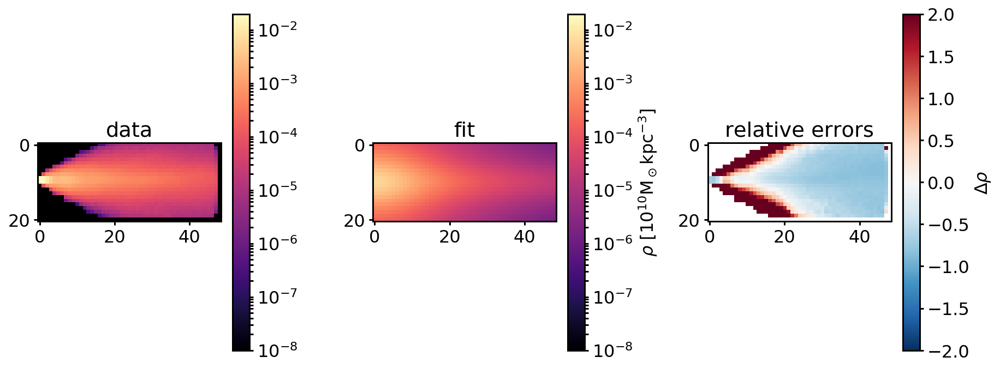

(21, 49)
a and b: 7.703234938414972, 4.893439898332792
Rho mean galpy: 0.00011752392120248127
Rho mean data: 0.00033879189738258395
45.9758626831 117.1251829752916
Circular velocity ar R=8kpc: 45.97586268305789 km/s and its error compared to the data: -0.6074638987521853 km/s
Multiply rho error with 0.36901238828720523
Error: 84360541223412.6
Error multiplied by vcirc error: 31130084794052.71
data max: 0.019812705986395618, fit max: 0.0004645411325404153, chosen max: 0.019812705986395618


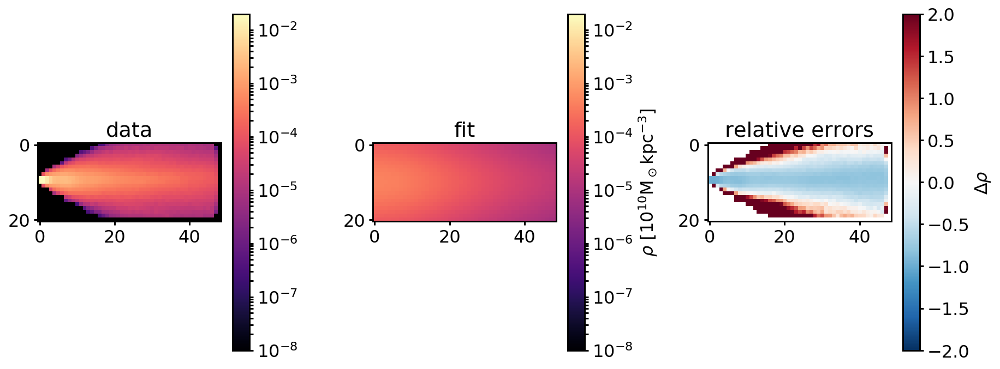

(21, 49)
a and b: 2.6829005006123796, 3.863435052000491
Rho mean galpy: 0.00029168695124200567
Rho mean data: 0.00033879189738258395
79.7426423887 117.1251829752916
Circular velocity ar R=8kpc: 79.74264238867987 km/s and its error compared to the data: -0.31916740394333337 km/s
Multiply rho error with 0.10186783173992693
Error: 84944877171923.34
Error multiplied by vcirc error: 8653150454918.247
data max: 0.019812705986395618, fit max: 0.002670589524159963, chosen max: 0.019812705986395618


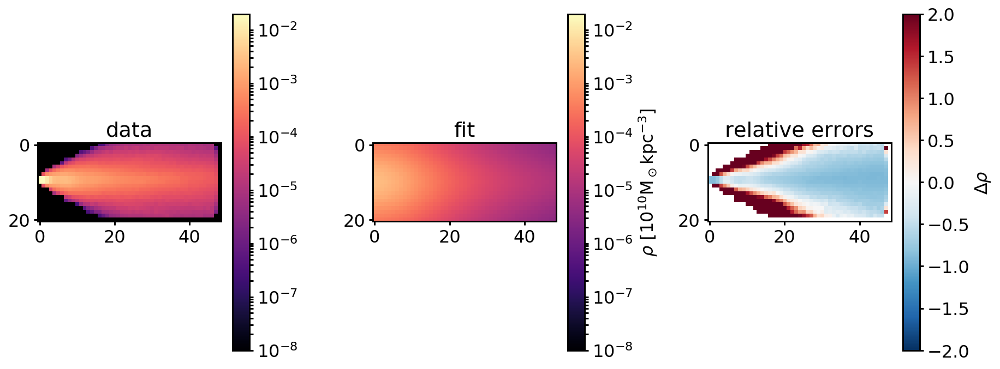

(21, 49)
a and b: 3.1090327022850417, 4.780863953048826
Rho mean galpy: 0.00022524448627866275
Rho mean data: 0.00033879189738258395
70.365618949 117.1251829752916
Circular velocity ar R=8kpc: 70.36561894899408 km/s and its error compared to the data: -0.39922724420555894 km/s
Multiply rho error with 0.159382392515965
Error: 84786096763258.8
Error multiplied by vcirc error: 13513410954218.303
data max: 0.019812705986395618, fit max: 0.0015078012053223074, chosen max: 0.019812705986395618


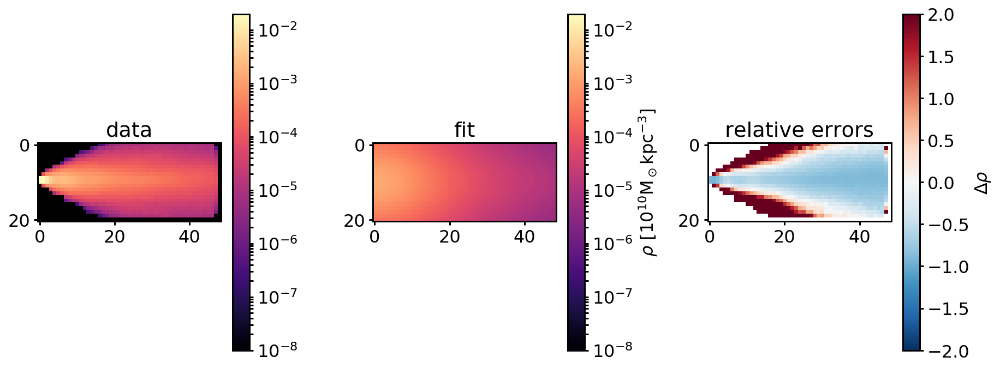

(21, 49)
a and b: 6.669712938312071, 0.72765508008939
Rho mean galpy: 0.00022471210201369484
Rho mean data: 0.00033879189738258395
73.6867591844 117.1251829752916
Circular velocity ar R=8kpc: 73.68675918437133 km/s and its error compared to the data: -0.3708717688841 km/s
Multiply rho error with 0.13754586895522128
Error: 174345867772939.12
Error multiplied by vcirc error: 23980553881581.023
data max: 0.019812705986395618, fit max: 0.006098206272307874, chosen max: 0.019812705986395618


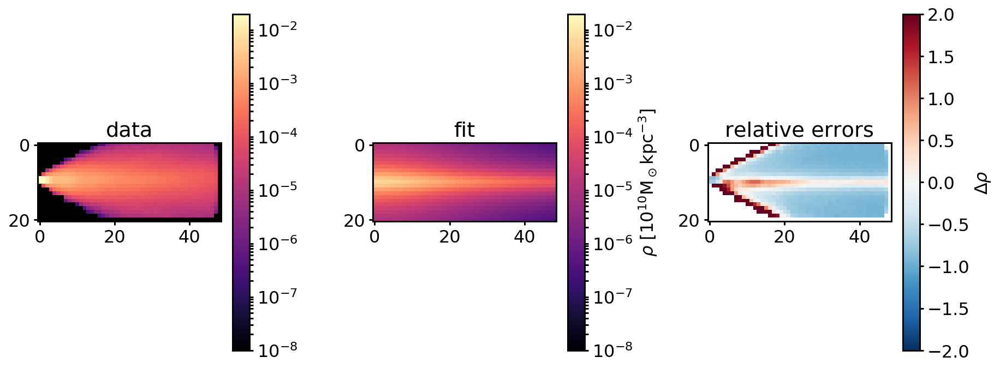

(21, 49)
a and b: 1.1565507815853162, 1.7746081945444323
Rho mean galpy: 0.0007591260758401303
Rho mean data: 0.00033879189738258395
106.566344638 117.1251829752916
Circular velocity ar R=8kpc: 106.56634463757688 km/s and its error compared to the data: -0.09015002640330715 km/s
Multiply rho error with 0.008127027260516976
Error: 127867031831004.53
Error multiplied by vcirc error: 1039178853411.9657
data max: 0.019812705986395618, fit max: 0.029252965676874198, chosen max: 0.029252965676874198


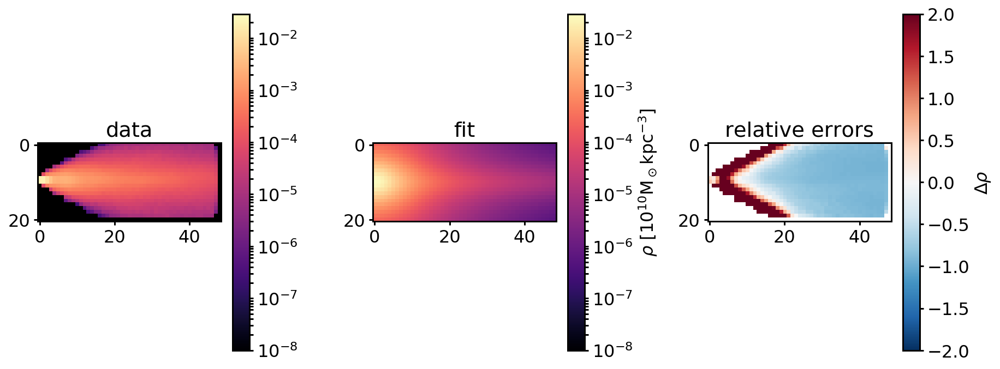

(21, 49)
a and b: 5.7376365870377635, 0.2623607737350828
Rho mean galpy: 0.00032379167501176944
Rho mean data: 0.00033879189738258395
83.8079786301 117.1251829752916
Circular velocity ar R=8kpc: 83.80797863009575 km/s and its error compared to the data: -0.28445807723710753 km/s
Multiply rho error with 0.08091639770543223
Error: 7825448808395150.0
Error multiplied by vcirc error: 633207128003602.6
data max: 0.019812705986395618, fit max: 0.023353667071170373, chosen max: 0.023353667071170373


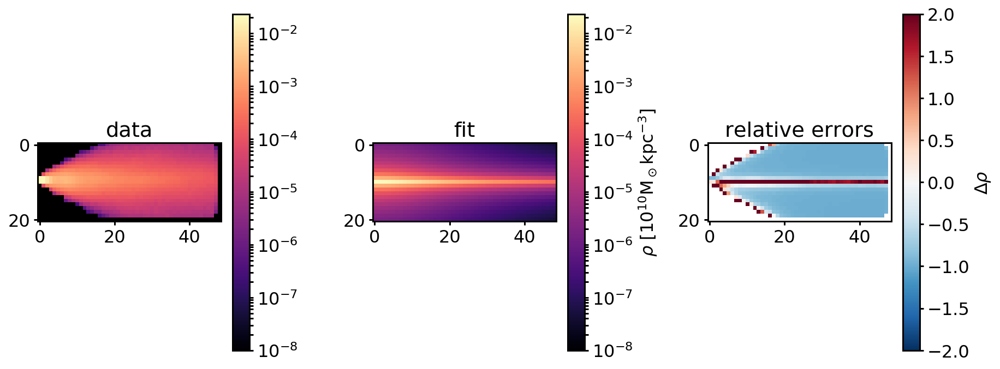

(21, 49)
a and b: 3.640584221432272, 3.609140499007257
Rho mean galpy: 0.0002545332489174685
Rho mean data: 0.00033879189738258395
74.7097488855 117.1251829752916
Circular velocity ar R=8kpc: 74.70974888547465 km/s and its error compared to the data: -0.3621376121885315 km/s
Multiply rho error with 0.13114365016161125
Error: 84537186887413.78
Error multiplied by vcirc error: 11086515262809.742
data max: 0.019812705986395618, fit max: 0.002134083706753438, chosen max: 0.019812705986395618


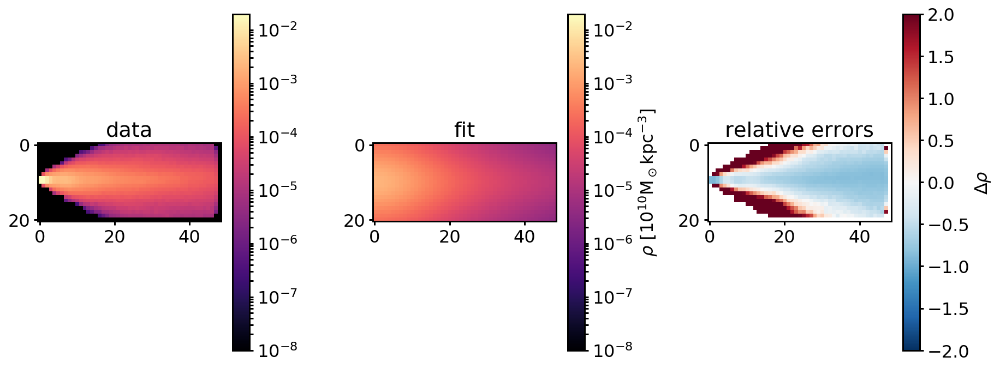

(21, 49)
a and b: 7.684970531298507, 0.6452087393131127
Rho mean galpy: 0.00019457422351811722
Rho mean data: 0.00033879189738258395
67.5208967325 117.1251829752916
Circular velocity ar R=8kpc: 67.52089673249326 km/s and its error compared to the data: -0.42351512273208336 km/s
Multiply rho error with 0.17936505918277162
Error: 213151028785420.9
Error multiplied by vcirc error: 38231846892965.68
data max: 0.019812705986395618, fit max: 0.005234809820282958, chosen max: 0.019812705986395618


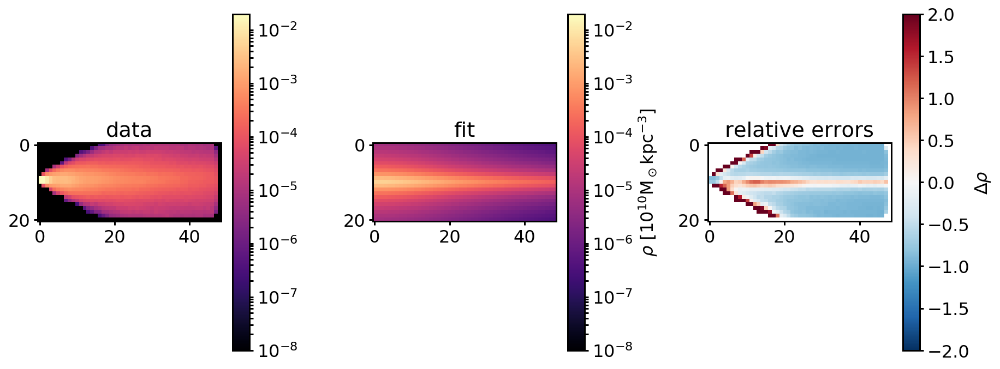

(21, 49)
a and b: 7.429803292444674, 2.116118315196852
Rho mean galpy: 0.0001762234753618588
Rho mean data: 0.00033879189738258395
60.2940860267 117.1251829752916
Circular velocity ar R=8kpc: 60.29408602669448 km/s and its error compared to the data: -0.4852167185991594 km/s
Multiply rho error with 0.23543526400813583
Error: 83659868226200.06
Error multiplied by vcirc error: 19696483162721.266
data max: 0.019812705986395618, fit max: 0.0015191182912399266, chosen max: 0.019812705986395618


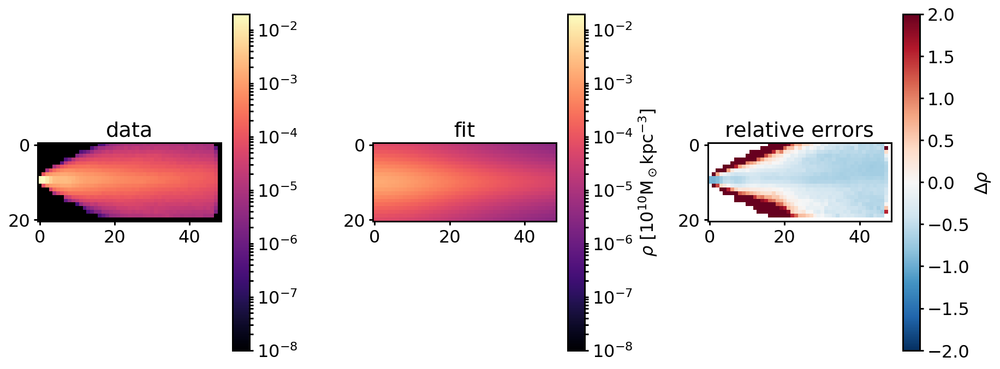

(21, 49)
a and b: 1.5273760513565815, 2.5468444204528975
Rho mean galpy: 0.0005266411783131253
Rho mean data: 0.00033879189738258395
98.5228398723 117.1251829752916
Circular velocity ar R=8kpc: 98.52283987227958 km/s and its error compared to the data: -0.1588244528671201 km/s
Multiply rho error with 0.025225206828540056
Error: 91415495230049.95
Error multiplied by vcirc error: 2305974774511.427
data max: 0.019812705986395618, fit max: 0.010771618309177899, chosen max: 0.019812705986395618


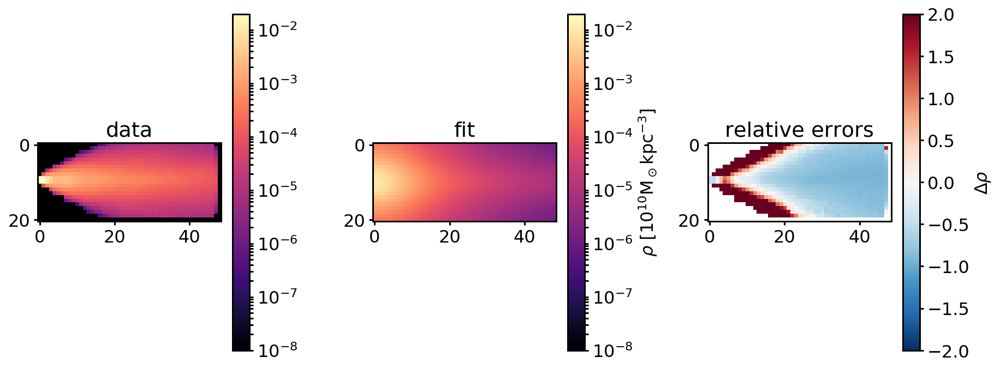

(21, 49)
a and b: 2.7682221072877926, 0.8193644045136148
Rho mean galpy: 0.0005257566786918558
Rho mean data: 0.00033879189738258395
102.085558656 117.1251829752916
Circular velocity ar R=8kpc: 102.08555865622034 km/s and its error compared to the data: -0.12840641044927092 km/s
Multiply rho error with 0.016488206244466633
Error: 305468933925887.56
Error multiplied by vcirc error: 5036634783847.385
data max: 0.019812705986395618, fit max: 0.027946481167636084, chosen max: 0.027946481167636084


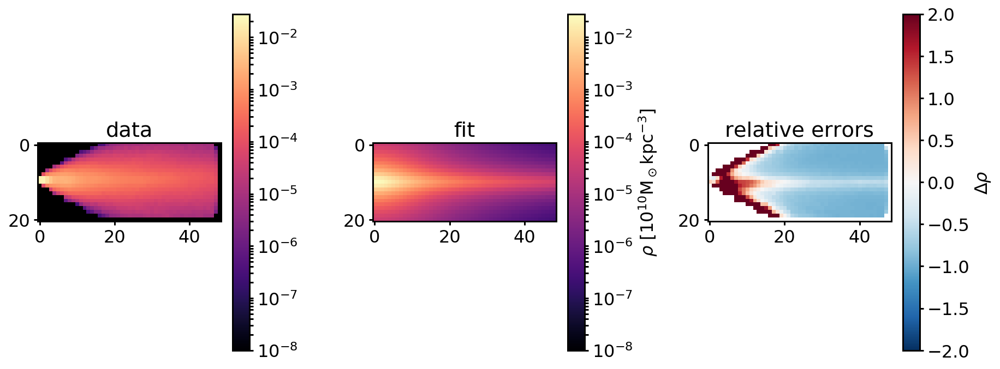

(21, 49)
a and b: 6.463599289182328, 1.847147885404596
Rho mean galpy: 0.00020818619260233996
Rho mean data: 0.00033879189738258395
67.6439206305 117.1251829752916
Circular velocity ar R=8kpc: 67.64392063045244 km/s and its error compared to the data: -0.42246476024953217 km/s
Multiply rho error with 0.1784764736526947
Error: 84254059360763.38
Error multiplied by vcirc error: 15037367405633.86
data max: 0.019812705986395618, fit max: 0.002297542922342002, chosen max: 0.019812705986395618


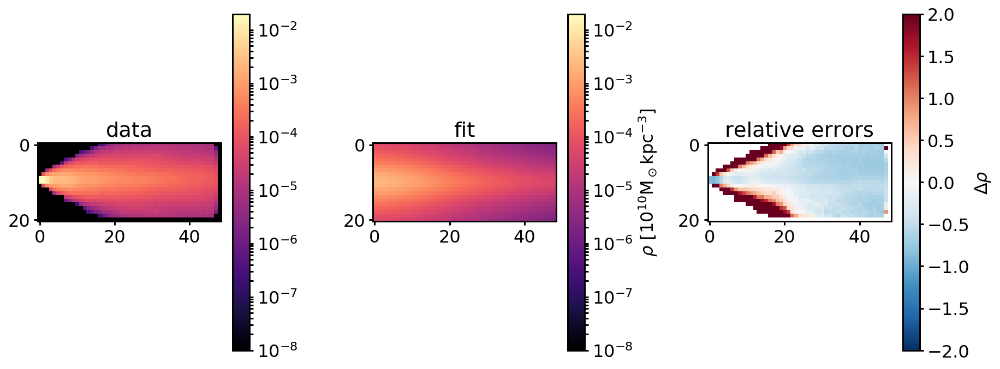

differential_evolution step 1: f(x)= 7.32101e+11
(21, 49)
a and b: 1.146834856728387, 0.806962377920792
Rho mean galpy: 0.0010940059445201514
Rho mean data: 0.00033879189738258395
112.14496452 117.1251829752916
Circular velocity ar R=8kpc: 112.14496451980385 km/s and its error compared to the data: -0.04252047534933932 km/s
Multiply rho error with 0.001807990823933773
Error: 1046754061190282.1
Error multiplied by vcirc error: 1892521737547.4412
data max: 0.019812705986395618, fit max: 0.11872846312619115, chosen max: 0.11872846312619115


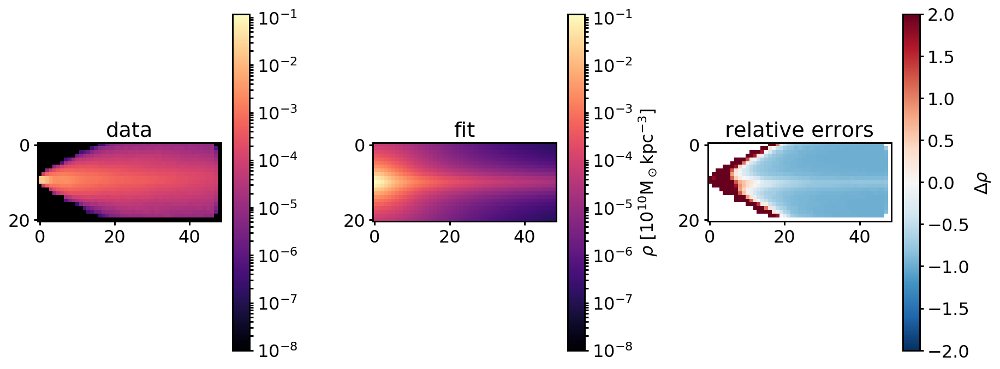

(21, 49)
a and b: 4.836073559412811, 0.9458613626515042
Rho mean galpy: 0.0003051135802847425
Rho mean data: 0.00033879189738258395
85.4600528219 117.1251829752916
Circular velocity ar R=8kpc: 85.46005282188824 km/s and its error compared to the data: -0.27035287671724145 km/s
Multiply rho error with 0.07309067794928796
Error: 130017091956858.31
Error multiplied by vcirc error: 9503037396121.69
data max: 0.019812705986395618, fit max: 0.008511154977166313, chosen max: 0.019812705986395618


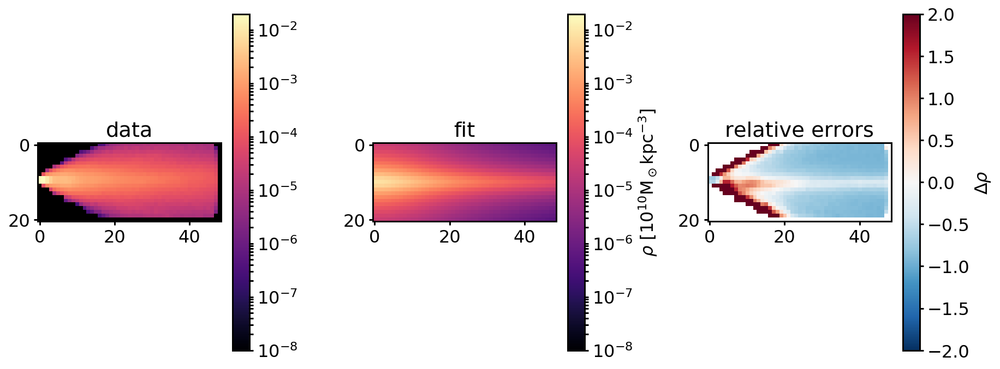

(21, 49)
a and b: 8.8192091034621, 4.139734966613222
Rho mean galpy: 0.00011546605833006077
Rho mean data: 0.00033879189738258395
44.5924798091 117.1251829752916
Circular velocity ar R=8kpc: 44.59247980912392 km/s and its error compared to the data: -0.6192750467802383 km/s
Multiply rho error with 0.3835015835646663
Error: 84168603291244.62
Error multiplied by vcirc error: 32278792648618.496
data max: 0.019812705986395618, fit max: 0.00047855308624919767, chosen max: 0.019812705986395618


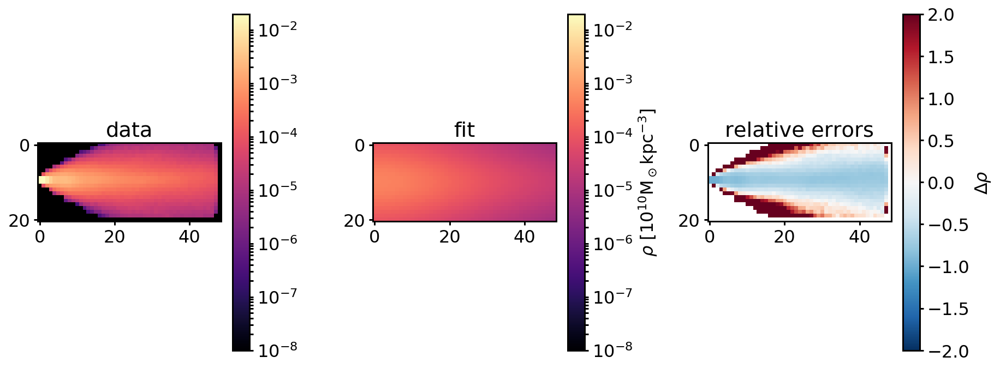

(21, 49)
a and b: 1.9321606508604399, 0.646963297008786
Rho mean galpy: 0.0007553520158751837
Rho mean data: 0.00033879189738258395
108.753306335 117.1251829752916
Circular velocity ar R=8kpc: 108.75330633497973 km/s and its error compared to the data: -0.07147802400511917 km/s
Multiply rho error with 0.005109107915676392
Error: 1128517401261729.8
Error multiplied by vcirc error: 5765717187764.8545
data max: 0.019812705986395618, fit max: 0.07034413347239042, chosen max: 0.07034413347239042


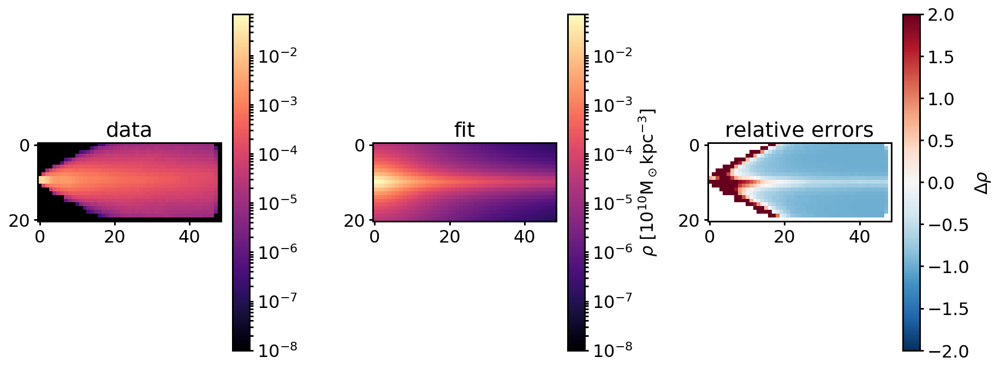

(21, 49)
a and b: 4.239379001154004, 2.5368296725862494
Rho mean galpy: 0.0002742456704830093
Rho mean data: 0.00033879189738258395
78.0704353428 117.1251829752916
Circular velocity ar R=8kpc: 78.07043534278297 km/s and its error compared to the data: -0.3334444962254403 km/s
Multiply rho error with 0.11118523206303768
Error: 84485011131575.16
Error multiplied by vcirc error: 9393485568512.506
data max: 0.019812705986395618, fit max: 0.003045035610682035, chosen max: 0.019812705986395618


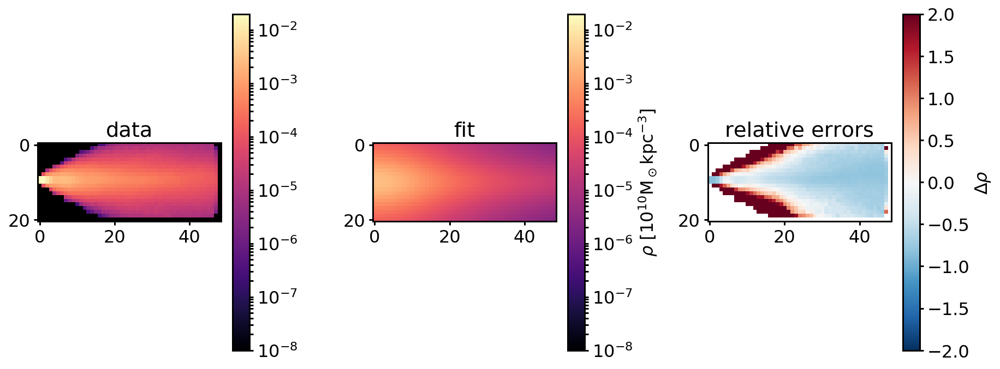

(21, 49)
a and b: 4.468109548855381, 2.30591614438862
Rho mean galpy: 0.0002726050922466999
Rho mean data: 0.00033879189738258395
78.0861962758 117.1251829752916
Circular velocity ar R=8kpc: 78.08619627575811 km/s and its error compared to the data: -0.3333099313729058 km/s
Multiply rho error with 0.11109551035181119
Error: 84573921864332.2
Error multiplied by vcirc error: 9395783011972.19
data max: 0.019812705986395618, fit max: 0.0032219575974784483, chosen max: 0.019812705986395618


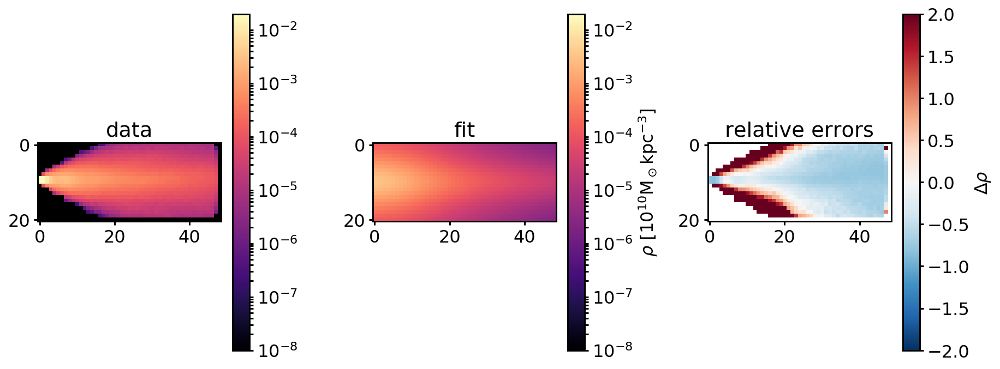

(21, 49)
a and b: 4.170812786323825, 1.4370649415964416
Rho mean galpy: 0.00032945689191503434
Rho mean data: 0.00033879189738258395
86.7878919807 117.1251829752916
Circular velocity ar R=8kpc: 86.78789198070685 km/s and its error compared to the data: -0.2590159539045042 km/s
Multiply rho error with 0.06708926437706025
Error: 92662911266528.8
Error multiplied by vcirc error: 6216686551908.226
data max: 0.019812705986395618, fit max: 0.006785421338648509, chosen max: 0.019812705986395618


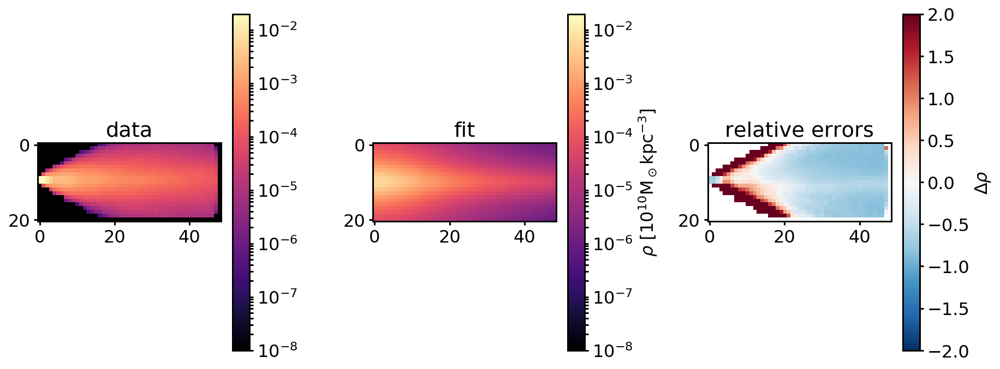

(21, 49)
a and b: 2.0796458298947376, 2.748628519165439
Rho mean galpy: 0.00042633226331217623
Rho mean data: 0.00033879189738258395
92.7852496476 117.1251829752916
Circular velocity ar R=8kpc: 92.7852496476132 km/s and its error compared to the data: -0.207811272600642 km/s
Multiply rho error with 0.04318552501989834
Error: 87020912026204.78
Error multiplied by vcirc error: 3758043773562.039
data max: 0.019812705986395618, fit max: 0.006760934927035353, chosen max: 0.019812705986395618


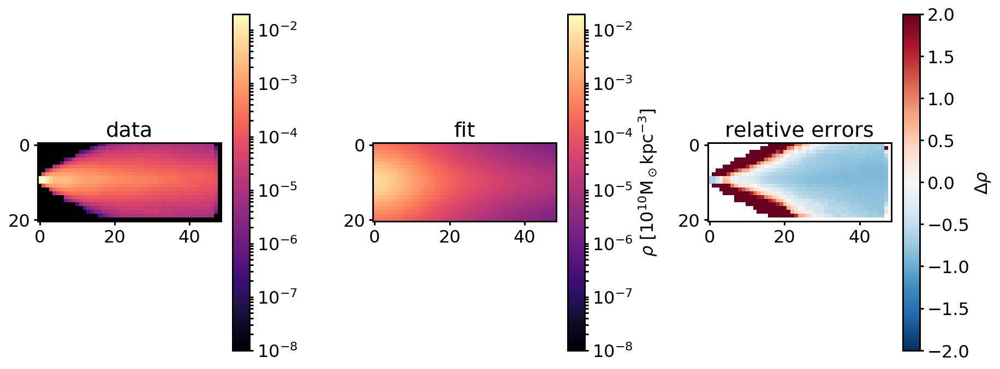

(21, 49)
a and b: 1.9068398090877752, 1.5912421133225692
Rho mean galpy: 0.0005953382346557587
Rho mean data: 0.00033879189738258395
102.721823659 117.1251829752916
Circular velocity ar R=8kpc: 102.72182365940863 km/s and its error compared to the data: -0.12297406031733978 km/s
Multiply rho error with 0.015122619510932722
Error: 111778342570061.53
Error multiplied by vcirc error: 1690381344249.7341
data max: 0.019812705986395618, fit max: 0.019829459195185042, chosen max: 0.019829459195185042


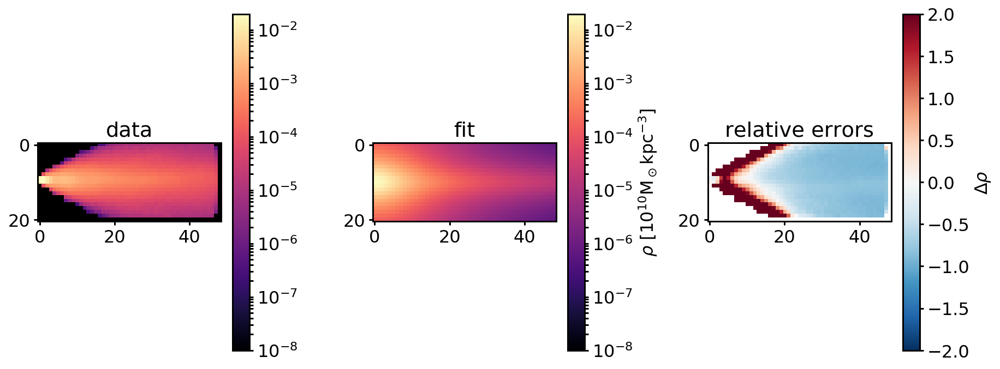

(21, 49)
a and b: 6.121344445859212, 1.8283687243212046
Rho mean galpy: 0.00021980880315929248
Rho mean data: 0.00033879189738258395
69.9721479514 117.1251829752916
Circular velocity ar R=8kpc: 69.97214795138727 km/s and its error compared to the data: -0.4025866498227934 km/s
Multiply rho error with 0.16207601061554047
Error: 84492227146509.44
Error multiplied by vcirc error: 13694163103928.32
data max: 0.019812705986395618, fit max: 0.0025637376537783903, chosen max: 0.019812705986395618


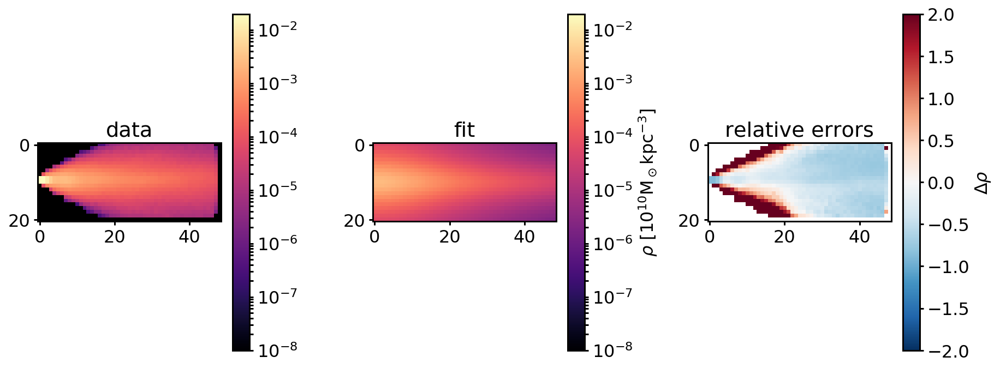

(21, 49)
a and b: 6.0278619677909475, 2.591116408025158
Rho mean galpy: 0.0002020970175794975
Rho mean data: 0.00033879189738258395
65.7203314809 117.1251829752916
Circular velocity ar R=8kpc: 65.72033148089629 km/s and its error compared to the data: -0.43888812114162956 km/s
Multiply rho error with 0.1926227828792297
Error: 83971703896273.69
Error multiplied by vcirc error: 16174863287610.895
data max: 0.019812705986395618, fit max: 0.0016880732526445602, chosen max: 0.019812705986395618


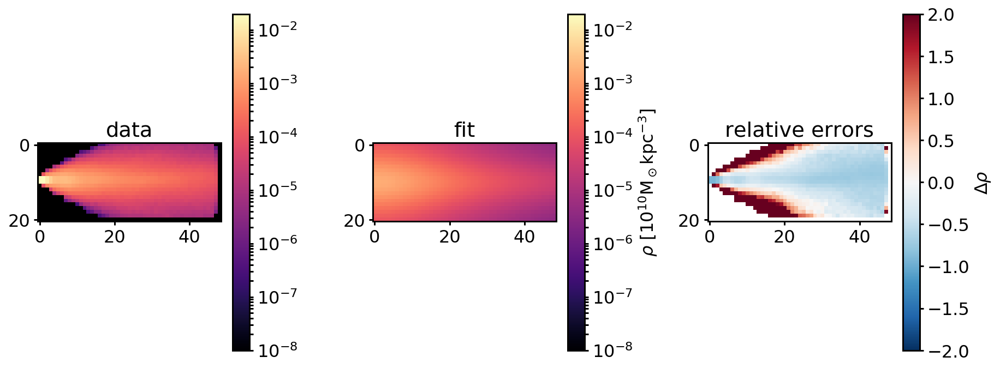

(21, 49)
a and b: 1.71533493501232, 2.5160403232756243
Rho mean galpy: 0.0005005605924449224
Rho mean data: 0.00033879189738258395
97.3429032244 117.1251829752916
Circular velocity ar R=8kpc: 97.34290322437192 km/s and its error compared to the data: -0.16889860274619922 km/s
Multiply rho error with 0.028526738009618417
Error: 90090156361526.84
Error multiplied by vcirc error: 2569978287770.834
data max: 0.019812705986395618, fit max: 0.009837293596112007, chosen max: 0.019812705986395618


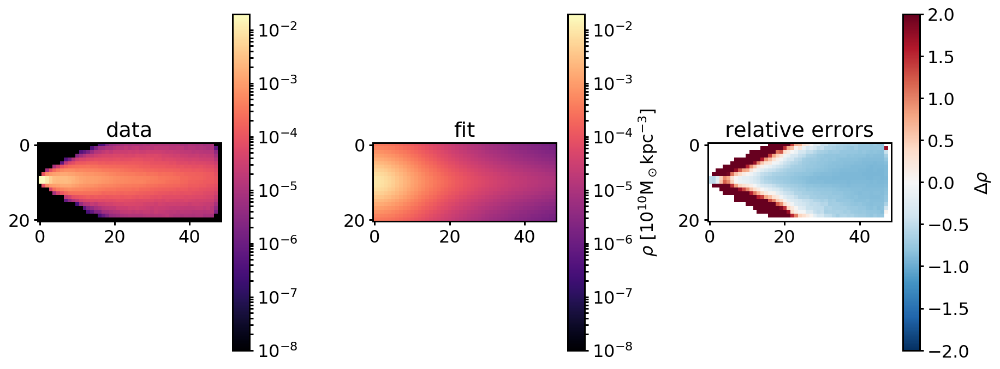

(21, 49)
a and b: 6.3065683313865435, 2.663980250547777
Rho mean galpy: 0.00019213329900767852
Rho mean data: 0.00033879189738258395
63.5990071176 117.1251829752916
Circular velocity ar R=8kpc: 63.59900711755351 km/s and its error compared to the data: -0.4569997202824419 km/s
Multiply rho error with 0.20884874433823014
Error: 83943315635501.56
Error multiplied by vcirc error: 17531456066062.223
data max: 0.019812705986395618, fit max: 0.0015088777931904086, chosen max: 0.019812705986395618


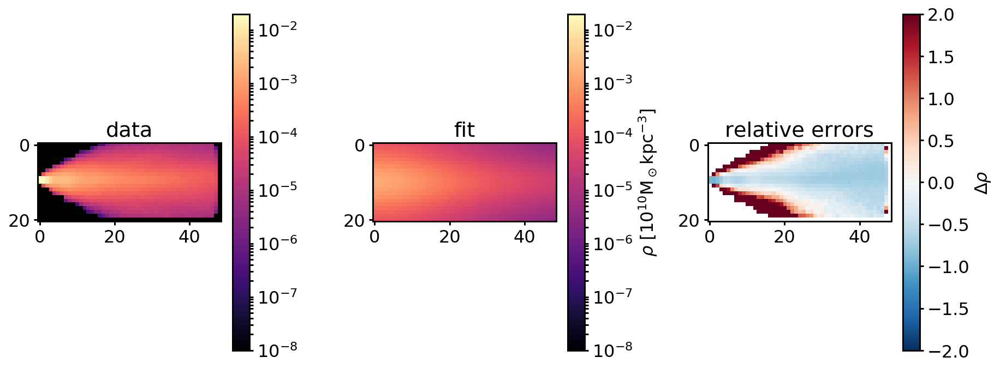

(21, 49)
a and b: 2.9989895724400313, 1.7747506941401945
Rho mean galpy: 0.0004107826145466171
Rho mean data: 0.00033879189738258395
93.2047970856 117.1251829752916
Circular velocity ar R=8kpc: 93.20479708558261 km/s and its error compared to the data: -0.20422922963335016 km/s
Multiply rho error with 0.04170957823663167
Error: 90877607178669.48
Error multiplied by vcirc error: 3790466666576.5947
data max: 0.019812705986395618, fit max: 0.008734023154620473, chosen max: 0.019812705986395618


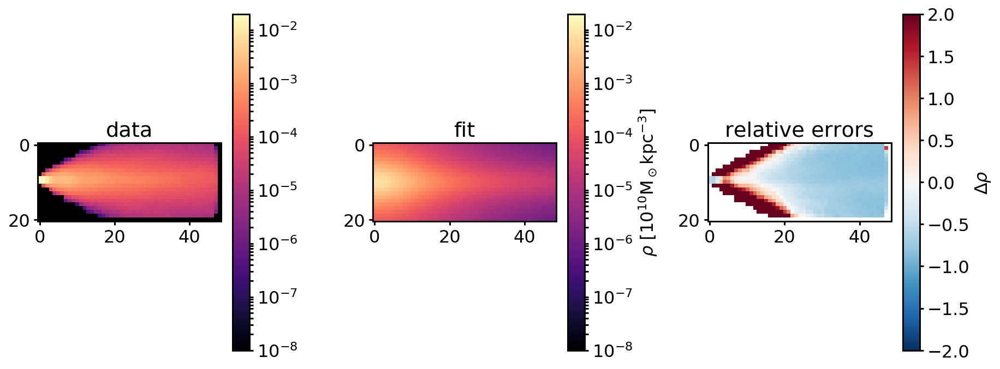

(21, 49)
a and b: 4.232596937454576, 3.3256662820476426
Rho mean galpy: 0.00024078102053453105
Rho mean data: 0.00033879189738258395
72.586126294 117.1251829752916
Circular velocity ar R=8kpc: 72.58612629397174 km/s and its error compared to the data: -0.38026883331072947 km/s
Multiply rho error with 0.14460438558750335
Error: 84376841005298.95
Error multiplied by vcirc error: 12201261251385.715
data max: 0.019812705986395618, fit max: 0.0020074857842729632, chosen max: 0.019812705986395618


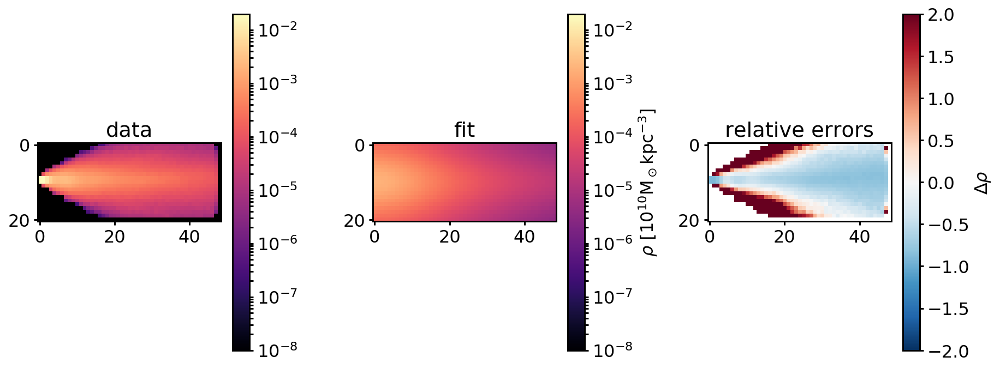

(21, 49)
a and b: 0.5176424780522533, 0.10028029439664499
Rho mean galpy: 0.0089472469850574
Rho mean data: 0.00033879189738258395
116.603821092 117.1251829752916
Circular velocity ar R=8kpc: 116.60382109245748 km/s and its error compared to the data: -0.004451321821576997 km/s
Multiply rho error with 1.9814265959247552e-05
Error: 1.119957988387697e+19
Error multiplied by vcirc error: 221911454450977.12
data max: 0.019812705986395618, fit max: 6.266878486358093, chosen max: 6.266878486358093


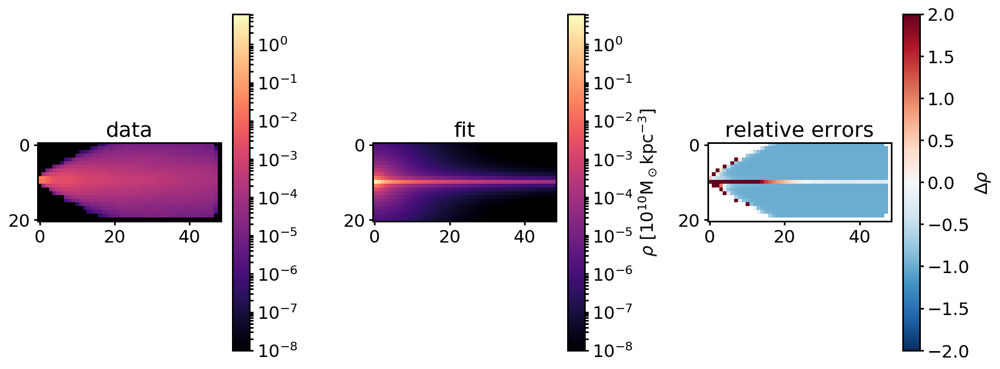

(21, 49)
a and b: 4.239379001154004, 2.5368296725862494
Rho mean galpy: 0.0002742456704830093
Rho mean data: 0.00033879189738258395
78.0704353428 117.1251829752916
Circular velocity ar R=8kpc: 78.07043534278297 km/s and its error compared to the data: -0.3334444962254403 km/s
Multiply rho error with 0.11118523206303768
Error: 84485011131575.16
Error multiplied by vcirc error: 9393485568512.506
data max: 0.019812705986395618, fit max: 0.003045035610682035, chosen max: 0.019812705986395618


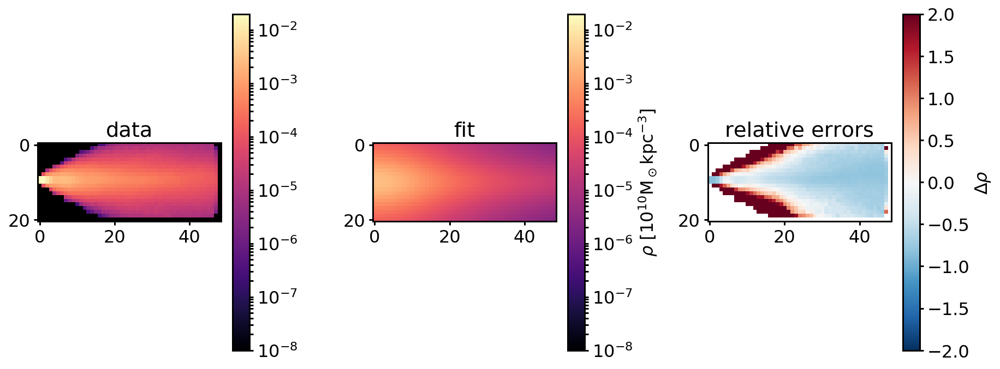

(21, 49)
a and b: 1.259420722151677, 1.612441220710763
Rho mean galpy: 0.0007654818239268207
Rho mean data: 0.00033879189738258395
106.94678531 117.1251829752916
Circular velocity ar R=8kpc: 106.94678530972396 km/s and its error compared to the data: -0.08690187205696692 km/s
Multiply rho error with 0.007551935367005449
Error: 138784027302871.03
Error multiplied by vcirc error: 1048088004164.0016
data max: 0.019812705986395618, fit max: 0.03219820089691407, chosen max: 0.03219820089691407


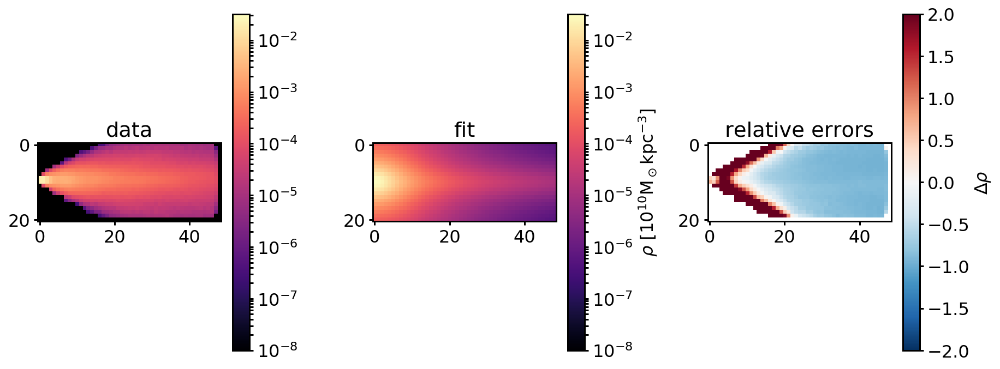

(21, 49)
a and b: 6.057040192282539, 2.271071234320289
Rho mean galpy: 0.00021002268849447877
Rho mean data: 0.00033879189738258395
67.5339769933 117.1251829752916
Circular velocity ar R=8kpc: 67.53397699332663 km/s and its error compared to the data: -0.4234034451192839 km/s
Multiply rho error with 0.17927047733887846
Error: 83972785150036.97
Error multiplied by vcirc error: 15053841277322.213
data max: 0.019812705986395618, fit max: 0.001990808932717704, chosen max: 0.019812705986395618


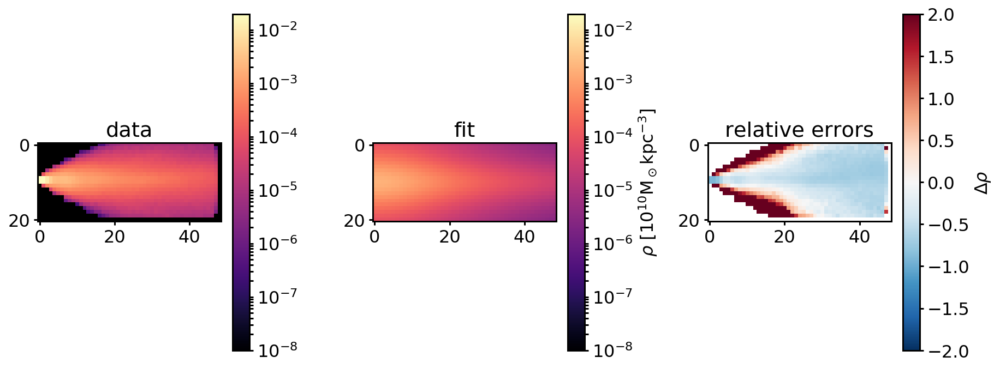

(21, 49)
a and b: 0.3030294897230279, 4.4966559226766885
Rho mean galpy: 0.00044713068641235275
Rho mean data: 0.00033879189738258395
93.005236725 117.1251829752916
Circular velocity ar R=8kpc: 93.00523672498393 km/s and its error compared to the data: -0.20593305075472915 km/s
Multiply rho error with 0.04240842139314985
Error: 99246748729661.52
Error multiplied by vcirc error: 4208897942027.545
data max: 0.019812705986395618, fit max: 0.005618532415723226, chosen max: 0.019812705986395618


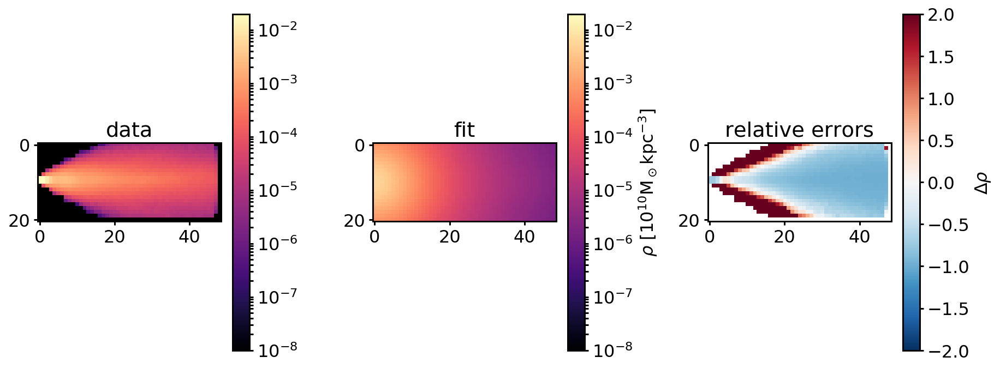

(21, 49)
a and b: 4.471521991168137, 1.5682888627333558
Rho mean galpy: 0.0003038054213026524
Rho mean data: 0.00033879189738258395
83.5079385764 117.1251829752916
Circular velocity ar R=8kpc: 83.50793857635313 km/s and its error compared to the data: -0.2870197812713793 km/s
Multiply rho error with 0.08238035484107041
Error: 88709884466273.28
Error multiplied by vcirc error: 7307951760241.953
data max: 0.019812705986395618, fit max: 0.0053853868272562295, chosen max: 0.019812705986395618


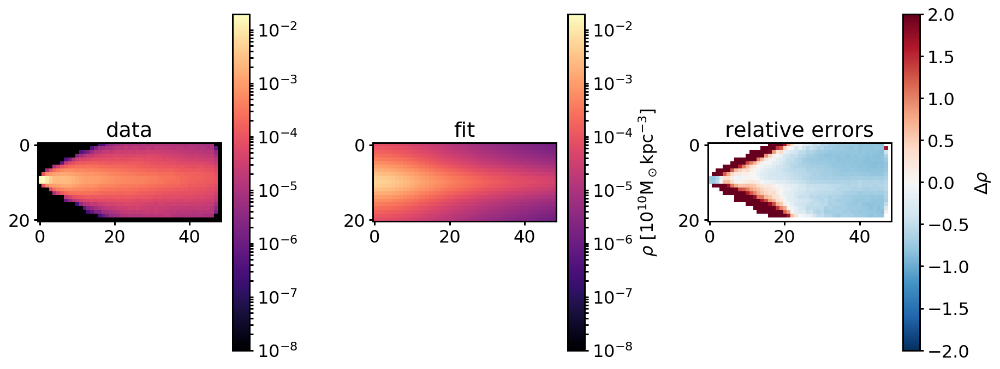

(21, 49)
a and b: 6.121344445859212, 1.8283687243212046
Rho mean galpy: 0.00021980880315929248
Rho mean data: 0.00033879189738258395
69.9721479514 117.1251829752916
Circular velocity ar R=8kpc: 69.97214795138727 km/s and its error compared to the data: -0.4025866498227934 km/s
Multiply rho error with 0.16207601061554047
Error: 84492227146509.44
Error multiplied by vcirc error: 13694163103928.32
data max: 0.019812705986395618, fit max: 0.0025637376537783903, chosen max: 0.019812705986395618


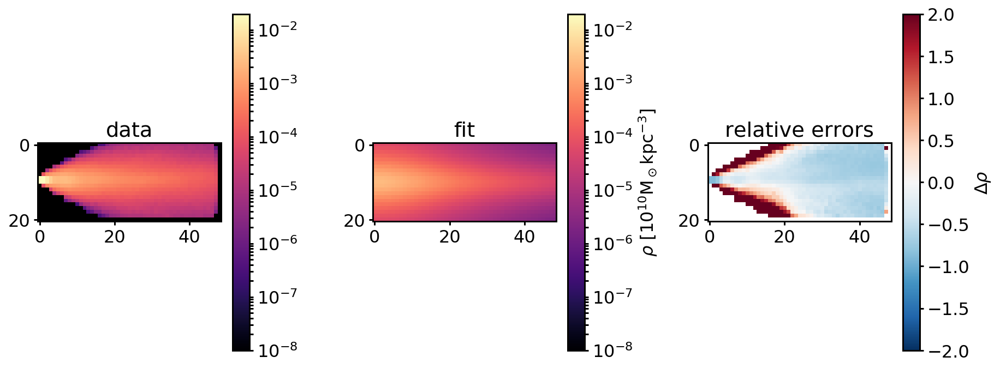

(21, 49)
a and b: 2.048071945081045, 1.7746081945444323
Rho mean galpy: 0.0005418049353334436
Rho mean data: 0.00033879189738258395
100.384108927 117.1251829752916
Circular velocity ar R=8kpc: 100.384108927412 km/s and its error compared to the data: -0.14293317305989817 km/s
Multiply rho error with 0.020429891960970798
Error: 99576142106942.42
Error multiplied by vcirc error: 2034329825135.109
data max: 0.019812705986395618, fit max: 0.015045243417023188, chosen max: 0.019812705986395618


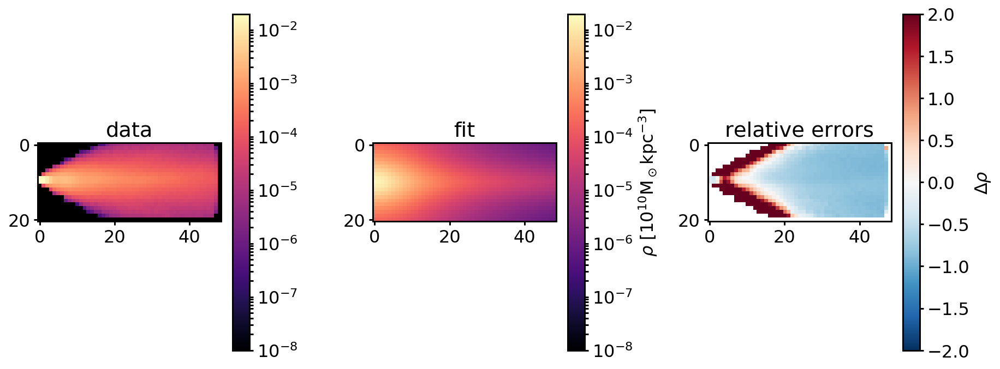

(21, 49)
a and b: 5.574059275712921, 0.2623607737350828
Rho mean galpy: 0.0003338588511179402
Rho mean data: 0.00033879189738258395
85.0459677655 117.1251829752916
Circular velocity ar R=8kpc: 85.04596776554064 km/s and its error compared to the data: -0.27388828256104664 km/s
Multiply rho error with 0.07501479132423973
Error: 8117185125438700.0
Error multiplied by vcirc error: 608908948325006.8
data max: 0.019812705986395618, fit max: 0.024735126190530914, chosen max: 0.024735126190530914


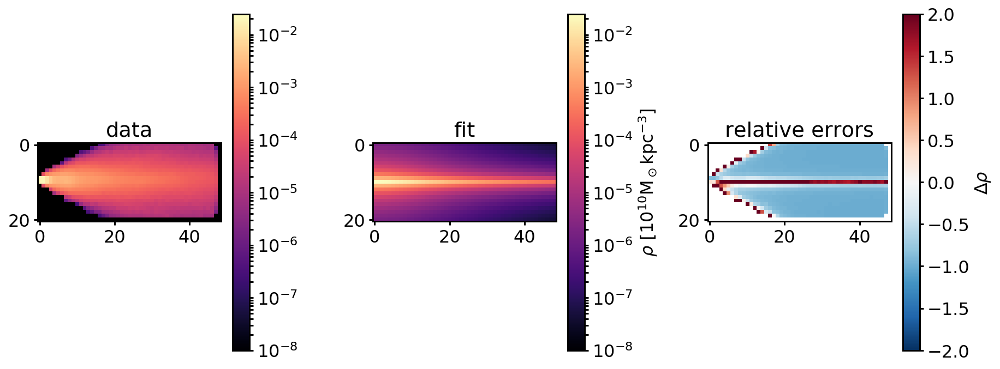

(21, 49)
a and b: 0.3269180327859935, 2.025862543826233
Rho mean galpy: 0.0010399997053196232
Rho mean data: 0.00033879189738258395
110.060116557 117.1251829752916
Circular velocity ar R=8kpc: 110.06011655724188 km/s and its error compared to the data: -0.060320643593275214 km/s
Multiply rho error with 0.003638580043506934
Error: 229790171201459.66
Error multiplied by vcirc error: 836109931127.6729
data max: 0.019812705986395618, fit max: 0.04876655796505551, chosen max: 0.04876655796505551


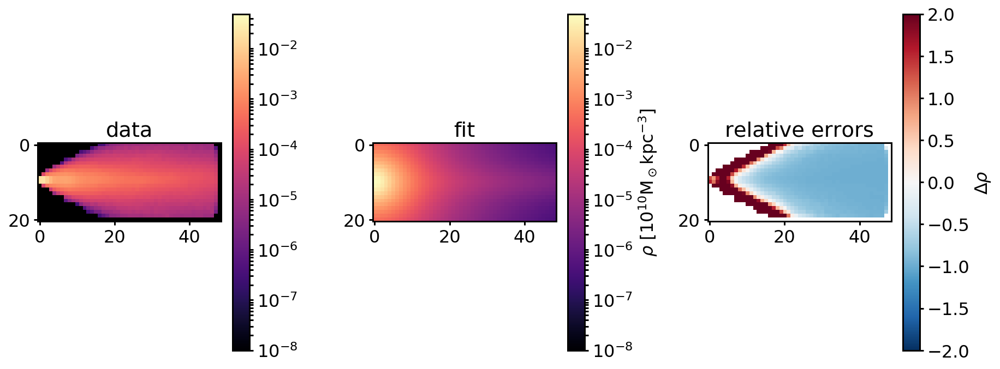

(21, 49)
a and b: 0.7306851356119388, 1.263489650084015
Rho mean galpy: 0.0011645151482057527
Rho mean data: 0.00033879189738258395
111.947666737 117.1251829752916
Circular velocity ar R=8kpc: 111.9476667368555 km/s and its error compared to the data: -0.04420497886887684 km/s
Multiply rho error with 0.0019540801567978477
Error: 398045853045277.5
Error multiplied by vcirc error: 777813502931.4489
data max: 0.019812705986395618, fit max: 0.0903360586770304, chosen max: 0.0903360586770304


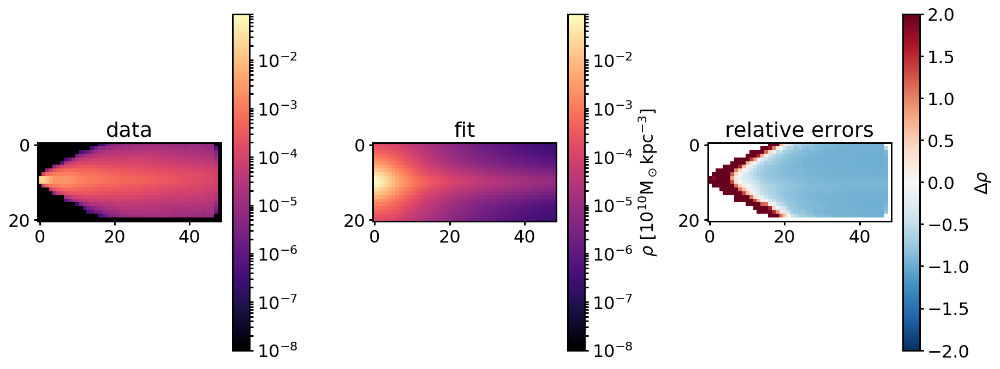

(21, 49)
a and b: 5.321398486906492, 0.7772048291107452
Rho mean galpy: 0.00028225671496401506
Rho mean data: 0.00033879189738258395
83.0658532244 117.1251829752916
Circular velocity ar R=8kpc: 83.0658532244373 km/s and its error compared to the data: -0.29079425009768695 km/s
Multiply rho error with 0.0845612958898761
Error: 178060407389640.06
Error multiplied by vcirc error: 15057018795547.234
data max: 0.019812705986395618, fit max: 0.008804739440295887, chosen max: 0.019812705986395618


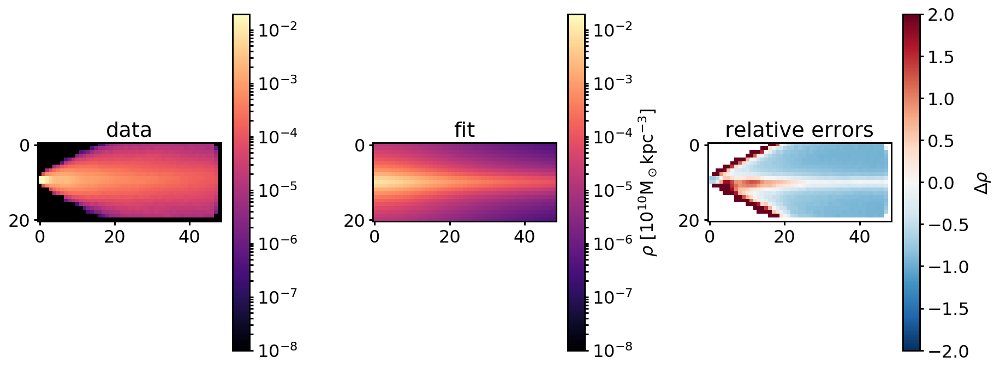

(21, 49)
a and b: 2.1725096209909673, 2.3746281363808888
Rho mean galpy: 0.0004528664807746265
Rho mean data: 0.00033879189738258395
94.9430624014 117.1251829752916
Circular velocity ar R=8kpc: 94.94306240136528 km/s and its error compared to the data: -0.18938814019702144 km/s
Multiply rho error with 0.035867867647286646
Error: 88430460262228.75
Error multiplied by vcirc error: 3171812044674.2617
data max: 0.019812705986395618, fit max: 0.008432871917187182, chosen max: 0.019812705986395618


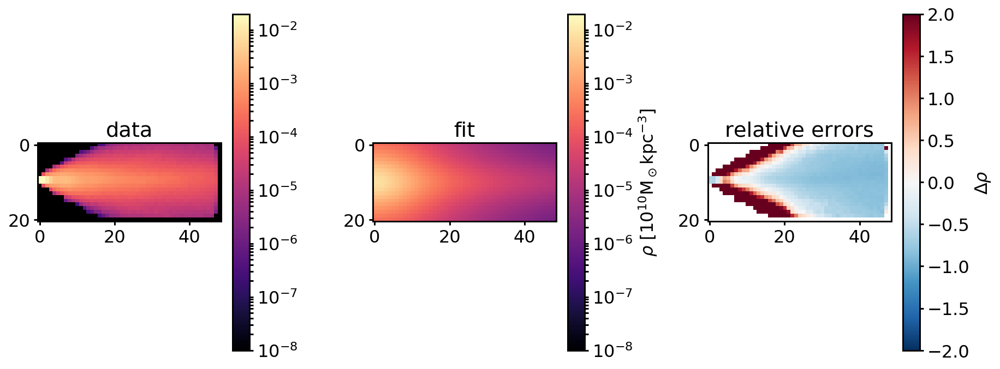

(21, 49)
a and b: 0.7600726779695348, 1.160870658990967
Rho mean galpy: 0.001200290507353069
Rho mean data: 0.00033879189738258395
112.303105302 117.1251829752916
Circular velocity ar R=8kpc: 112.30310530192035 km/s and its error compared to the data: -0.04117028935091177 km/s
Multiply rho error with 0.001694992725237799
Error: 496786871823883.6
Error multiplied by vcirc error: 842050133735.1257
data max: 0.019812705986395618, fit max: 0.10312412415007437, chosen max: 0.10312412415007437


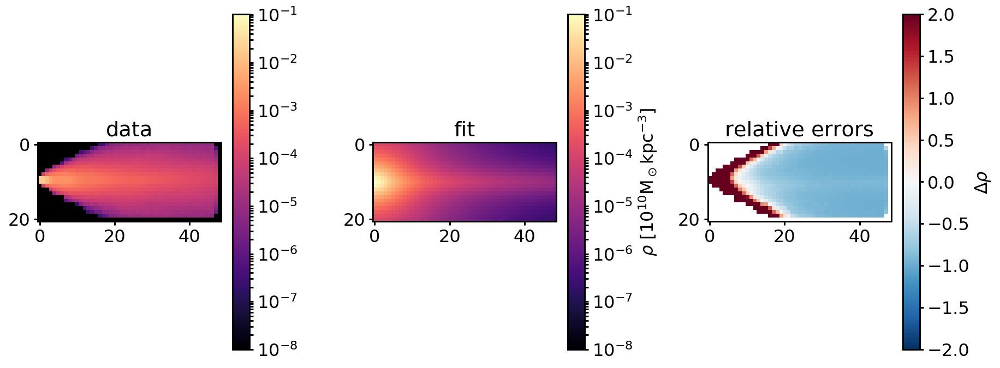

(21, 49)
a and b: 2.3120294932711274, 0.9250720133408794
Rho mean galpy: 0.0006033169926521101
Rho mean data: 0.00033879189738258395
104.534740484 117.1251829752916
Circular velocity ar R=8kpc: 104.53474048387206 km/s and its error compared to the data: -0.10749560574070209 km/s
Multiply rho error with 0.011555305253560464
Error: 266144874474245.7
Error multiplied by vcirc error: 3075385266220.4414
data max: 0.019812705986395618, fit max: 0.03276523513254706, chosen max: 0.03276523513254706


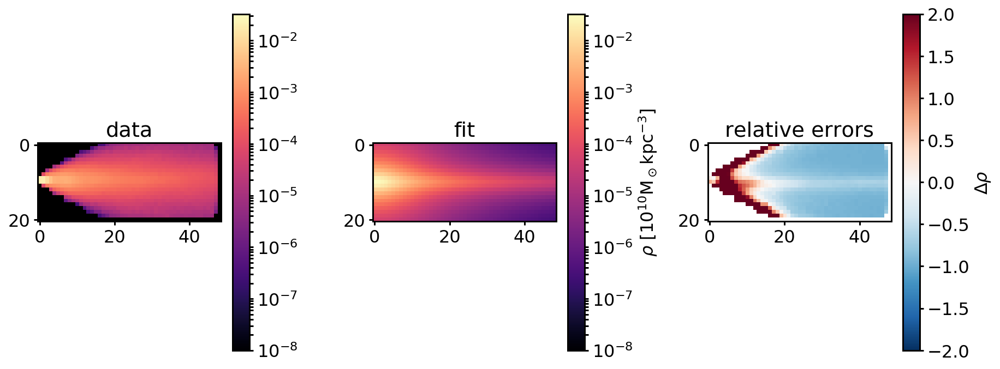

differential_evolution step 2: f(x)= 7.32101e+11
(21, 49)
a and b: 3.7773269594290344, 1.3365262404485339
Rho mean galpy: 0.0003653061798426214
Rho mean data: 0.00033879189738258395
90.5848489839 117.1251829752916
Circular velocity ar R=8kpc: 90.58484898389513 km/s and its error compared to the data: -0.22659801519366968 km/s
Multiply rho error with 0.05134666048971055
Error: 99150631123778.78
Error multiplied by vcirc error: 5091053793653.197
data max: 0.019812705986395618, fit max: 0.00882987677770337, chosen max: 0.019812705986395618


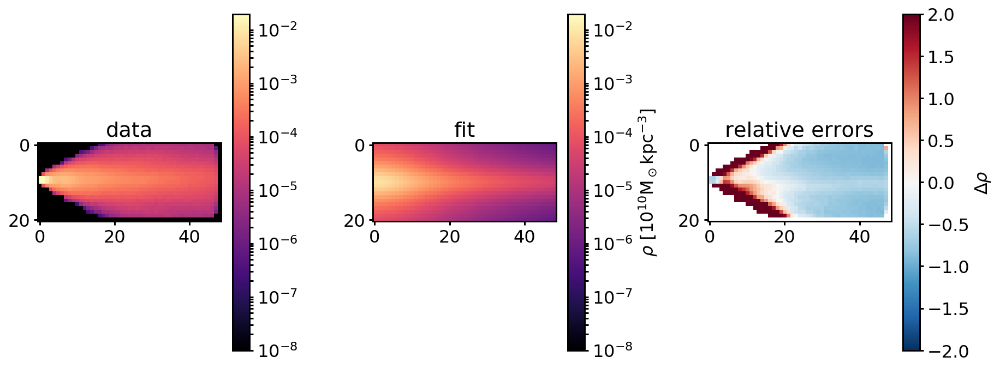

(21, 49)
a and b: 4.836073559412811, 1.0477401808726383
Rho mean galpy: 0.0003016684522418168
Rho mean data: 0.00033879189738258395
84.6864532605 117.1251829752916
Circular velocity ar R=8kpc: 84.68645326048333 km/s and its error compared to the data: -0.27695777193920323 km/s
Multiply rho error with 0.0767056074375277
Error: 112858058901305.84
Error multiplied by vcirc error: 8656845962244.945
data max: 0.019812705986395618, fit max: 0.007581936277043568, chosen max: 0.019812705986395618


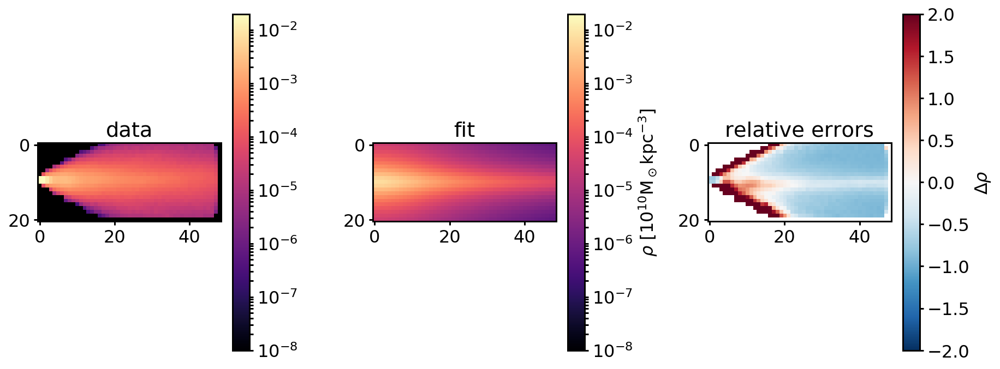

(21, 49)
a and b: 4.266545867650899, 3.823385267878689
Rho mean galpy: 0.0002199376624042946
Rho mean data: 0.00033879189738258395
69.0583672698 117.1251829752916
Circular velocity ar R=8kpc: 69.05836726976422 km/s and its error compared to the data: -0.4103883937211643 km/s
Multiply rho error with 0.16841863370103738
Error: 84441803733003.9
Error multiplied by vcirc error: 14221573211963.676
data max: 0.019812705986395618, fit max: 0.00157722522635361, chosen max: 0.019812705986395618


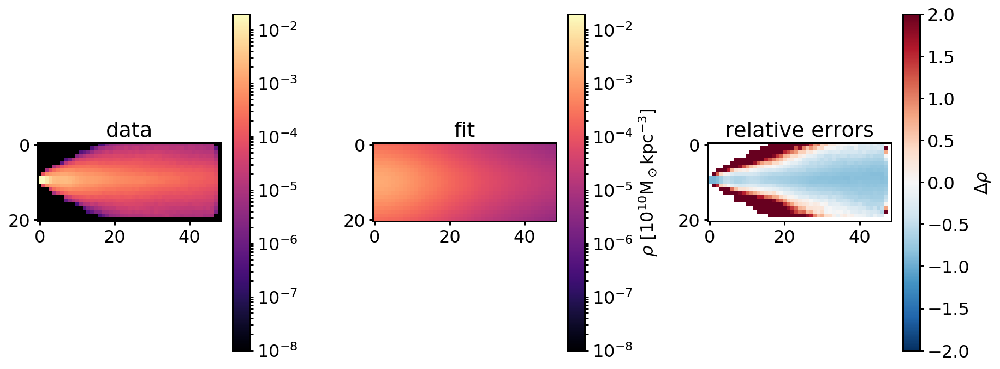

(21, 49)
a and b: 0.5508158255751372, 0.646963297008786
Rho mean galpy: 0.0019630561287014062
Rho mean data: 0.00033879189738258395
115.19385211 117.1251829752916
Circular velocity ar R=8kpc: 115.19385211005012 km/s and its error compared to the data: -0.016489458681562152 km/s
Multiply rho error with 0.00027190224761094545
Error: 6226105465588860.0
Error multiplied by vcirc error: 1692892069956.403
data max: 0.019812705986395618, fit max: 0.4381251432325513, chosen max: 0.4381251432325513


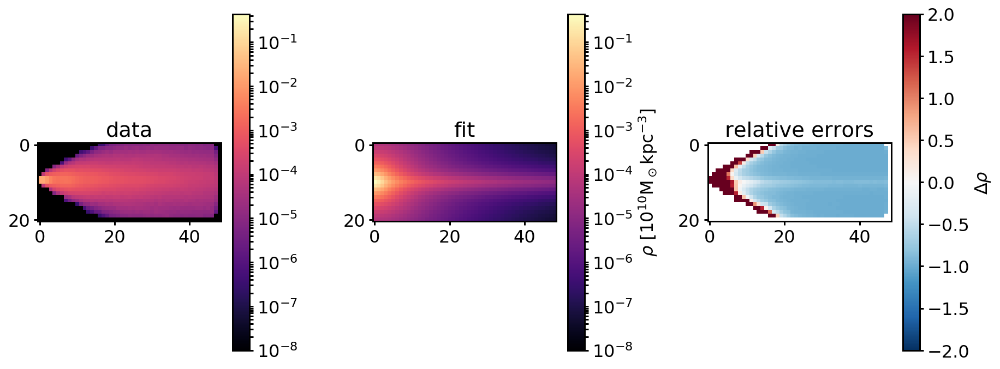

(21, 49)
a and b: 7.864687290270148, 1.1205816968683693
Rho mean galpy: 0.0001832976756716547
Rho mean data: 0.00033879189738258395
63.5118782619 117.1251829752916
Circular velocity ar R=8kpc: 63.5118782619439 km/s and its error compared to the data: -0.457743615432881 km/s
Multiply rho error with 0.20952921746956527
Error: 92178422798359.03
Error multiplied by vcirc error: 19314072796518.902
data max: 0.019812705986395618, fit max: 0.0028027914260757595, chosen max: 0.019812705986395618


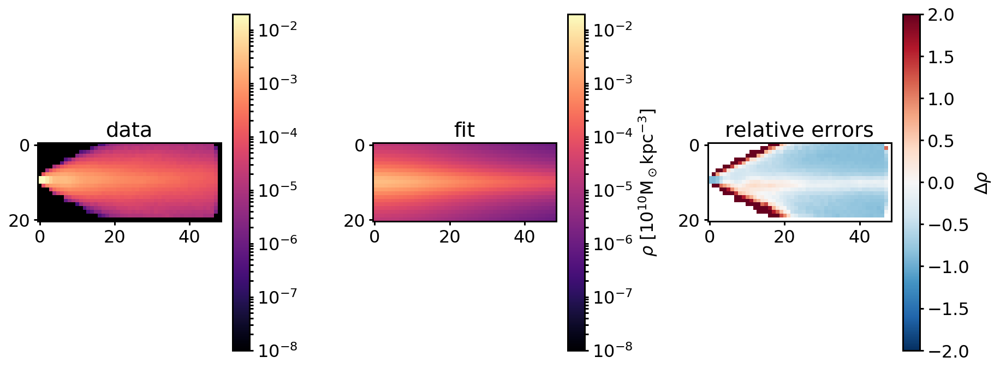

(21, 49)
a and b: 2.990513810624275, 1.394710182527348
Rho mean galpy: 0.00044213976686676364
Rho mean data: 0.00033879189738258395
96.1777472297 117.1251829752916
Circular velocity ar R=8kpc: 96.17774722967926 km/s and its error compared to the data: -0.17884655727736495 km/s
Multiply rho error with 0.03198609104996578
Error: 104153046264995.14
Error multiplied by vcirc error: 3331448820963.433
data max: 0.019812705986395618, fit max: 0.012354506899074129, chosen max: 0.019812705986395618


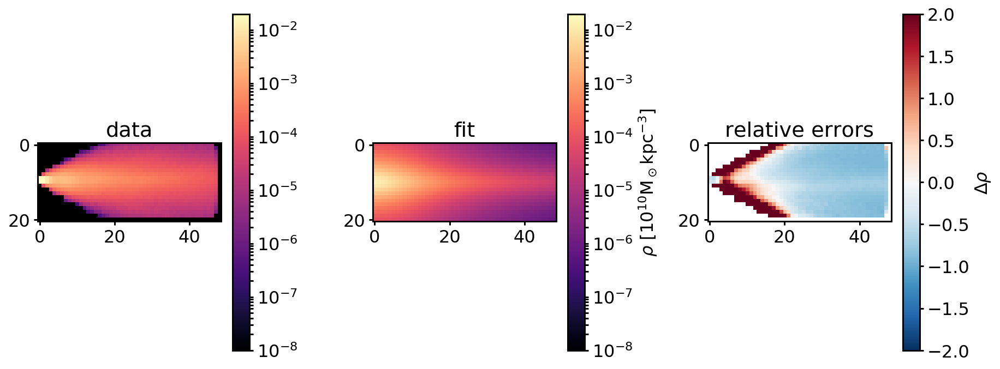

(21, 49)
a and b: 3.1393391833799207, 2.006252239352756
Rho mean galpy: 0.0003796839459837522
Rho mean data: 0.00033879189738258395
90.3402356194 117.1251829752916
Circular velocity ar R=8kpc: 90.34023561940694 km/s and its error compared to the data: -0.22868649316462655 km/s
Multiply rho error with 0.05229751215593479
Error: 87554602755189.75
Error multiplied by vcirc error: 4578887901897.577
data max: 0.019812705986395618, fit max: 0.006790150326931044, chosen max: 0.019812705986395618


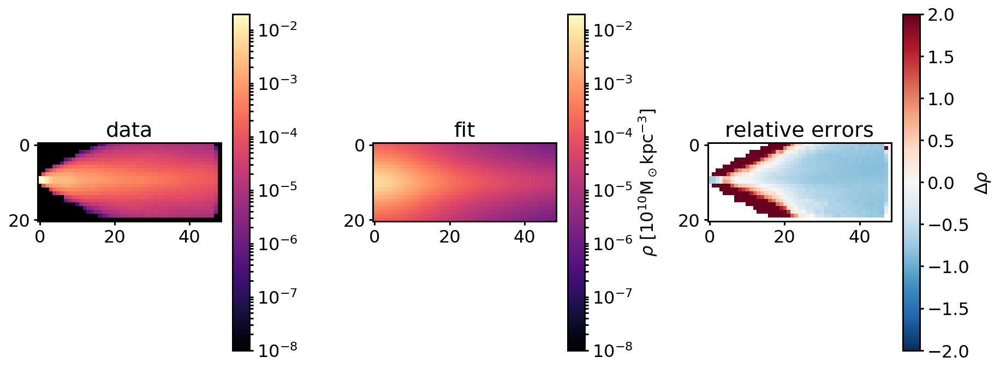

(21, 49)
a and b: 2.3821420535610978, 1.397881607519861
Rho mean galpy: 0.0005302350887612954
Rho mean data: 0.00033879189738258395
100.695822952 117.1251829752916
Circular velocity ar R=8kpc: 100.69582295233656 km/s and its error compared to the data: -0.14027179813602453 km/s
Multiply rho error with 0.019676177352313615
Error: 115120222659265.31
Error multiplied by vcirc error: 2265125917881.5366
data max: 0.019812705986395618, fit max: 0.017621623120550163, chosen max: 0.019812705986395618


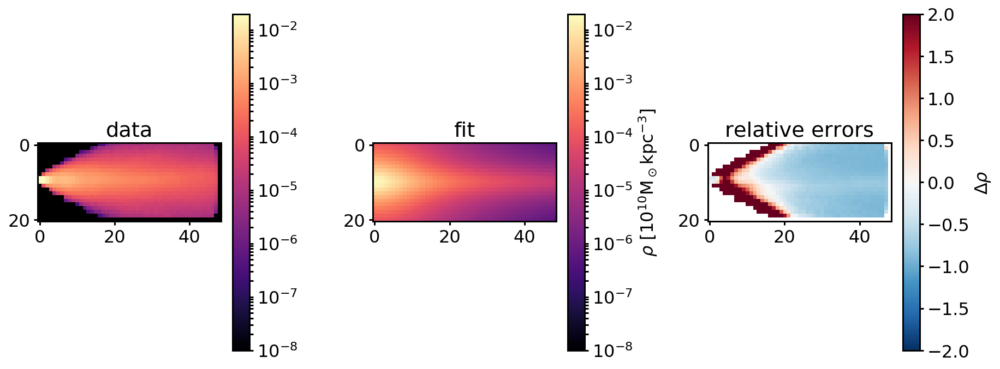

(21, 49)
a and b: 1.9068398090877752, 1.5855643992119046
Rho mean galpy: 0.0005962085265930951
Rho mean data: 0.00033879189738258395
102.761950908 117.1251829752916
Circular velocity ar R=8kpc: 102.76195090794312 km/s and its error compared to the data: -0.12263145894404712 km/s
Multiply rho error with 0.015038474722745514
Error: 112182241454920.44
Error multiplied by vcirc error: 1687049802460.755
data max: 0.019812705986395618, fit max: 0.01994644099663973, chosen max: 0.01994644099663973


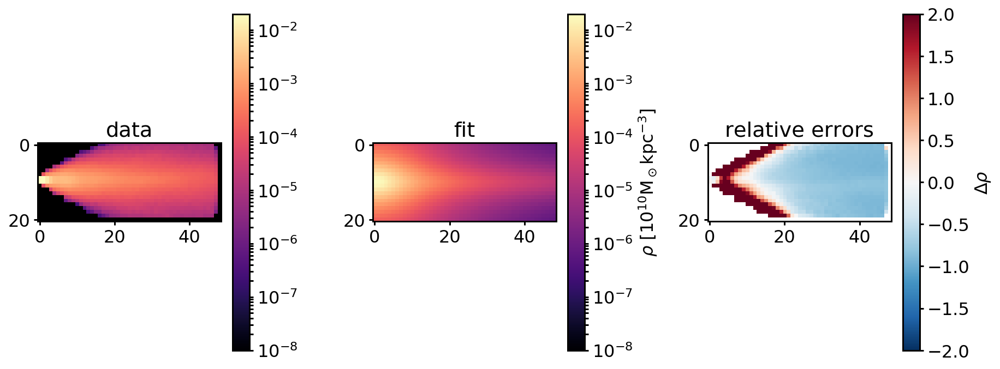

(21, 49)
a and b: 1.6134141814026886, 2.15914626638227
Rho mean galpy: 0.0005677628289627073
Rho mean data: 0.00033879189738258395
100.750231787 117.1251829752916
Circular velocity ar R=8kpc: 100.75023178741638 km/s and its error compared to the data: -0.13980726238292943 km/s
Multiply rho error with 0.019546070615009275
Error: 95730969889185.73
Error multiplied by vcirc error: 1871164297497.351
data max: 0.019812705986395618, fit max: 0.014116585776864069, chosen max: 0.019812705986395618


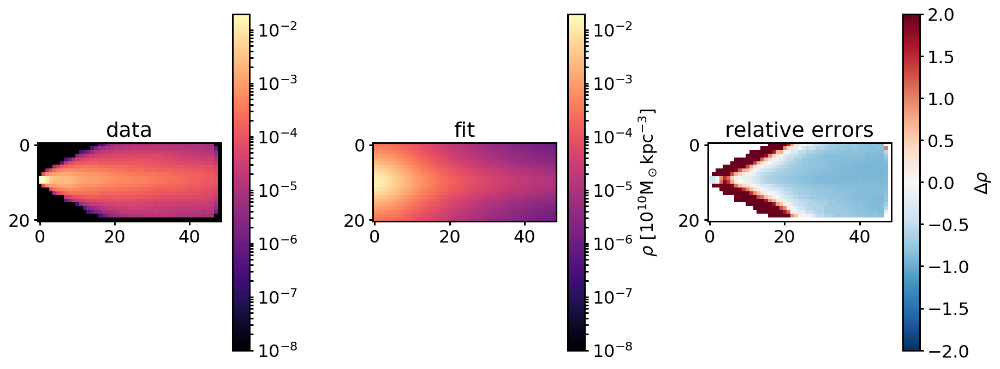

(21, 49)
a and b: 0.7638307117808854, 1.2718907738693659
Rho mean galpy: 0.0011354328273688965
Rho mean data: 0.00033879189738258395
111.741313373 117.1251829752916
Circular velocity ar R=8kpc: 111.74131337259833 km/s and its error compared to the data: -0.045966797796414396 km/s
Multiply rho error with 0.0021129464996564474
Error: 372300610926240.5
Error multiplied by vcirc error: 786651272676.5568
data max: 0.019812705986395618, fit max: 0.0854962926057798, chosen max: 0.0854962926057798


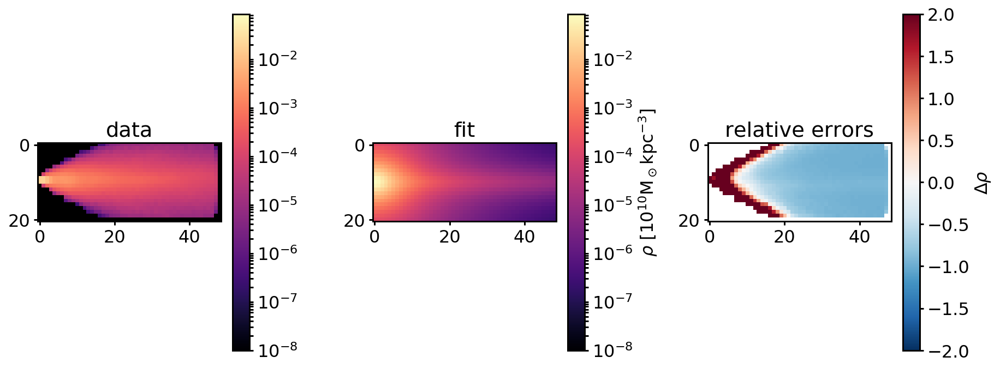

(21, 49)
a and b: 0.4005251604454809, 3.7627925051775573
Rho mean galpy: 0.0005367672868683661
Rho mean data: 0.00033879189738258395
97.8552908474 117.1251829752916
Circular velocity ar R=8kpc: 97.85529084738204 km/s and its error compared to the data: -0.16452390202006925 km/s
Multiply rho error with 0.027068114335909346
Error: 103174130619000.16
Error multiplied by vcirc error: 2792729164103.1416
data max: 0.019812705986395618, fit max: 0.008711115206467864, chosen max: 0.019812705986395618


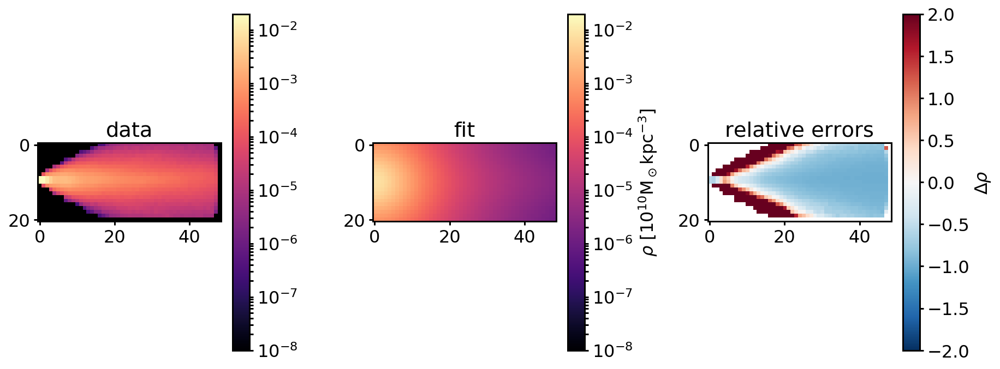

(21, 49)
a and b: 0.7422636506715108, 1.822299013060693
Rho mean galpy: 0.0009073559547007611
Rho mean data: 0.00033879189738258395
108.839854375 117.1251829752916
Circular velocity ar R=8kpc: 108.83985437539972 km/s and its error compared to the data: -0.07073908778131616 km/s
Multiply rho error with 0.005004018540132753
Error: 162277967652918.5
Error multiplied by vcirc error: 812041958790.2673
data max: 0.019812705986395618, fit max: 0.04066350266940112, chosen max: 0.04066350266940112


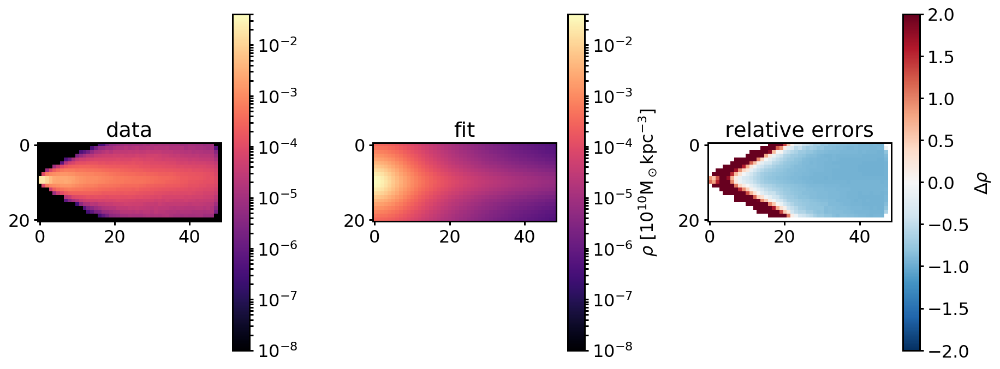

(21, 49)
a and b: 2.097139337269533, 1.7747506941401945
Rho mean galpy: 0.0005331823453697275
Rho mean data: 0.00033879189738258395
100.022995917 117.1251829752916
Circular velocity ar R=8kpc: 100.02299591682271 km/s and its error compared to the data: -0.1460163102761318 km/s
Multiply rho error with 0.02132076286665559
Error: 98850324263461.16
Error multiplied by vcirc error: 2107564322913.2668
data max: 0.019812705986395618, fit max: 0.014576351208174007, chosen max: 0.019812705986395618


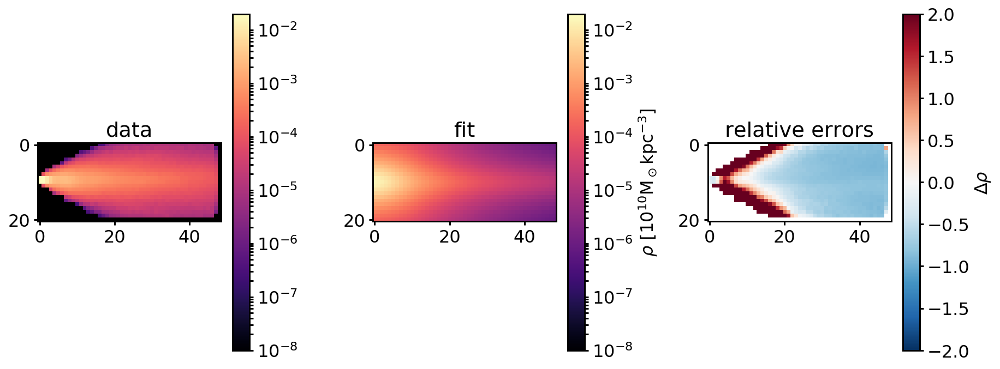

(21, 49)
a and b: 8.04704656366263, 0.7409237735486858
Rho mean galpy: 0.00018380252052987075
Rho mean data: 0.00033879189738258395
64.6909727177 117.1251829752916
Circular velocity ar R=8kpc: 64.6909727176949 km/s and its error compared to the data: -0.4476766560839274 km/s
Multiply rho error with 0.20041438840248704
Error: 149595847036709.7
Error multiplied by vcirc error: 29981160191414.176
data max: 0.019812705986395618, fit max: 0.004144858878795259, chosen max: 0.019812705986395618


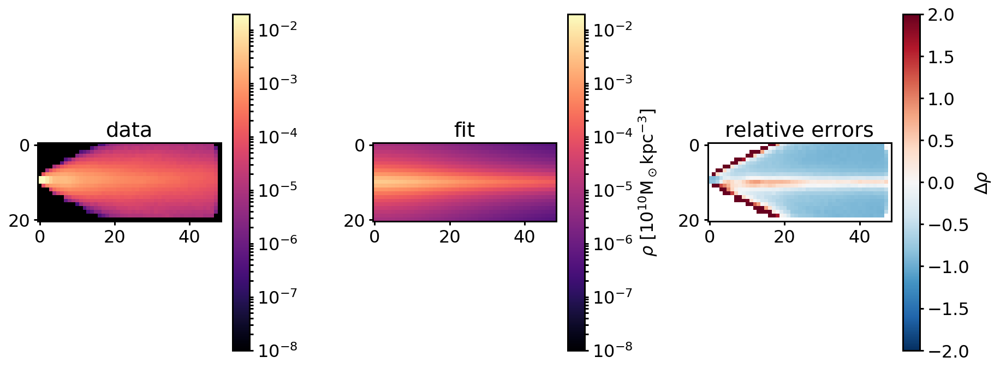

(21, 49)
a and b: 0.9124806866815618, 1.1312107871218393
Rho mean galpy: 0.001102424278411191
Rho mean data: 0.00033879189738258395
111.701344632 117.1251829752916
Circular velocity ar R=8kpc: 111.70134463239869 km/s and its error compared to the data: -0.04630804584558988 km/s
Multiply rho error with 0.002144435110037254
Error: 438080553361928.0
Error multiplied by vcirc error: 939435319653.8673
data max: 0.019812705986395618, fit max: 0.0893693294336231, chosen max: 0.0893693294336231


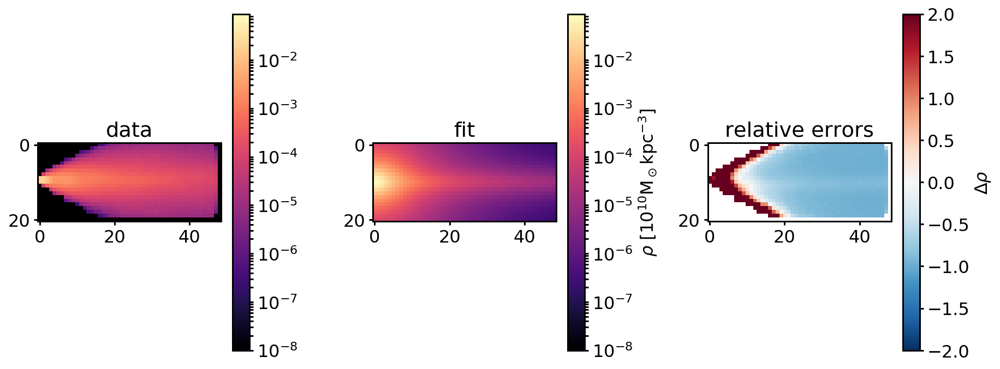

(21, 49)
a and b: 0.8720355406131661, 1.4322833887551185
Rho mean galpy: 0.0009918925155013474
Rho mean data: 0.00033879189738258395
110.328795215 117.1251829752916
Circular velocity ar R=8kpc: 110.32879521508332 km/s and its error compared to the data: -0.05802669919108706 km/s
Multiply rho error with 0.0033670978190129034
Error: 236003867846970.94
Error multiplied by vcirc error: 794648108706.1453
data max: 0.019812705986395618, fit max: 0.05926071287923047, chosen max: 0.05926071287923047


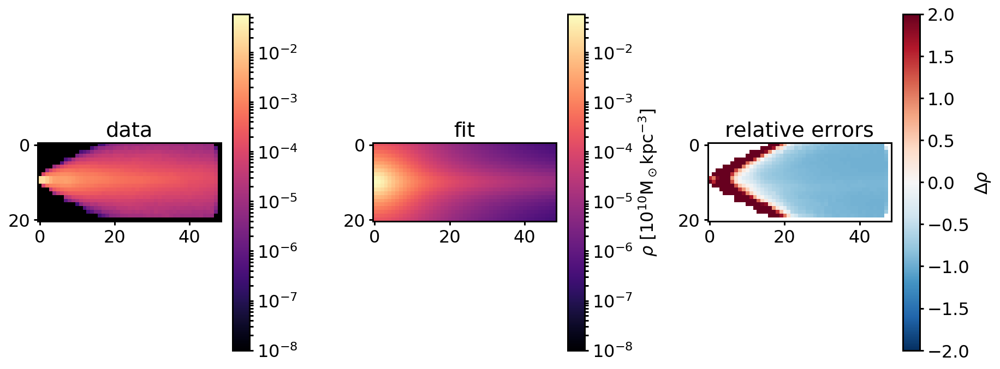

(21, 49)
a and b: 6.1344489671510605, 0.6692009234517453
Rho mean galpy: 0.0002464592376967561
Rho mean data: 0.00033879189738258395
77.872512757 117.1251829752916
Circular velocity ar R=8kpc: 77.87251275699205 km/s and its error compared to the data: -0.3351343342326319 km/s
Multiply rho error with 0.11231502198154943
Error: 230479317700997.5
Error multiplied by vcirc error: 25886289633880.047
data max: 0.019812705986395618, fit max: 0.007837456563801526, chosen max: 0.019812705986395618


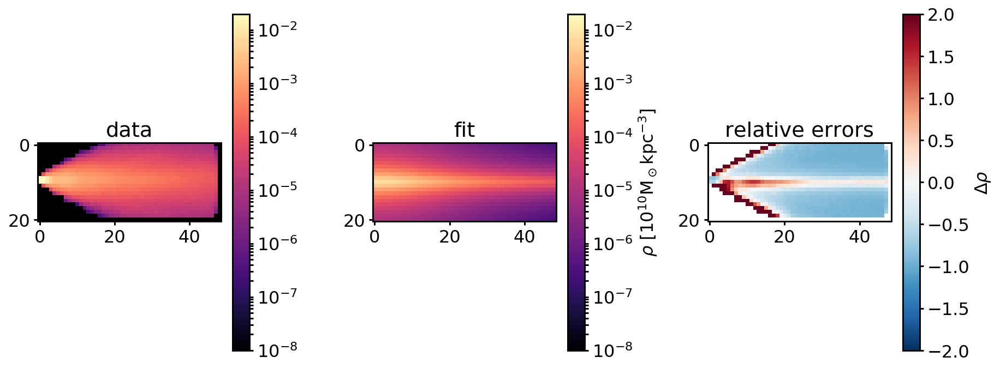

(21, 49)
a and b: 0.8217548574129365, 2.496363714685181
Rho mean galpy: 0.0006870708834309749
Rho mean data: 0.00033879189738258395
103.979153102 117.1251829752916
Circular velocity ar R=8kpc: 103.97915310240315 km/s and its error compared to the data: -0.11223914054129332 km/s
Multiply rho error with 0.012597624669448193
Error: 107287725149705.9
Error multiplied by vcirc error: 1351570493074.9124
data max: 0.019812705986395618, fit max: 0.01840759033764875, chosen max: 0.019812705986395618


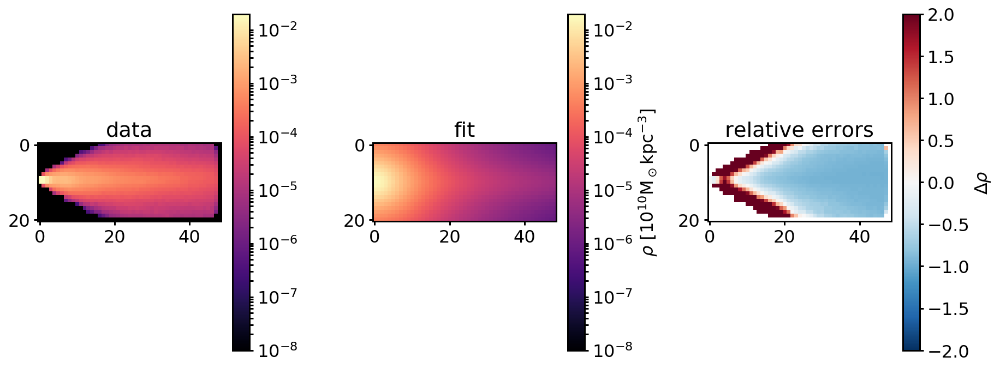

(21, 49)
a and b: 0.3030294897230279, 1.297811107319056
Rho mean galpy: 0.0015648116221310684
Rho mean data: 0.00033879189738258395
113.726614579 117.1251829752916
Circular velocity ar R=8kpc: 113.72661457892416 km/s and its error compared to the data: -0.02901654716803636 km/s
Multiply rho error with 0.0008419600095548789
Error: 864881649269252.8
Error multiplied by vcirc error: 728195761682.5795
data max: 0.019812705986395618, fit max: 0.1564446651345553, chosen max: 0.1564446651345553


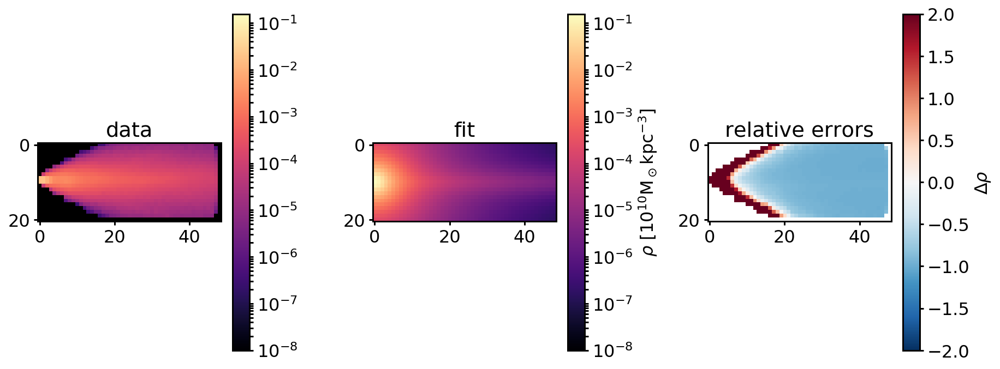

(21, 49)
a and b: 2.2693062572426275, 4.780863953048826
Rho mean galpy: 0.00026289504354710415
Rho mean data: 0.00033879189738258395
76.1116045138 117.1251829752916
Circular velocity ar R=8kpc: 76.1116045137839 km/s and its error compared to the data: -0.35016874611978027 km/s
Multiply rho error with 0.12261815075909913
Error: 85189965275728.62
Error multiplied by vcirc error: 10445836005341.713
data max: 0.019812705986395618, fit max: 0.002011107032907126, chosen max: 0.019812705986395618


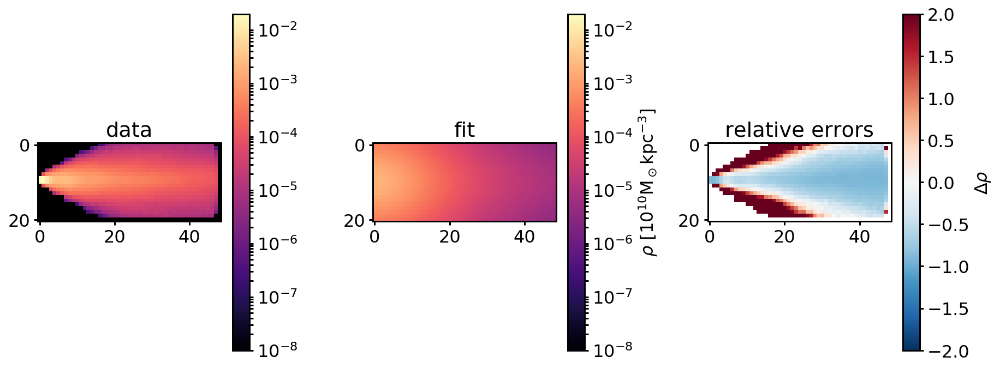

(21, 49)
a and b: 6.121344445859212, 1.915098397420805
Rho mean galpy: 0.00021752472394902082
Rho mean data: 0.00033879189738258395
69.4055206471 117.1251829752916
Circular velocity ar R=8kpc: 69.40552064710334 km/s and its error compared to the data: -0.40742444208821477 km/s
Multiply rho error with 0.16599467601089307
Error: 84285669695142.67
Error multiplied by vcirc error: 13990972433406.357
data max: 0.019812705986395618, fit max: 0.002422381531878042, chosen max: 0.019812705986395618


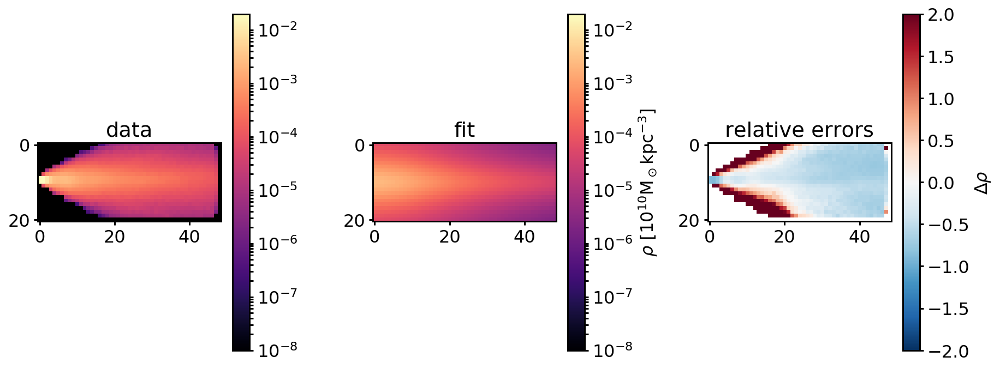

(21, 49)
a and b: 0.7414331643634791, 1.7746081945444323
Rho mean galpy: 0.0009251986143627264
Rho mean data: 0.00033879189738258395
109.12585271 117.1251829752916
Circular velocity ar R=8kpc: 109.12585271016461 km/s and its error compared to the data: -0.06829727016788953 km/s
Multiply rho error with 0.004664517112385693
Error: 170266030126471.3
Error multiplied by vcirc error: 794208811182.9033
data max: 0.019812705986395618, fit max: 0.04317995336598397, chosen max: 0.04317995336598397


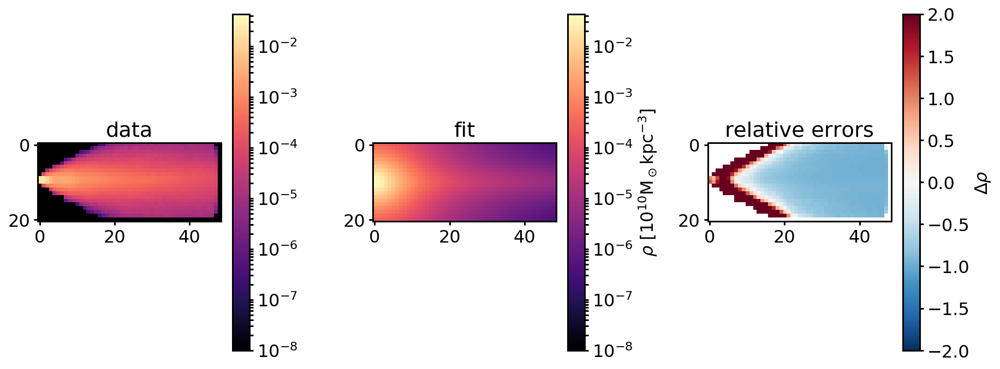

(21, 49)
a and b: 7.0565473497942275, 0.496014394457319
Rho mean galpy: 0.0002173740018616121
Rho mean data: 0.00033879189738258395
72.6248715461 117.1251829752916
Circular velocity ar R=8kpc: 72.62487154605206 km/s and its error compared to the data: -0.37993803124838826 km/s
Multiply rho error with 0.14435290758890126
Error: 525407195626801.5
Error multiplied by vcirc error: 75844056356859.44
data max: 0.019812705986395618, fit max: 0.008113819951452652, chosen max: 0.019812705986395618


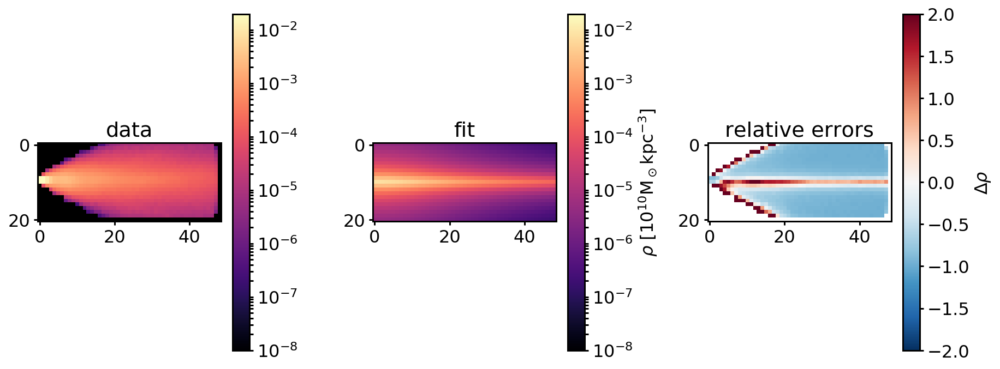

(21, 49)
a and b: 1.7933955184665553, 1.8428243807146072
Rho mean galpy: 0.0005804456300985369
Rho mean data: 0.00033879189738258395
101.737035221 117.1251829752916
Circular velocity ar R=8kpc: 101.73703522143683 km/s and its error compared to the data: -0.13138205945941625 km/s
Multiply rho error with 0.017261245547797587
Error: 101397013362336.4
Error multiplied by vcirc error: 1750238745460.6016
data max: 0.019812705986395618, fit max: 0.016711692602920974, chosen max: 0.019812705986395618


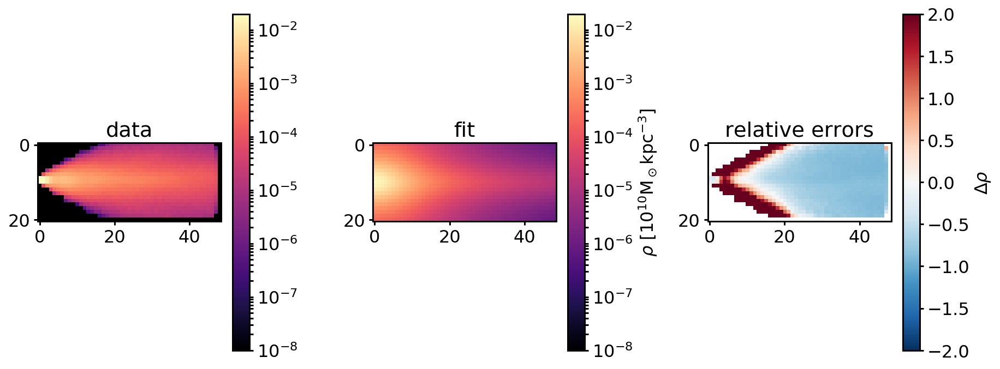

(21, 49)
a and b: 1.9915413021481037, 1.263489650084015
Rho mean galpy: 0.0006275406113335722
Rho mean data: 0.00033879189738258395
104.412377555 117.1251829752916
Circular velocity ar R=8kpc: 104.41237755527068 km/s and its error compared to the data: -0.1085403249504658 km/s
Multiply rho error with 0.011781002140352707
Error: 149628056566917.3
Error multiplied by vcirc error: 1762768454671.669
data max: 0.019812705986395618, fit max: 0.026812085814098784, chosen max: 0.026812085814098784


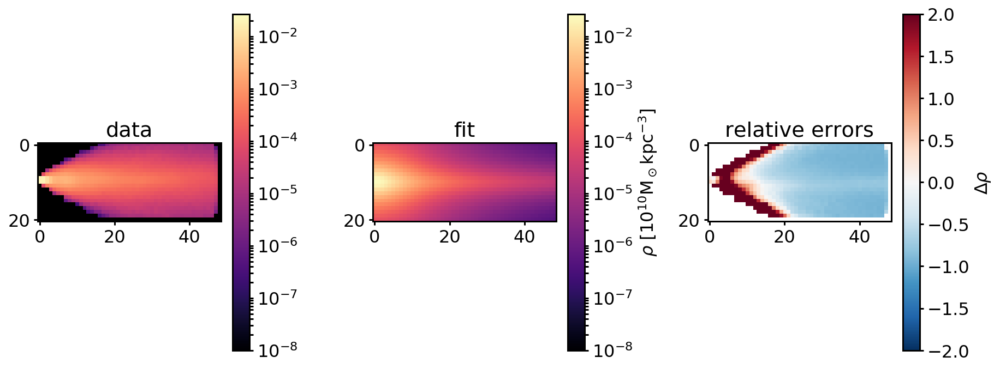

(21, 49)
a and b: 1.9616699146920062, 0.9724107584200505
Rho mean galpy: 0.000684152068098786
Rho mean data: 0.00033879189738258395
106.547480991 117.1251829752916
Circular velocity ar R=8kpc: 106.54748099128119 km/s and its error compared to the data: -0.09031108182978759 km/s
Multiply rho error with 0.00815609150126659
Error: 279882500734228.62
Error multiplied by vcirc error: 2282747285591.682
data max: 0.019812705986395618, fit max: 0.0400981361804281, chosen max: 0.0400981361804281


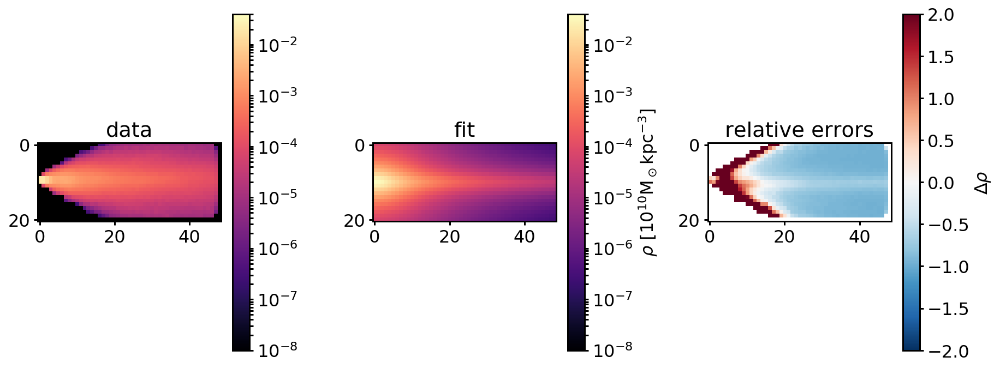

(21, 49)
a and b: 2.0211608911116126, 0.9018043386421217
Rho mean galpy: 0.0006796656029554282
Rho mean data: 0.00033879189738258395
106.619187951 117.1251829752916
Circular velocity ar R=8kpc: 106.61918795066745 km/s and its error compared to the data: -0.08969885687897246 km/s
Multiply rho error with 0.008045884925394384
Error: 337215392896078.25
Error multiplied by vcirc error: 2713196246313.5005
data max: 0.019812705986395618, fit max: 0.04236849546889614, chosen max: 0.04236849546889614


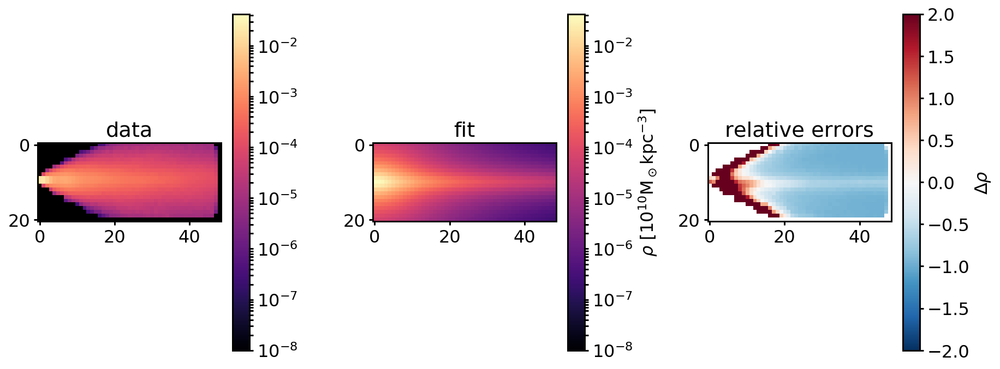

(21, 49)
a and b: 2.927798605929758, 1.160870658990967
Rho mean galpy: 0.0004699372076120522
Rho mean data: 0.00033879189738258395
98.4148490429 117.1251829752916
Circular velocity ar R=8kpc: 98.41484904294698 km/s and its error compared to the data: -0.1597464649108953 km/s
Multiply rho error with 0.025518933051527908
Error: 130484490821581.88
Error multiplied by vcirc error: 3329824985538.656
data max: 0.019812705986395618, fit max: 0.016356670277469475, chosen max: 0.019812705986395618


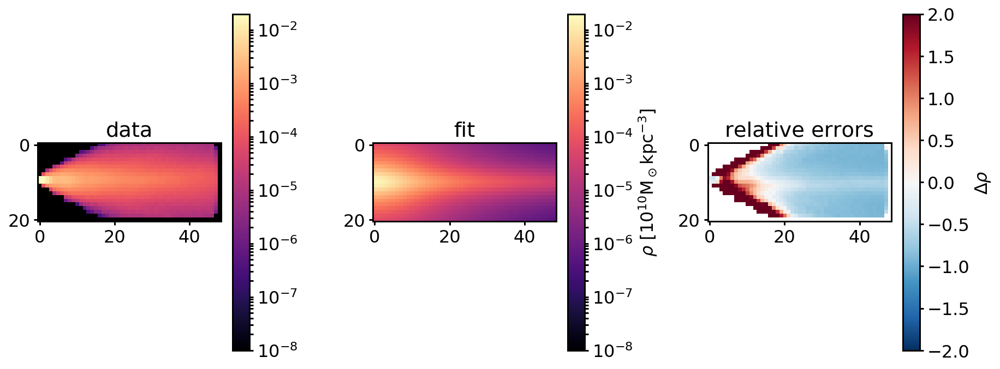

(21, 49)
a and b: 1.8816039715170372, 2.7948479544654097
Rho mean galpy: 0.000445228172923746
Rho mean data: 0.00033879189738258395
93.9522511081 117.1251829752916
Circular velocity ar R=8kpc: 93.95225110811857 km/s and its error compared to the data: -0.19784756171575432 km/s
Multiply rho error with 0.03914365767686921
Error: 87604551552217.9
Error multiplied by vcirc error: 3429162576895.659
data max: 0.019812705986395618, fit max: 0.007274602737742682, chosen max: 0.019812705986395618


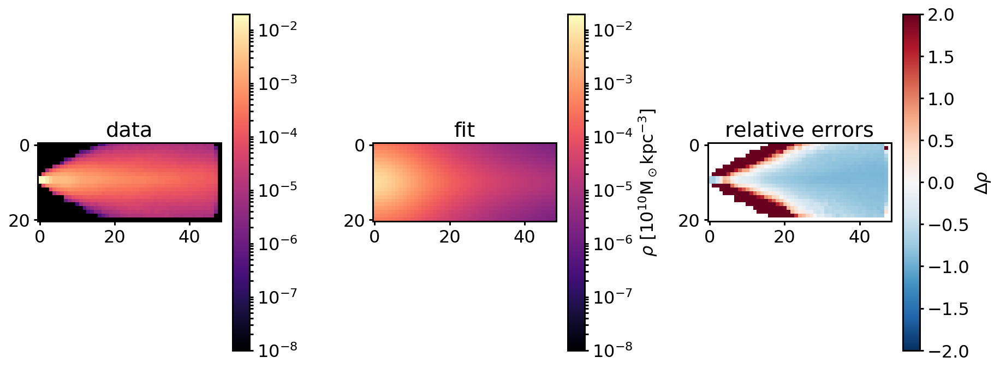

differential_evolution step 3: f(x)= 7.28196e+11
(21, 49)
a and b: 0.2842530905211156, 1.2930520150910494
Rho mean galpy: 0.0015947063545659178
Rho mean data: 0.00033879189738258395
113.822558362 117.1251829752916
Circular velocity ar R=8kpc: 113.82255836242895 km/s and its error compared to the data: -0.02819739127800856 km/s
Multiply rho error with 0.0007950928748851132
Error: 925283106557976.9
Error multiplied by vcirc error: 735686005275.8104
data max: 0.019812705986395618, fit max: 0.16274466282805317, chosen max: 0.16274466282805317


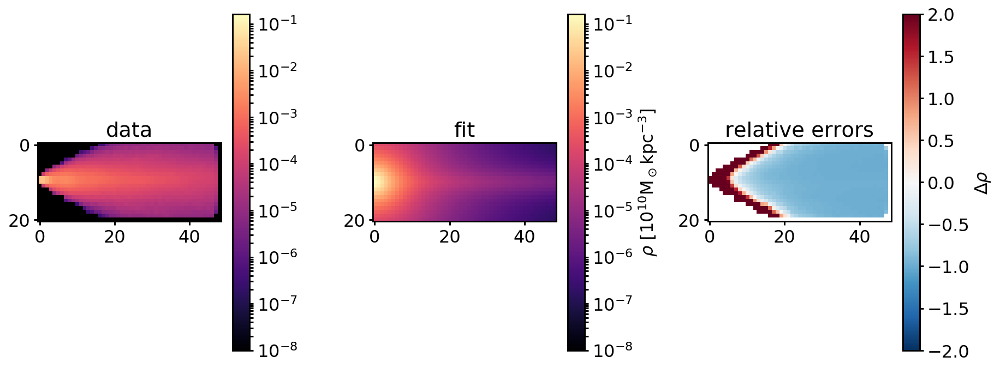

(21, 49)
a and b: 1.854722110494461, 2.020949556523944
Rho mean galpy: 0.0005430290868960732
Rho mean data: 0.00033879189738258395
99.9951805762 117.1251829752916
Circular velocity ar R=8kpc: 99.99518057618799 km/s and its error compared to the data: -0.14625379413680234 km/s
Multiply rho error with 0.02139017229941016
Error: 95384745590021.69
Error multiplied by vcirc error: 2040296142905.9673
data max: 0.019812705986395618, fit max: 0.01361553588829246, chosen max: 0.019812705986395618


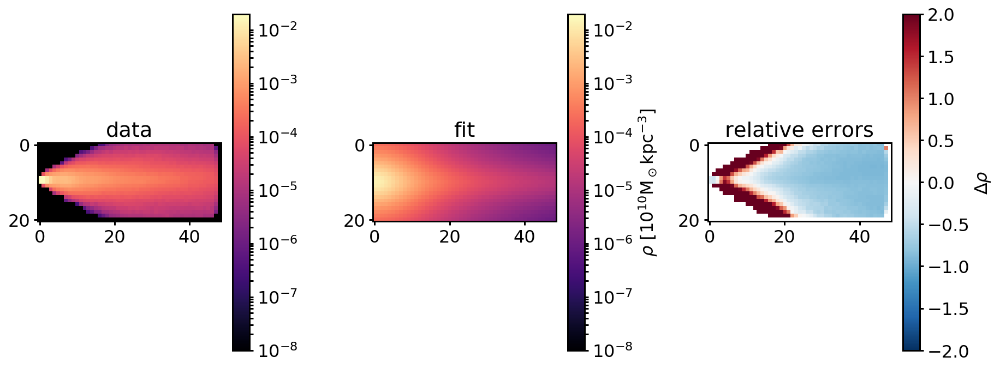

(21, 49)
a and b: 4.895602929331477, 1.2109800494505987
Rho mean galpy: 0.00029254145333852915
Rho mean data: 0.00033879189738258395
83.0059435632 117.1251829752916
Circular velocity ar R=8kpc: 83.005943563194 km/s and its error compared to the data: -0.29130575120890356 km/s
Multiply rho error with 0.08485904068738362
Error: 98176728845173.6
Error multiplied by vcirc error: 8331183027626.815
data max: 0.019812705986395618, fit max: 0.0062722182810755036, chosen max: 0.019812705986395618


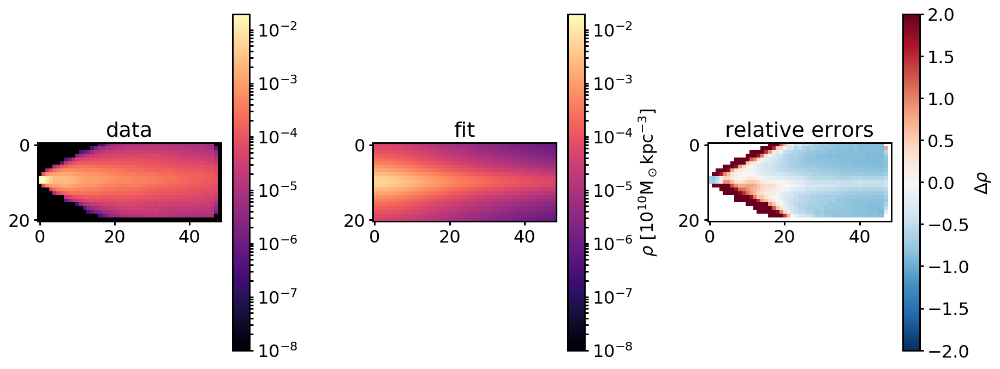

(21, 49)
a and b: 2.6623838343095425, 1.268065321081985
Rho mean galpy: 0.0004986708701336175
Rho mean data: 0.00033879189738258395
99.5912700885 117.1251829752916
Circular velocity ar R=8kpc: 99.59127008846487 km/s and its error compared to the data: -0.14970233080041917 km/s
Multiply rho error with 0.02241078784707813
Error: 122072886006900.81
Error multiplied by vcirc error: 2735749550181.207
data max: 0.019812705986395618, fit max: 0.016998464767720524, chosen max: 0.019812705986395618


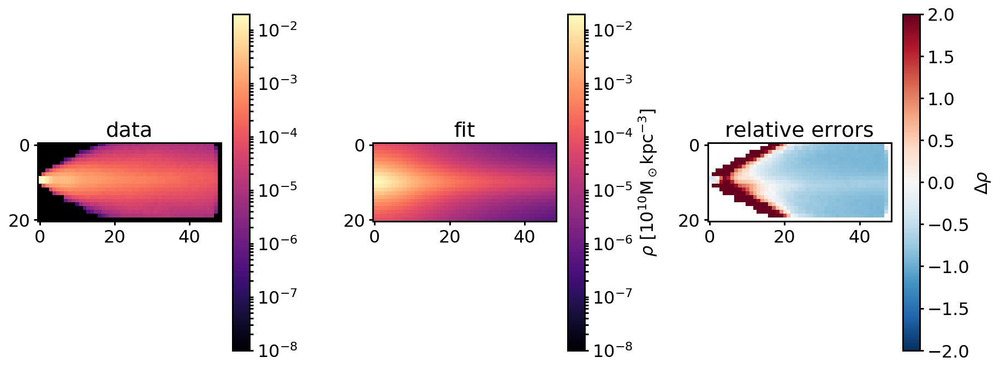

(21, 49)
a and b: 4.606488580592481, 1.3005942301826168
Rho mean galpy: 0.0003064299078184942
Rho mean data: 0.00033879189738258395
84.510181183 117.1251829752916
Circular velocity ar R=8kpc: 84.51018118295501 km/s and its error compared to the data: -0.2784627606448816 km/s
Multiply rho error with 0.07754150906596863
Error: 95350870541420.39
Error multiplied by vcirc error: 7393650392535.55
data max: 0.019812705986395618, fit max: 0.006435932292866821, chosen max: 0.019812705986395618


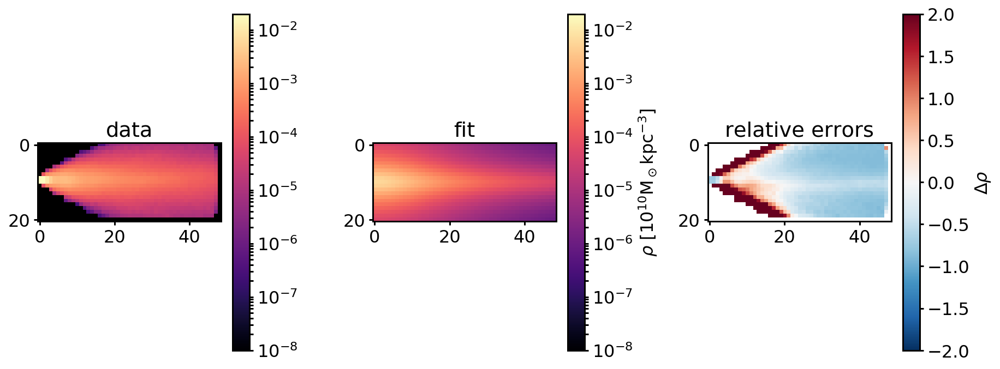

(21, 49)
a and b: 2.990513810624275, 0.6653744991089272
Rho mean galpy: 0.0005031287321778685
Rho mean data: 0.00033879189738258395
101.595548406 117.1251829752916
Circular velocity ar R=8kpc: 101.59554840617612 km/s and its error compared to the data: -0.13259005599497387 km/s
Multiply rho error with 0.017580122948750304
Error: 543299892035050.9
Error multiplied by vcirc error: 9551278900018.96
data max: 0.019812705986395618, fit max: 0.031037926579069446, chosen max: 0.031037926579069446


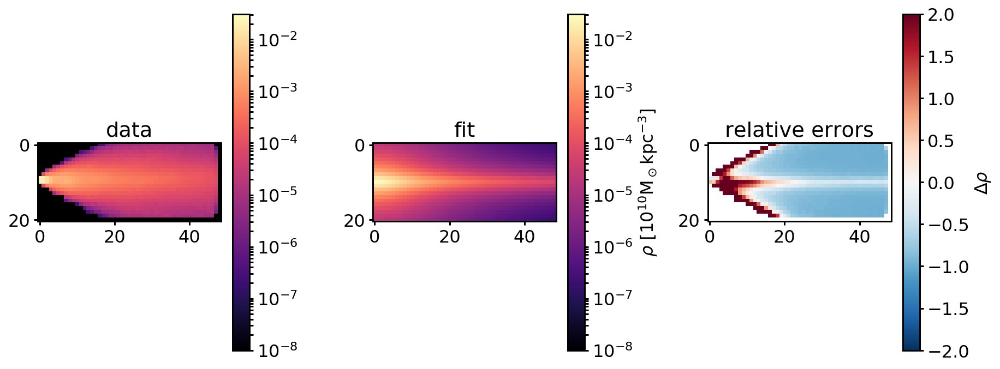

(21, 49)
a and b: 0.8214286813742415, 1.186849100555047
Rho mean galpy: 0.0011386939826087002
Rho mean data: 0.00033879189738258395
111.877997961 117.1251829752916
Circular velocity ar R=8kpc: 111.87799796109609 km/s and its error compared to the data: -0.044799802065644934 km/s
Multiply rho error with 0.002007022265120964
Error: 424652138183594.6
Error multiplied by vcirc error: 852286296265.6987
data max: 0.019812705986395618, fit max: 0.0912912534535308, chosen max: 0.0912912534535308


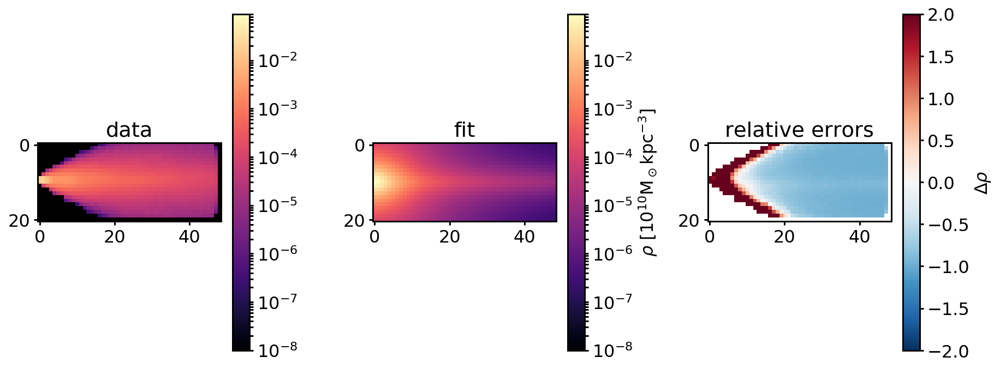

(21, 49)
a and b: 0.34834557516687337, 1.397881607519861
Rho mean galpy: 0.0014187737576066887
Rho mean data: 0.00033879189738258395
113.107012423 117.1251829752916
Circular velocity ar R=8kpc: 113.10701242297422 km/s and its error compared to the data: -0.0343066320175144 km/s
Multiply rho error with 0.0011769450003851444
Error: 598824653323837.9
Error multiplied by vcirc error: 704783681836.8583
data max: 0.019812705986395618, fit max: 0.12156077719576117, chosen max: 0.12156077719576117


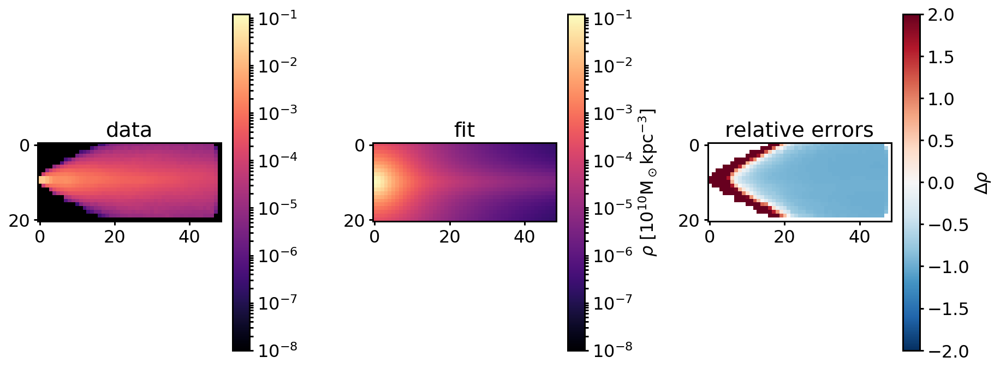

(21, 49)
a and b: 1.9068398090877752, 1.0778873209634172
Rho mean galpy: 0.000680743598505221
Rho mean data: 0.00033879189738258395
106.218756131 117.1251829752916
Circular velocity ar R=8kpc: 106.21875613108742 km/s and its error compared to the data: -0.09311769311391356 km/s
Multiply rho error with 0.008670904770856984
Error: 219179265311306.6
Error multiplied by vcirc error: 1900482537260.737
data max: 0.019812705986395618, fit max: 0.036210572223715, chosen max: 0.036210572223715


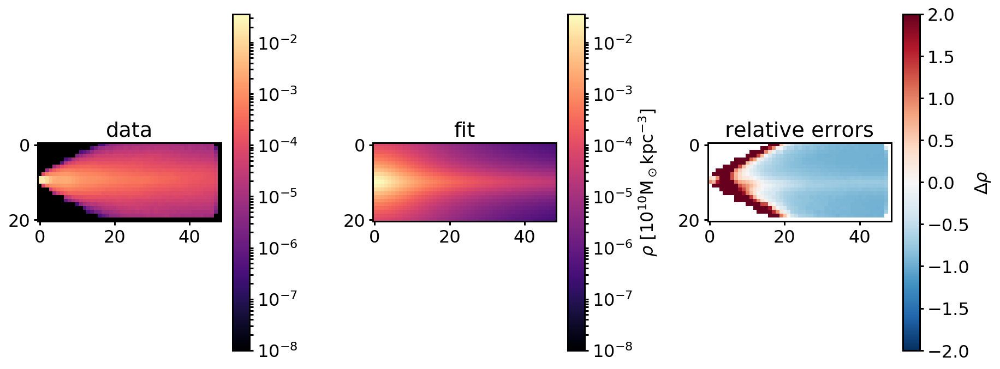

(21, 49)
a and b: 2.394520222546521, 1.0625440659724201
Rho mean galpy: 0.0005682994984402259
Rho mean data: 0.00033879189738258395
103.011066115 117.1251829752916
Circular velocity ar R=8kpc: 103.01106611524506 km/s and its error compared to the data: -0.12050454480847224 km/s
Multiply rho error with 0.014521345319497093
Error: 180838597615270.2
Error multiplied by vcirc error: 2626019723064.922
data max: 0.019812705986395618, fit max: 0.025712051227199717, chosen max: 0.025712051227199717


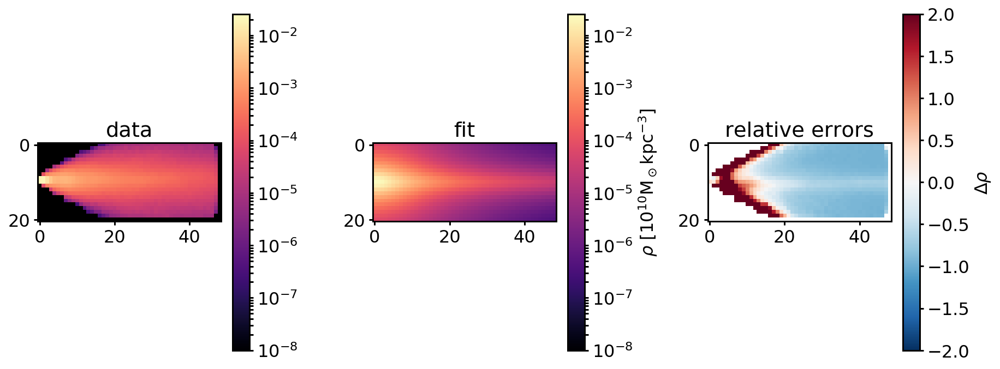

(21, 49)
a and b: 5.888236877767708, 1.3382911602184884
Rho mean galpy: 0.0002412516701422007
Rho mean data: 0.00033879189738258395
74.871584051 117.1251829752916
Circular velocity ar R=8kpc: 74.8715840509899 km/s and its error compared to the data: -0.36075588401185593 km/s
Multiply rho error with 0.13014480784917565
Error: 89586534043513.53
Error multiplied by vcirc error: 11659222258966.701
data max: 0.019812705986395618, fit max: 0.003978038095267945, chosen max: 0.019812705986395618


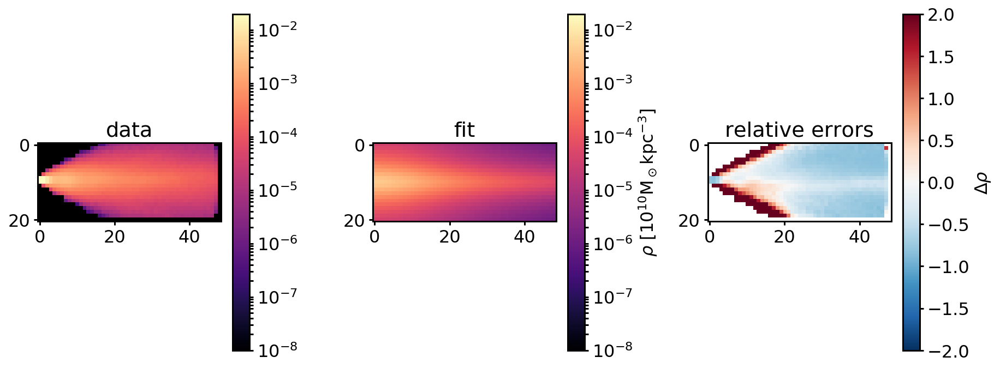

(21, 49)
a and b: 1.787154552944632, 0.11246289772610796
Rho mean galpy: 0.0021038592862497795
Rho mean data: 0.00033879189738258395
112.404594598 117.1251829752916
Circular velocity ar R=8kpc: 112.40459459750623 km/s and its error compared to the data: -0.040303786580049177 km/s
Multiply rho error with 0.001624395212690152
Error: 1.3102312513980096e+18
Error multiplied by vcirc error: 2128333372287953.8
data max: 0.019812705986395618, fit max: 0.5534286541655673, chosen max: 0.5534286541655673


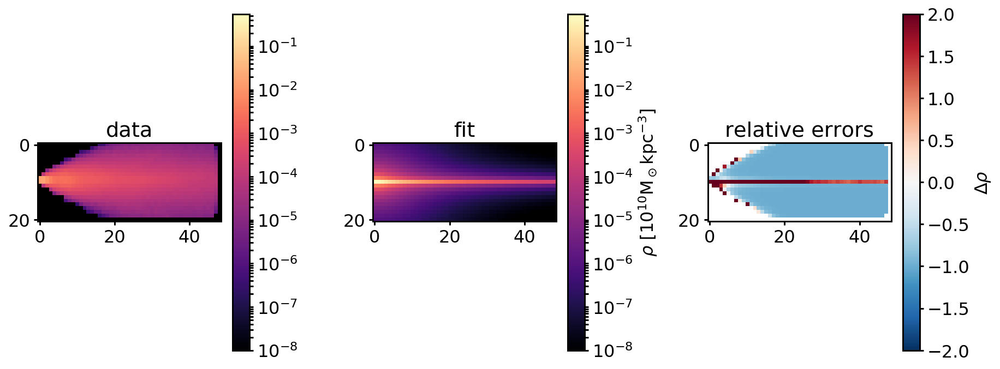

(21, 49)
a and b: 0.9632123232441394, 1.822299013060693
Rho mean galpy: 0.000814845267832366
Rho mean data: 0.00033879189738258395
107.492371941 117.1251829752916
Circular velocity ar R=8kpc: 107.49237194132542 km/s and its error compared to the data: -0.08224372239399864 km/s
Multiply rho error with 0.006764029873221114
Error: 137260519243771.3
Error multiplied by vcirc error: 928434252578.7106
data max: 0.019812705986395618, fit max: 0.0329103458637003, chosen max: 0.0329103458637003


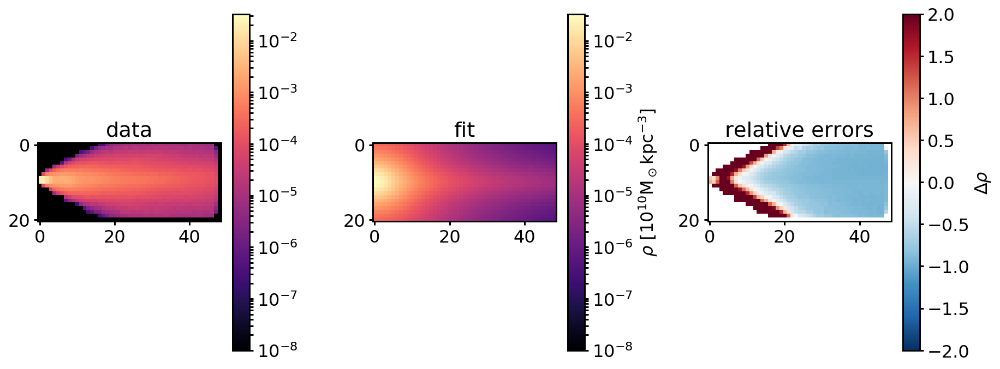

(21, 49)
a and b: 1.1634061311924913, 1.306407618536494
Rho mean galpy: 0.0008911581275550737
Rho mean data: 0.00033879189738258395
109.394841278 117.1251829752916
Circular velocity ar R=8kpc: 109.39484127786103 km/s and its error compared to the data: -0.06600067979455222 km/s
Multiply rho error with 0.0043560897333430135
Error: 224591038877391.25
Error multiplied by vcirc error: 978338718654.6456
data max: 0.019812705986395618, fit max: 0.051968569623308904, chosen max: 0.051968569623308904


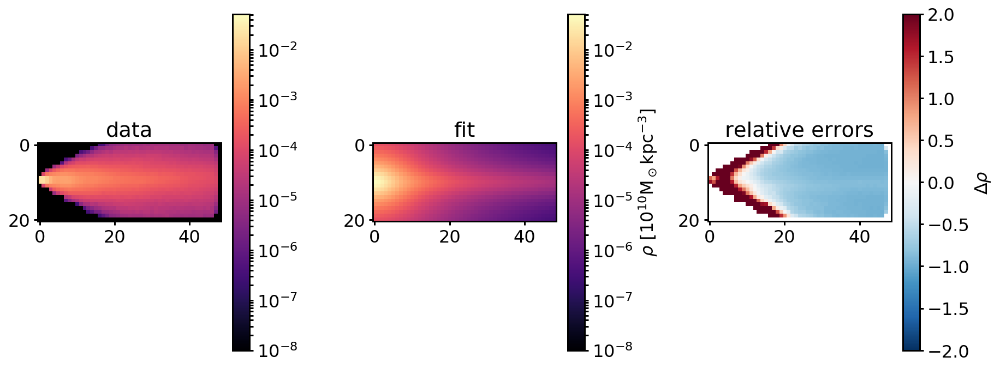

(21, 49)
a and b: 3.710176388014416, 0.5831774943713857
Rho mean galpy: 0.00041423516226547324
Rho mean data: 0.00033879189738258395
96.8745901237 117.1251829752916
Circular velocity ar R=8kpc: 96.87459012372884 km/s and its error compared to the data: -0.17289700077424652 km/s
Multiply rho error with 0.0298933728767298
Error: 642048076603625.9
Error multiplied by vcirc error: 19192982558699.367
data max: 0.019812705986395618, fit max: 0.023964199377652488, chosen max: 0.023964199377652488


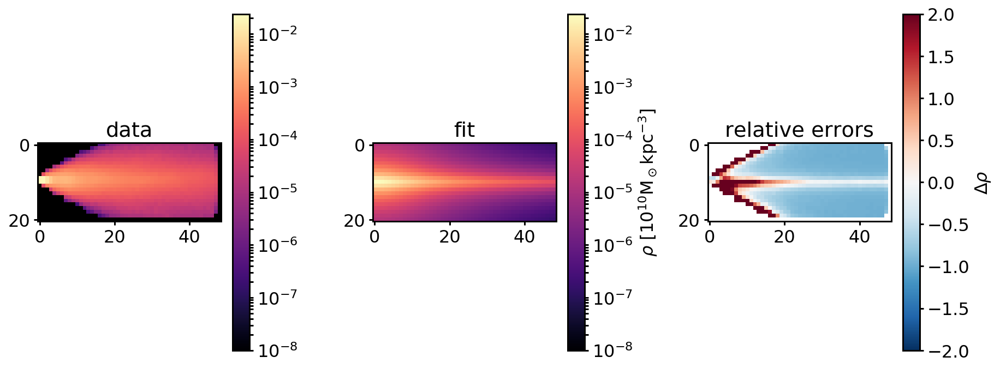

(21, 49)
a and b: 0.9785341720014076, 1.510413726036401
Rho mean galpy: 0.0009079119883214908
Rho mean data: 0.00033879189738258395
109.283921608 117.1251829752916
Circular velocity ar R=8kpc: 109.28392160830204 km/s and its error compared to the data: -0.0669476979057845 km/s
Multiply rho error with 0.004481994254884183
Error: 188770638023773.9
Error multiplied by vcirc error: 846068915113.3763
data max: 0.019812705986395618, fit max: 0.04760877723633715, chosen max: 0.04760877723633715


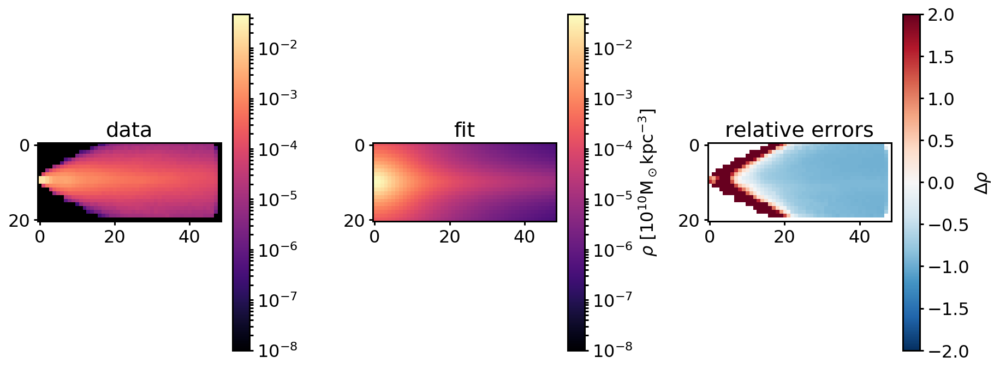

(21, 49)
a and b: 0.5815819022430784, 1.2636189788625924
Rho mean galpy: 0.0012885254716063074
Rho mean data: 0.00033879189738258395
112.659367179 117.1251829752916
Circular velocity ar R=8kpc: 112.65936717924751 km/s and its error compared to the data: -0.03812857049697143 km/s
Multiply rho error with 0.0014537878881425203
Error: 505712069959227.2
Error multiplied by vcirc error: 735198082194.2074
data max: 0.019812705986395618, fit max: 0.1099849228570607, chosen max: 0.1099849228570607


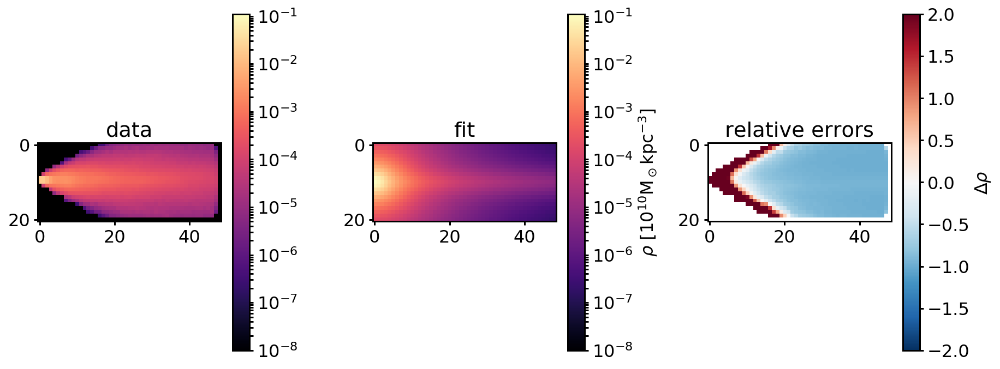

(21, 49)
a and b: 0.19504804358213068, 1.0920455792318011
Rho mean galpy: 0.0020106854635848874
Rho mean data: 0.00033879189738258395
114.901691302 117.1251829752916
Circular velocity ar R=8kpc: 114.90169130188953 km/s and its error compared to the data: -0.018983890713503752 km/s
Multiply rho error with 0.000360388106622254
Error: 2293400471754485.5
Error multiplied by vcirc error: 826514253742.1831
data max: 0.019812705986395618, fit max: 0.2921938355993415, chosen max: 0.2921938355993415


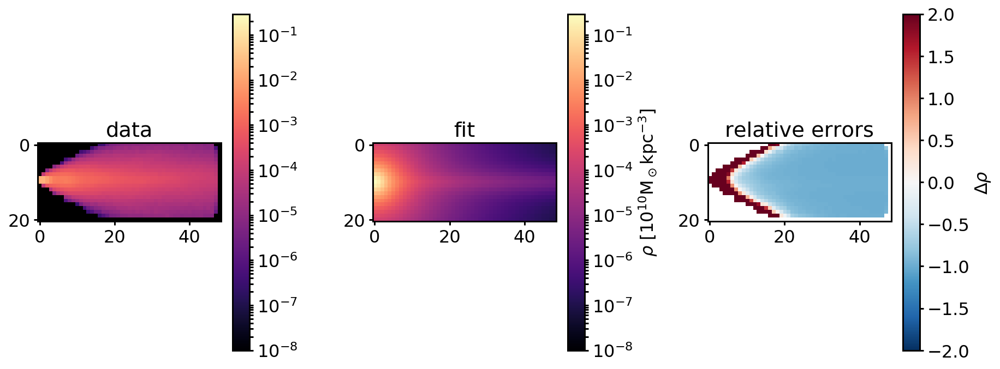

(21, 49)
a and b: 3.350656762133414, 1.7612914481060478
Rho mean galpy: 0.00037713996554875073
Rho mean data: 0.00033879189738258395
90.5995320242 117.1251829752916
Circular velocity ar R=8kpc: 90.59953202417304 km/s and its error compared to the data: -0.22647265325266838 km/s
Multiply rho error with 0.051289862671303366
Error: 89473761741636.6
Error multiplied by vcirc error: 4589096952413.458
data max: 0.019812705986395618, fit max: 0.007437392493324474, chosen max: 0.019812705986395618


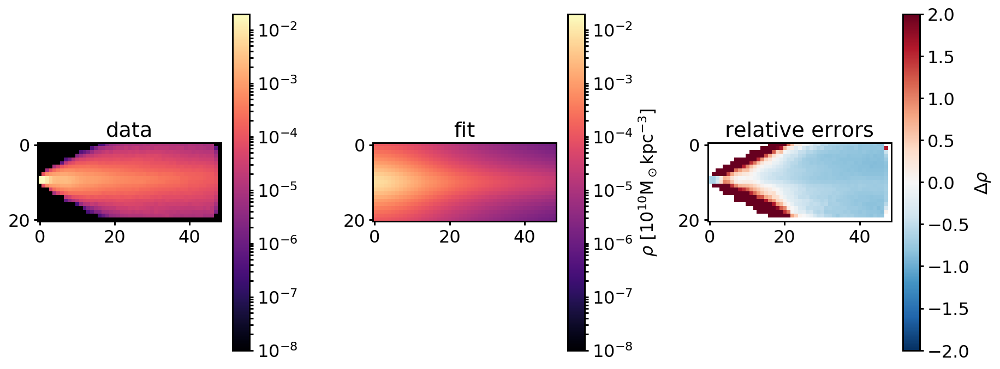

(21, 49)
a and b: 0.3030294897230279, 1.956405329829893
Rho mean galpy: 0.0010891728053819803
Rho mean data: 0.00033879189738258395
110.573980528 117.1251829752916
Circular velocity ar R=8kpc: 110.57398052835984 km/s and its error compared to the data: -0.055933337993706936 km/s
Multiply rho error with 0.00312853829911826
Error: 261055567067032.7
Error multiplied by vcirc error: 816722339767.2472
data max: 0.019812705986395618, fit max: 0.054901246779456035, chosen max: 0.054901246779456035


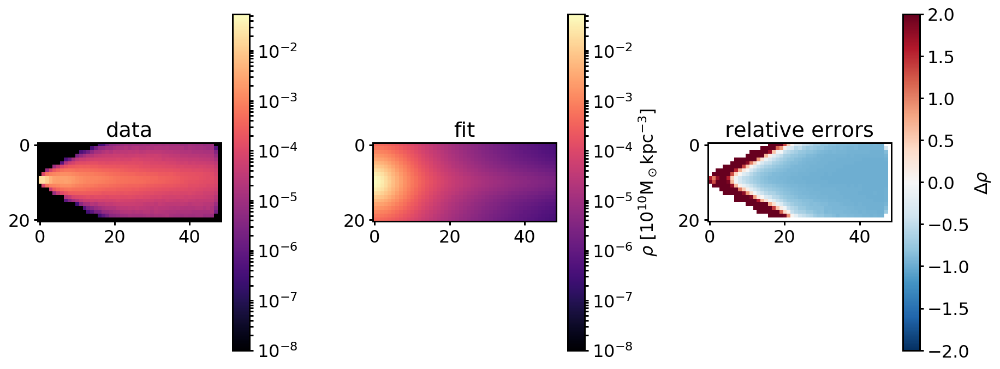

(21, 49)
a and b: 1.3051690852464093, 1.913833765146769
Rho mean galpy: 0.0006823221813326236
Rho mean data: 0.00033879189738258395
104.657909816 117.1251829752916
Circular velocity ar R=8kpc: 104.65790981565947 km/s and its error compared to the data: -0.10644400156251786 km/s
Multiply rho error with 0.011330325468641305
Error: 111001224520153.05
Error multiplied by vcirc error: 1257680001231.0618
data max: 0.019812705986395618, fit max: 0.022294389965990917, chosen max: 0.022294389965990917


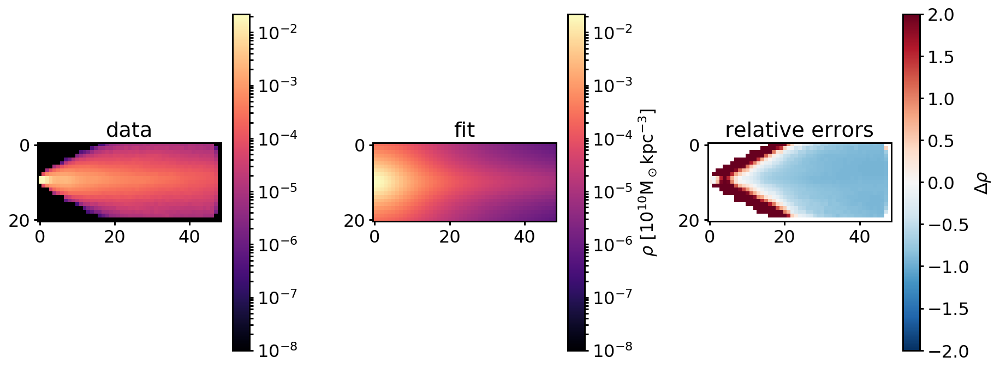

(21, 49)
a and b: 0.4286518520525524, 1.7419780792873185
Rho mean galpy: 0.0011190029228988591
Rho mean data: 0.00033879189738258395
111.048463556 117.1251829752916
Circular velocity ar R=8kpc: 111.0484635556259 km/s and its error compared to the data: -0.051882261912432795 km/s
Multiply rho error with 0.0026917691011502745
Error: 268270731406136.8
Error multiplied by vcirc error: 722122865542.0236
data max: 0.019812705986395618, fit max: 0.06365598421406995, chosen max: 0.06365598421406995


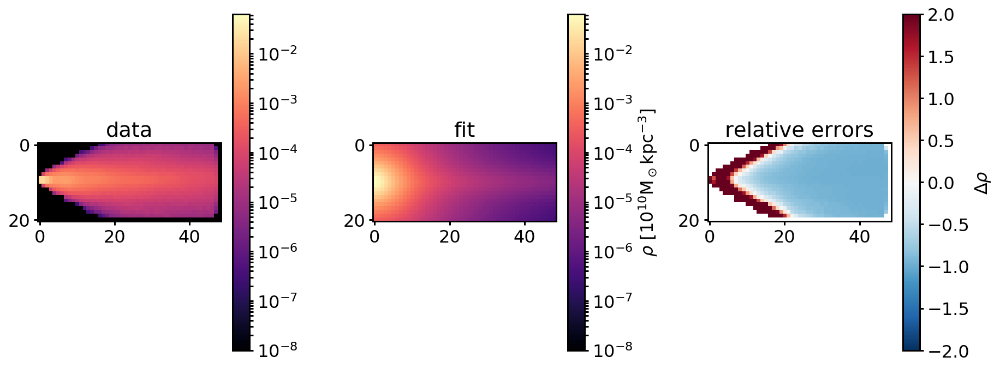

(21, 49)
a and b: 0.46304149201560474, 0.9724992912096886
Rho mean galpy: 0.00168843434585433
Rho mean data: 0.00033879189738258395
114.374050851 117.1251829752916
Circular velocity ar R=8kpc: 114.37405085090712 km/s and its error compared to the data: -0.02348881815591136 km/s
Multiply rho error with 0.0005517245783614711
Error: 1599316038769390.0
Error multiplied by vcirc error: 882381967156.7799
data max: 0.019812705986395618, fit max: 0.23212331761893465, chosen max: 0.23212331761893465


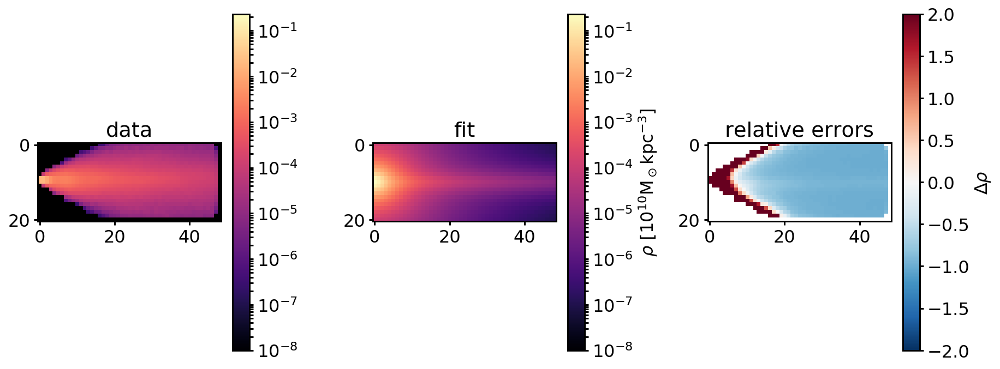

(21, 49)
a and b: 1.2426410716988965, 1.4331082229081866
Rho mean galpy: 0.0008193180747040447
Rho mean data: 0.00033879189738258395
108.170785213 117.1251829752916
Circular velocity ar R=8kpc: 108.17078521342972 km/s and its error compared to the data: -0.07645151567234576 km/s
Multiply rho error with 0.00584483424859893
Error: 172310465424835.22
Error multiplied by vcirc error: 1007126109707.0986
data max: 0.019812705986395618, fit max: 0.04067625767813161, chosen max: 0.04067625767813161


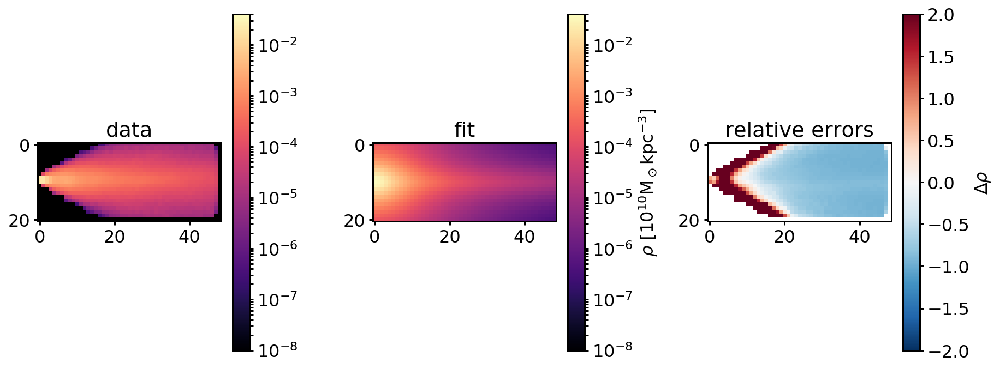

(21, 49)
a and b: 0.594365584213107, 0.5059919989465707
Rho mean galpy: 0.0021106411387237993
Rho mean data: 0.00033879189738258395
115.490346046 117.1251829752916
Circular velocity ar R=8kpc: 115.49034604588891 km/s and its error compared to the data: -0.013958030953493253 km/s
Multiply rho error with 0.00019482662809867577
Error: 1.494323047917786e+16
Error multiplied by vcirc error: 2911339207159.5815
data max: 0.019812705986395618, fit max: 0.6090171475959077, chosen max: 0.6090171475959077


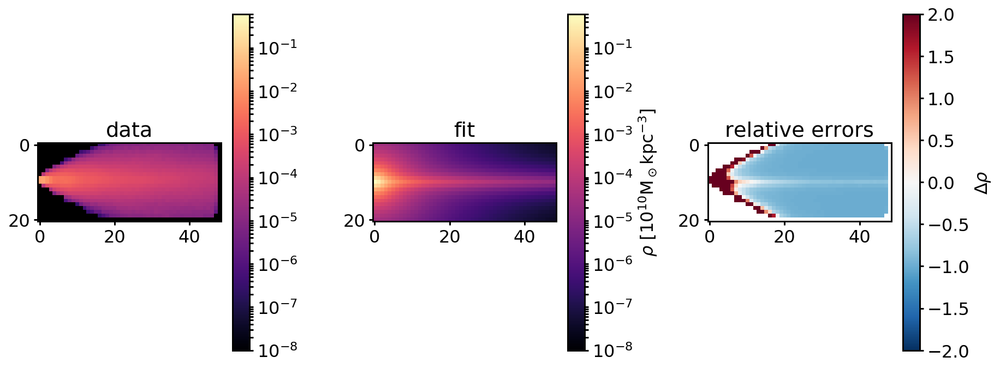

(21, 49)
a and b: 8.196597167012339, 1.3588933827843894
Rho mean galpy: 0.00017204894215269115
Rho mean data: 0.00033879189738258395
60.2408583938 117.1251829752916
Circular velocity ar R=8kpc: 60.24085839382869 km/s and its error compared to the data: -0.48567116939713184 km/s
Multiply rho error with 0.23587648478357753
Error: 85868284419581.48
Error multiplied by vcirc error: 20254309083287.32
data max: 0.019812705986395618, fit max: 0.0021009965006765384, chosen max: 0.019812705986395618


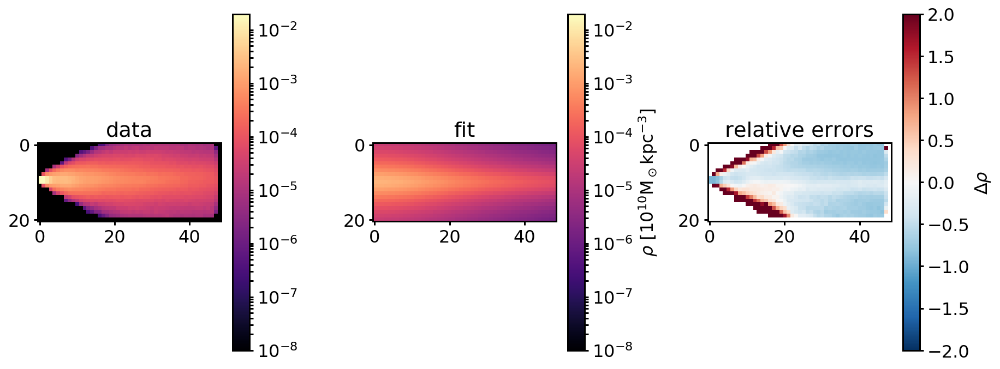

(21, 49)
a and b: 0.518885937675754, 0.9724107584200505
Rho mean galpy: 0.0016056075030361665
Rho mean data: 0.00033879189738258395
114.162606051 117.1251829752916
Circular velocity ar R=8kpc: 114.16260605056277 km/s and its error compared to the data: -0.025294107120872537 km/s
Multiply rho error with 0.0006397918550421748
Error: 1413451056565464.5
Error multiplied by vcirc error: 904314473491.3405
data max: 0.019812705986395618, fit max: 0.21092734373766678, chosen max: 0.21092734373766678


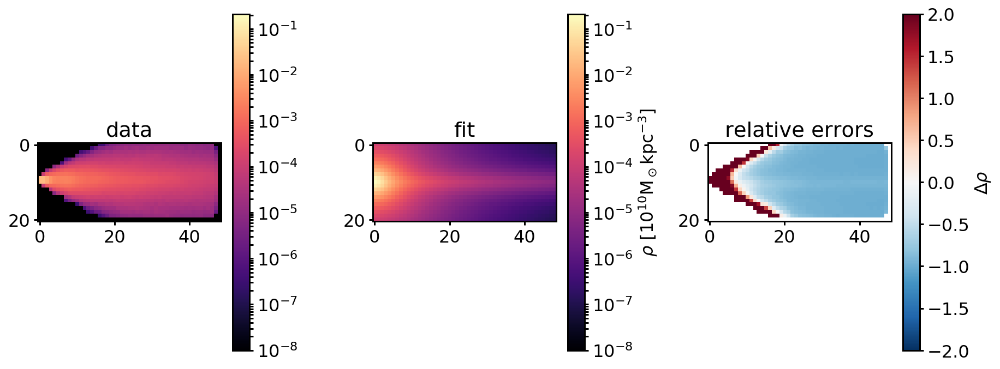

(21, 49)
a and b: 0.22606660748778928, 1.582215312272098
Rho mean galpy: 0.0013953903938154545
Rho mean data: 0.00033879189738258395
112.828744658 117.1251829752916
Circular velocity ar R=8kpc: 112.8287446578631 km/s and its error compared to the data: -0.036682447004884176 km/s
Multiply rho error with 0.0013456019182661362
Error: 573476382098151.0
Error multiplied by vcirc error: 771670919831.5957
data max: 0.019812705986395618, fit max: 0.10600024881527621, chosen max: 0.10600024881527621


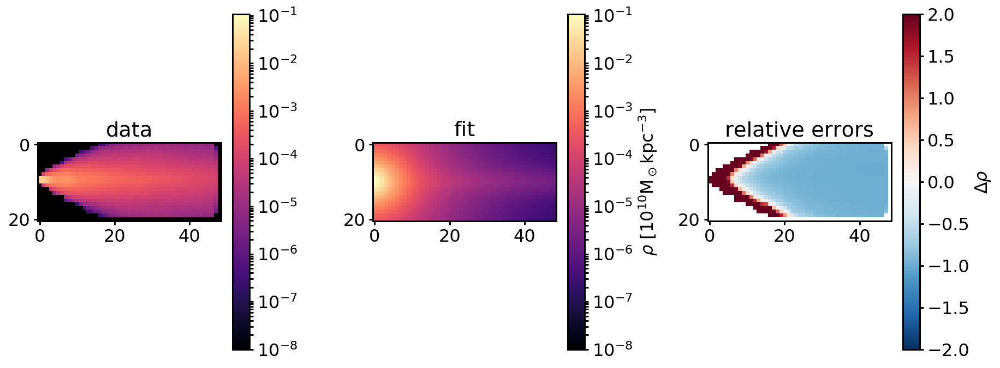

(21, 49)
a and b: 3.9214219456001107, 0.9323527248869106
Rho mean galpy: 0.00037395105386666566
Rho mean data: 0.00033879189738258395
92.5889565927 117.1251829752916
Circular velocity ar R=8kpc: 92.58895659274889 km/s and its error compared to the data: -0.20948719787886097 km/s
Multiply rho error with 0.043884886075137054
Error: 154635214784696.6
Error multiplied by vcirc error: 6786148784030.759
data max: 0.019812705986395618, fit max: 0.01277082355492203, chosen max: 0.019812705986395618


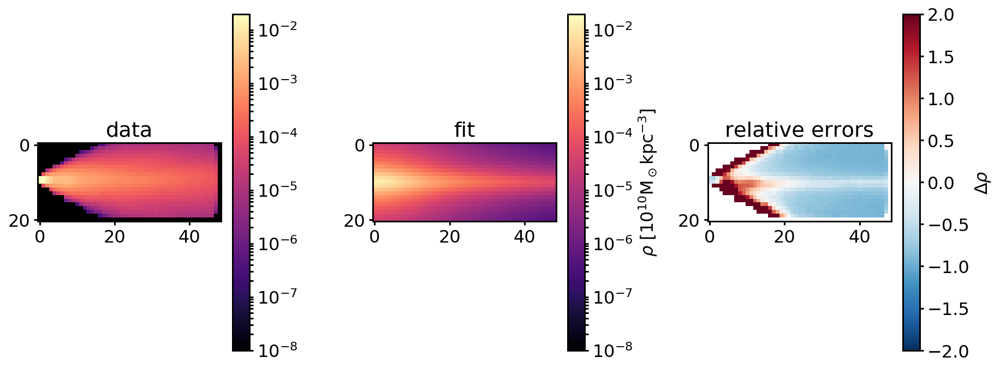

(21, 49)
a and b: 2.3691002425567893, 1.2348743134934999
Rho mean galpy: 0.0005520543375201334
Rho mean data: 0.00033879189738258395
101.96833037 117.1251829752916
Circular velocity ar R=8kpc: 101.96833037002833 km/s and its error compared to the data: -0.12940729073149637 km/s
Multiply rho error with 0.01674624689446603
Error: 136825583961994.25
Error multiplied by vcirc error: 2291315010507.047
data max: 0.019812705986395618, fit max: 0.021252249613715486, chosen max: 0.021252249613715486


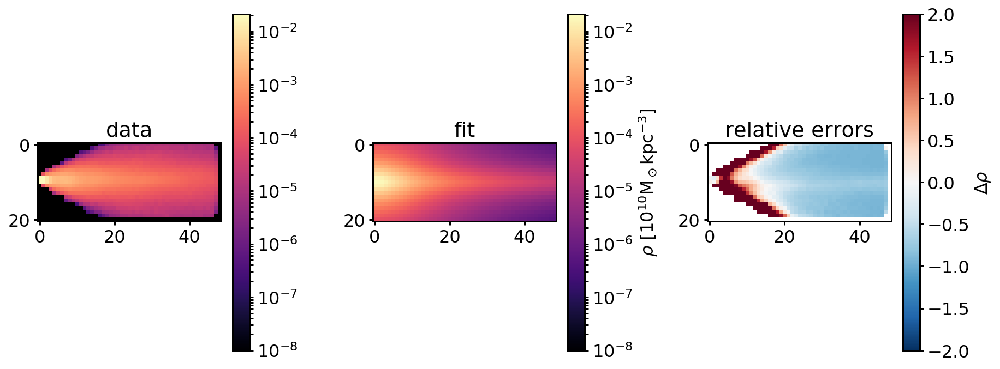

differential_evolution step 4: f(x)= 7.04784e+11
(21, 49)
a and b: 0.34834557516687337, 0.7515394154497863
Rho mean galpy: 0.00227007013048994
Rho mean data: 0.00033879189738258395
115.491727228 117.1251829752916
Circular velocity ar R=8kpc: 115.4917272281556 km/s and its error compared to the data: -0.0139462385939716 km/s
Multiply rho error with 0.00019449757091998297
Error: 5705498495519324.0
Error multiplied by vcirc error: 1109705598266.1257
data max: 0.019812705986395618, fit max: 0.5044238285084821, chosen max: 0.5044238285084821


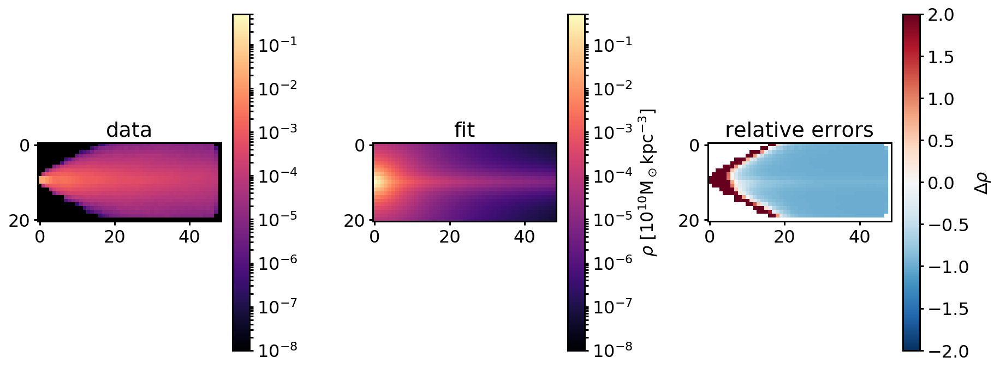

(21, 49)
a and b: 0.7075606584984158, 2.020949556523944
Rho mean galpy: 0.0008544081955232262
Rho mean data: 0.00033879189738258395
107.846843901 117.1251829752916
Circular velocity ar R=8kpc: 107.84684390068215 km/s and its error compared to the data: -0.07921728563332774 km/s
Multiply rho error with 0.006275378343112233
Error: 142131772946869.88
Error multiplied by vcirc error: 891930649818.9324
data max: 0.019812705986395618, fit max: 0.03323026592187321, chosen max: 0.03323026592187321


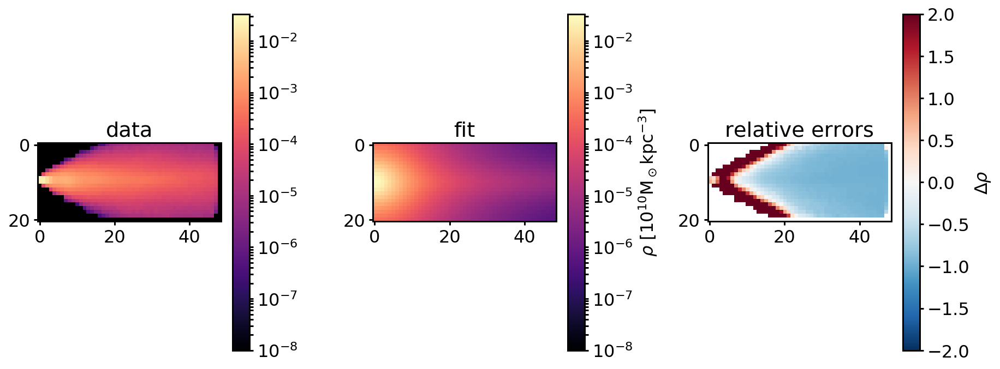

(21, 49)
a and b: 4.142833737468247, 1.7337039265192078
Rho mean galpy: 0.00031723807774729223
Rho mean data: 0.00033879189738258395
84.741605208 117.1251829752916
Circular velocity ar R=8kpc: 84.74160520803528 km/s and its error compared to the data: -0.276486891585799 km/s
Multiply rho error with 0.07644500121877736
Error: 87421192777447.94
Error multiplied by vcirc error: 6682913188418.978
data max: 0.019812705986395618, fit max: 0.005385004668769954, chosen max: 0.019812705986395618


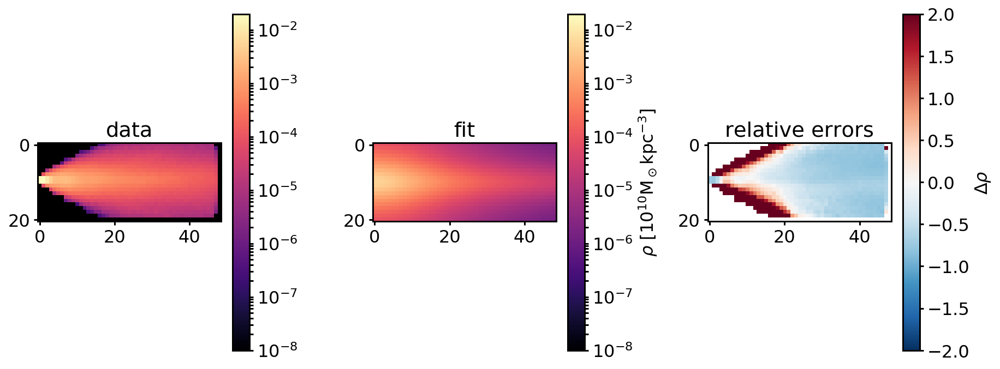

(21, 49)
a and b: 5.9838516742995385, 0.646963297008786
Rho mean galpy: 0.0002534460695377037
Rho mean data: 0.00033879189738258395
79.1252060176 117.1251829752916
Circular velocity ar R=8kpc: 79.1252060175777 km/s and its error compared to the data: -0.32443899759567735 km/s
Multiply rho error with 0.10526066316088793
Error: 259480491429317.5
Error multiplied by vcirc error: 27313088605163.06
data max: 0.019812705986395618, fit max: 0.008523302776046852, chosen max: 0.019812705986395618


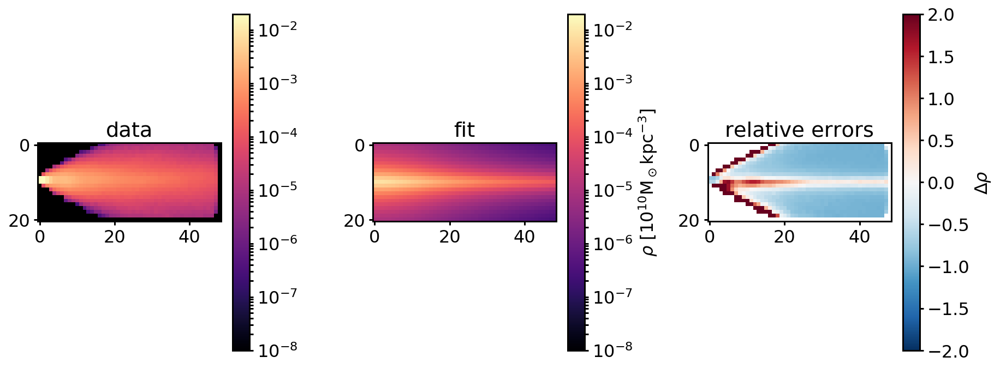

(21, 49)
a and b: 0.39372129547698176, 1.033655165049169
Rho mean galpy: 0.0017258337001719976
Rho mean data: 0.00033879189738258395
114.404411323 117.1251829752916
Circular velocity ar R=8kpc: 114.40441132305494 km/s and its error compared to the data: -0.02322960428425214 km/s
Multiply rho error with 0.0005396145152029454
Error: 1512863484241576.5
Error multiplied by vcirc error: 816363095617.2572
data max: 0.019812705986395618, fit max: 0.22952208982279268, chosen max: 0.22952208982279268


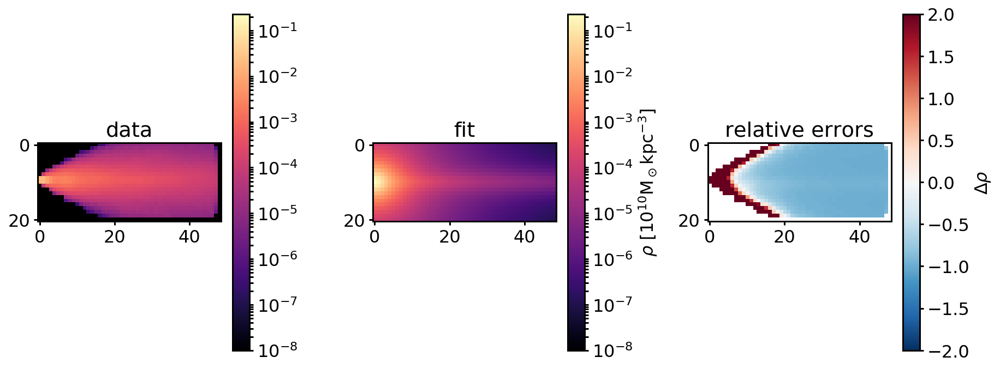

(21, 49)
a and b: 1.2706061249811604, 1.440298936216949
Rho mean galpy: 0.0008066139991176287
Rho mean data: 0.00033879189738258395
107.955386443 117.1251829752916
Circular velocity ar R=8kpc: 107.95538644277099 km/s and its error compared to the data: -0.07829056313581206 km/s
Multiply rho error with 0.006129412276122575
Error: 167546985051678.2
Error multiplied by vcirc error: 1026964547003.0819
data max: 0.019812705986395618, fit max: 0.039274916873768745, chosen max: 0.039274916873768745


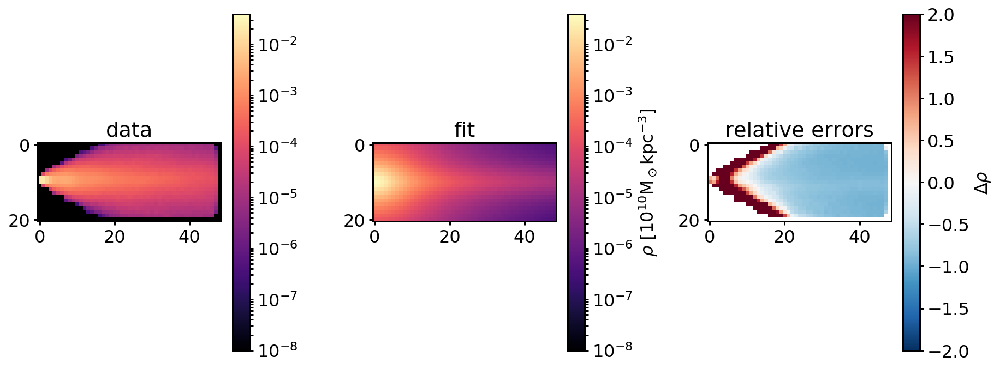

(21, 49)
a and b: 0.2797445191224712, 1.197750559405772
Rho mean galpy: 0.0017081749262720166
Rho mean data: 0.00033879189738258395
114.21561081 117.1251829752916
Circular velocity ar R=8kpc: 114.21561081003759 km/s and its error compared to the data: -0.02484155918772652 km/s
Multiply rho error with 0.0006171030628773199
Error: 1224729609030189.0
Error multiplied by vcirc error: 755784392929.0721
data max: 0.019812705986395618, fit max: 0.19821013950569194, chosen max: 0.19821013950569194


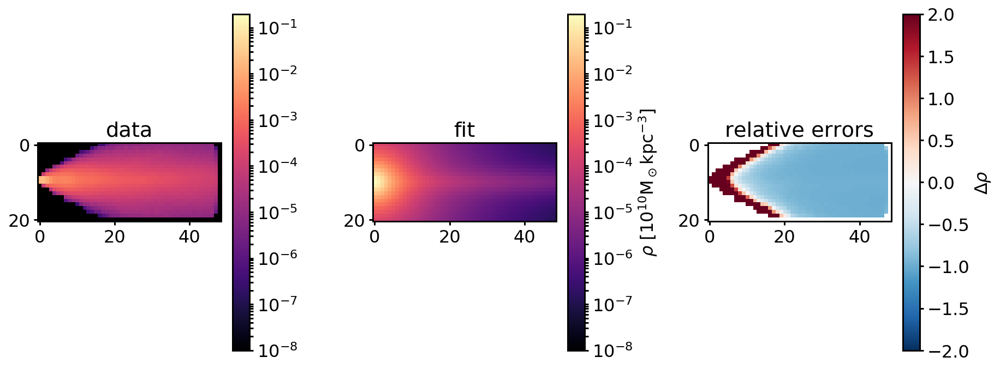

(21, 49)
a and b: 1.7405778389190187, 0.6535440281376987
Rho mean galpy: 0.0008265462224103377
Rho mean data: 0.00033879189738258395
109.827731874 117.1251829752916
Circular velocity ar R=8kpc: 109.82773187446823 km/s and its error compared to the data: -0.062304714626254344 km/s
Multiply rho error with 0.003881877464658992
Error: 1266893442358823.0
Error multiplied by vcirc error: 4917925104016.971
data max: 0.019812705986395618, fit max: 0.08308923363909472, chosen max: 0.08308923363909472


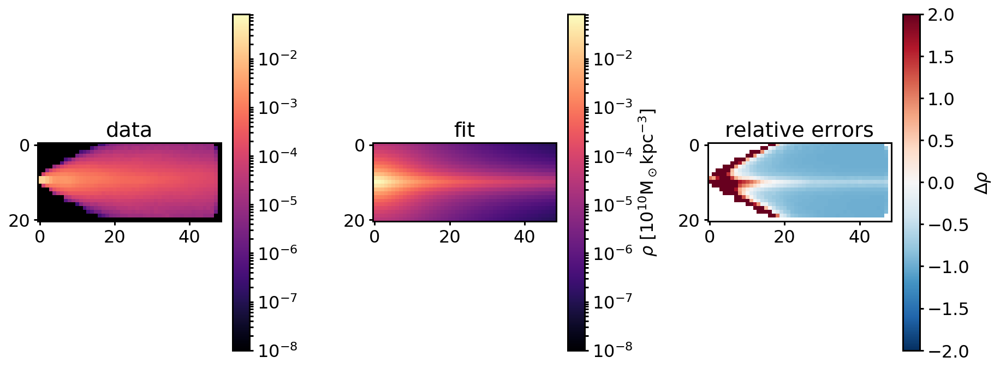

(21, 49)
a and b: 1.9068398090877752, 1.0885175687383875
Rho mean galpy: 0.0006788342119697951
Rho mean data: 0.00033879189738258395
106.149349134 117.1251829752916
Circular velocity ar R=8kpc: 106.14934913420424 km/s and its error compared to the data: -0.09371028127574223 km/s
Multiply rho error with 0.008781616816778724
Error: 213894090032349.44
Error multiplied by vcirc error: 1878335938037.662
data max: 0.019812705986395618, fit max: 0.03569786703082739, chosen max: 0.03569786703082739


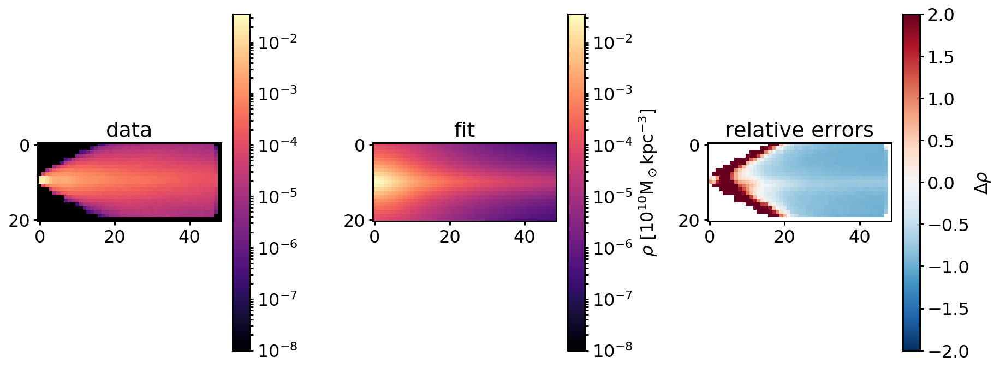

(21, 49)
a and b: 1.3650120787395958, 1.6838001854845266
Rho mean galpy: 0.0007149394730659771
Rho mean data: 0.00033879189738258395
105.798220326 117.1251829752916
Circular velocity ar R=8kpc: 105.7982203262559 km/s and its error compared to the data: -0.09670817463248017 km/s
Multiply rho error with 0.009352471040746282
Error: 124514444716660.44
Error multiplied by vcirc error: 1164517738367.1707
data max: 0.019812705986395618, fit max: 0.02714266634214287, chosen max: 0.02714266634214287


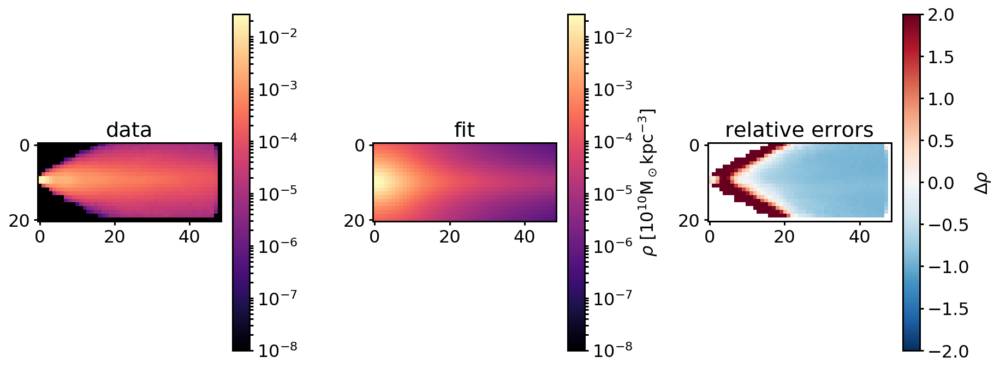

(21, 49)
a and b: 3.3960422860096955, 1.5062375104636865
Rho mean galpy: 0.0003897824496113646
Rho mean data: 0.00033879189738258395
92.2154206465 117.1251829752916
Circular velocity ar R=8kpc: 92.21542064649036 km/s and its error compared to the data: -0.21267640054877124 km/s
Multiply rho error with 0.045231251350381384
Error: 94947694840371.7
Error multiplied by vcirc error: 4294603050464.162
data max: 0.019812705986395618, fit max: 0.009037870983200092, chosen max: 0.019812705986395618


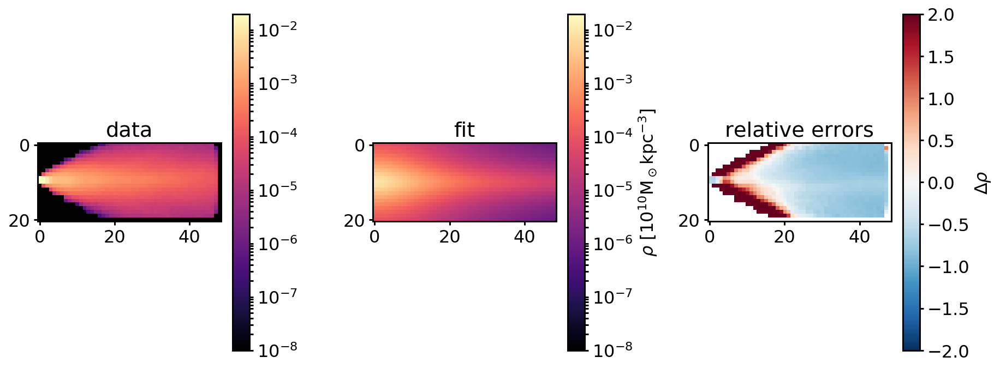

(21, 49)
a and b: 7.924920036936314, 1.198270153026114
Rho mean galpy: 0.00018069407692151504
Rho mean data: 0.00033879189738258395
62.7021277384 117.1251829752916
Circular velocity ar R=8kpc: 62.70212773842604 km/s and its error compared to the data: -0.4646571629975296 km/s
Multiply rho error with 0.2159062791249128
Error: 89319223546483.11
Error multiplied by vcirc error: 19284581210247.465
data max: 0.019812705986395618, fit max: 0.0025694408162510018, chosen max: 0.019812705986395618


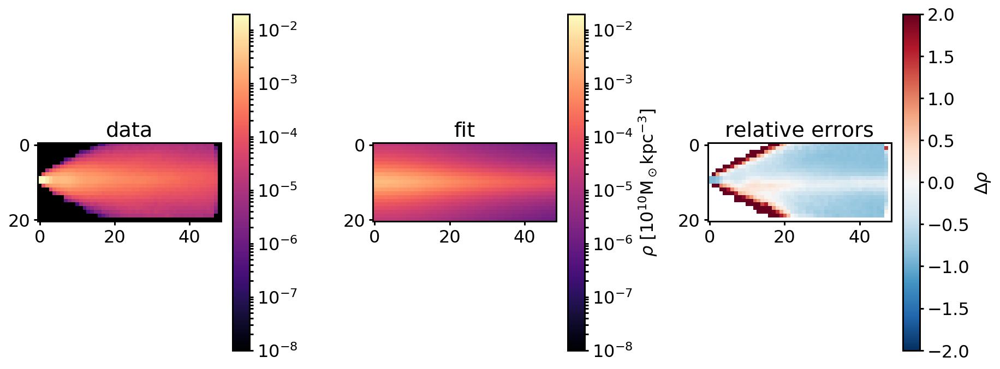

(21, 49)
a and b: 0.7422636506715108, 1.0447904563114094
Rho mean galpy: 0.0012884770199800308
Rho mean data: 0.00033879189738258395
112.924847549 117.1251829752916
Circular velocity ar R=8kpc: 112.92484754873439 km/s and its error compared to the data: -0.03586193267628272 km/s
Multiply rho error with 0.0012860782152782344
Error: 725664334517126.4
Error multiplied by vcirc error: 933261092226.8536
data max: 0.019812705986395618, fit max: 0.12974252718285254, chosen max: 0.12974252718285254


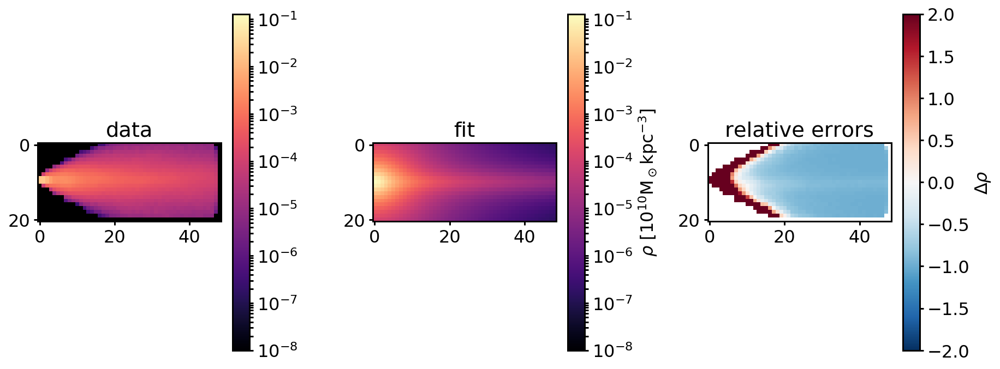

(21, 49)
a and b: 1.1634061311924913, 1.560598175036561
Rho mean galpy: 0.0008139074011360837
Rho mean data: 0.00033879189738258395
107.874667173 117.1251829752916
Circular velocity ar R=8kpc: 107.87466717258872 km/s and its error compared to the data: -0.07897973405646112 km/s
Multiply rho error with 0.006237798391629325
Error: 154654560261314.9
Error multiplied by vcirc error: 964703967256.1705
data max: 0.019812705986395618, fit max: 0.03734723313636245, chosen max: 0.03734723313636245


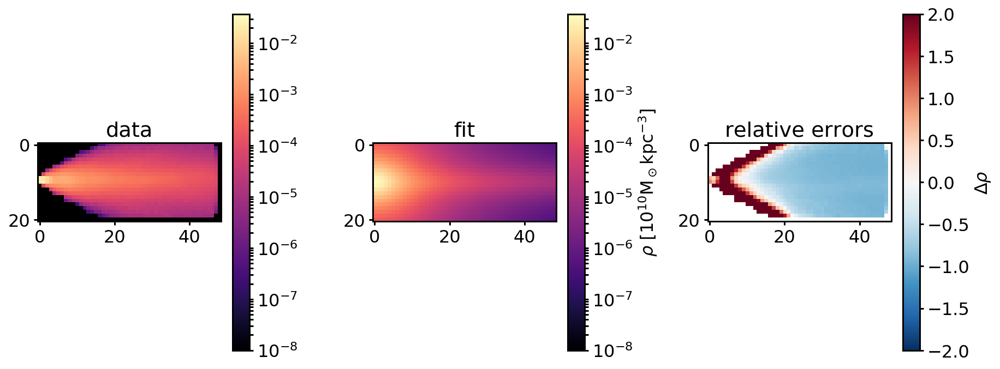

(21, 49)
a and b: 0.3872561168936359, 1.598889743357509
Rho mean galpy: 0.0012343005468880624
Rho mean data: 0.00033879189738258395
111.987155197 117.1251829752916
Circular velocity ar R=8kpc: 111.98715519688182 km/s and its error compared to the data: -0.0438678313910825 km/s
Multiply rho error with 0.0019243866309564435
Error: 364742666175669.3
Error multiplied by vcirc error: 701905910527.8671
data max: 0.019812705986395618, fit max: 0.08279412704335244, chosen max: 0.08279412704335244


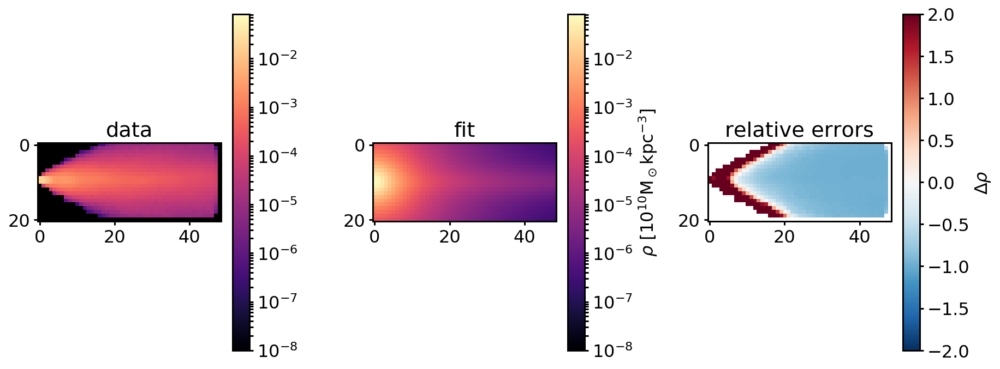

(21, 49)
a and b: 2.737334077350081, 1.4976205306994947
Rho mean galpy: 0.00046571187045497703
Rho mean data: 0.00033879189738258395
97.3158999549 117.1251829752916
Circular velocity ar R=8kpc: 97.31589995492438 km/s and its error compared to the data: -0.16912915324577235 km/s
Multiply rho error with 0.028604670477631947
Error: 101667353499173.28
Error multiplied by vcirc error: 2908161145176.773
data max: 0.019812705986395618, fit max: 0.012870105065002805, chosen max: 0.019812705986395618


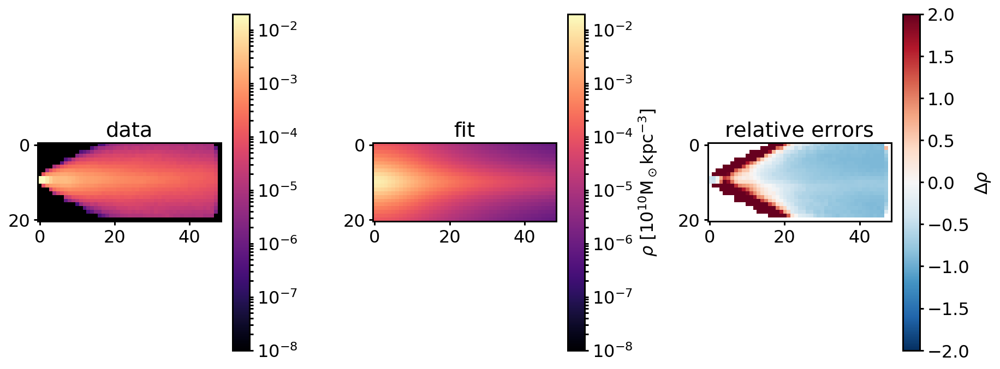

(21, 49)
a and b: 0.40009391709687137, 1.310742756321934
Rho mean galpy: 0.0014356670506368422
Rho mean data: 0.00033879189738258395
113.262052766 117.1251829752916
Circular velocity ar R=8kpc: 113.262052765767 km/s and its error compared to the data: -0.032982917177935625 km/s
Multiply rho error with 0.001087872825566561
Error: 650578817959274.0
Error multiplied by vcirc error: 707747016947.1088
data max: 0.019812705986395618, fit max: 0.13140384813683342, chosen max: 0.13140384813683342


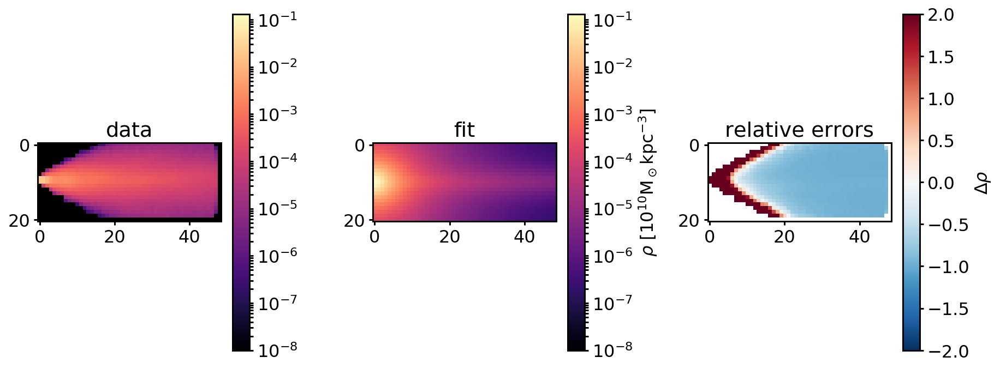

(21, 49)
a and b: 0.9627782039012667, 1.3415749336920155
Rho mean galpy: 0.000978683689705795
Rho mean data: 0.00033879189738258395
110.328606997 117.1251829752916
Circular velocity ar R=8kpc: 110.32860699739346 km/s and its error compared to the data: -0.05802830616992006 km/s
Multiply rho error with 0.0033672843169499822
Error: 253013258478790.3
Error multiplied by vcirc error: 851967577256.0427
data max: 0.019812705986395618, fit max: 0.06105144123935872, chosen max: 0.06105144123935872


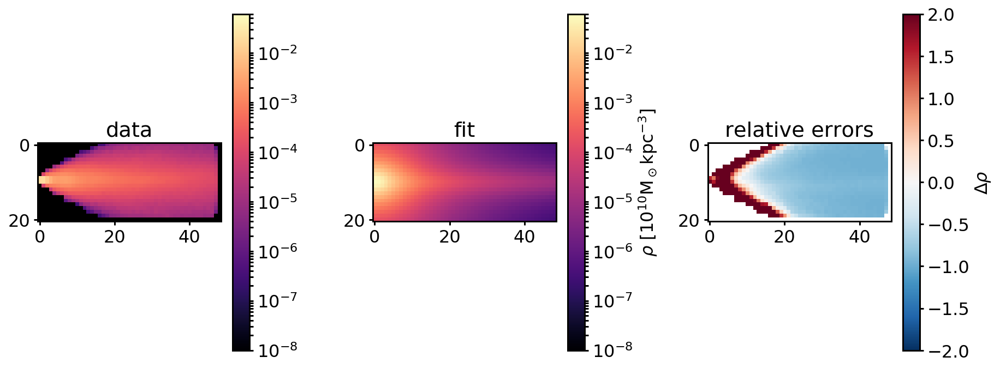

(21, 49)
a and b: 0.8775446713497761, 1.5038672841009701
Rho mean galpy: 0.0009602478062426782
Rho mean data: 0.00033879189738258395
109.899484475 117.1251829752916
Circular velocity ar R=8kpc: 109.89948447470114 km/s and its error compared to the data: -0.06169209999966248 km/s
Multiply rho error with 0.003805915202368355
Error: 209178869082875.5
Error multiplied by vcirc error: 796117037856.7357
data max: 0.019812705986395618, fit max: 0.05334756524025637, chosen max: 0.05334756524025637


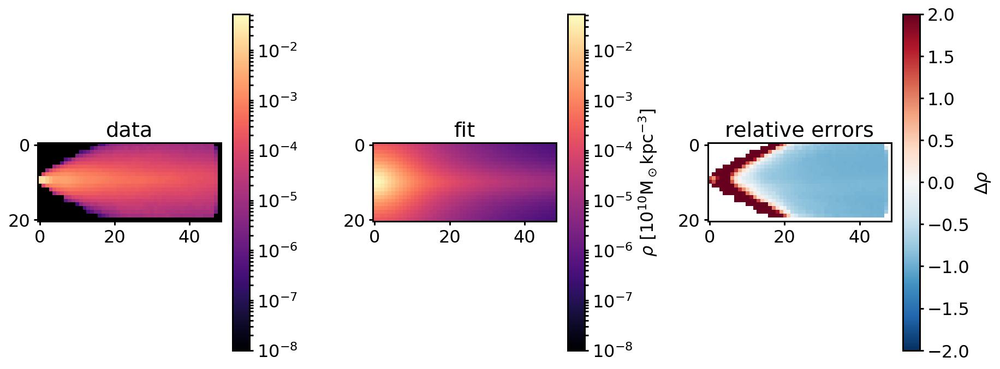

(21, 49)
a and b: 0.17876988357107848, 1.6211588775144943
Rho mean galpy: 0.0014125152860471216
Rho mean data: 0.00033879189738258395
112.866673821 117.1251829752916
Circular velocity ar R=8kpc: 112.86667382096441 km/s and its error compared to the data: -0.036358612607038994 km/s
Multiply rho error with 0.0013219487107087348
Error: 626203404810472.5
Error multiplied by vcirc error: 827808783630.624
data max: 0.019812705986395618, fit max: 0.10634204847253521, chosen max: 0.10634204847253521


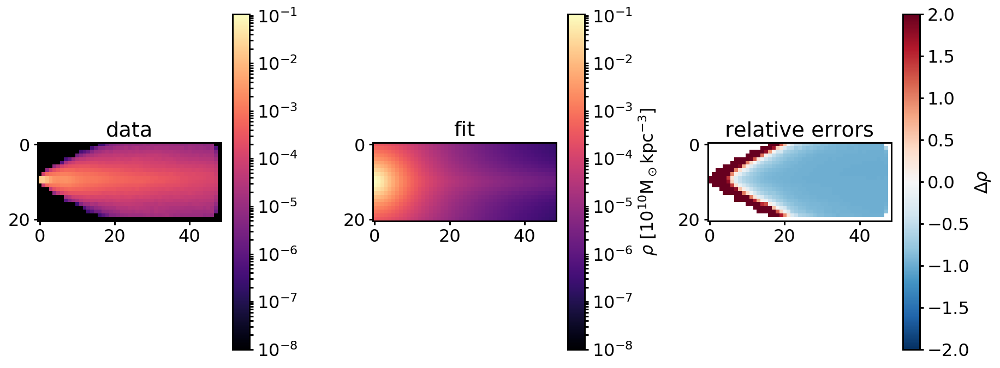

(21, 49)
a and b: 0.37088731291945276, 1.351714782026491
Rho mean galpy: 0.0014331369706730235
Rho mean data: 0.00033879189738258395
113.210807697 117.1251829752916
Circular velocity ar R=8kpc: 113.21080769720771 km/s and its error compared to the data: -0.03342044109258422 km/s
Multiply rho error with 0.001116925882822892
Error: 631018770342413.5
Error multiplied by vcirc error: 704801197142.516
data max: 0.019812705986395618, fit max: 0.1275531631322381, chosen max: 0.1275531631322381


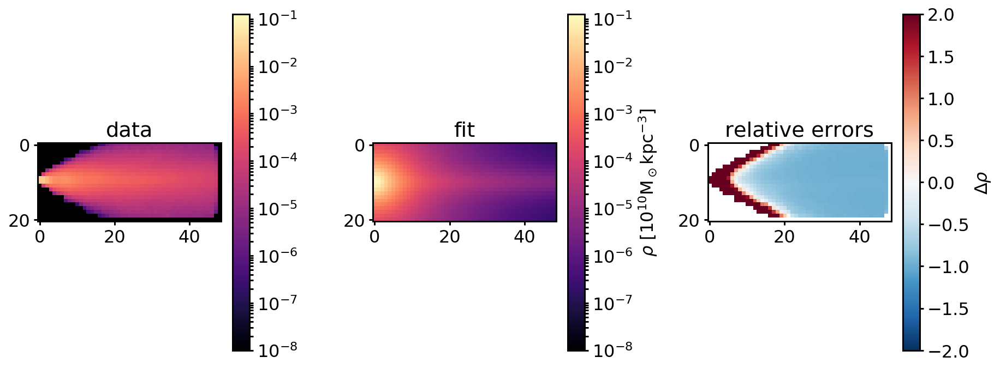

(21, 49)
a and b: 4.448510478439949, 1.935827955900252
Rho mean galpy: 0.00028943828279780193
Rho mean data: 0.00033879189738258395
80.9355529452 117.1251829752916
Circular velocity ar R=8kpc: 80.93555294524923 km/s and its error compared to the data: -0.3089824844728467 km/s
Multiply rho error with 0.09547017571101296
Error: 85515845871624.05
Error multiplied by vcirc error: 8164212831439.85
data max: 0.019812705986395618, fit max: 0.004129062560743578, chosen max: 0.019812705986395618


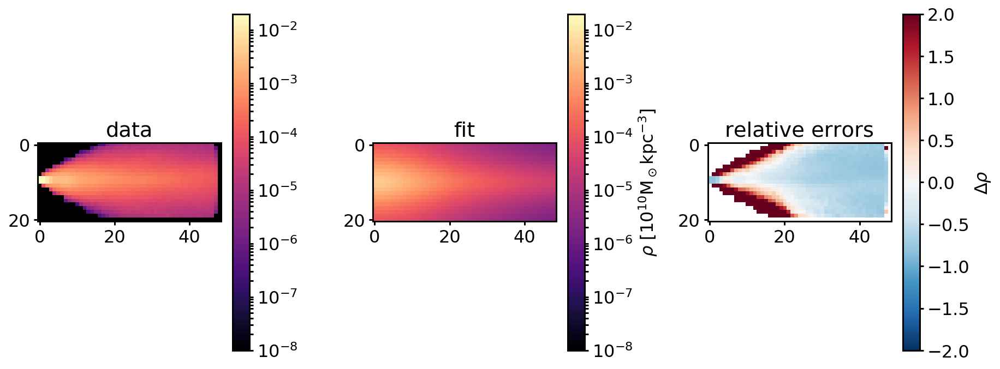

(21, 49)
a and b: 0.6740618656501836, 1.3758138184893227
Rho mean galpy: 0.0011445380102418597
Rho mean data: 0.00033879189738258395
111.670246884 117.1251829752916
Circular velocity ar R=8kpc: 111.67024688433996 km/s and its error compared to the data: -0.04657355448573679 km/s
Multiply rho error with 0.0021690959774358933
Error: 336663701086990.9
Error multiplied by vcirc error: 730255879776.4719
data max: 0.019812705986395618, fit max: 0.08116779568404027, chosen max: 0.08116779568404027


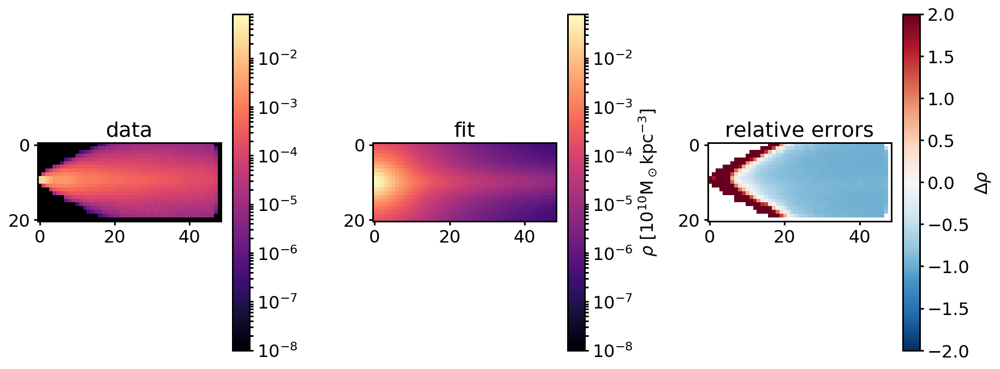

(21, 49)
a and b: 0.9340154080875234, 1.7718058440378304
Rho mean galpy: 0.0008414287813880113
Rho mean data: 0.00033879189738258395
107.98664655 117.1251829752916
Circular velocity ar R=8kpc: 107.98664655042853 km/s and its error compared to the data: -0.07802366828994327 km/s
Multiply rho error with 0.006087692813419099
Error: 145888459425225.5
Error multiplied by vcirc error: 888124126003.7291
data max: 0.019812705986395618, fit max: 0.03587451134965052, chosen max: 0.03587451134965052


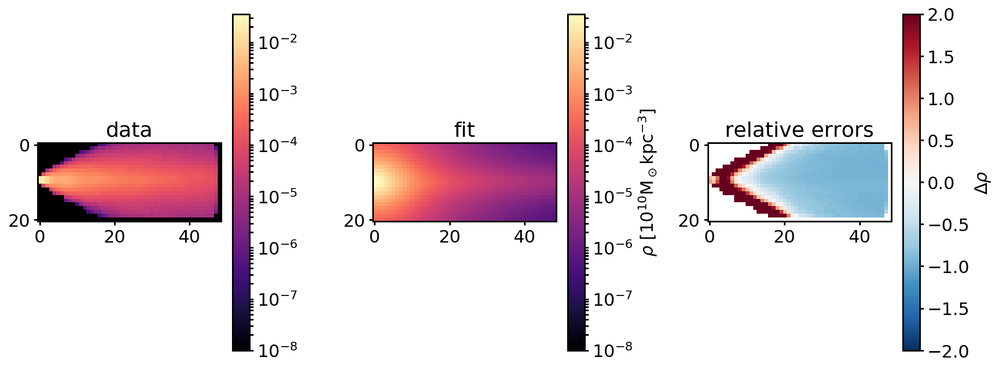

(21, 49)
a and b: 9.29968767690867, 1.905770446408321
Rho mean galpy: 0.00014315278882416383
Rho mean data: 0.00033879189738258395
51.8765755499 117.1251829752916
Circular velocity ar R=8kpc: 51.87657554993156 km/s and its error compared to the data: -0.5570843585288119 km/s
Multiply rho error with 0.31034298251745784
Error: 83225457678910.03
Error multiplied by vcirc error: 25828436757453.402
data max: 0.019812705986395618, fit max: 0.0011368056364004899, chosen max: 0.019812705986395618


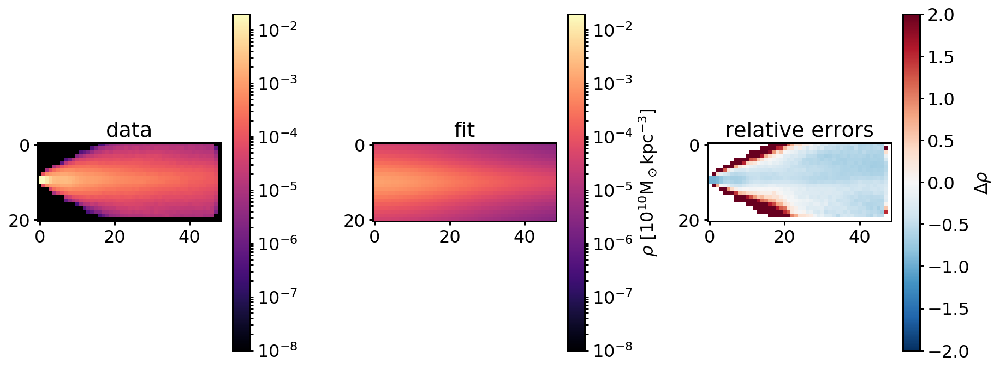

(21, 49)
a and b: 1.3506397475639744, 1.6008093691180996
Rho mean galpy: 0.000738315767661691
Rho mean data: 0.00033879189738258395
106.435117081 117.1251829752916
Circular velocity ar R=8kpc: 106.43511708081697 km/s and its error compared to the data: -0.09127043068722271 km/s
Multiply rho error with 0.008330291517831125
Error: 134115817947496.56
Error multiplied by vcirc error: 1117223860655.014
data max: 0.019812705986395618, fit max: 0.03016647721121049, chosen max: 0.03016647721121049


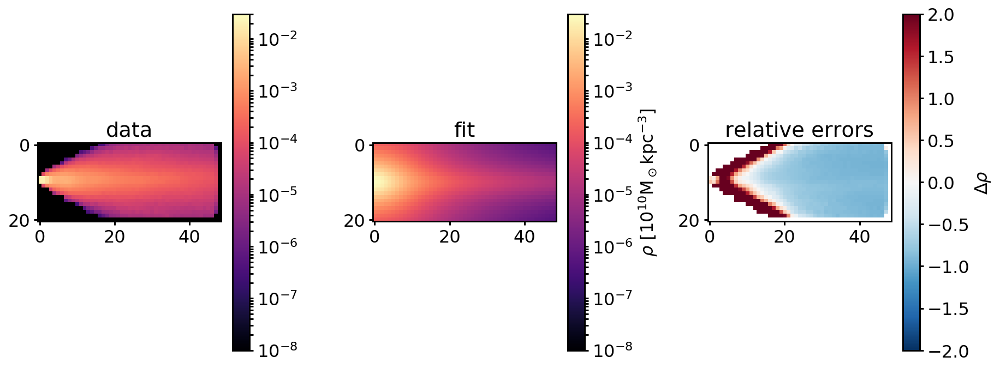

(21, 49)
a and b: 0.145866159267233, 1.7488911256053687
Rho mean galpy: 0.001343024676019218
Rho mean data: 0.00033879189738258395
112.427595173 117.1251829752916
Circular velocity ar R=8kpc: 112.42759517283588 km/s and its error compared to the data: -0.04010741057665374 km/s
Multiply rho error with 0.0016086043831642764
Error: 564656088394655.9
Error multiplied by vcirc error: 908308258772.0386
data max: 0.019812705986395618, fit max: 0.09052961643116827, chosen max: 0.09052961643116827


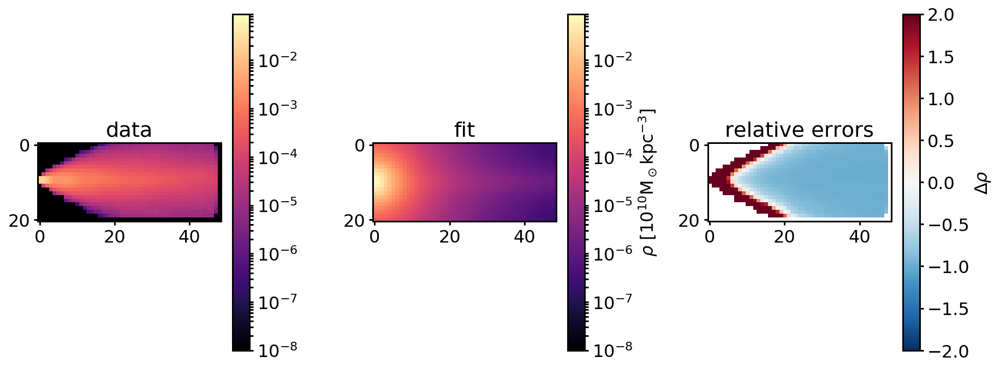

(21, 49)
a and b: 0.2983125588083828, 1.3676676461327866
Rho mean galpy: 0.0015026979680419523
Rho mean data: 0.00033879189738258395
113.454689077 117.1251829752916
Circular velocity ar R=8kpc: 113.45468907664069 km/s and its error compared to the data: -0.031338212717458215 km/s
Multiply rho error with 0.0009820835763246598
Error: 735238071539397.2
Error multiplied by vcirc error: 722065234747.4573
data max: 0.019812705986395618, fit max: 0.13837685563615654, chosen max: 0.13837685563615654


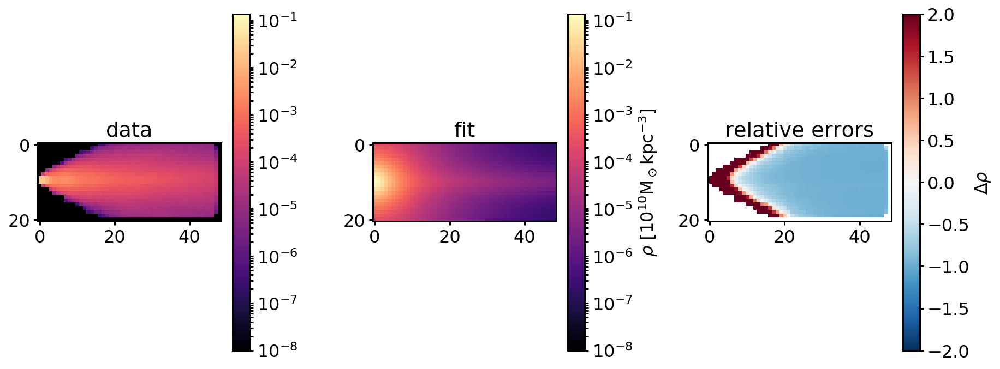

(21, 49)
a and b: 0.2234063775059303, 1.5663727972111368
Rho mean galpy: 0.0014112920326842093
Rho mean data: 0.00033879189738258395
112.91256343 117.1251829752916
Circular velocity ar R=8kpc: 112.91256343046689 km/s and its error compared to the data: -0.035966812924538925 km/s
Multiply rho error with 0.0012936116319487803
Error: 596797024268130.6
Error multiplied by vcirc error: 772023572505.6722
data max: 0.019812705986395618, fit max: 0.10927211480373333, chosen max: 0.10927211480373333


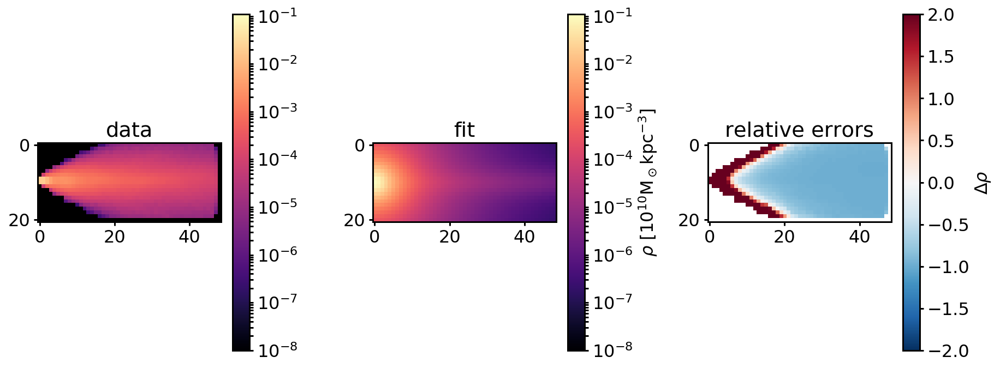

(21, 49)
a and b: 1.2242327887543598, 1.146389116330467
Rho mean galpy: 0.0009155608407902827
Rho mean data: 0.00033879189738258395
109.960184221 117.1251829752916
Circular velocity ar R=8kpc: 109.9601842206462 km/s and its error compared to the data: -0.06117385324518045 km/s
Multiply rho error with 0.003742240320862875
Error: 300980675737460.4
Error multiplied by vcirc error: 1126342020545.2786
data max: 0.019812705986395618, fit max: 0.06140984256788225, chosen max: 0.06140984256788225


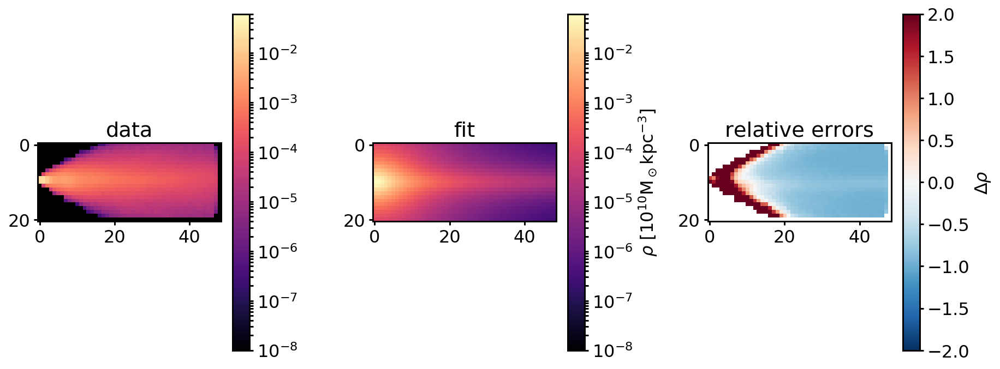

differential_evolution step 5: f(x)= 7.01906e+11
(21, 49)
a and b: 0.8511052088557376, 1.7701047038976832
Rho mean galpy: 0.0008766774456404235
Rho mean data: 0.00033879189738258395
108.501322256 117.1251829752916
Circular velocity ar R=8kpc: 108.5013222559061 km/s and its error compared to the data: -0.07362943220506862 km/s
Multiply rho error with 0.0054212932868407965
Error: 155395442015743.1
Error multiplied by vcirc error: 842444266605.6063
data max: 0.019812705986395618, fit max: 0.03892224641440579, chosen max: 0.03892224641440579


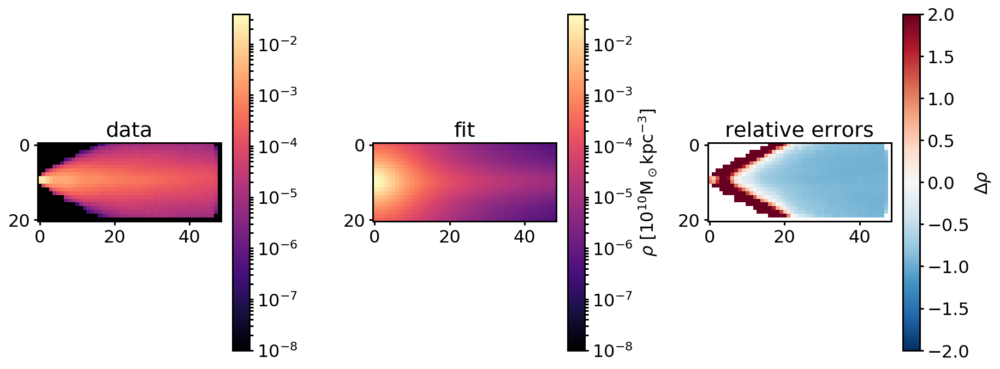

(21, 49)
a and b: 0.7075606584984158, 1.5321720898327094
Rho mean galpy: 0.0010438714361268525
Rho mean data: 0.00033879189738258395
110.680477252 117.1251829752916
Circular velocity ar R=8kpc: 110.68047725223629 km/s and its error compared to the data: -0.05502408243336418 km/s
Multiply rho error with 0.0030276496476336567
Error: 241954206920066.25
Error multiplied by vcirc error: 732552569325.0194
data max: 0.019812705986395618, fit max: 0.06185838281533103, chosen max: 0.06185838281533103


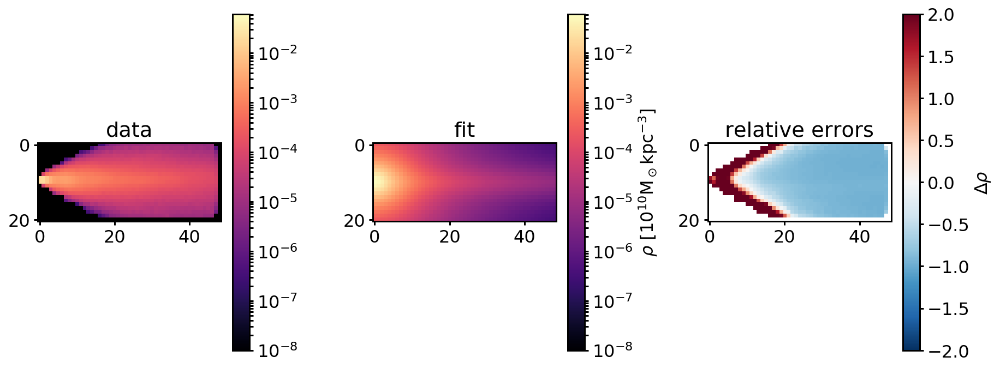

(21, 49)
a and b: 0.8537896683399326, 1.7337039265192078
Rho mean galpy: 0.0008878136708847821
Rho mean data: 0.00033879189738258395
108.703410885 117.1251829752916
Circular velocity ar R=8kpc: 108.7034108847116 km/s and its error compared to the data: -0.07190402504947742 km/s
Multiply rho error with 0.005170188818315876
Error: 160678419249086.56
Error multiplied by vcirc error: 830737766546.2977
data max: 0.019812705986395618, fit max: 0.040590657209984664, chosen max: 0.040590657209984664


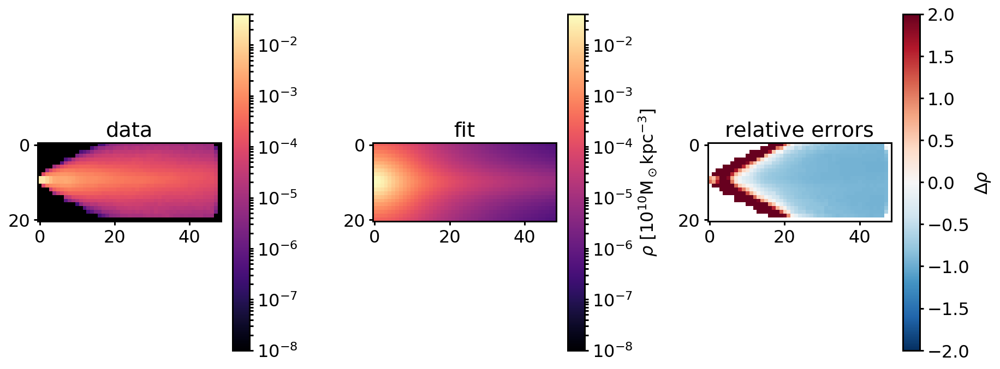

(21, 49)
a and b: 1.0366850556453455, 1.9907582477087962
Rho mean galpy: 0.0007438362266643872
Rho mean data: 0.00033879189738258395
105.939005511 117.1251829752916
Circular velocity ar R=8kpc: 105.93900551051915 km/s and its error compared to the data: -0.095506168533647 km/s
Multiply rho error with 0.009121428227977384
Error: 118456156486666.94
Error multiplied by vcirc error: 1080489329555.1902
data max: 0.019812705986395618, fit max: 0.025605852759151403, chosen max: 0.025605852759151403


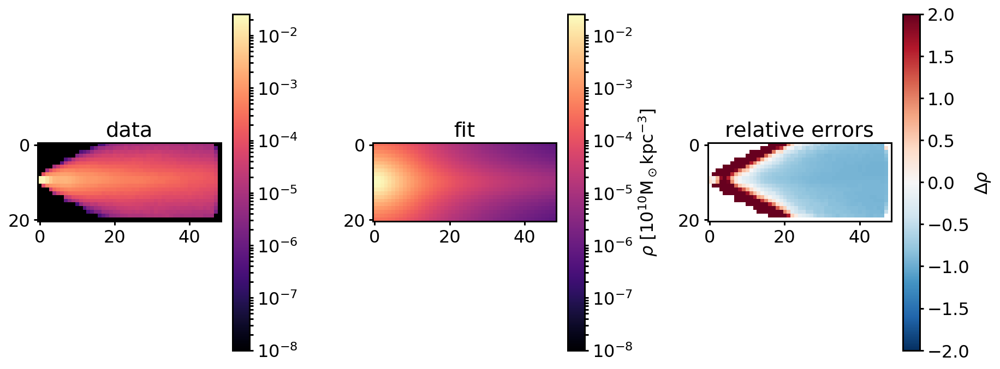

(21, 49)
a and b: 0.39372129547698176, 1.5447229251281802
Rho mean galpy: 0.001264543361256473
Rho mean data: 0.00033879189738258395
112.219134609 117.1251829752916
Circular velocity ar R=8kpc: 112.21913460932434 km/s and its error compared to the data: -0.04188722050493802 km/s
Multiply rho error with 0.0017545392416293
Error: 396770992505133.0
Error multiplied by vcirc error: 696150276290.4607
data max: 0.019812705986395618, fit max: 0.08934266203759886, chosen max: 0.08934266203759886


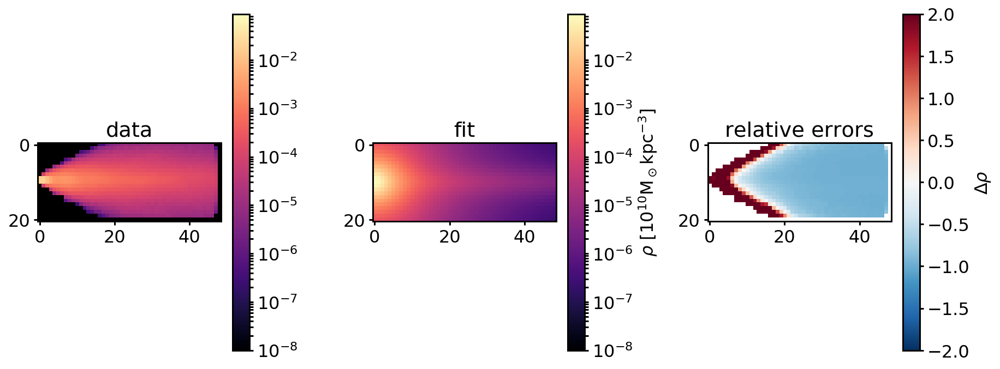

(21, 49)
a and b: 0.573254524987461, 2.0773632234438058
Rho mean galpy: 0.0008925993436469414
Rho mean data: 0.00033879189738258395
108.323648546 117.1251829752916
Circular velocity ar R=8kpc: 108.32364854578898 km/s and its error compared to the data: -0.07514638787253257 km/s
Multiply rho error with 0.00564697961028911
Error: 154235881805162.97
Error multiplied by vcirc error: 870966879728.7164
data max: 0.019812705986395618, fit max: 0.03542555796137354, chosen max: 0.03542555796137354


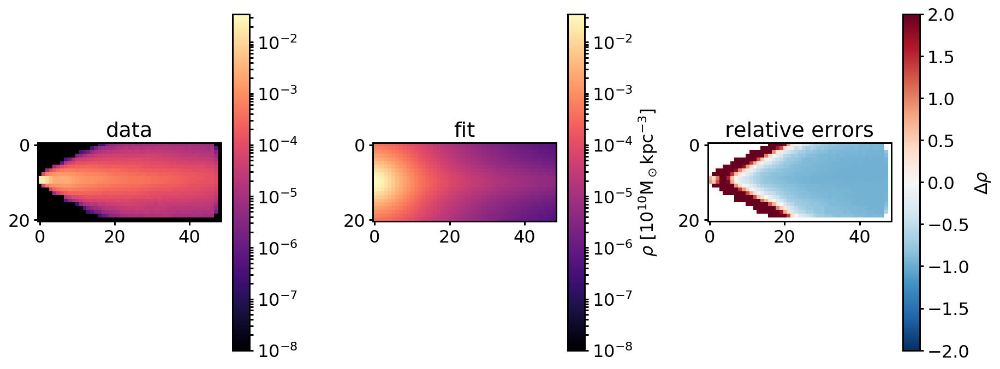

(21, 49)
a and b: 0.2797445191224712, 1.3688915675976552
Rho mean galpy: 0.0015242201142273083
Rho mean data: 0.00033879189738258395
113.52800181 117.1251829752916
Circular velocity ar R=8kpc: 113.52800180980661 km/s and its error compared to the data: -0.030712277873186627 km/s
Multiply rho error with 0.0009432440121598289
Error: 773670505427746.0
Error multiplied by vcirc error: 729760071629.3898
data max: 0.019812705986395618, fit max: 0.14211164385188135, chosen max: 0.14211164385188135


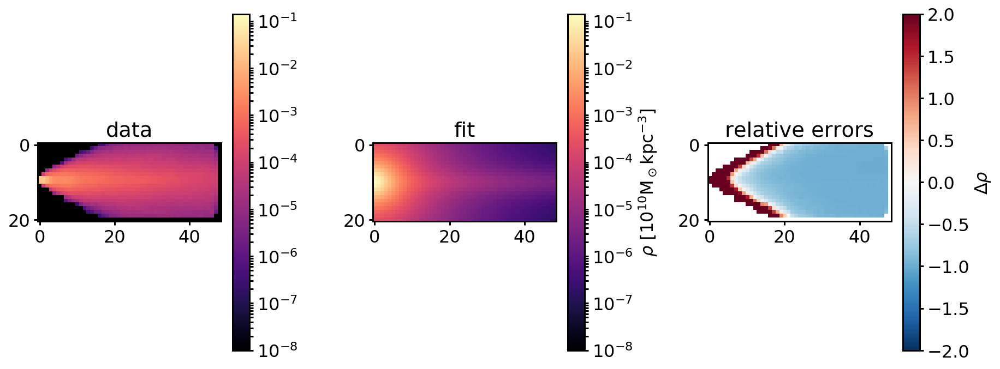

(21, 49)
a and b: 0.7123985834522015, 2.269130627851485
Rho mean galpy: 0.0007776913923450811
Rho mean data: 0.00033879189738258395
106.239608362 117.1251829752916
Circular velocity ar R=8kpc: 106.23960836225389 km/s and its error compared to the data: -0.09293965940129284 km/s
Multiply rho error with 0.00863778028962832
Error: 122978353380653.72
Error multiplied by vcirc error: 1062259996882.357
data max: 0.019812705986395618, fit max: 0.025224078822680178, chosen max: 0.025224078822680178


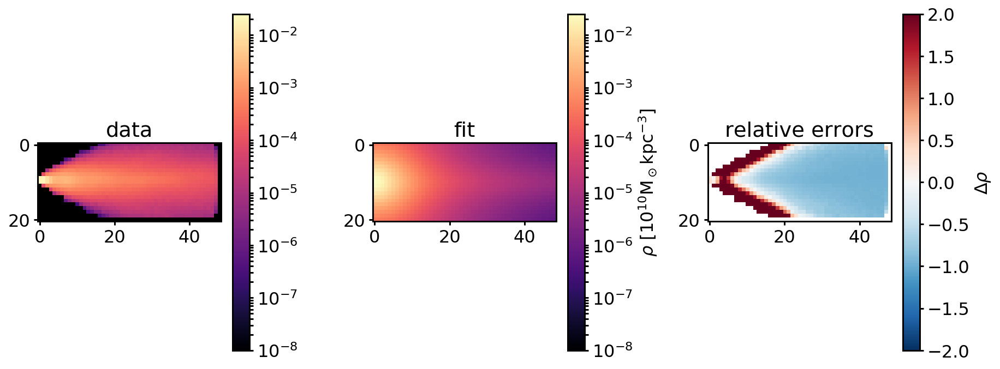

(21, 49)
a and b: 0.8054764976303534, 1.827436225390387
Rho mean galpy: 0.0008772385344120181
Rho mean data: 0.00033879189738258395
108.430773375 117.1251829752916
Circular velocity ar R=8kpc: 108.43077337535483 km/s and its error compared to the data: -0.07423176962524712 km/s
Multiply rho error with 0.0055103556216957615
Error: 152942281756774.53
Error multiplied by vcirc error: 842766362073.4197
data max: 0.019812705986395618, fit max: 0.037965074764456014, chosen max: 0.037965074764456014


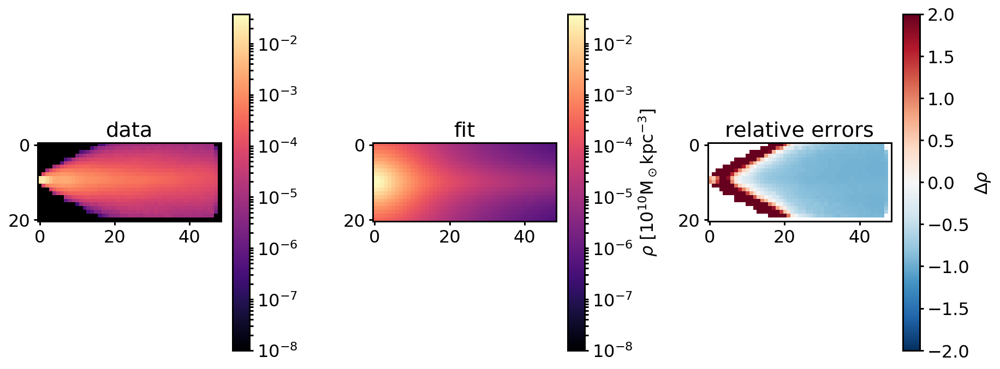

(21, 49)
a and b: 2.465513457722998, 1.4682936262016693
Rho mean galpy: 0.0005084660220466013
Rho mean data: 0.00033879189738258395
99.5664501885 117.1251829752916
Circular velocity ar R=8kpc: 99.56645018849783 km/s and its error compared to the data: -0.1499142399674877 km/s
Multiply rho error with 0.022474279345029487
Error: 107677777107175.56
Error multiplied by vcirc error: 2419980441958.485
data max: 0.019812705986395618, fit max: 0.015556054507157432, chosen max: 0.019812705986395618


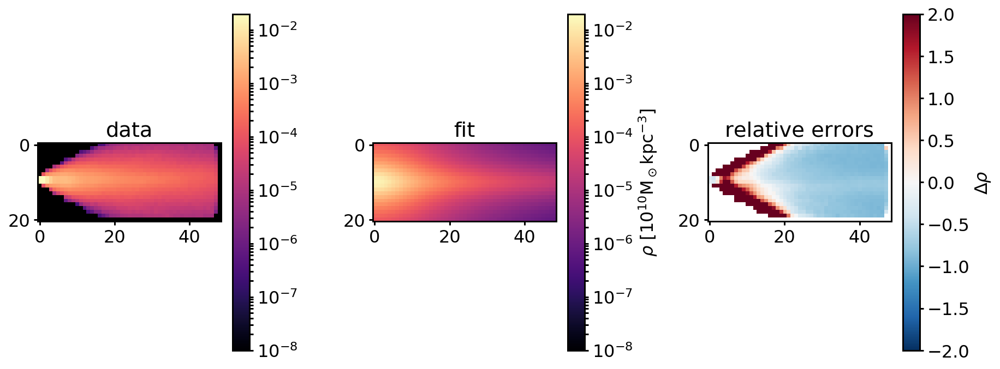

(21, 49)
a and b: 0.37156450651899586, 1.2718907738693659
Rho mean galpy: 0.0015035463399099647
Rho mean data: 0.00033879189738258395
113.549773273 117.1251829752916
Circular velocity ar R=8kpc: 113.54977327344096 km/s and its error compared to the data: -0.03052639587000594 km/s
Multiply rho error with 0.0009318608448123158
Error: 770706867658987.9
Error multiplied by vcirc error: 718191552799.358
data max: 0.019812705986395618, fit max: 0.14740256190305917, chosen max: 0.14740256190305917


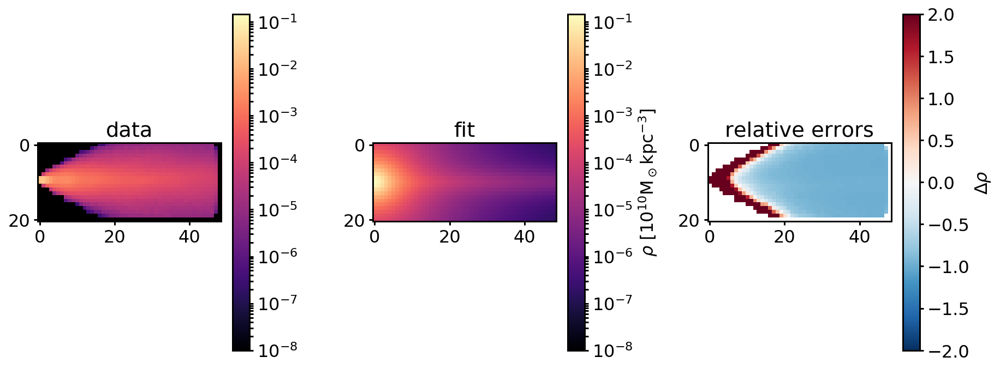

(21, 49)
a and b: 0.2696970799052876, 1.1885482313976796
Rho mean galpy: 0.0017352087182279955
Rho mean data: 0.00033879189738258395
114.288810304 117.1251829752916
Circular velocity ar R=8kpc: 114.28881030403723 km/s and its error compared to the data: -0.024216591165135852 km/s
Multiply rho error with 0.0005864432876593358
Error: 1298836909793131.5
Error multiplied by vcirc error: 761694187512.3762
data max: 0.019812705986395618, fit max: 0.20559047678407136, chosen max: 0.20559047678407136


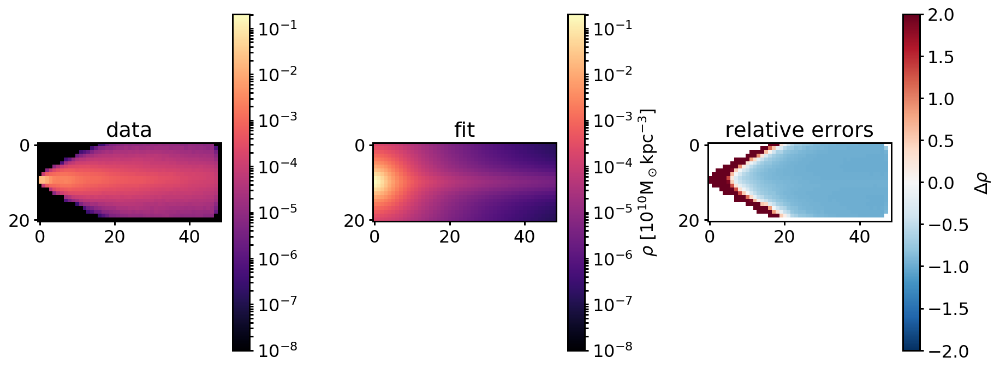

(21, 49)
a and b: 0.7422636506715108, 1.3893535182187633
Rho mean galpy: 0.0010900997403615485
Rho mean data: 0.00033879189738258395
111.252343699 117.1251829752916
Circular velocity ar R=8kpc: 111.25234369861421 km/s and its error compared to the data: -0.05014155903531267 km/s
Multiply rho error with 0.0025141759424917457
Error: 297941361256339.3
Error multiplied by vcirc error: 749077002743.9305
data max: 0.019812705986395618, fit max: 0.07317854650480429, chosen max: 0.07317854650480429


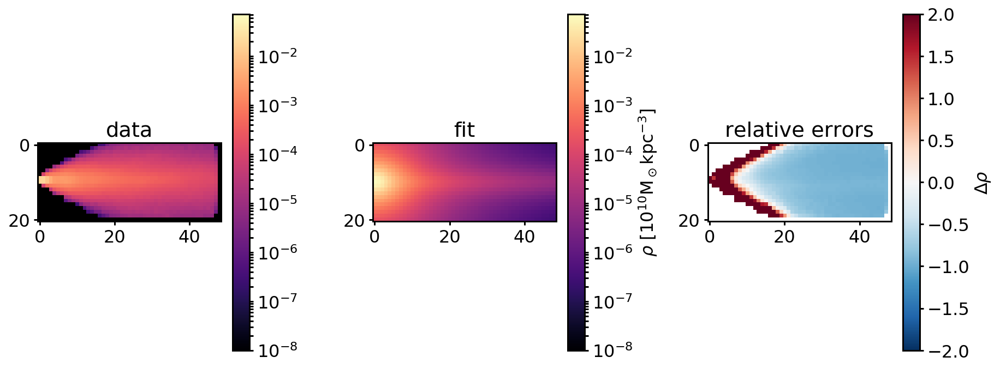

(21, 49)
a and b: 0.5761824758783769, 1.560598175036561
Rho mean galpy: 0.0011145996817491179
Rho mean data: 0.00033879189738258395
111.225521912 117.1251829752916
Circular velocity ar R=8kpc: 111.22552191246001 km/s and its error compared to the data: -0.05037056005347851 km/s
Multiply rho error with 0.0025371933201010846
Error: 276961997835993.66
Error multiplied by vcirc error: 702706130831.3341
data max: 0.019812705986395618, fit max: 0.06924563045403606, chosen max: 0.06924563045403606


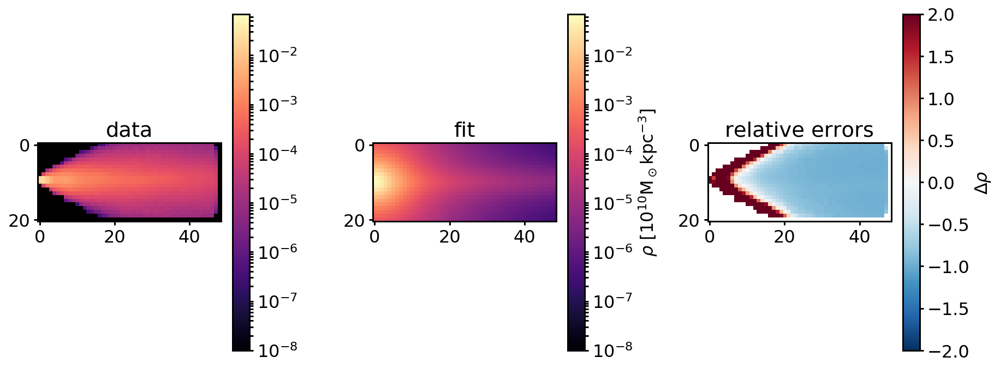

(21, 49)
a and b: 1.5069993261907921, 2.107806390019641
Rho mean galpy: 0.0005975192998762445
Rho mean data: 0.00033879189738258395
101.890731923 117.1251829752916
Circular velocity ar R=8kpc: 101.8907319234628 km/s and its error compared to the data: -0.13006981645478083 km/s
Multiply rho error with 0.016918157152580375
Error: 98595169165732.55
Error multiplied by vcirc error: 1668048566431.11
data max: 0.019812705986395618, fit max: 0.015902629785092975, chosen max: 0.019812705986395618


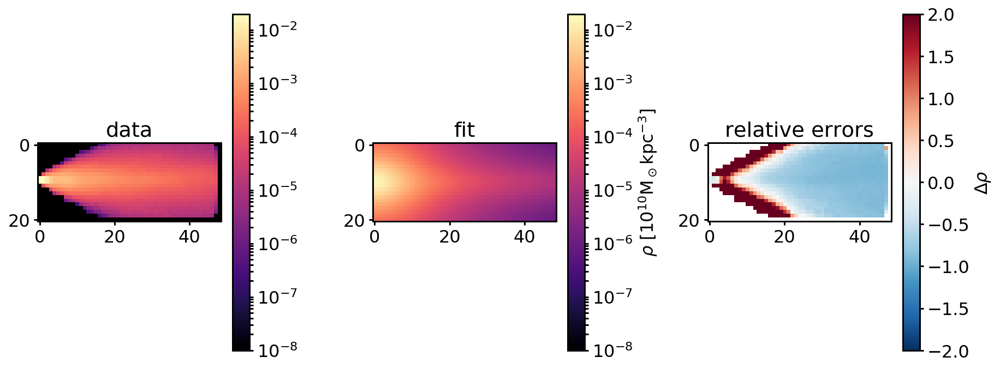

(21, 49)
a and b: 0.44745596483363137, 1.7996795762688755
Rho mean galpy: 0.0010766904541849396
Rho mean data: 0.00033879189738258395
110.640543875 117.1251829752916
Circular velocity ar R=8kpc: 110.64054387534162 km/s and its error compared to the data: -0.055365028555114014 km/s
Multiply rho error with 0.00306528638690859
Error: 240271415312086.75
Error multiplied by vcirc error: 736500698519.3997
data max: 0.019812705986395618, fit max: 0.05746611422371519, chosen max: 0.05746611422371519


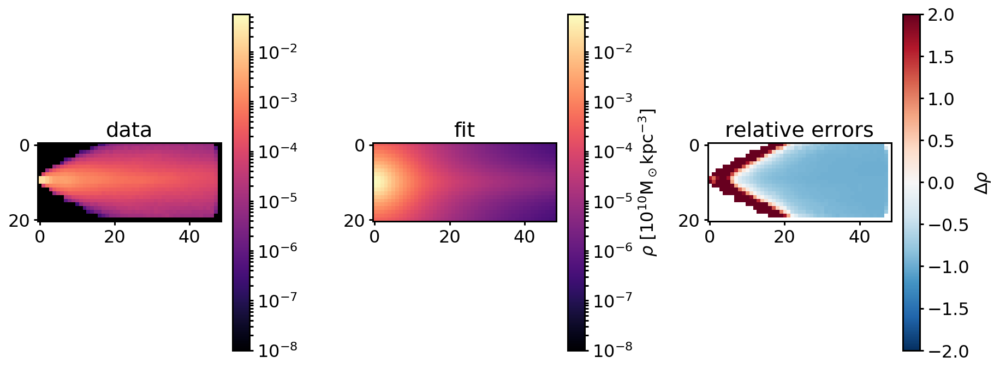

(21, 49)
a and b: 0.9495139754797775, 1.310742756321934
Rho mean galpy: 0.0009985131372021727
Rho mean data: 0.00033879189738258395
110.569522752 117.1251829752916
Circular velocity ar R=8kpc: 110.5695227520528 km/s and its error compared to the data: -0.05597139792406346 km/s
Multiply rho error with 0.003132797385573855
Error: 272689092448980.44
Error multiplied by vcirc error: 854279675898.6732
data max: 0.019812705986395618, fit max: 0.06478630987979915, chosen max: 0.06478630987979915


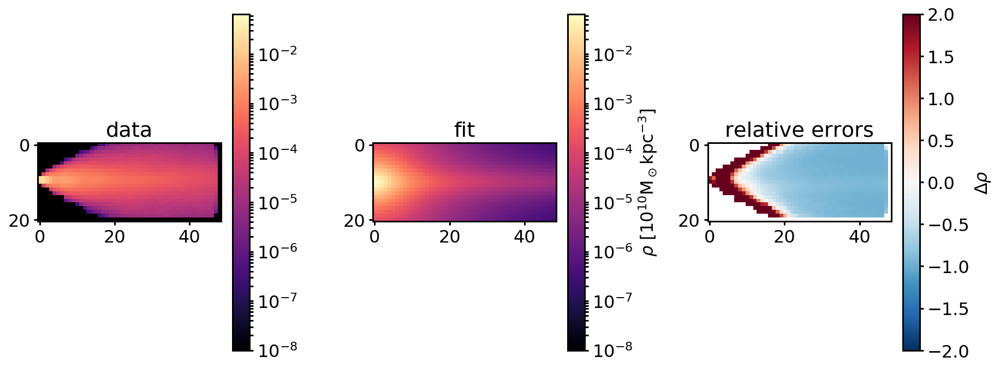

(21, 49)
a and b: 0.19504804358213068, 1.3450822594725447
Rho mean galpy: 0.0016629739444408746
Rho mean data: 0.00033879189738258395
113.971582322 117.1251829752916
Circular velocity ar R=8kpc: 113.97158232169717 km/s and its error compared to the data: -0.026925043560100125 km/s
Multiply rho error with 0.0007249579707132892
Error: 1088233422129727.5
Error multiplied by vcirc error: 788923493369.5454
data max: 0.019812705986395618, fit max: 0.17052048111987525, chosen max: 0.17052048111987525


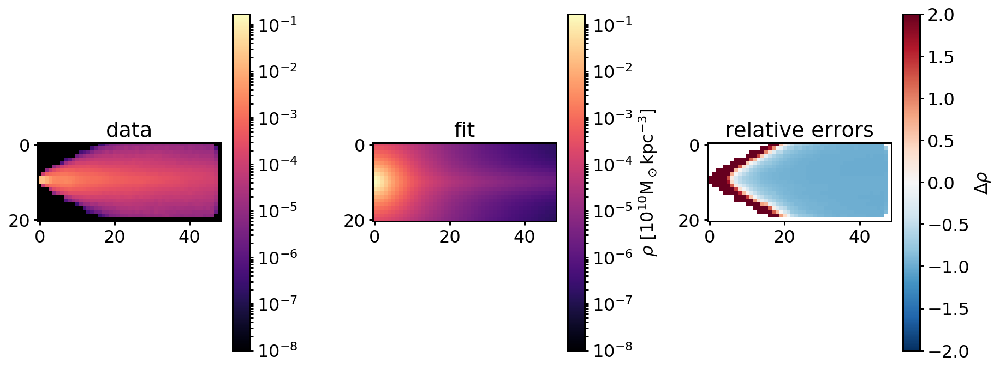

(21, 49)
a and b: 0.9189085164299966, 1.3437484927938212
Rho mean galpy: 0.001002223354965956
Rho mean data: 0.00033879189738258395
110.556497575 117.1251829752916
Circular velocity ar R=8kpc: 110.55649757458508 km/s and its error compared to the data: -0.05608260524205307 km/s
Multiply rho error with 0.003145258610735959
Error: 263855662092437.7
Error multiplied by vcirc error: 829894293187.6771
data max: 0.019812705986395618, fit max: 0.06387568336983034, chosen max: 0.06387568336983034


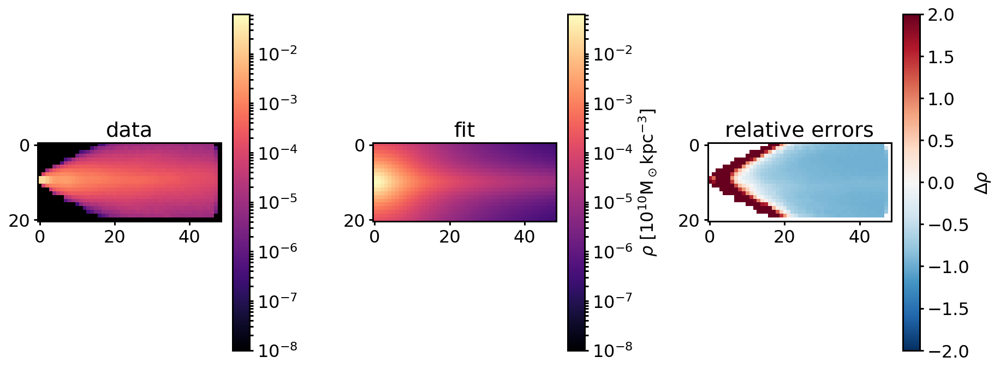

(21, 49)
a and b: 8.176009195005966, 1.1718408674636887
Rho mean galpy: 0.00017519085542171898
Rho mean data: 0.00033879189738258395
61.4085632717 117.1251829752916
Circular velocity ar R=8kpc: 61.40856327173123 km/s and its error compared to the data: -0.4757014528234648 km/s
Multiply rho error with 0.22629187221835512
Error: 89721296986033.84
Error multiplied by vcirc error: 20303200272828.66
data max: 0.019812705986395618, fit max: 0.002478968375482843, chosen max: 0.019812705986395618


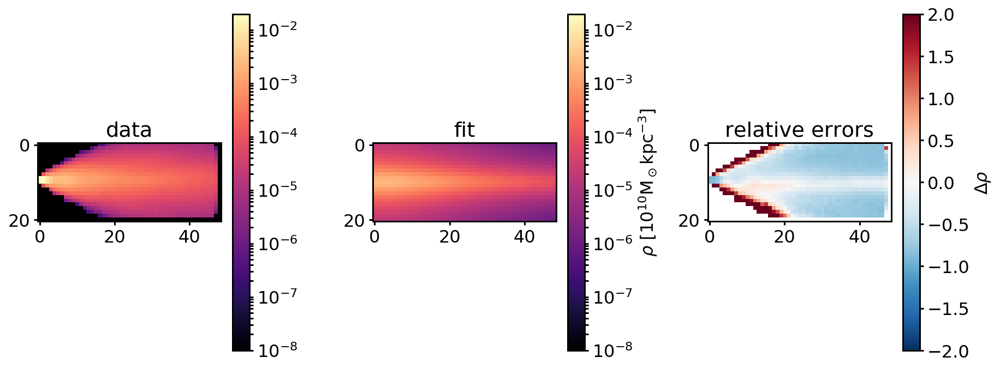

(21, 49)
a and b: 4.148387237744539, 1.3801847938187082
Rho mean galpy: 0.00033375581249847397
Rho mean data: 0.00033879189738258395
87.3950969025 117.1251829752916
Circular velocity ar R=8kpc: 87.39509690251626 km/s and its error compared to the data: -0.253831715072301 km/s
Multiply rho error with 0.0644305395765458
Error: 94666116789121.94
Error multiplied by vcirc error: 6099388984339.429
data max: 0.019812705986395618, fit max: 0.007205377693616094, chosen max: 0.019812705986395618


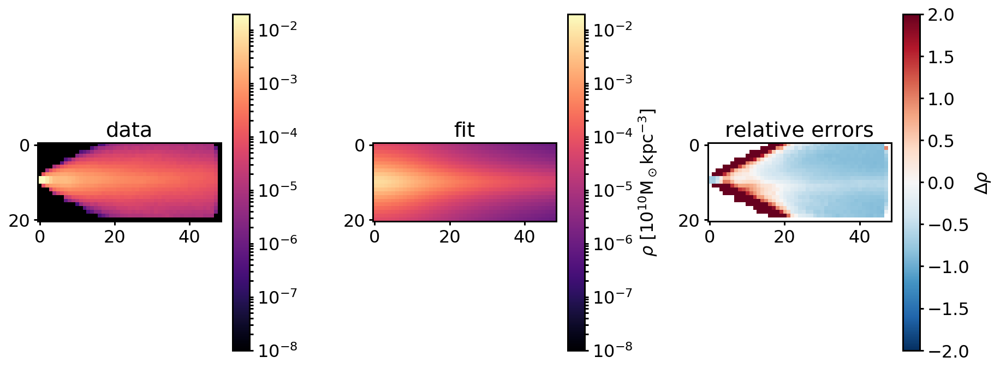

(21, 49)
a and b: 0.4286518520525524, 1.3666977964481246
Rho mean galpy: 0.0013601610885130208
Rho mean data: 0.00033879189738258395
112.887404229 117.1251829752916
Circular velocity ar R=8kpc: 112.8874042286478 km/s and its error compared to the data: -0.036181619007910434 km/s
Multiply rho error with 0.0013091095540335856
Error: 532887049321267.9
Error multiplied by vcirc error: 697607527487.2384
data max: 0.019812705986395618, fit max: 0.11420438295109717, chosen max: 0.11420438295109717


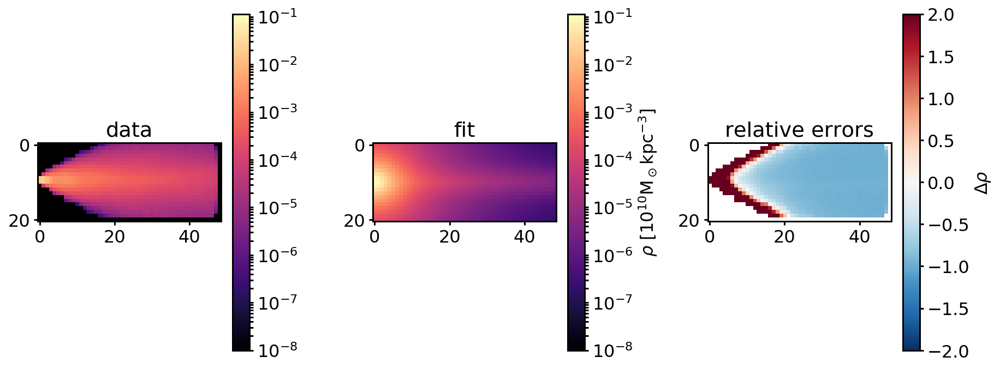

(21, 49)
a and b: 0.6740618656501836, 1.5837098125196252
Rho mean galpy: 0.0010403881044718797
Rho mean data: 0.00033879189738258395
110.582997171 117.1251829752916
Circular velocity ar R=8kpc: 110.5829971714195 km/s and its error compared to the data: -0.055856355035553786 km/s
Multiply rho error with 0.0031199323978578345
Error: 233096807474934.03
Error multiplied by vcirc error: 727246281478.277
data max: 0.019812705986395618, fit max: 0.05976457190203094, chosen max: 0.05976457190203094


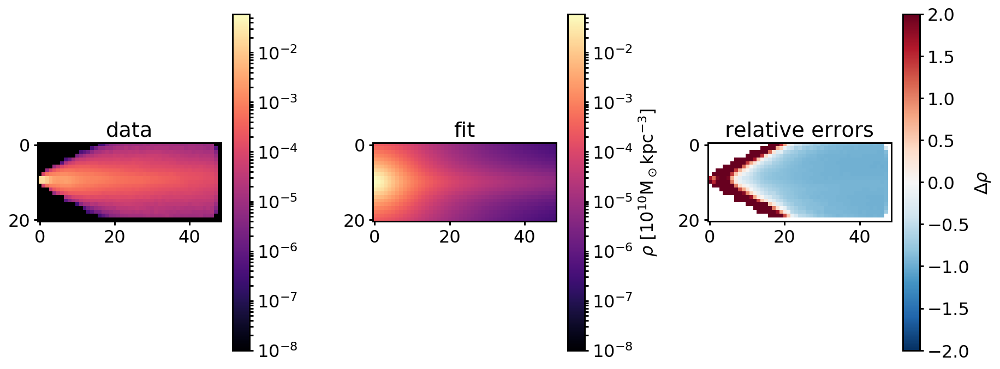

(21, 49)
a and b: 1.42640648515935, 1.7718058440378304
Rho mean galpy: 0.0006787589252983541
Rho mean data: 0.00033879189738258395
104.798961001 117.1251829752916
Circular velocity ar R=8kpc: 104.79896100069092 km/s and its error compared to the data: -0.10523972438276555 km/s
Multiply rho error with 0.011075399588160457
Error: 114881584493085.94
Error multiplied by vcirc error: 1272359453581.9448
data max: 0.019812705986395618, fit max: 0.02349177633349806, chosen max: 0.02349177633349806


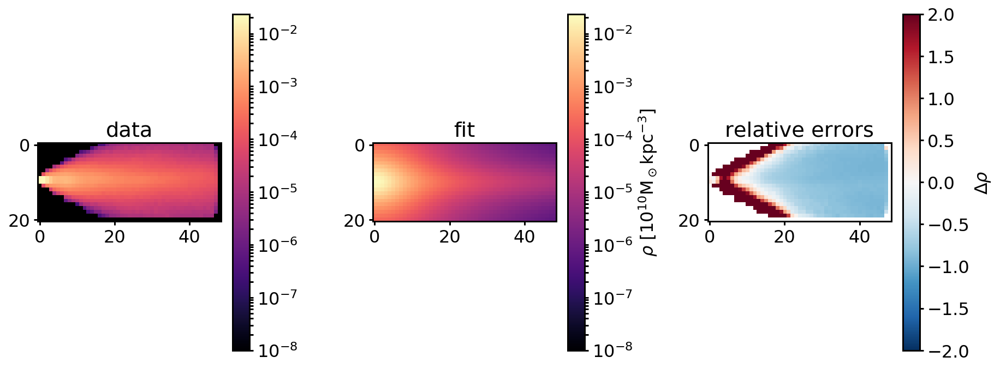

(21, 49)
a and b: 0.11164607366760126, 1.3623047071393803
Rho mean galpy: 0.0017706330946907706
Rho mean data: 0.00033879189738258395
114.229152268 117.1251829752916
Circular velocity ar R=8kpc: 114.22915226780964 km/s and its error compared to the data: -0.024725943933790004 km/s
Multiply rho error with 0.0006113723034169267
Error: 1498461196257956.5
Error multiplied by vcirc error: 916117673137.1104
data max: 0.019812705986395618, fit max: 0.19016248374685576, chosen max: 0.19016248374685576


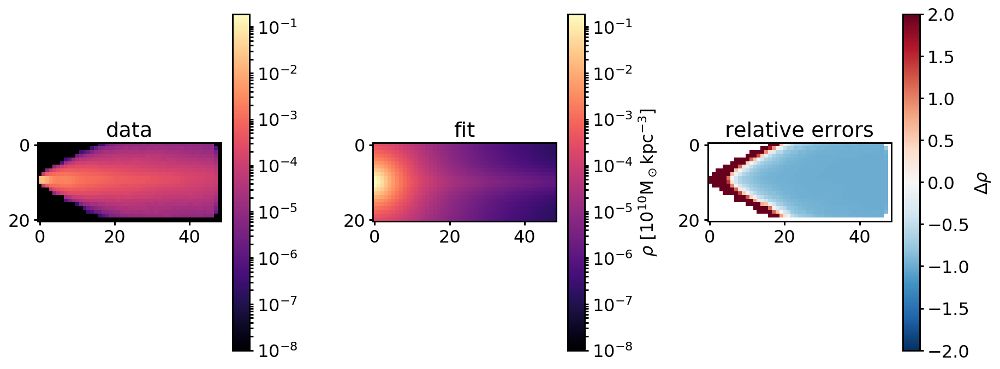

(21, 49)
a and b: 1.831686445713515, 1.6641438936004458
Rho mean galpy: 0.0006001179948367559
Rho mean data: 0.00033879189738258395
102.737740148 117.1251829752916
Circular velocity ar R=8kpc: 102.73774014778725 km/s and its error compared to the data: -0.12283816735244273 km/s
Multiply rho error with 0.015089215358506726
Error: 109020220372911.94
Error multiplied by vcirc error: 1645029583638.7307
data max: 0.019812705986395618, fit max: 0.019404898901837945, chosen max: 0.019812705986395618


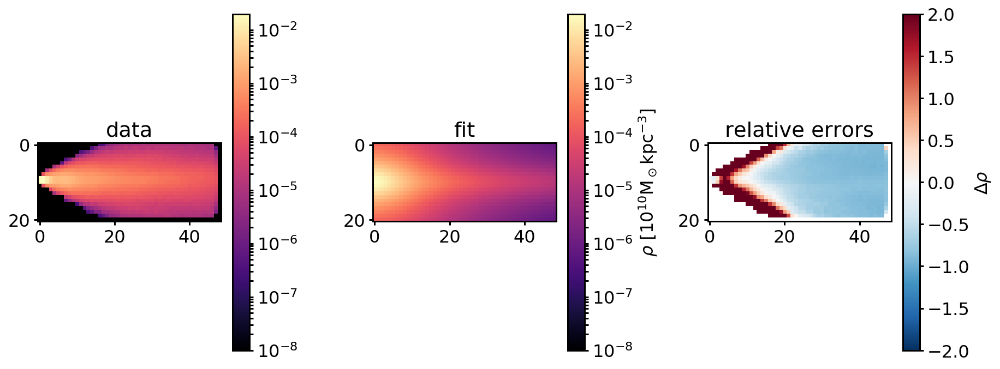

(21, 49)
a and b: 0.5734939710123923, 1.5082866241032937
Rho mean galpy: 0.0011446826318949666
Rho mean data: 0.00033879189738258395
111.508643811 117.1251829752916
Circular velocity ar R=8kpc: 111.50864381059273 km/s and its error compared to the data: -0.04795330109224857 km/s
Multiply rho error with 0.002299519085643848
Error: 304230768610215.06
Error multiplied by vcirc error: 699584458859.2867
data max: 0.019812705986395618, fit max: 0.07507590717367098, chosen max: 0.07507590717367098


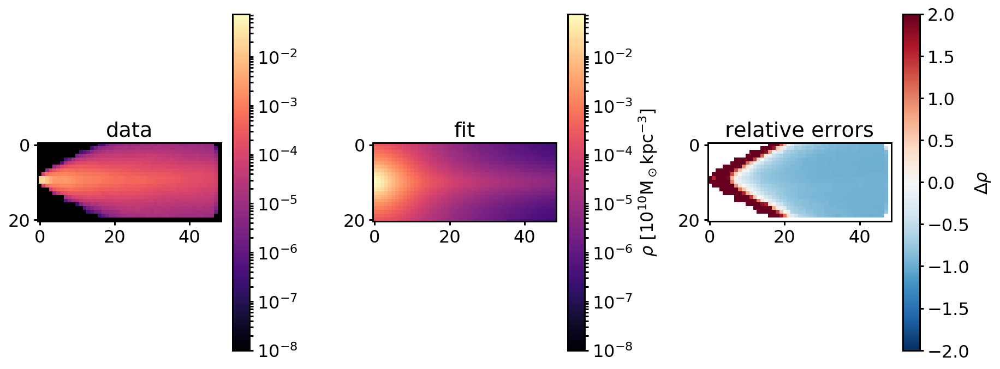

(21, 49)
a and b: 0.39987322926741786, 1.4931805469727149
Rho mean galpy: 0.0012945772227832685
Rho mean data: 0.00033879189738258395
112.43564562 117.1251829752916
Circular velocity ar R=8kpc: 112.43564561971297 km/s and its error compared to the data: -0.04003867687931736 km/s
Multiply rho error with 0.0016030956462463823
Error: 432470054867865.9
Error multiplied by vcirc error: 693290862090.6099
data max: 0.019812705986395618, fit max: 0.09623545159912958, chosen max: 0.09623545159912958


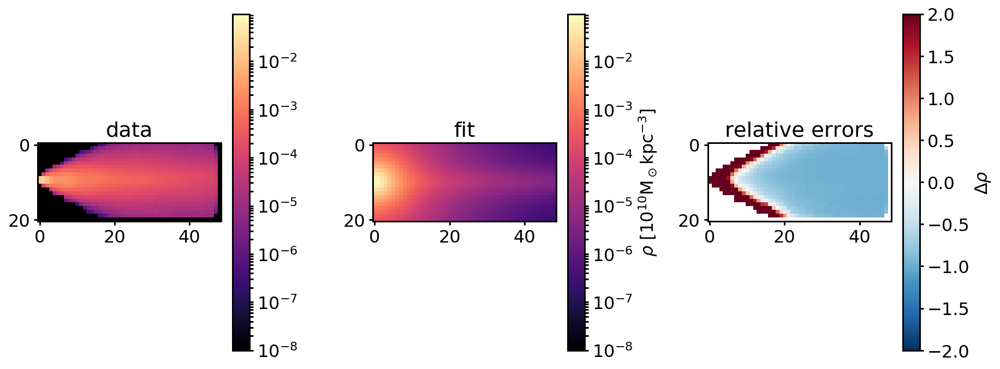

(21, 49)
a and b: 0.32503533742432467, 1.2939895960298426
Rho mean galpy: 0.001540259581755138
Rho mean data: 0.00033879189738258395
113.651643533 117.1251829752916
Circular velocity ar R=8kpc: 113.65164353307432 km/s and its error compared to the data: -0.029656640476284604 km/s
Multiply rho error with 0.0008795163243396023
Error: 821379870753800.1
Error multiplied by vcirc error: 722417004811.9199
data max: 0.019812705986395618, fit max: 0.15214394013252747, chosen max: 0.15214394013252747


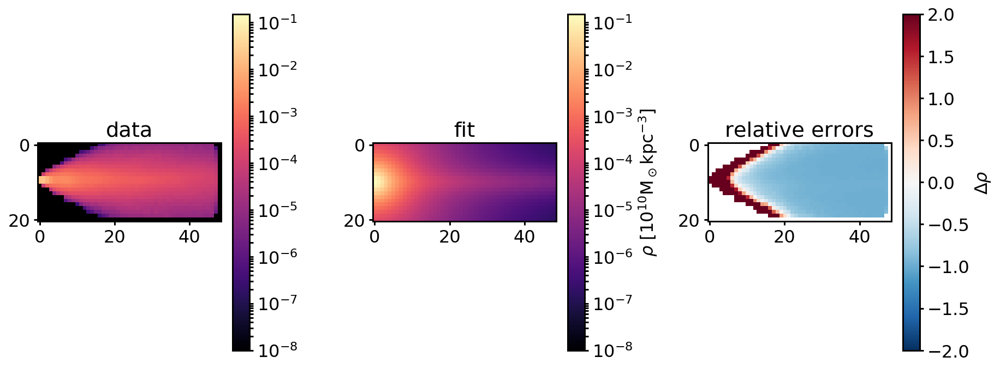

(21, 49)
a and b: 0.4920247864154357, 1.6790841290516396
Rho mean galpy: 0.0011094416447091113
Rho mean data: 0.00033879189738258395
111.045942881 117.1251829752916
Circular velocity ar R=8kpc: 111.04594288060784 km/s and its error compared to the data: -0.051903783116959694 km/s
Multiply rho error with 0.00269400270185239
Error: 263196502535651.8
Error multiplied by vcirc error: 709052088949.1454
data max: 0.019812705986395618, fit max: 0.06453884753335667, chosen max: 0.06453884753335667


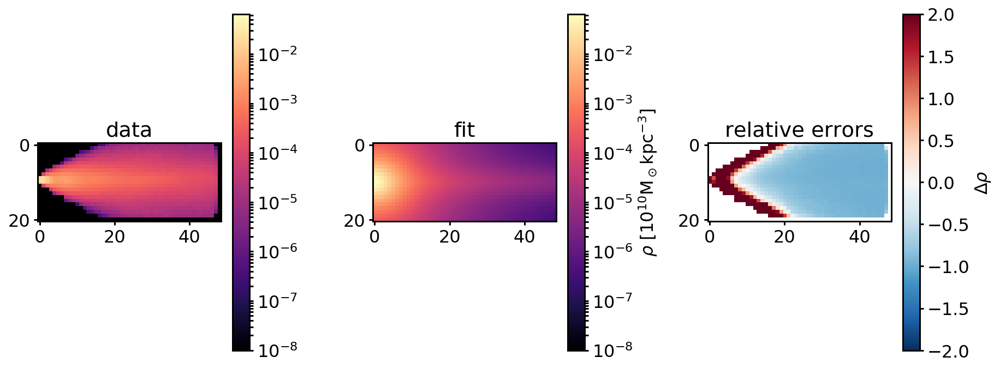

differential_evolution step 6: f(x)= 6.93291e+11
(21, 49)
a and b: 0.3693833078899287, 1.4931805469727149
Rho mean galpy: 0.0013227854279914196
Rho mean data: 0.00033879189738258395
112.57873443 117.1251829752916
Circular velocity ar R=8kpc: 112.57873443043813 km/s and its error compared to the data: -0.03881700270908066 km/s
Multiply rho error with 0.0015067596993167752
Error: 463319625558788.1
Error multiplied by vcirc error: 698111339694.5205
data max: 0.019812705986395618, fit max: 0.1003503290274373, chosen max: 0.1003503290274373


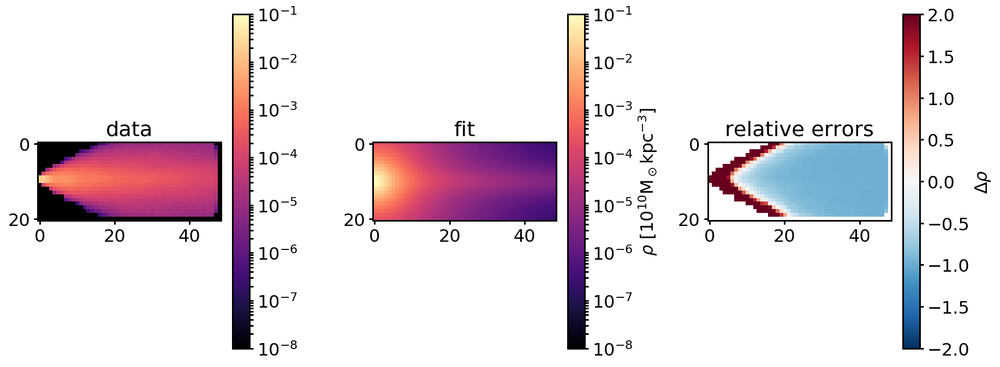

(21, 49)
a and b: 1.3298414473036817, 1.7547168418332872
Rho mean galpy: 0.000709619245719264
Rho mean data: 0.00033879189738258395
105.561489045 117.1251829752916
Circular velocity ar R=8kpc: 105.56148904523995 km/s and its error compared to the data: -0.09872935637155919 km/s
Multiply rho error with 0.009747485809542336
Error: 120198476057979.44
Error multiplied by vcirc error: 1171632939703.7688
data max: 0.019812705986395618, fit max: 0.02584951282121422, chosen max: 0.02584951282121422


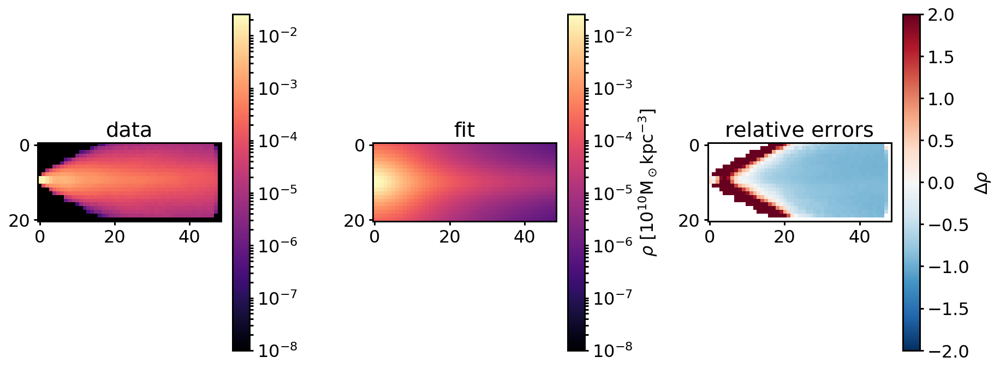

(21, 49)
a and b: 0.36428086242411073, 1.309313785120304
Rho mean galpy: 0.0014778873492471533
Rho mean data: 0.00033879189738258395
113.422296071 117.1251829752916
Circular velocity ar R=8kpc: 113.42229607124567 km/s and its error compared to the data: -0.031614780100937614 km/s
Multiply rho error with 0.000999494320830641
Error: 712329958346770.9
Error multiplied by vcirc error: 711969747925.1245
data max: 0.019812705986395618, fit max: 0.13909300636272698, chosen max: 0.13909300636272698


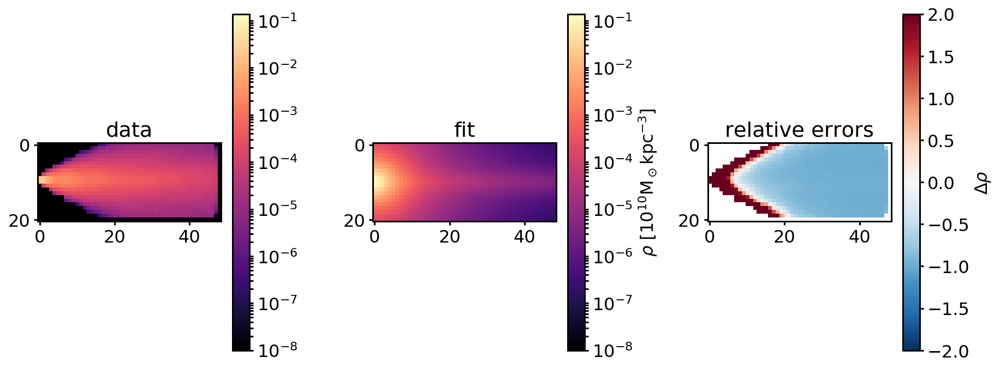

(21, 49)
a and b: 0.5613368949971296, 1.4262306128471962
Rho mean galpy: 0.0012012426085916661
Rho mean data: 0.00033879189738258395
111.980172386 117.1251829752916
Circular velocity ar R=8kpc: 111.98017238558435 km/s and its error compared to the data: -0.0439274497508586 km/s
Multiply rho error with 0.001929620841614207
Error: 362717260295314.0
Error multiplied by vcirc error: 699906785079.0432
data max: 0.019812705986395618, fit max: 0.08649756635120141, chosen max: 0.08649756635120141


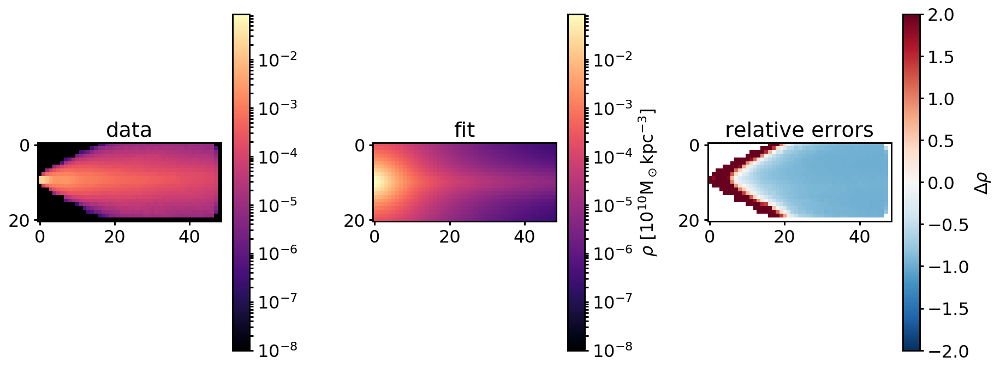

(21, 49)
a and b: 0.2050451735936365, 1.4672490602219304
Rho mean galpy: 0.0015212631081120735
Rho mean data: 0.00033879189738258395
113.42783716 117.1251829752916
Circular velocity ar R=8kpc: 113.4278371595657 km/s and its error compared to the data: -0.03156747098961526 km/s
Multiply rho error with 0.0009965052246802008
Error: 783163574197339.0
Error multiplied by vcirc error: 780426593466.8684
data max: 0.019812705986395618, fit max: 0.1334778543482433, chosen max: 0.1334778543482433


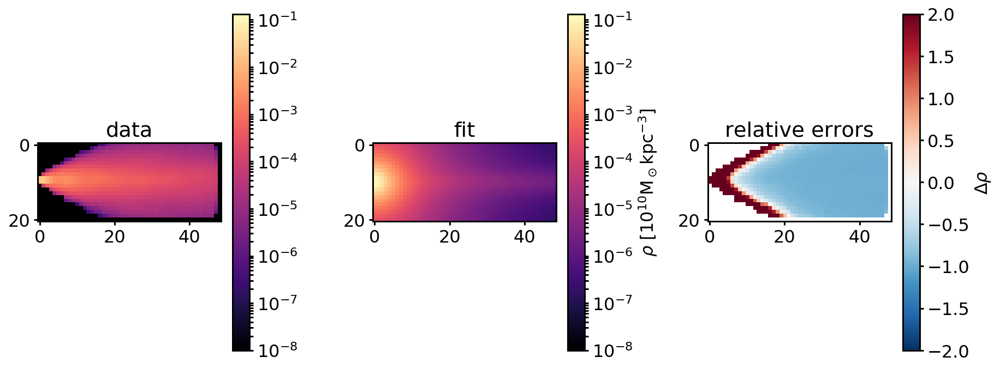

(21, 49)
a and b: 7.946392173590321, 1.0737392092292093
Rho mean galpy: 0.00018196244347450793
Rho mean data: 0.00033879189738258395
63.3060723611 117.1251829752916
Circular velocity ar R=8kpc: 63.306072361118936 km/s and its error compared to the data: -0.45950076018686936 km/s
Multiply rho error with 0.21114094861231084
Error: 94271121847895.77
Error multiplied by vcirc error: 19904494093711.453
data max: 0.019812705986395618, fit max: 0.002876151952336328, chosen max: 0.019812705986395618


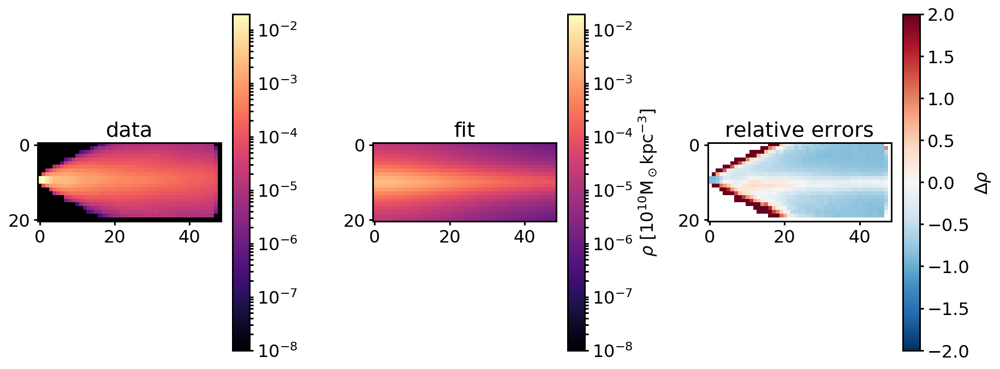

(21, 49)
a and b: 8.834130340663537, 1.2809863012803022
Rho mean galpy: 0.00015986394778212454
Rho mean data: 0.00033879189738258395
57.2249672339 117.1251829752916
Circular velocity ar R=8kpc: 57.224967233875695 km/s and its error compared to the data: -0.5114204667159605 km/s
Multiply rho error with 0.2615508937759709
Error: 86400030841989.47
Error multiplied by vcirc error: 22598005288993.797
data max: 0.019812705986395618, fit max: 0.0019408729130561194, chosen max: 0.019812705986395618


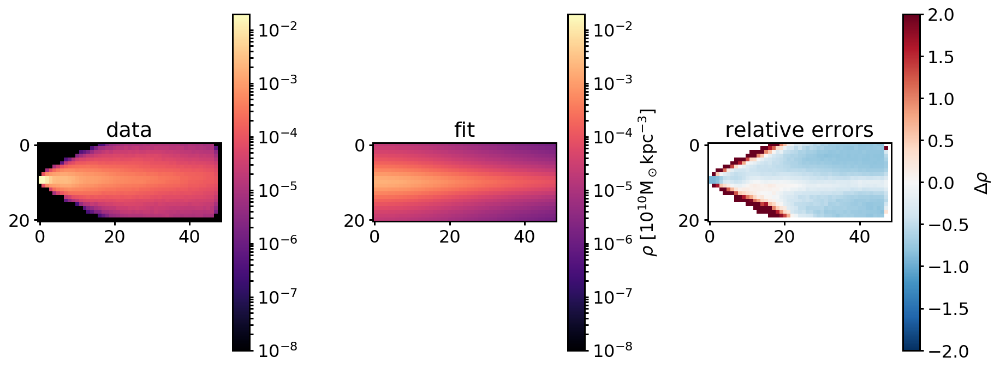

(21, 49)
a and b: 9.937657838607212, 1.1087128397602855
Rho mean galpy: 0.0001422631619732755
Rho mean data: 0.00033879189738258395
52.6152328238 117.1251829752916
Circular velocity ar R=8kpc: 52.6152328238459 km/s and its error compared to the data: -0.5507777961384661 km/s
Multiply rho error with 0.3033561807191457
Error: 89510642736534.16
Error multiplied by vcirc error: 27153606714270.945
data max: 0.019812705986395618, fit max: 0.001801602429420037, chosen max: 0.019812705986395618


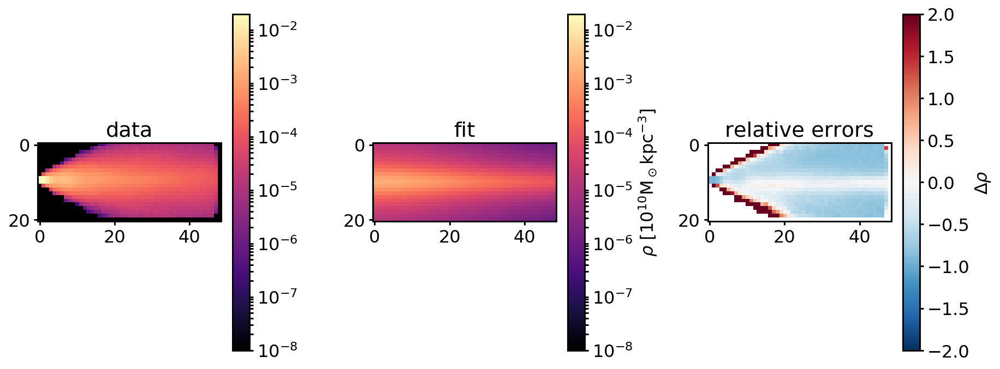

(21, 49)
a and b: 0.2967611077231167, 1.827436225390387
Rho mean galpy: 0.0011643539052036448
Rho mean data: 0.00033879189738258395
111.290798838 117.1251829752916
Circular velocity ar R=8kpc: 111.29079883841409 km/s and its error compared to the data: -0.04981323391493278 km/s
Multiply rho error with 0.0024813582730638093
Error: 312759985081700.6
Error multiplied by vcirc error: 776069576465.7914
data max: 0.019812705986395618, fit max: 0.06612651281425243, chosen max: 0.06612651281425243


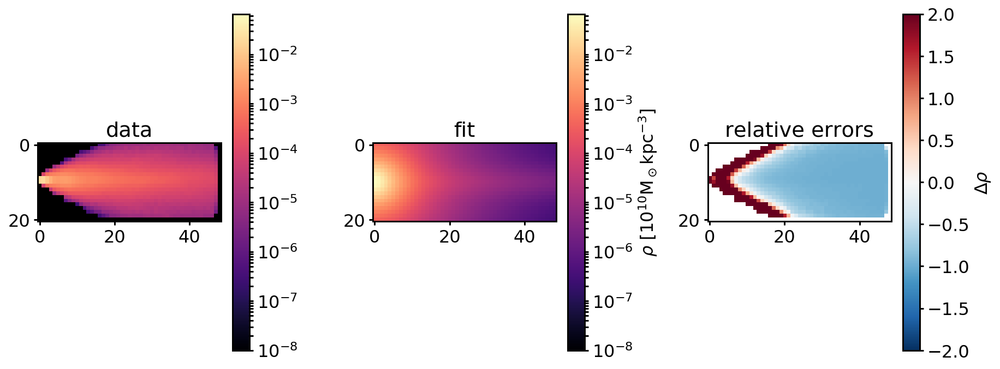

(21, 49)
a and b: 0.4863911890654977, 1.6036475746567427
Rho mean galpy: 0.0011545501399836148
Rho mean data: 0.00033879189738258395
111.466498248 117.1251829752916
Circular velocity ar R=8kpc: 111.46649824770155 km/s and its error compared to the data: -0.0483131345782724 km/s
Multiply rho error with 0.0023341589727782605
Error: 298703502299326.75
Error multiplied by vcirc error: 697221460092.2653
data max: 0.019812705986395618, fit max: 0.07250041279688789, chosen max: 0.07250041279688789


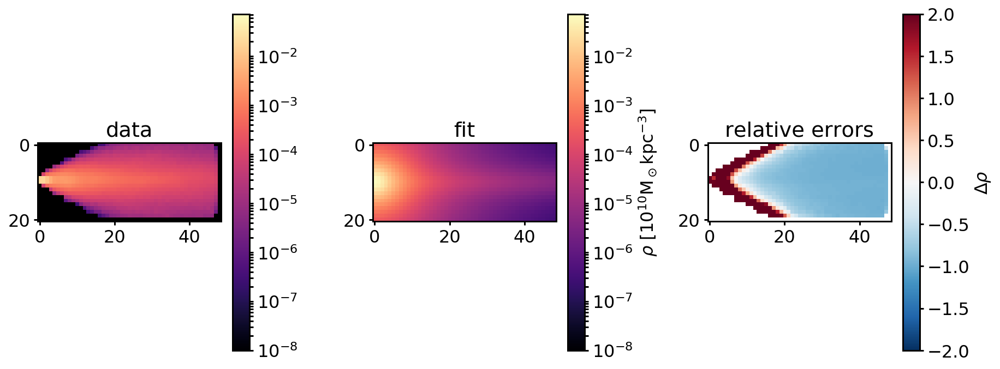

(21, 49)
a and b: 0.11650942556260713, 1.242184193950326
Rho mean galpy: 0.001931177783740364
Rho mean data: 0.00033879189738258395
114.653673856 117.1251829752916
Circular velocity ar R=8kpc: 114.6536738562078 km/s and its error compared to the data: -0.021101432299193708 km/s
Multiply rho error with 0.00044527044507745547
Error: 2028718731123461.0
Error multiplied by vcirc error: 903328492344.3142
data max: 0.019812705986395618, fit max: 0.24255471138826476, chosen max: 0.24255471138826476


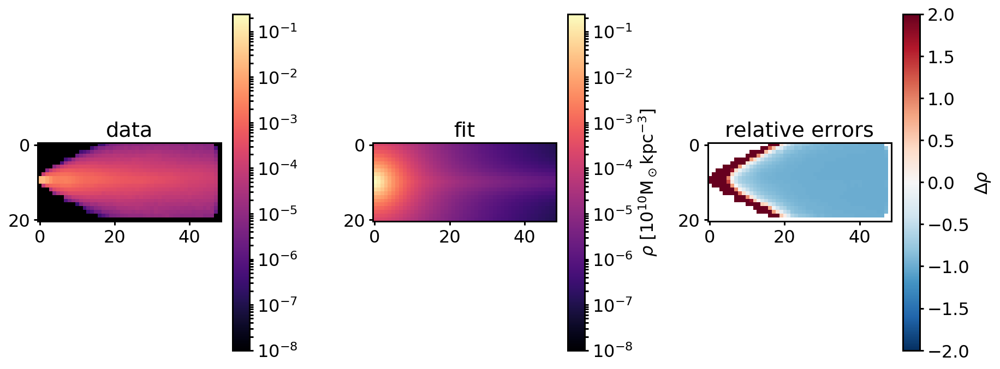

(21, 49)
a and b: 0.26776301296357286, 1.0341099234027242
Rho mean galpy: 0.001952717215373612
Rho mean data: 0.00033879189738258395
114.851495368 117.1251829752916
Circular velocity ar R=8kpc: 114.8514953683643 km/s and its error compared to the data: -0.019412457245910536 km/s
Multiply rho error with 0.0003768434963243045
Error: 2167851052977448.5
Error multiplied by vcirc error: 816940570314.3467
data max: 0.019812705986395618, fit max: 0.2898156102970444, chosen max: 0.2898156102970444


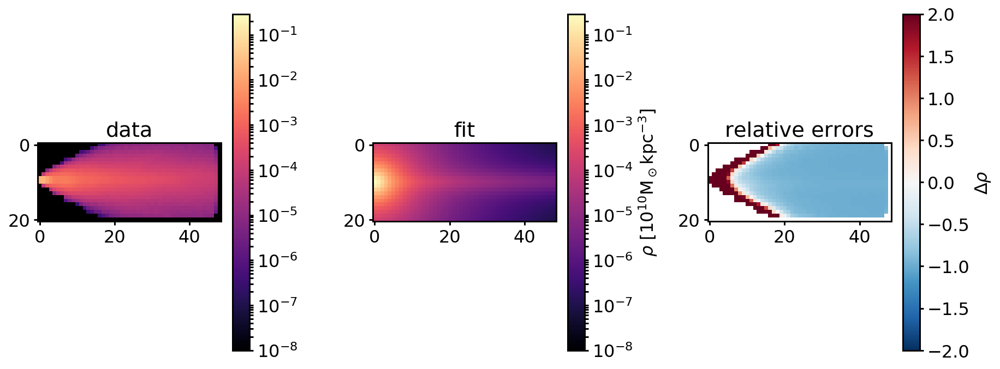

(21, 49)
a and b: 0.6418867829372878, 1.3893535182187633
Rho mean galpy: 0.001160747566910683
Rho mean data: 0.00033879189738258395
111.763732099 117.1251829752916
Circular velocity ar R=8kpc: 111.76373209918744 km/s and its error compared to the data: -0.04577538954398214 km/s
Multiply rho error with 0.002095386287903309
Error: 343545531970174.1
Error multiplied by vcirc error: 719860596960.7507
data max: 0.019812705986395618, fit max: 0.0827307390506683, chosen max: 0.0827307390506683


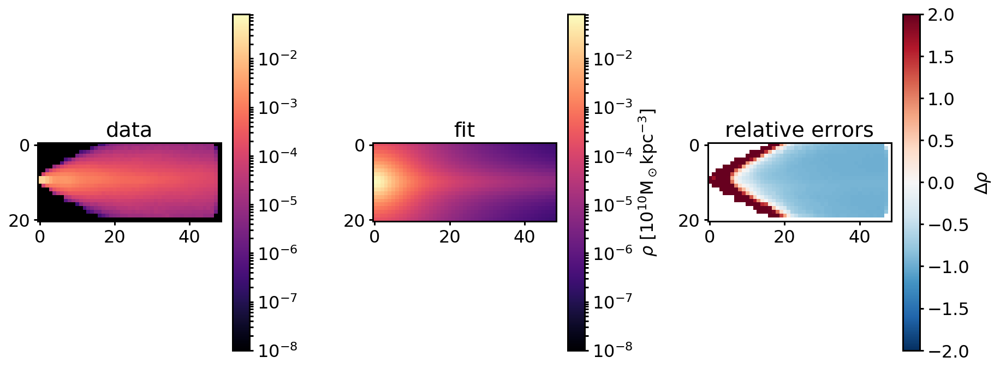

(21, 49)
a and b: 0.33712226656644617, 1.4666626911443652
Rho mean galpy: 0.0013745575741857651
Rho mean data: 0.00033879189738258395
112.849182127 117.1251829752916
Circular velocity ar R=8kpc: 112.8491821271969 km/s and its error compared to the data: -0.03650795447633794 km/s
Multiply rho error with 0.001332830740046363
Error: 529337536174496.6
Error multiplied by vcirc error: 705517340073.7728
data max: 0.019812705986395618, fit max: 0.10976156708428357, chosen max: 0.10976156708428357


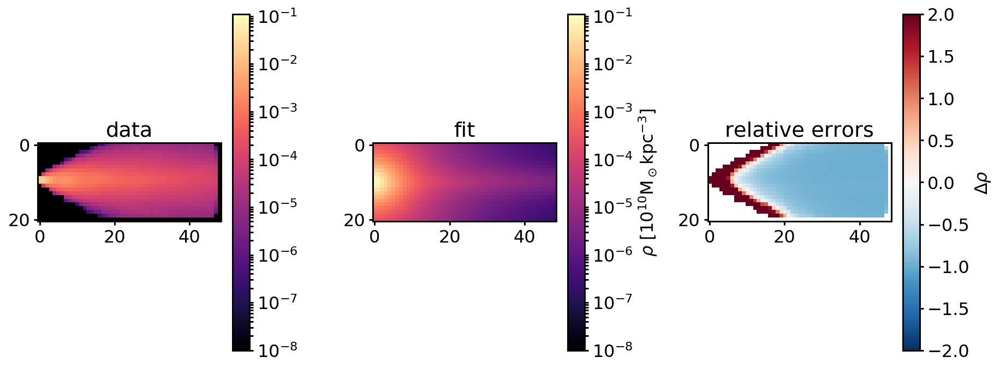

(21, 49)
a and b: 0.31588337639119324, 1.598889743357509
Rho mean galpy: 0.0012958750391851453
Rho mean data: 0.00033879189738258395
112.332563637 117.1251829752916
Circular velocity ar R=8kpc: 112.33256363729228 km/s and its error compared to the data: -0.040918777808956336 km/s
Multiply rho error with 0.0016743463773787374
Error: 430459520906499.9
Error multiplied by vcirc error: 720738339437.985
data max: 0.019812705986395618, fit max: 0.09101997373764464, chosen max: 0.09101997373764464


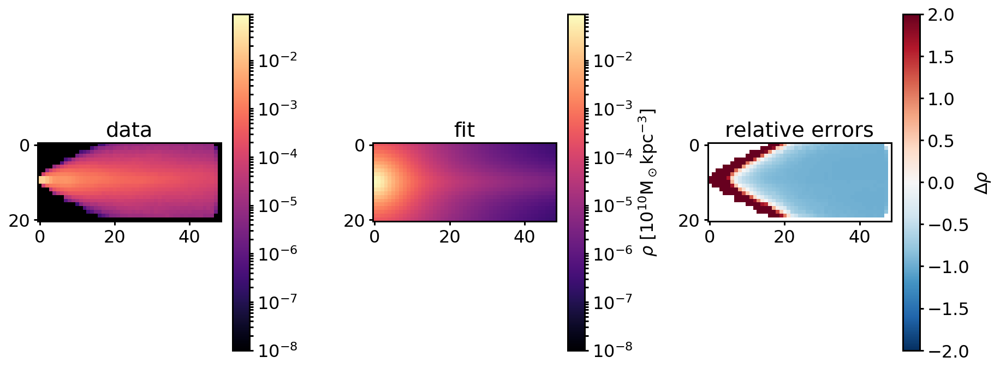

(21, 49)
a and b: 1.3267705911948506, 1.316525102609569
Rho mean galpy: 0.00081901979226889
Rho mean data: 0.00033879189738258395
108.368007961 117.1251829752916
Circular velocity ar R=8kpc: 108.36800796069377 km/s and its error compared to the data: -0.07476765279799144 km/s
Multiply rho error with 0.005590201904920997
Error: 194746647234783.62
Error multiplied by vcirc error: 1088673078348.8649
data max: 0.019812705986395618, fit max: 0.04372381443753638, chosen max: 0.04372381443753638


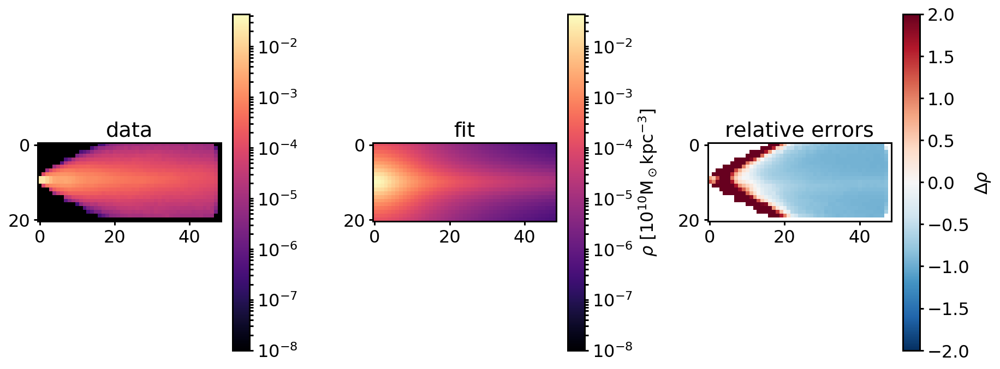

(21, 49)
a and b: 0.35910510378993354, 1.6034919743265097
Rho mean galpy: 0.0012548570563001137
Rho mean data: 0.00033879189738258395
112.102240837 117.1251829752916
Circular velocity ar R=8kpc: 112.10224083660081 km/s and its error compared to the data: -0.04288524475347378 km/s
Multiply rho error with 0.0018391442175653503
Error: 384976594017766.06
Error multiplied by vcirc error: 708027476785.7778
data max: 0.019812705986395618, fit max: 0.08529408821822106, chosen max: 0.08529408821822106


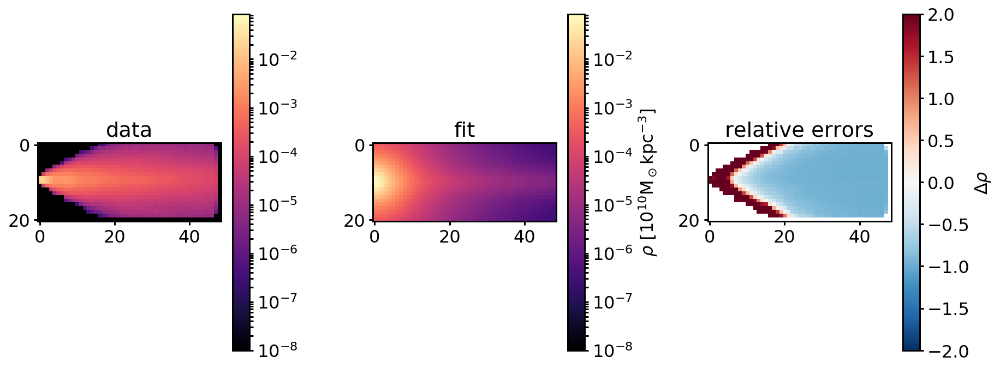

(21, 49)
a and b: 0.5801249114279265, 1.3450822594725447
Rho mean galpy: 0.0012361100810034534
Rho mean data: 0.00033879189738258395
112.282703766 117.1251829752916
Circular velocity ar R=8kpc: 112.2827037658278 km/s and its error compared to the data: -0.041344475085988514 km/s
Multiply rho error with 0.0017093656201359248
Error: 417628218965550.75
Error multiplied by vcirc error: 713879319498.3104
data max: 0.019812705986395618, fit max: 0.09615024017758673, chosen max: 0.09615024017758673


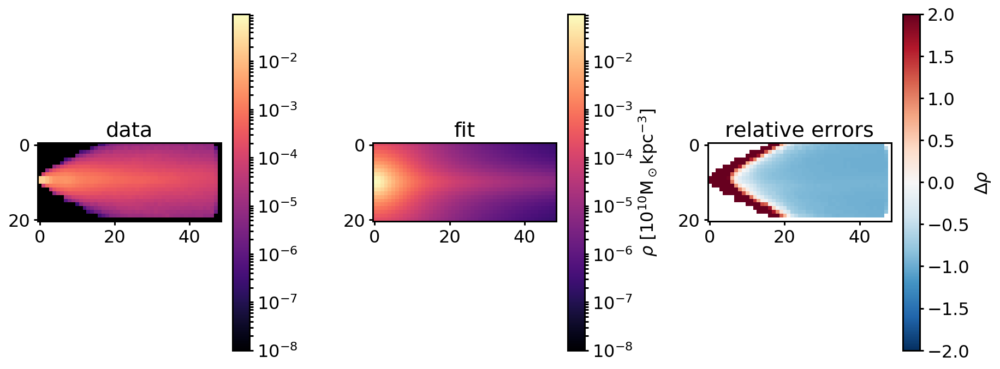

(21, 49)
a and b: 0.6574522476421709, 1.545629889551849
Rho mean galpy: 0.0010686081570784596
Rho mean data: 0.00033879189738258395
110.876730558 117.1251829752916
Circular velocity ar R=8kpc: 110.87673055821122 km/s and its error compared to the data: -0.05334849652613587 km/s
Multiply rho error with 0.0028460620815991314
Error: 252680460860662.94
Error multiplied by vcirc error: 719144278416.5262
data max: 0.019812705986395618, fit max: 0.06428568558785092, chosen max: 0.06428568558785092


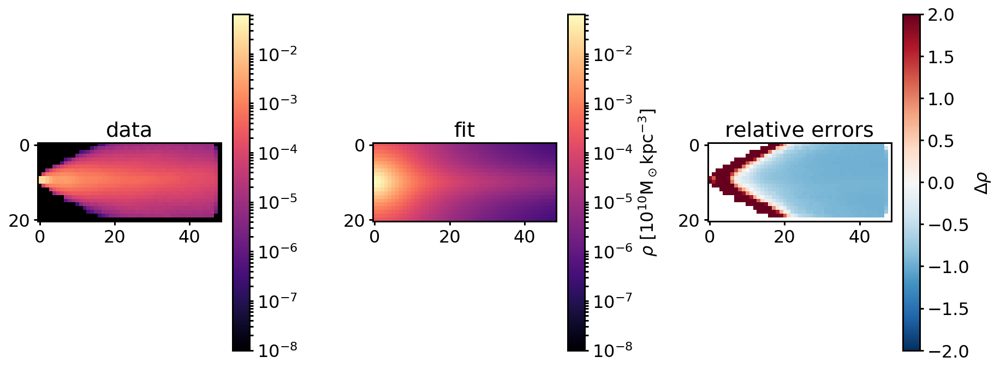

(21, 49)
a and b: 6.0051628760105995, 1.05611104271814
Rho mean galpy: 0.00024341347854440874
Rho mean data: 0.00033879189738258395
76.0330358889 117.1251829752916
Circular velocity ar R=8kpc: 76.03303588894985 km/s and its error compared to the data: -0.3508395551024277 km/s
Multiply rho error with 0.12308839342446941
Error: 102687856100385.94
Error multiplied by vcirc error: 12639683231599.605
data max: 0.019812705986395618, fit max: 0.005005040311907961, chosen max: 0.019812705986395618


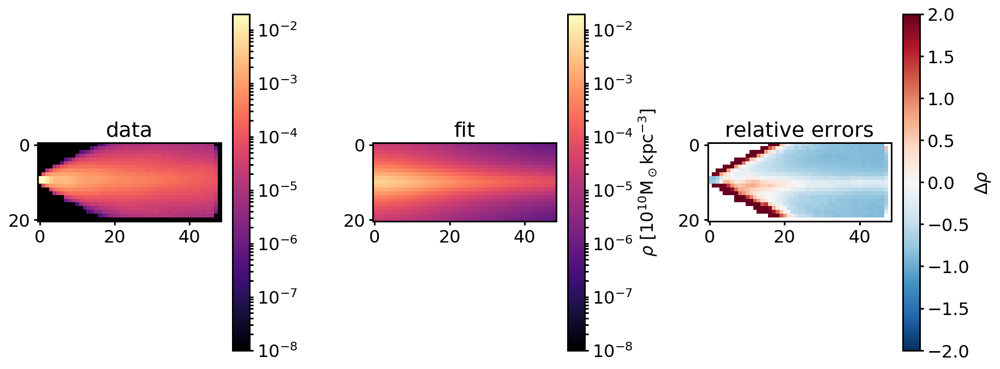

(21, 49)
a and b: 0.5586881122672089, 1.5069984229244409
Rho mean galpy: 0.0011561839672587614
Rho mean data: 0.00033879189738258395
111.590406298 117.1251829752916
Circular velocity ar R=8kpc: 111.59040629833916 km/s and its error compared to the data: -0.047255223311967284 km/s
Multiply rho error with 0.002233056130263896
Error: 312254262552488.7
Error multiplied by vcirc error: 697281295193.8671
data max: 0.019812705986395618, fit max: 0.07661150033800952, chosen max: 0.07661150033800952


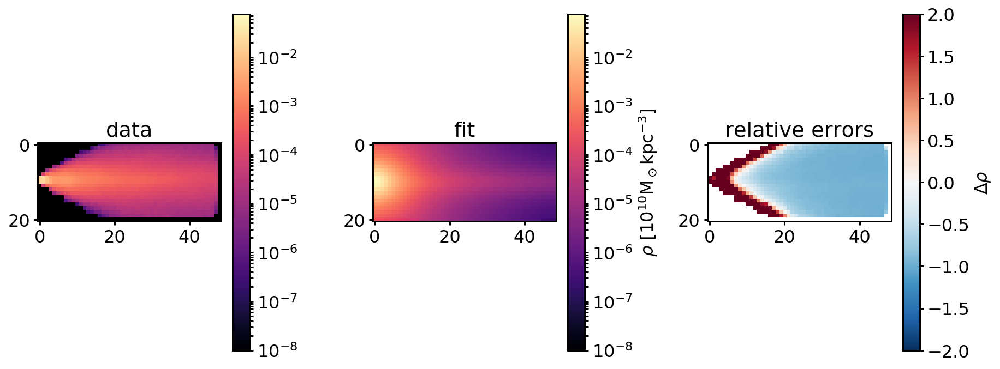

(21, 49)
a and b: 0.4200024839455603, 1.489684922762272
Rho mean galpy: 0.0012789521926270062
Rho mean data: 0.00033879189738258395
112.356786498 117.1251829752916
Circular velocity ar R=8kpc: 112.35678649752434 km/s and its error compared to the data: -0.04071196609164045 km/s
Multiply rho error with 0.0016574641830468817
Error: 417050353186182.5
Error multiplied by vcirc error: 691246022933.1494
data max: 0.019812705986395618, fit max: 0.0941771655728906, chosen max: 0.0941771655728906


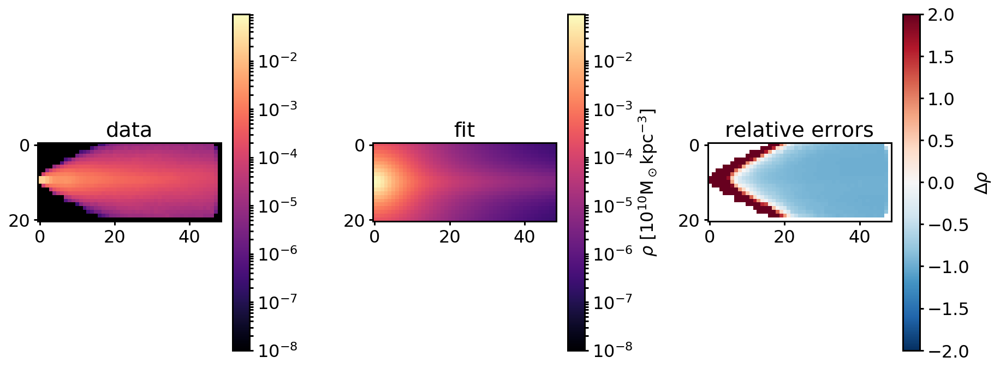

(21, 49)
a and b: 0.35412202850475794, 1.3164371155890842
Rho mean galpy: 0.0014833983782856436
Rho mean data: 0.00033879189738258395
113.435224686 117.1251829752916
Circular velocity ar R=8kpc: 113.43522468568455 km/s and its error compared to the data: -0.03150439722587645 km/s
Multiply rho error with 0.000992527044565812
Error: 717879478117627.0
Error multiplied by vcirc error: 712514796770.5358
data max: 0.019812705986395618, fit max: 0.13944558799078427, chosen max: 0.13944558799078427


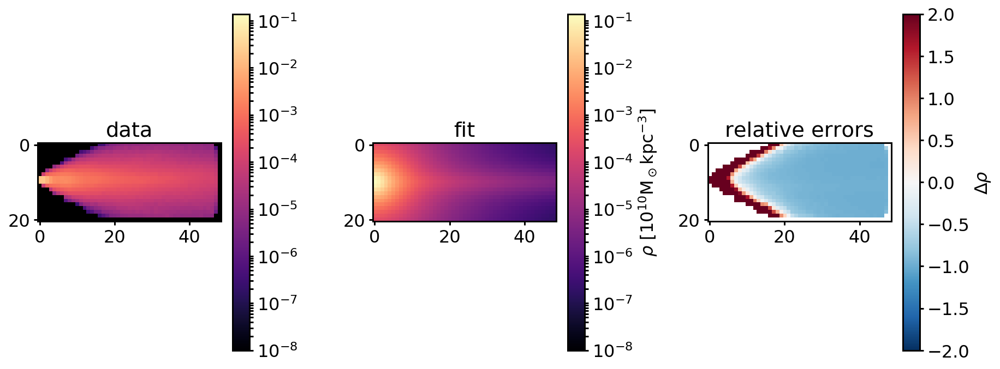

(21, 49)
a and b: 0.3764774620742788, 1.2093232160445424
Rho mean galpy: 0.0015577180608361792
Rho mean data: 0.00033879189738258395
113.788067833 117.1251829752916
Circular velocity ar R=8kpc: 113.78806783341693 km/s and its error compared to the data: -0.028491867052866424 km/s
Multiply rho error with 0.0008117864881582152
Error: 904232942455841.9
Error multiplied by vcirc error: 734044084833.1974
data max: 0.019812705986395618, fit max: 0.16477481951818024, chosen max: 0.16477481951818024


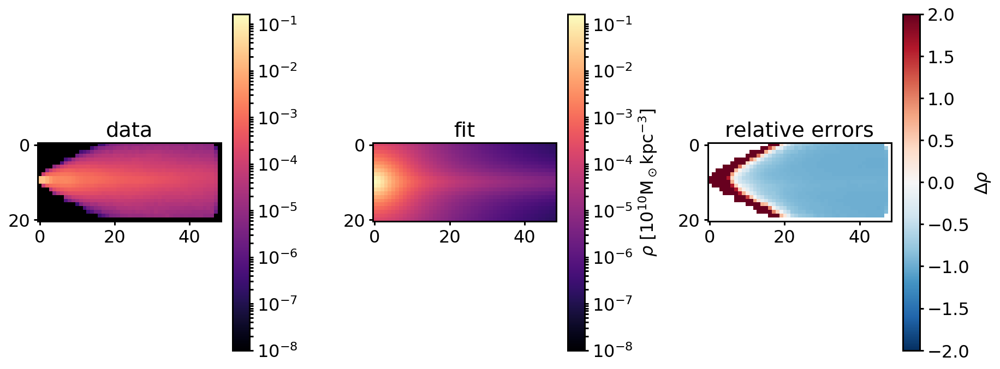

(21, 49)
a and b: 0.536852787306298, 1.8279223552143615
Rho mean galpy: 0.0010099472716584813
Rho mean data: 0.00033879189738258395
109.992992742 117.1251829752916
Circular velocity ar R=8kpc: 109.9929927420796 km/s and its error compared to the data: -0.060893738238313684 km/s
Multiply rho error with 0.003708047356636266
Error: 202913984661874.12
Error multiplied by vcirc error: 752414664449.9941
data max: 0.019812705986395618, fit max: 0.05005216187411771, chosen max: 0.05005216187411771


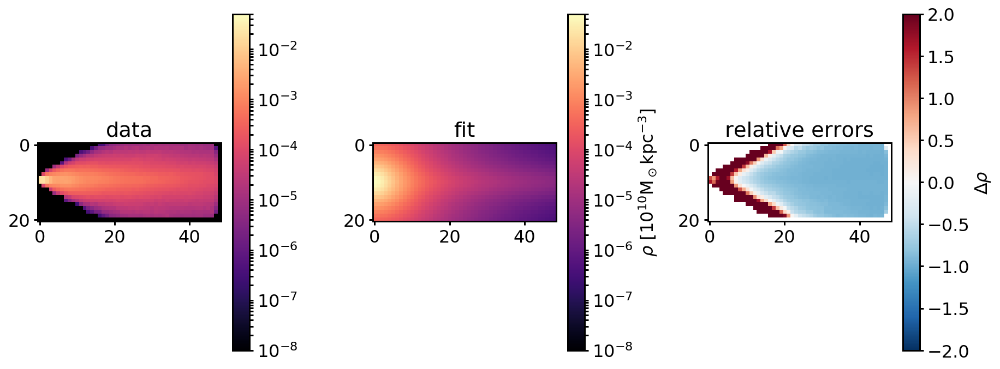

(21, 49)
a and b: 0.1787617203675511, 1.4888553015581334
Rho mean galpy: 0.0015326027590941637
Rho mean data: 0.00033879189738258395
113.447736451 117.1251829752916
Circular velocity ar R=8kpc: 113.44773645128646 km/s and its error compared to the data: -0.03139757335346847 km/s
Multiply rho error with 0.000985807612486433
Error: 822389060708348.8
Error multiplied by vcirc error: 810717396471.8575
data max: 0.019812705986395618, fit max: 0.13373756477982304, chosen max: 0.13373756477982304


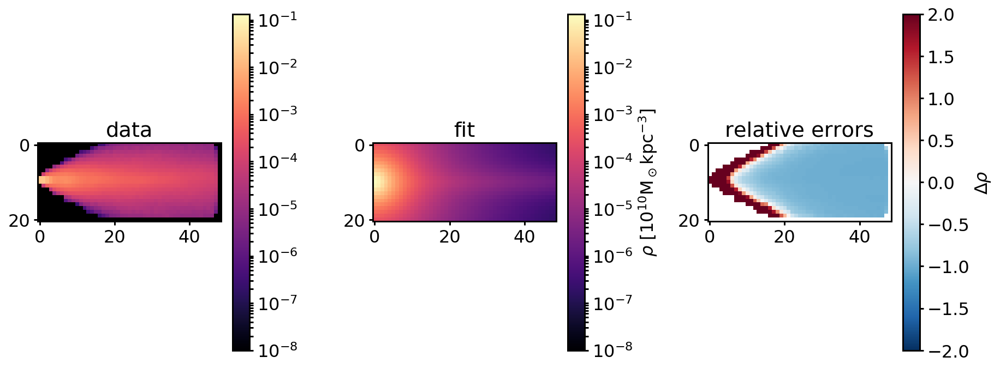

(21, 49)
a and b: 0.5826026216268945, 2.0487008102521846
Rho mean galpy: 0.000898687484052018
Rho mean data: 0.00033879189738258395
108.440487058 117.1251829752916
Circular velocity ar R=8kpc: 108.44048705846124 km/s and its error compared to the data: -0.07414883542732607 km/s
Multiply rho error with 0.005498049795228686
Error: 156103697073668.12
Error multiplied by vcirc error: 858265899730.3219
data max: 0.019812705986395618, fit max: 0.03630037586441977, chosen max: 0.03630037586441977


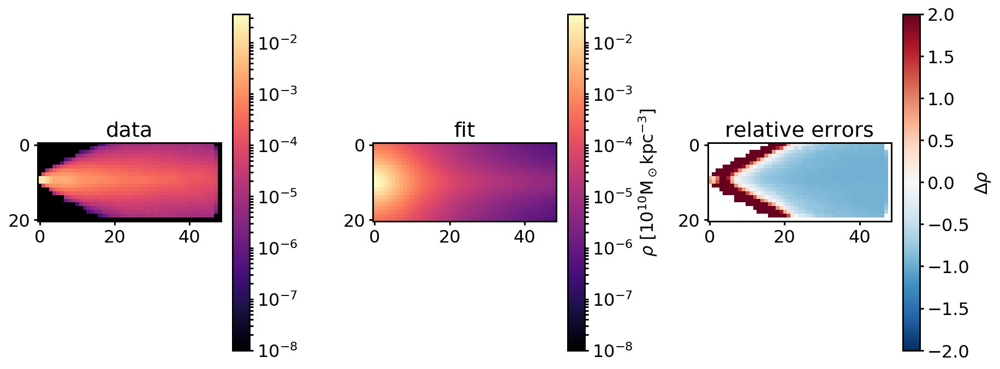

(21, 49)
a and b: 0.5482996680797392, 1.6001773810642828
Rho mean galpy: 0.0011128183959826998
Rho mean data: 0.00033879189738258395
111.164580942 117.1251829752916
Circular velocity ar R=8kpc: 111.16458094174482 km/s and its error compared to the data: -0.050890866354541445 km/s
Multiply rho error with 0.0025898802783157985
Error: 271212740907677.4
Error multiplied by vcirc error: 702408528904.7661
data max: 0.019812705986395618, fit max: 0.06759063116736178, chosen max: 0.06759063116736178


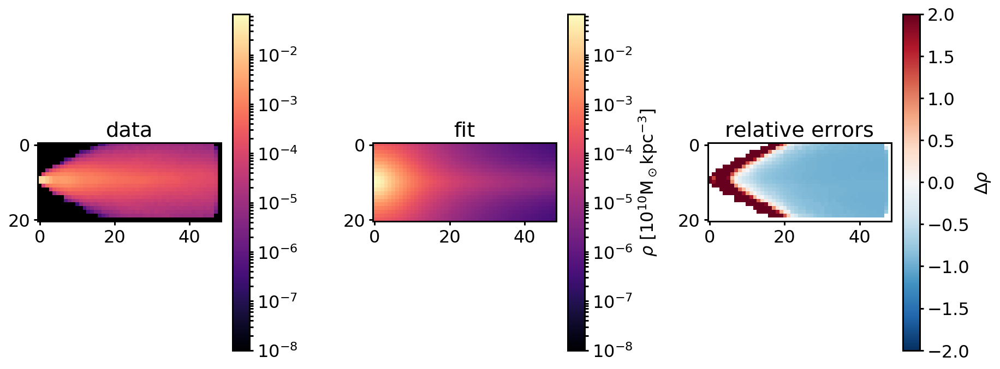

(21, 49)
a and b: 0.6978924827554032, 1.7821569794861807
Rho mean galpy: 0.0009436227466811094
Rho mean data: 0.00033879189738258395
109.335579192 117.1251829752916
Circular velocity ar R=8kpc: 109.33557919242496 km/s and its error compared to the data: -0.06650665198542237 km/s
Multiply rho error with 0.004423134758310085
Error: 176394299273048.16
Error multiplied by vcirc error: 780215756282.3707
data max: 0.019812705986395618, fit max: 0.0447286780307876, chosen max: 0.0447286780307876


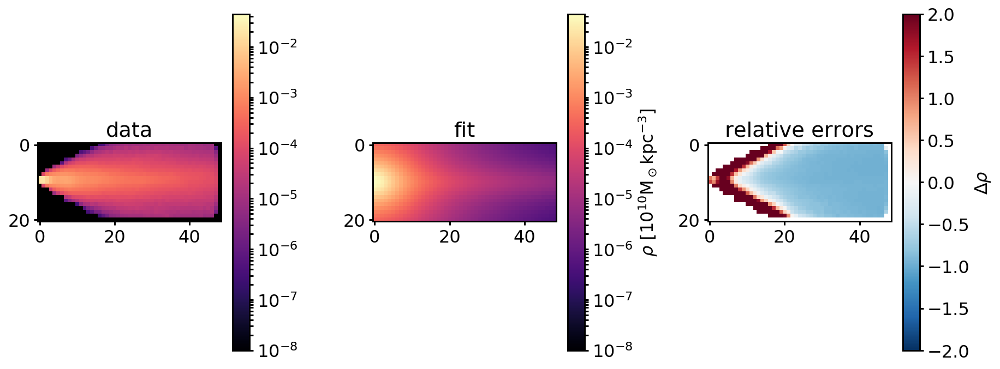

(21, 49)
a and b: 0.43354574323990036, 1.4908632699887814
Rho mean galpy: 0.001266248916835108
Rho mean data: 0.00033879189738258395
112.286525563 117.1251829752916
Circular velocity ar R=8kpc: 112.28652556292998 km/s and its error compared to the data: -0.04131184506565392 km/s
Multiply rho error with 0.001706668542728594
Error: 404522934776383.0
Error multiplied by vcirc error: 690386567595.1036
data max: 0.019812705986395618, fit max: 0.09230461111664653, chosen max: 0.09230461111664653


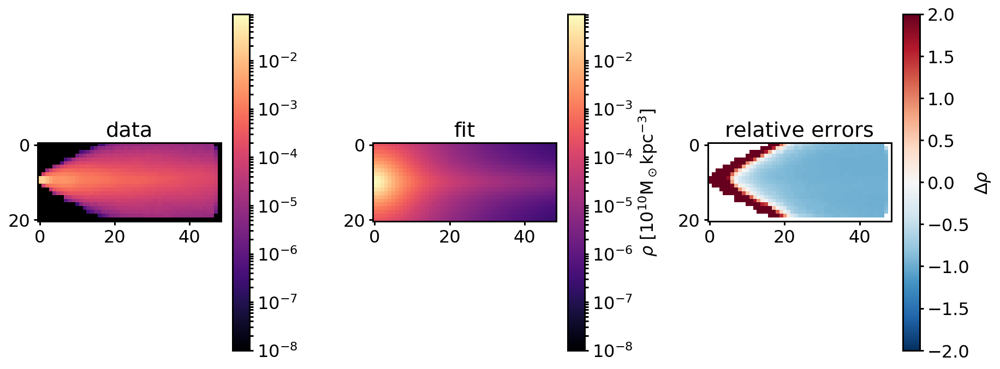

differential_evolution step 7: f(x)= 6.90387e+11
(21, 49)
a and b: 0.4542668255496123, 1.4908632699887814
Rho mean galpy: 0.001248441322722225
Rho mean data: 0.00033879189738258395
112.186893153 117.1251829752916
Circular velocity ar R=8kpc: 112.18689315257504 km/s and its error compared to the data: -0.04216249398524589 km/s
Multiply rho error with 0.0017776758990558955
Error: 388000342430291.75
Error multiplied by vcirc error: 689738857563.7642
data max: 0.019812705986395618, fit max: 0.0897954517436194, chosen max: 0.0897954517436194


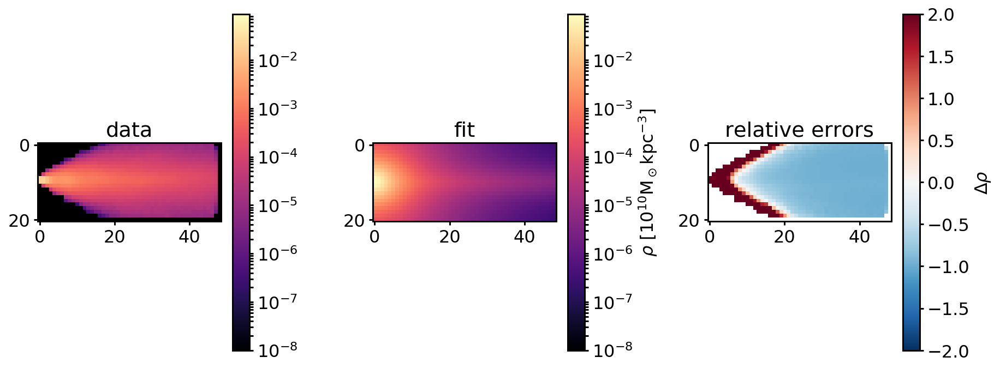

(21, 49)
a and b: 0.7075606584984158, 1.4434187900364293
Rho mean galpy: 0.0010862547005567017
Rho mean data: 0.00033879189738258395
111.15150981 117.1251829752916
Circular velocity ar R=8kpc: 111.15150980978488 km/s and its error compared to the data: -0.05100246602617389 km/s
Multiply rho error with 0.0026012515407510223
Error: 281581843924488.25
Error multiplied by vcirc error: 732465205356.089
data max: 0.019812705986395618, fit max: 0.07034408968360692, chosen max: 0.07034408968360692


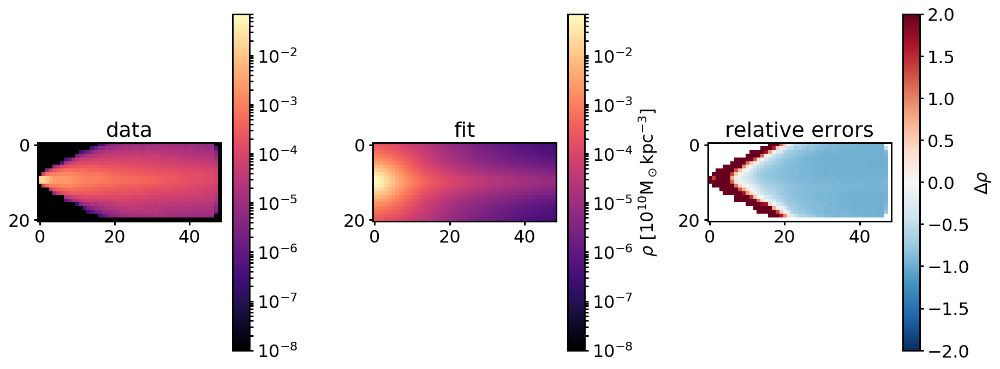

(21, 49)
a and b: 0.3193547675355024, 1.5639757199137652
Rho mean galpy: 0.0013178439270467874
Rho mean data: 0.00033879189738258395
112.48148297 117.1251829752916
Circular velocity ar R=8kpc: 112.48148296968509 km/s and its error compared to the data: -0.03964732338207853 km/s
Multiply rho error with 0.0015719102513631106
Error: 455380684427344.56
Error multiplied by vcirc error: 715817566124.0925
data max: 0.019812705986395618, fit max: 0.0958034518781504, chosen max: 0.0958034518781504


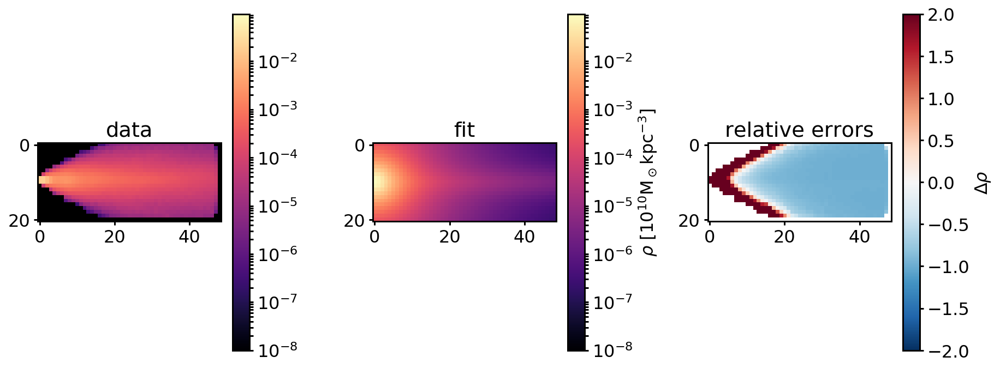

(21, 49)
a and b: 0.6905874454972851, 1.4262306128471962
Rho mean galpy: 0.001106259823965806
Rho mean data: 0.00033879189738258395
111.328941384 117.1251829752916
Circular velocity ar R=8kpc: 111.32894138370838 km/s and its error compared to the data: -0.04948757768690931 km/s
Multiply rho error with 0.002449020345317884
Error: 297548777006884.0
Error multiplied by vcirc error: 728703008614.3132
data max: 0.019812705986395618, fit max: 0.07364833360274922, chosen max: 0.07364833360274922


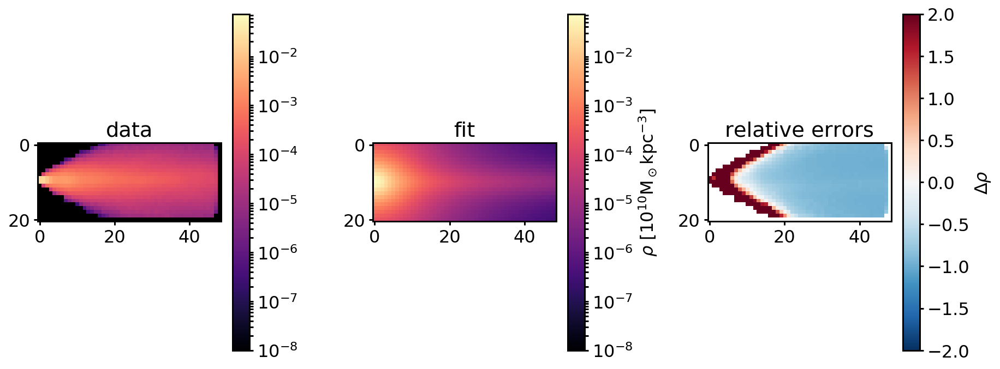

(21, 49)
a and b: 0.45988371620323587, 1.016283645508143
Rho mean galpy: 0.0016439559573330023
Rho mean data: 0.00033879189738258395
114.220686898 117.1251829752916
Circular velocity ar R=8kpc: 114.22068689835105 km/s and its error compared to the data: -0.024798220187654017 km/s
Multiply rho error with 0.0006149517244753712
Error: 1371132027495810.2
Error multiplied by vcirc error: 843180004791.9606
data max: 0.019812705986395618, fit max: 0.2123313518220855, chosen max: 0.2123313518220855


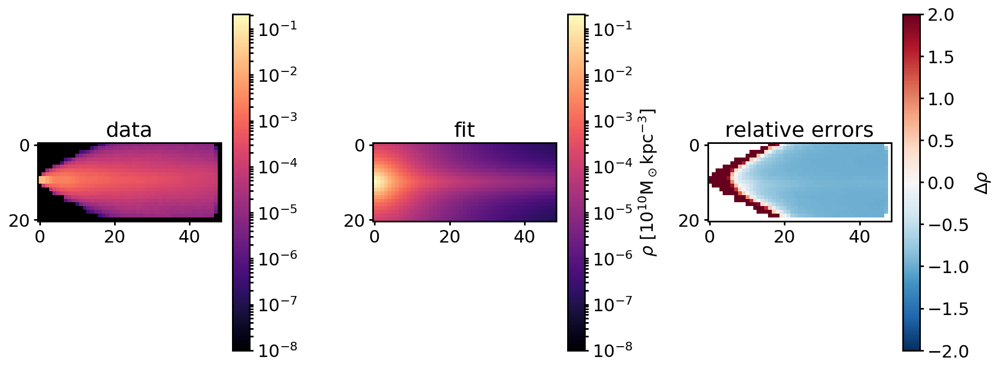

(21, 49)
a and b: 0.3785165926204117, 1.5442489586027464
Rho mean galpy: 0.0012781562094799131
Rho mean data: 0.00033879189738258395
112.294390872 117.1251829752916
Circular velocity ar R=8kpc: 112.29439087211404 km/s and its error compared to the data: -0.04124469205052724 km/s
Multiply rho error with 0.001701124622342825
Error: 410646347611759.7
Error multiplied by vcirc error: 698560612997.5151
data max: 0.019812705986395618, fit max: 0.09124661410074578, chosen max: 0.09124661410074578


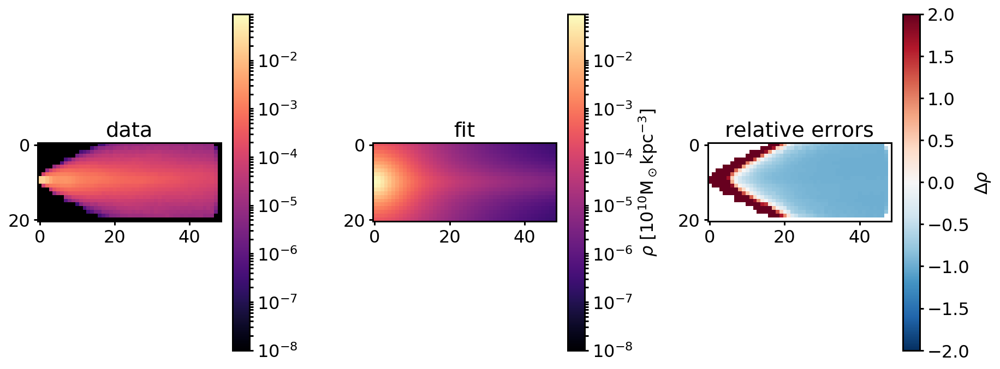

(21, 49)
a and b: 0.27219906096213364, 1.441788706001025
Rho mean galpy: 0.0014654624490764135
Rho mean data: 0.00033879189738258395
113.248357107 117.1251829752916
Circular velocity ar R=8kpc: 113.24835710727221 km/s and its error compared to the data: -0.03309984897814183 km/s
Multiply rho error with 0.001095600002375797
Error: 667359036633281.0
Error multiplied by vcirc error: 731158562120.9323
data max: 0.019812705986395618, fit max: 0.12605114003726425, chosen max: 0.12605114003726425


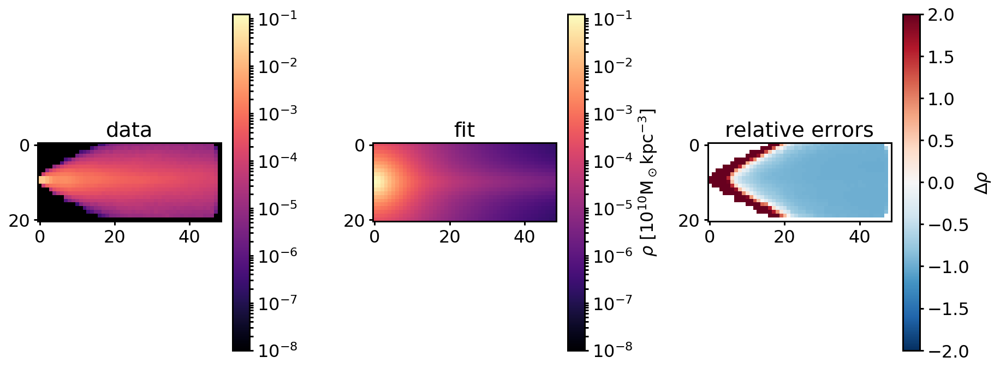

(21, 49)
a and b: 0.34834557516687337, 1.1463222893077383
Rho mean galpy: 0.0016639359061484849
Rho mean data: 0.00033879189738258395
114.149593055 117.1251829752916
Circular velocity ar R=8kpc: 114.14959305480389 km/s and its error compared to the data: -0.025405210432972634 km/s
Multiply rho error with 0.0006454247171436216
Error: 1173994796136211.5
Error multiplied by vcirc error: 757725259224.2981
data max: 0.019812705986395618, fit max: 0.19578061429345922, chosen max: 0.19578061429345922


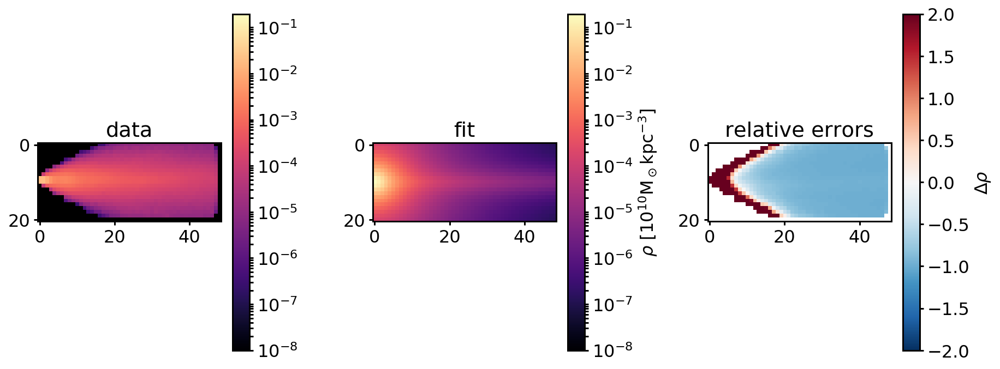

(21, 49)
a and b: 0.7825896267996857, 1.4498017718542782
Rho mean galpy: 0.001036054368643307
Rho mean data: 0.00033879189738258395
110.719982114 117.1251829752916
Circular velocity ar R=8kpc: 110.7199821135273 km/s and its error compared to the data: -0.05468679492364612 km/s
Multiply rho error with 0.0029906455390209274
Error: 253248450513287.06
Error multiplied by vcirc error: 757376348791.524
data max: 0.019812705986395618, fit max: 0.0638791571799496, chosen max: 0.0638791571799496


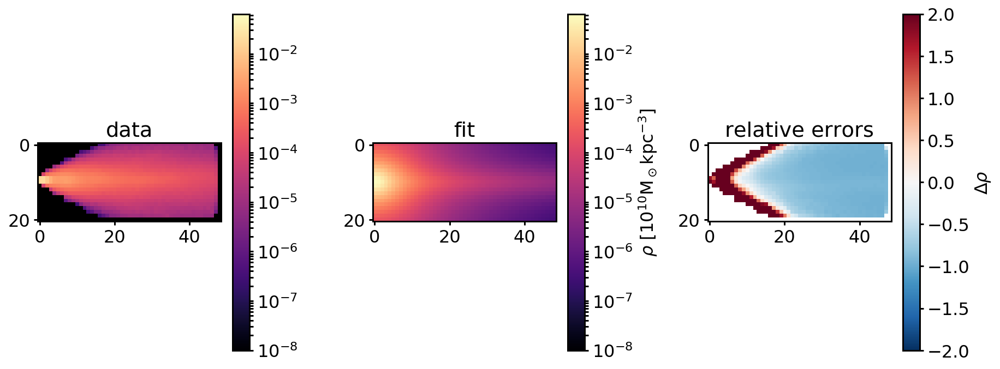

(21, 49)
a and b: 0.6122517344863212, 1.5512739860183153
Rho mean galpy: 0.0010951150085453081
Rho mean data: 0.00033879189738258395
111.085800108 117.1251829752916
Circular velocity ar R=8kpc: 111.08580010763986 km/s and its error compared to the data: -0.051563487153106866 km/s
Multiply rho error with 0.0026587932073886167
Error: 266611571618862.47
Error multiplied by vcirc error: 708865035631.4352
data max: 0.019812705986395618, fit max: 0.0672366347655624, chosen max: 0.0672366347655624


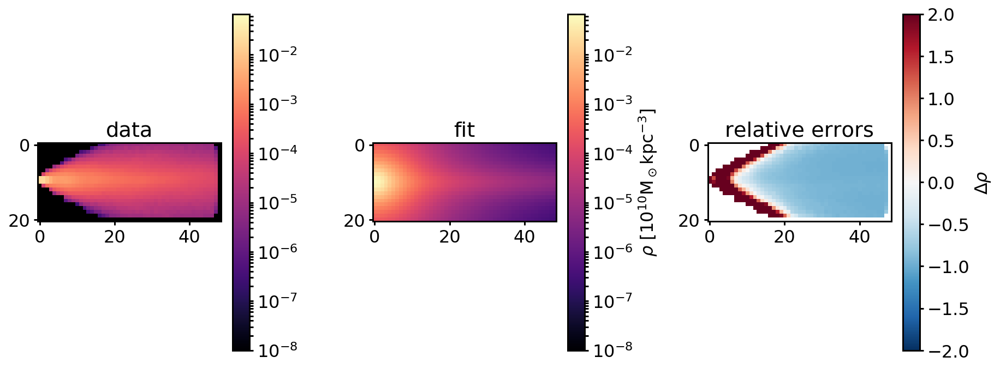

(21, 49)
a and b: 0.37156450651899586, 1.537865976784898
Rho mean galpy: 0.0012887691874652627
Rho mean data: 0.00033879189738258395
112.358008817 117.1251829752916
Circular velocity ar R=8kpc: 112.35800881741488 km/s and its error compared to the data: -0.04070153007899573 km/s
Multiply rho error with 0.0016566145507713945
Error: 422229411020917.4
Error multiplied by vcirc error: 699471386060.8875
data max: 0.019812705986395618, fit max: 0.0930500253408978, chosen max: 0.0930500253408978


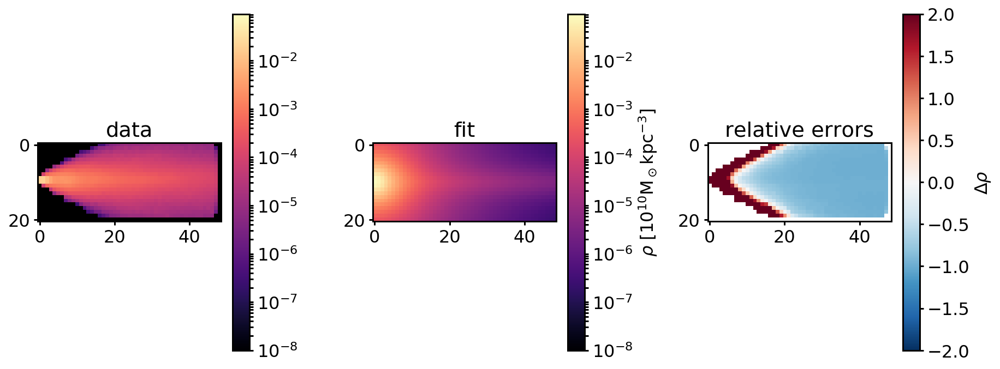

(21, 49)
a and b: 0.5897856210051655, 1.1885482313976796
Rho mean galpy: 0.001333791403889258
Rho mean data: 0.00033879189738258395
112.96405196 117.1251829752916
Circular velocity ar R=8kpc: 112.9640519602617 km/s and its error compared to the data: -0.03552721036865074 km/s
Multiply rho error with 0.0012621826765783644
Error: 607923301738960.6
Error multiplied by vcirc error: 767310260143.238
data max: 0.019812705986395618, fit max: 0.12399126941868341, chosen max: 0.12399126941868341


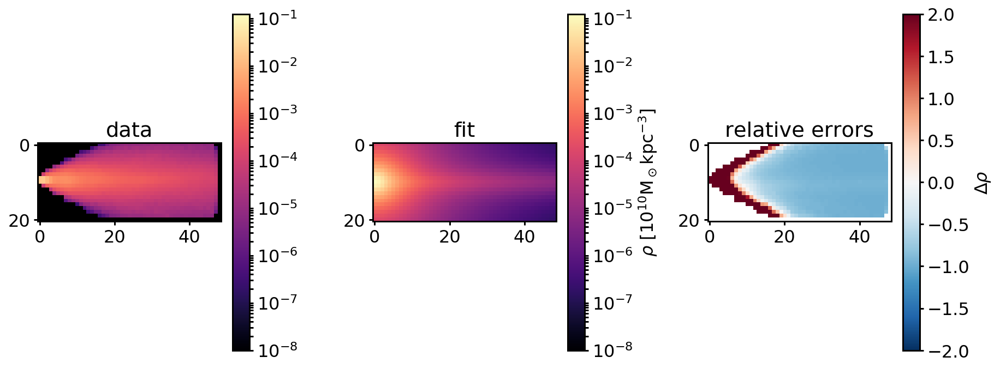

(21, 49)
a and b: 0.2717850535508797, 1.3692140625559224
Rho mean galpy: 0.0015338169569858884
Rho mean data: 0.00033879189738258395
113.560074339 117.1251829752916
Circular velocity ar R=8kpc: 113.56007433912845 km/s and its error compared to the data: -0.030438446673891055 km/s
Multiply rho error with 0.0009264990359193094
Error: 791717399735868.5
Error multiplied by vcirc error: 733525407575.8247
data max: 0.019812705986395618, fit max: 0.14381041335768138, chosen max: 0.14381041335768138


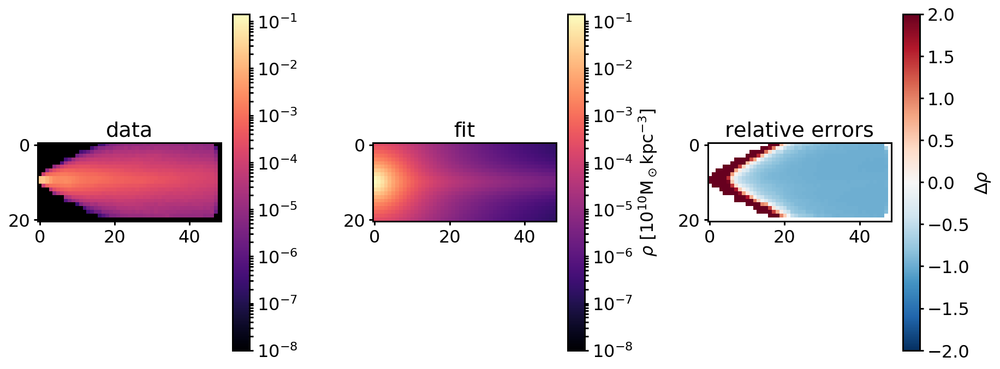

(21, 49)
a and b: 0.2986909972742575, 1.560598175036561
Rho mean galpy: 0.0013399298044259032
Rho mean data: 0.00033879189738258395
112.593989335 117.1251829752916
Circular velocity ar R=8kpc: 112.59398933523626 km/s and its error compared to the data: -0.03868675826112667 km/s
Multiply rho error with 0.0014966652647548527
Error: 483619489270485.56
Error multiplied by vcirc error: 723816490949.6179
data max: 0.019812705986395618, fit max: 0.09912522052853757, chosen max: 0.09912522052853757


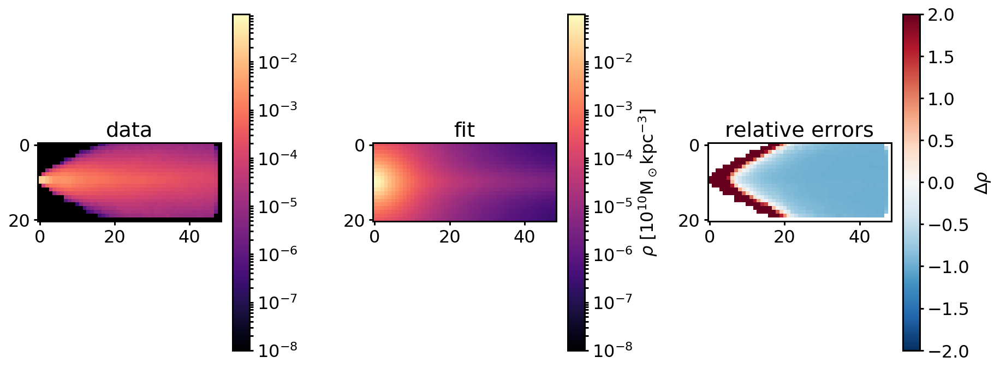

(21, 49)
a and b: 0.4116295034018105, 1.216219584740716
Rho mean galpy: 0.0015065351807220851
Rho mean data: 0.00033879189738258395
113.614999824 117.1251829752916
Circular velocity ar R=8kpc: 113.61499982449295 km/s and its error compared to the data: -0.02996949982600358 km/s
Multiply rho error with 0.0008981709198208287
Error: 813625874330343.5
Error multiplied by vcirc error: 730775099937.3105
data max: 0.019812705986395618, fit max: 0.1537711040330281, chosen max: 0.1537711040330281


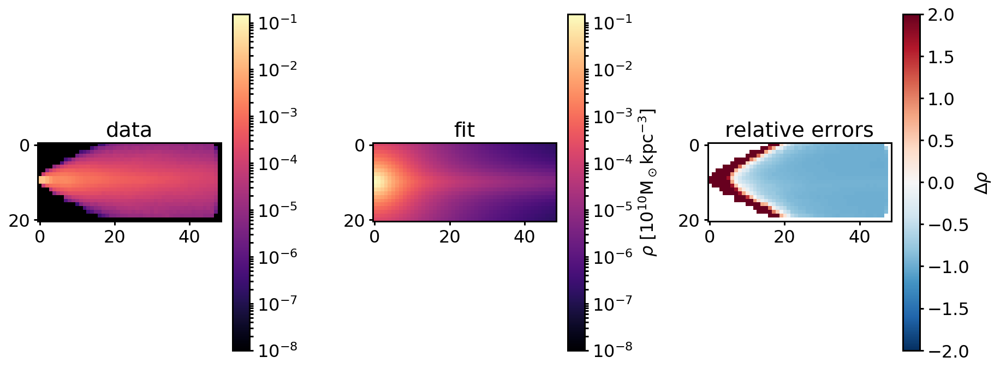

(21, 49)
a and b: 0.6075490060440121, 1.438875533246643
Rho mean galpy: 0.0011584502678128428
Rho mean data: 0.00033879189738258395
111.687610311 117.1251829752916
Circular velocity ar R=8kpc: 111.68761031086267 km/s and its error compared to the data: -0.04642530774595266 km/s
Multiply rho error with 0.002155309199306412
Error: 328135692827850.9
Error multiplied by vcirc error: 707233877372.65
data max: 0.019812705986395618, fit max: 0.0799851861961143, chosen max: 0.0799851861961143


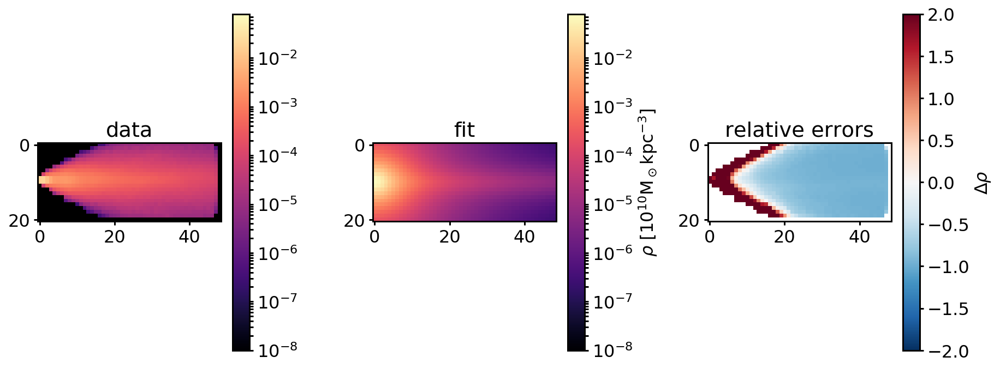

(21, 49)
a and b: 0.77916922202931, 1.310742756321934
Rho mean galpy: 0.001104542935863605
Rho mean data: 0.00033879189738258395
111.467146277 117.1251829752916
Circular velocity ar R=8kpc: 111.46714627654515 km/s and its error compared to the data: -0.04830760178995876 km/s
Multiply rho error with 0.0023336243906972266
Error: 333968514800192.1
Error multiplied by vcirc error: 779357071862.656
data max: 0.019812705986395618, fit max: 0.0789367296030713, chosen max: 0.0789367296030713


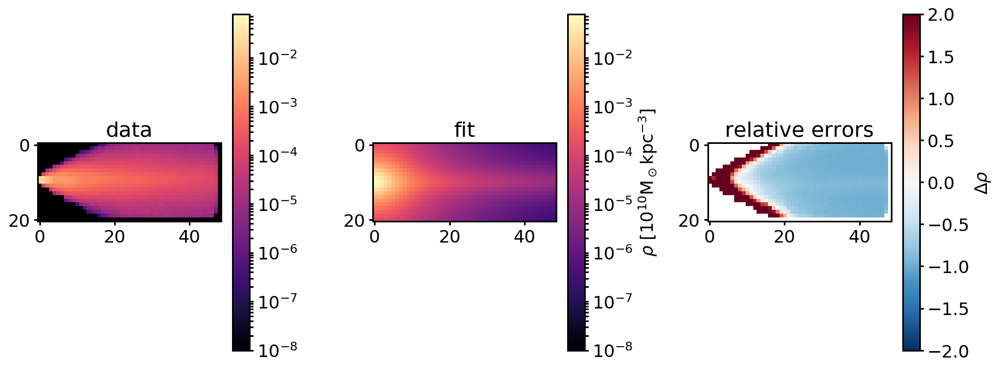

(21, 49)
a and b: 9.551271247335833, 1.3450822594725447
Rho mean galpy: 0.0001461154083886681
Rho mean data: 0.00033879189738258395
53.3245188804 117.1251829752916
Circular velocity ar R=8kpc: 53.3245188803681 km/s and its error compared to the data: -0.5447220014877817 km/s
Multiply rho error with 0.29672205890485487
Error: 84985121163643.47
Error multiplied by vcirc error: 25216960127954.844
data max: 0.019812705986395618, fit max: 0.0015848077564414036, chosen max: 0.019812705986395618


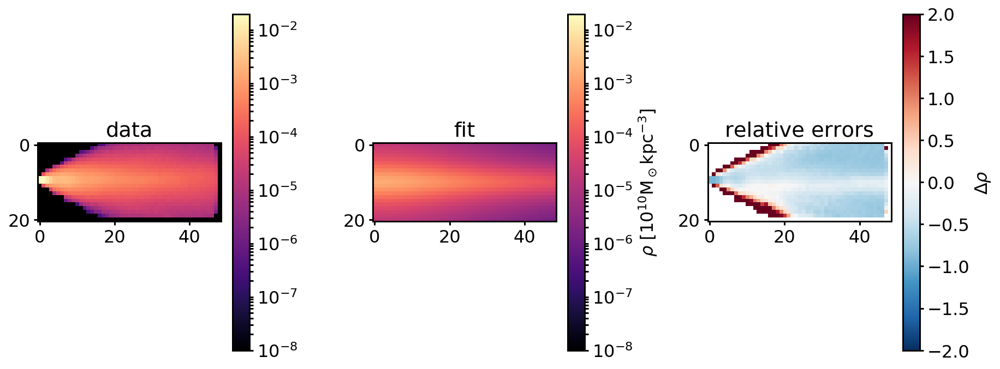

(21, 49)
a and b: 0.6833540967955223, 1.6783091336737164
Rho mean galpy: 0.0009932739184101986
Rho mean data: 0.00033879189738258395
110.010431181 117.1251829752916
Circular velocity ar R=8kpc: 110.01043118054419 km/s and its error compared to the data: -0.0607448510560561 km/s
Multiply rho error with 0.00368993692982244
Error: 202239672326342.03
Error multiplied by vcirc error: 746251635592.1588
data max: 0.019812705986395618, fit max: 0.05198687702453181, chosen max: 0.05198687702453181


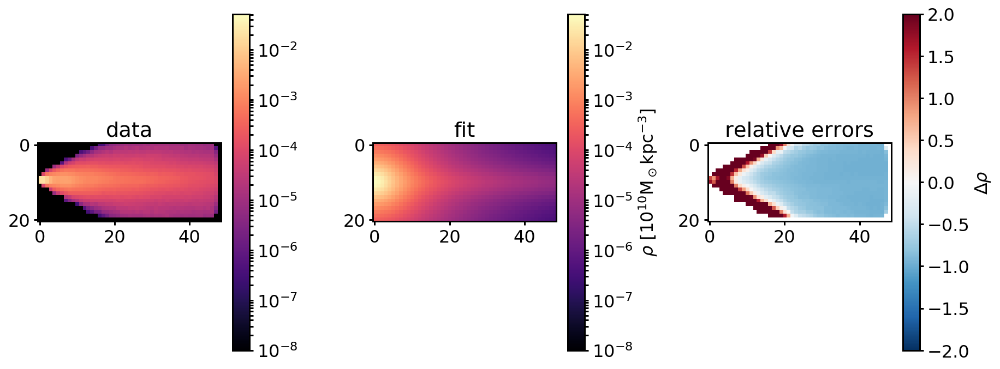

(21, 49)
a and b: 0.3952335192790084, 1.3356216161001684
Rho mean galpy: 0.0014200050534336724
Rho mean data: 0.00033879189738258395
113.174683988 117.1251829752916
Circular velocity ar R=8kpc: 113.17468398762966 km/s and its error compared to the data: -0.03372886075657459 km/s
Multiply rho error with 0.0011376360479363973
Error: 618837263317603.2
Error multiplied by vcirc error: 704011578556.4138
data max: 0.019812705986395618, fit max: 0.12659376848179846, chosen max: 0.12659376848179846


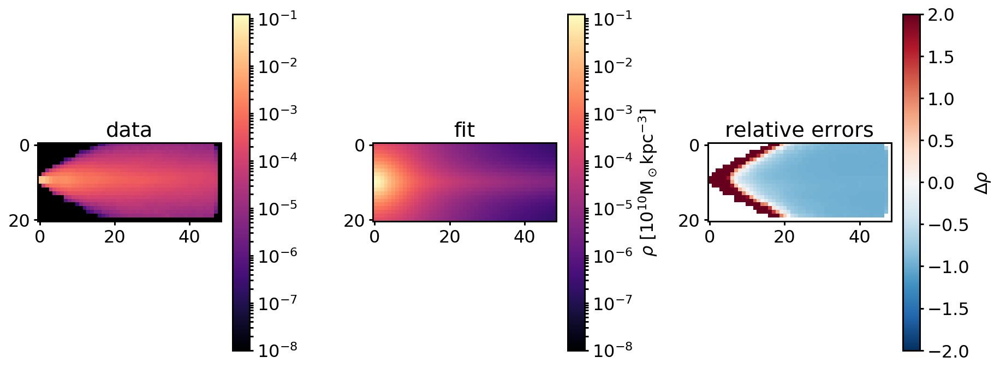

(21, 49)
a and b: 0.4651957967868441, 1.4012650143464025
Rho mean galpy: 0.0012996273609789746
Rho mean data: 0.00033879189738258395
112.560552023 117.1251829752916
Circular velocity ar R=8kpc: 112.56055202349287 km/s and its error compared to the data: -0.03897224180014012 km/s
Multiply rho error with 0.0015188356309285887
Error: 456630814499638.25
Error multiplied by vcirc error: 693547151241.9934
data max: 0.019812705986395618, fit max: 0.10234489549373367, chosen max: 0.10234489549373367


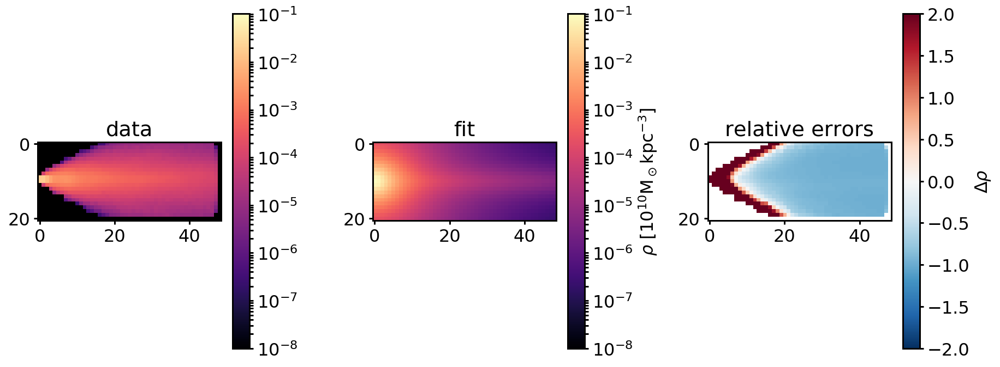

(21, 49)
a and b: 0.551776406795633, 1.8095949762175163
Rho mean galpy: 0.0010096563041437849
Rho mean data: 0.00033879189738258395
110.012065779 117.1251829752916
Circular velocity ar R=8kpc: 110.01206577932717 km/s and its error compared to the data: -0.0607308950583666 km/s
Multiply rho error with 0.003688241614590337
Error: 203092775675055.0
Error multiplied by vcirc error: 749055226867.398
data max: 0.019812705986395618, fit max: 0.05043934535111767, chosen max: 0.05043934535111767


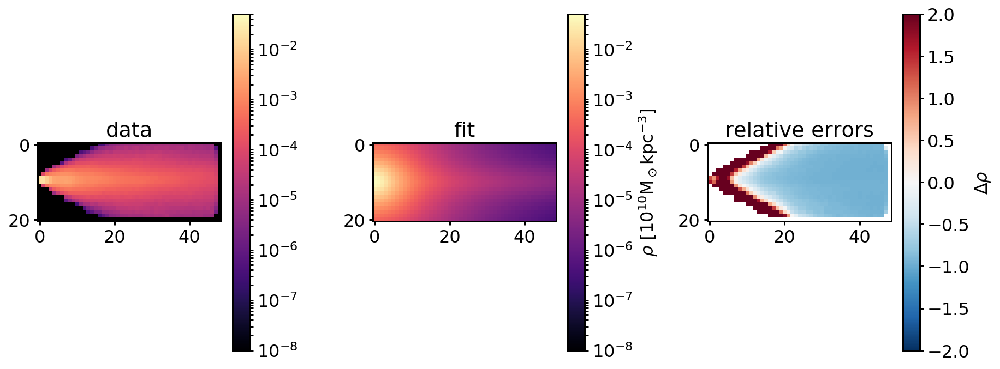

(21, 49)
a and b: 0.35412202850475794, 1.4919191481282117
Rho mean galpy: 0.0013382812226910366
Rho mean data: 0.00033879189738258395
112.65547919 117.1251829752916
Circular velocity ar R=8kpc: 112.65547919000387 km/s and its error compared to the data: -0.03816176565743881 km/s
Multiply rho error with 0.0014563203580932763
Error: 481620963894621.4
Error multiplied by vcirc error: 701394414604.2439
data max: 0.019812705986395618, fit max: 0.1027179737839655, chosen max: 0.1027179737839655


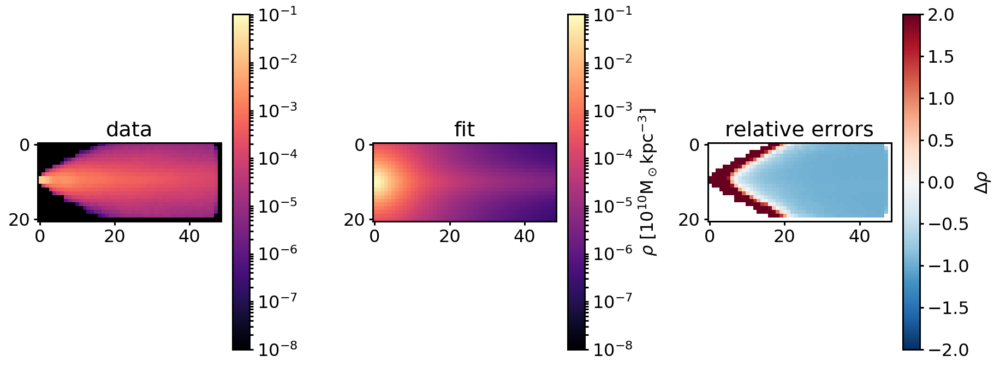

(21, 49)
a and b: 0.34392859547632604, 1.6480207833514973
Rho mean galpy: 0.0012382603714525954
Rho mean data: 0.00033879189738258395
111.9586246 117.1251829752916
Circular velocity ar R=8kpc: 111.95862459970142 km/s and its error compared to the data: -0.04411142202168507 km/s
Multiply rho error with 0.0019458175527752024
Error: 369036222865010.0
Error multiplied by vcirc error: 718077160060.5979
data max: 0.019812705986395618, fit max: 0.08122647519413108, chosen max: 0.08122647519413108


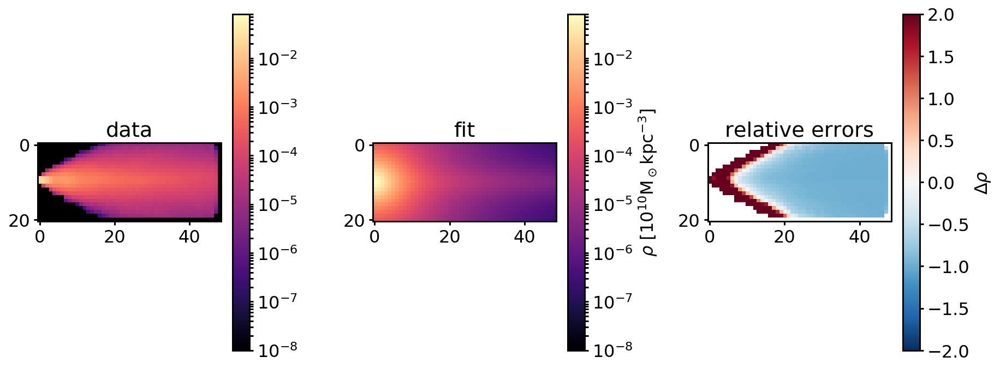

(21, 49)
a and b: 0.22568945995863388, 1.44508081707444
Rho mean galpy: 0.0015173696179316262
Rho mean data: 0.00033879189738258395
113.434326091 117.1251829752916
Circular velocity ar R=8kpc: 113.43432609060253 km/s and its error compared to the data: -0.031512069317045865 km/s
Multiply rho error with 0.0009930105126423035
Error: 766816367896478.5
Error multiplied by vcirc error: 761456714587.3914
data max: 0.019812705986395618, fit max: 0.13454443641691816, chosen max: 0.13454443641691816


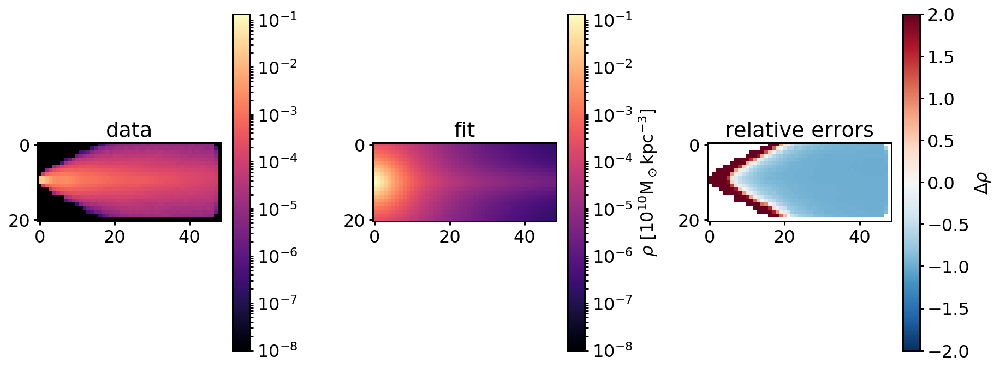

(21, 49)
a and b: 0.45185774488825725, 1.4439886121396304
Rho mean galpy: 0.001281986670517889
Rho mean data: 0.00033879189738258395
112.422445343 117.1251829752916
Circular velocity ar R=8kpc: 112.42244534295214 km/s and its error compared to the data: -0.040151379172927534 km/s
Multiply rho error with 0.001612133249488199
Error: 428377193306150.25
Error multiplied by vcirc error: 690601116651.2783
data max: 0.019812705986395618, fit max: 0.09714660576633949, chosen max: 0.09714660576633949


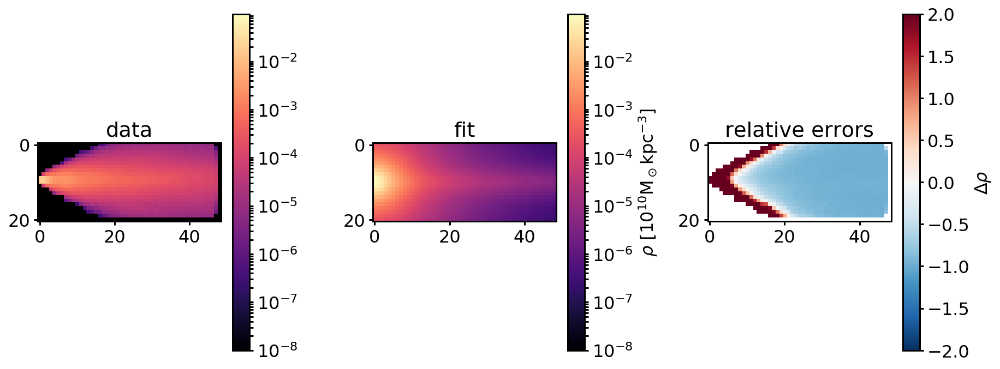

(21, 49)
a and b: 0.551499426283744, 1.5082866241032937
Rho mean galpy: 0.001160759248520729
Rho mean data: 0.00033879189738258395
111.620258327 117.1251829752916
Circular velocity ar R=8kpc: 111.62025832651413 km/s and its error compared to the data: -0.04700035047064784 km/s
Multiply rho error with 0.002209032944363727
Error: 315207318779797.06
Error multiplied by vcirc error: 696303351489.131
data max: 0.019812705986395618, fit max: 0.07714871448807617, chosen max: 0.07714871448807617


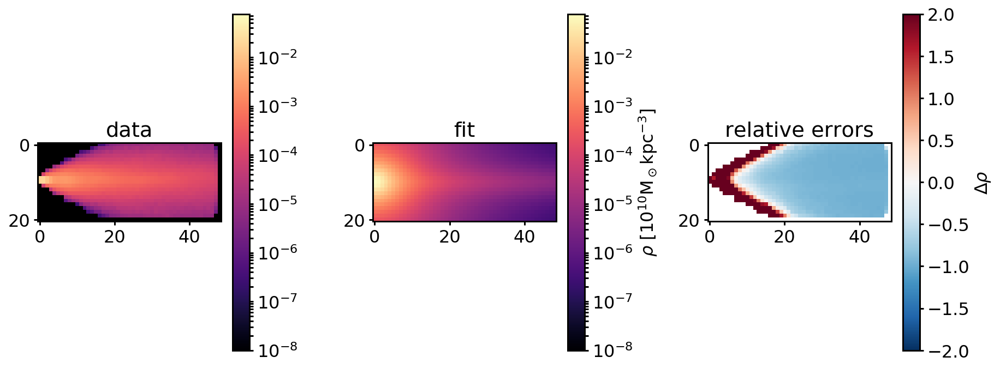

(21, 49)
a and b: 0.4360298294634326, 1.4931805469727149
Rho mean galpy: 0.0012625364114882175
Rho mean data: 0.00033879189738258395
112.263516004 117.1251829752916
Circular velocity ar R=8kpc: 112.2635160042713 km/s and its error compared to the data: -0.04150829776757661 km/s
Multiply rho error with 0.0017229387835618055
Error: 400645914542284.94
Error multiplied by vcirc error: 690288384640.4915
data max: 0.019812705986395618, fit max: 0.09165821731567132, chosen max: 0.09165821731567132


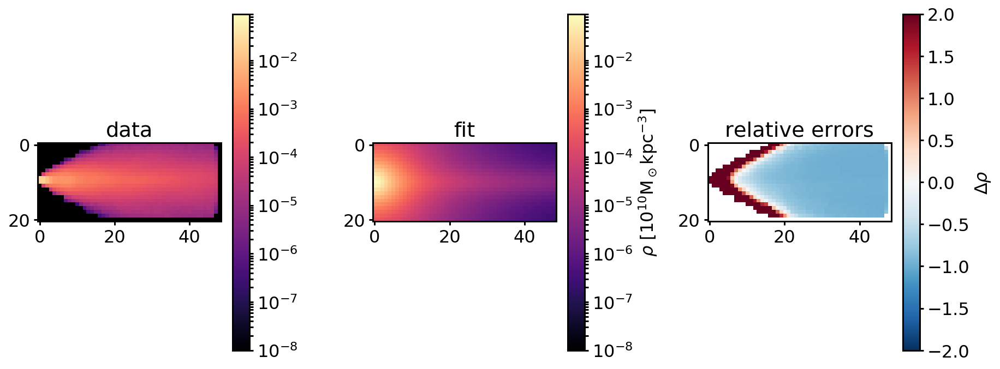

(21, 49)
a and b: 0.6549020695217269, 1.539937833976538
Rho mean galpy: 0.00107299330965564
Rho mean data: 0.00033879189738258395
110.920529918 117.1251829752916
Circular velocity ar R=8kpc: 110.92052991839036 km/s and its error compared to the data: -0.05297454312801503 km/s
Multiply rho error with 0.002806302219621924
Error: 255888813010467.5
Error multiplied by vcirc error: 718101343927.6945
data max: 0.019812705986395618, fit max: 0.06500529217649406, chosen max: 0.06500529217649406


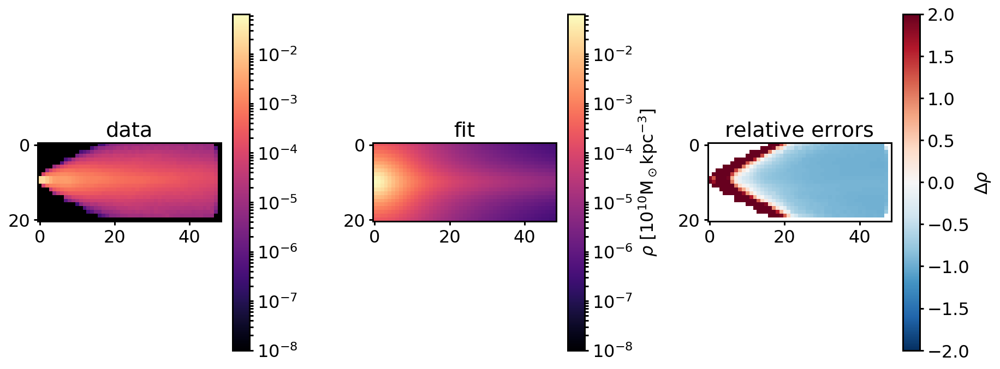

(21, 49)
a and b: 0.38497634643434253, 1.3111591439456136
Rho mean galpy: 0.0014523214770725673
Rho mean data: 0.00033879189738258395
113.325666361 117.1251829752916
Circular velocity ar R=8kpc: 113.3256663608546 km/s and its error compared to the data: -0.03243979234797466 km/s
Multiply rho error with 0.0010523401275797152
Error: 673739309025535.1
Error multiplied by vcirc error: 709002910415.4008
data max: 0.019812705986395618, fit max: 0.1343263268975032, chosen max: 0.1343263268975032


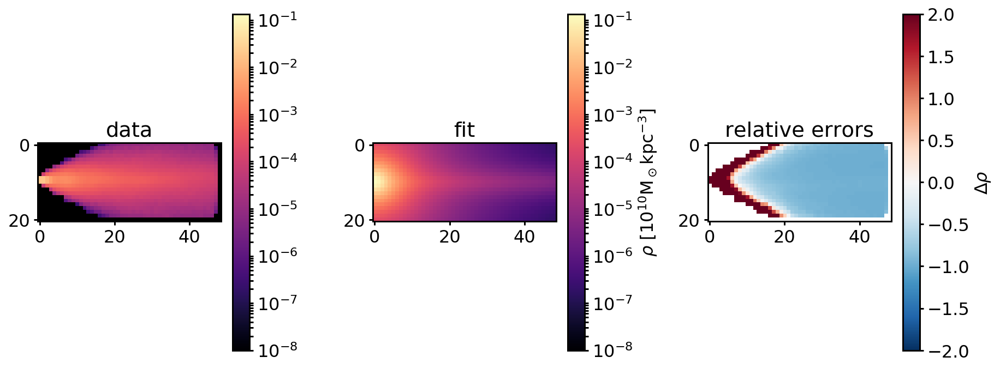

differential_evolution step 8: f(x)= 6.89739e+11
(21, 49)
a and b: 0.43095639285227527, 1.5396799226862135
Rho mean galpy: 0.001236300263293247
Rho mean data: 0.00033879189738258395
112.063075507 117.1251829752916
Circular velocity ar R=8kpc: 112.06307550690859 km/s and its error compared to the data: -0.04321963338534031 km/s
Multiply rho error with 0.0018679367099632225
Error: 370533222361379.9
Error multiplied by vcirc error: 692132608309.7871
data max: 0.019812705986395618, fit max: 0.0857356298303346, chosen max: 0.0857356298303346


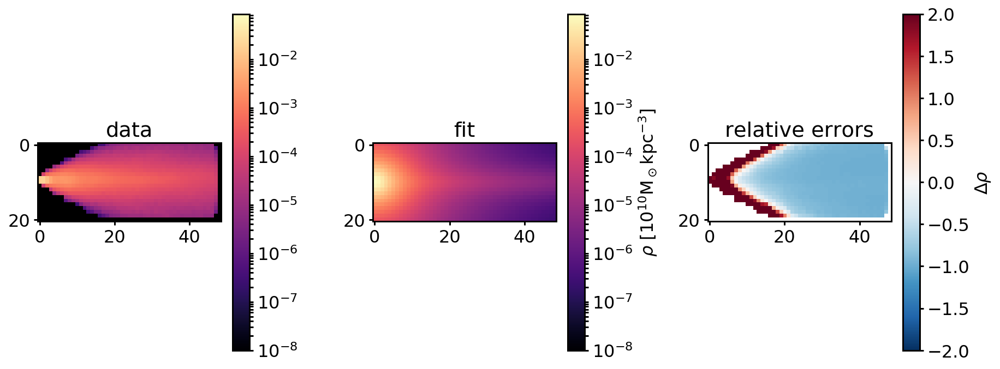

(21, 49)
a and b: 0.27631085689479473, 1.4473359644274129
Rho mean galpy: 0.001455849601016489
Rho mean data: 0.00033879189738258395
113.206242971 117.1251829752916
Circular velocity ar R=8kpc: 113.20624297073343 km/s and its error compared to the data: -0.03345941414994327 km/s
Multiply rho error with 0.0011195323952574241
Error: 651213063148641.6
Error multiplied by vcirc error: 729054120409.7229
data max: 0.019812705986395618, fit max: 0.12405438624661243, chosen max: 0.12405438624661243


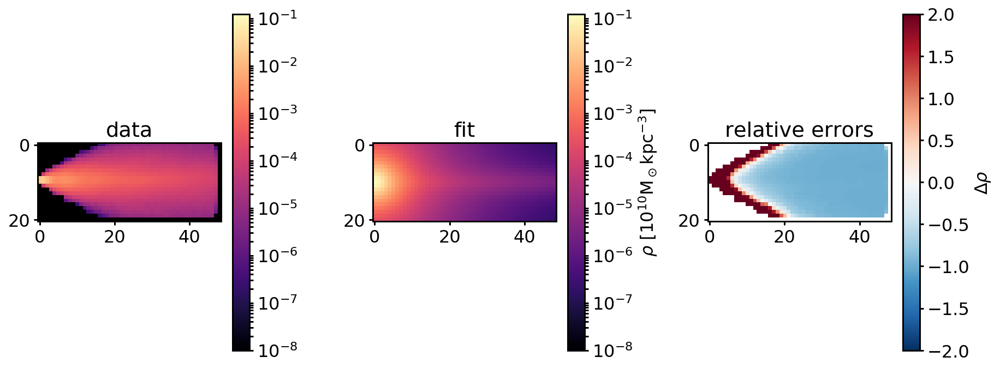

(21, 49)
a and b: 0.5418739660867633, 1.6463987270664497
Rho mean galpy: 0.0010931781318644527
Rho mean data: 0.00033879189738258395
110.955339433 117.1251829752916
Circular velocity ar R=8kpc: 110.95533943277998 km/s and its error compared to the data: -0.05267734389634369 km/s
Multiply rho error with 0.002774902559973658
Error: 255182323811670.0
Error multiplied by vcirc error: 708106083605.03
data max: 0.019812705986395618, fit max: 0.06373839701980859, chosen max: 0.06373839701980859


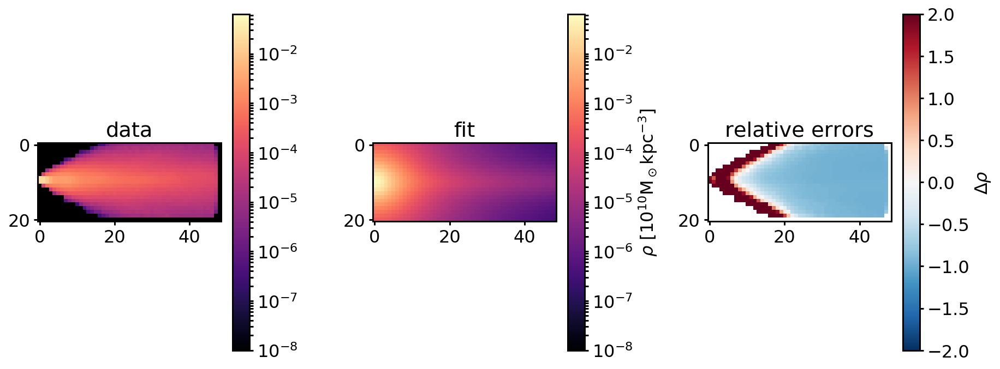

(21, 49)
a and b: 0.5039807096183564, 1.4292982245648604
Rho mean galpy: 0.001246395894769473
Rho mean data: 0.00033879189738258395
112.243982027 117.1251829752916
Circular velocity ar R=8kpc: 112.2439820270382 km/s and its error compared to the data: -0.04167507639482722 km/s
Multiply rho error with 0.0017368119925146848
Error: 399088239877419.94
Error multiplied by vcirc error: 693141241090.6802
data max: 0.019812705986395618, fit max: 0.09277311394167437, chosen max: 0.09277311394167437


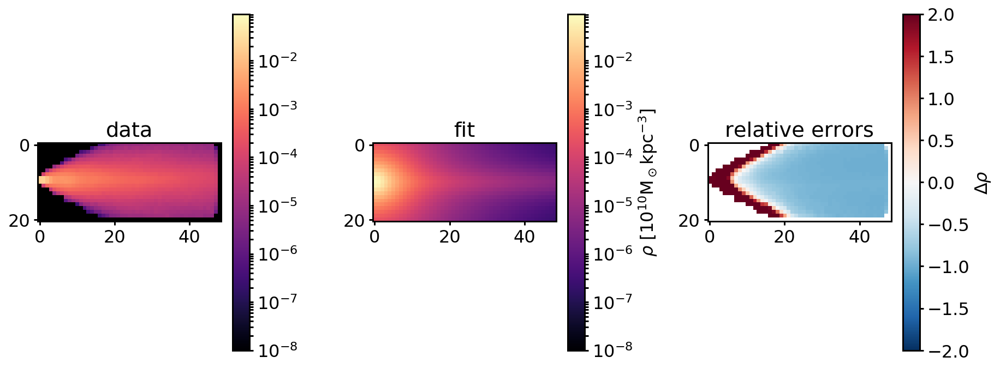

(21, 49)
a and b: 0.557908608340286, 1.4938642254901697
Rho mean galpy: 0.0011642035780128782
Rho mean data: 0.00033879189738258395
111.660692155 117.1251829752916
Circular velocity ar R=8kpc: 111.66069215524993 km/s and its error compared to the data: -0.046655131554368075 km/s
Multiply rho error with 0.0021767013003553917
Error: 320211874816371.5
Error multiplied by vcirc error: 697005604302.0337
data max: 0.019812705986395618, fit max: 0.07823017913223124, chosen max: 0.07823017913223124


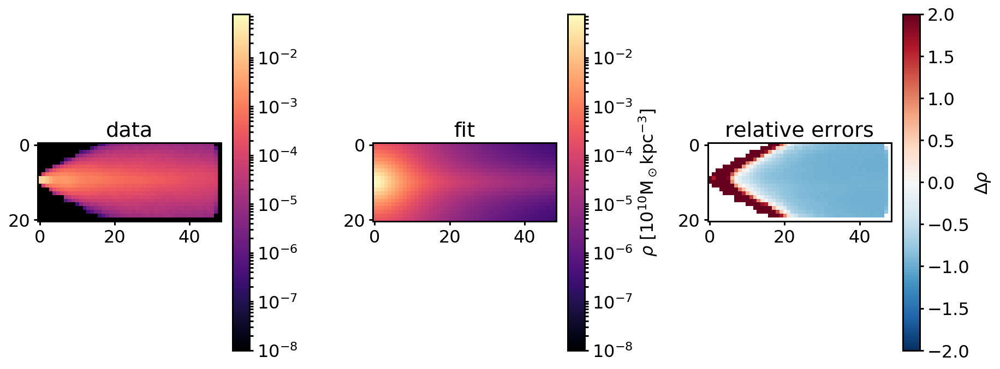

(21, 49)
a and b: 0.3785165926204117, 1.8006950648320577
Rho mean galpy: 0.001121570312740928
Rho mean data: 0.00033879189738258395
111.003237862 117.1251829752916
Circular velocity ar R=8kpc: 111.00323786201344 km/s and its error compared to the data: -0.052268393165026066 km/s
Multiply rho error with 0.0027319849240537435
Error: 271902937536998.8
Error multiplied by vcirc error: 742834726157.0074
data max: 0.019812705986395618, fit max: 0.06221462713224901, chosen max: 0.06221462713224901


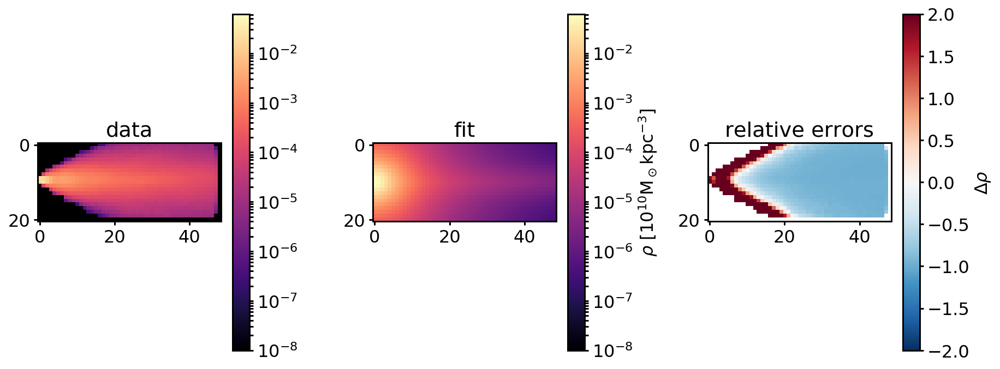

(21, 49)
a and b: 0.5618263043731391, 1.3688915675976552
Rho mean galpy: 0.001236367129753302
Rho mean data: 0.00033879189738258395
112.256282084 117.1251829752916
Circular velocity ar R=8kpc: 112.25628208448317 km/s and its error compared to the data: -0.0415700600598895 km/s
Multiply rho error with 0.0017280698933828205
Error: 408885159900118.4
Error multiplied by vcirc error: 706582134674.415
data max: 0.019812705986395618, fit max: 0.09475451315952384, chosen max: 0.09475451315952384


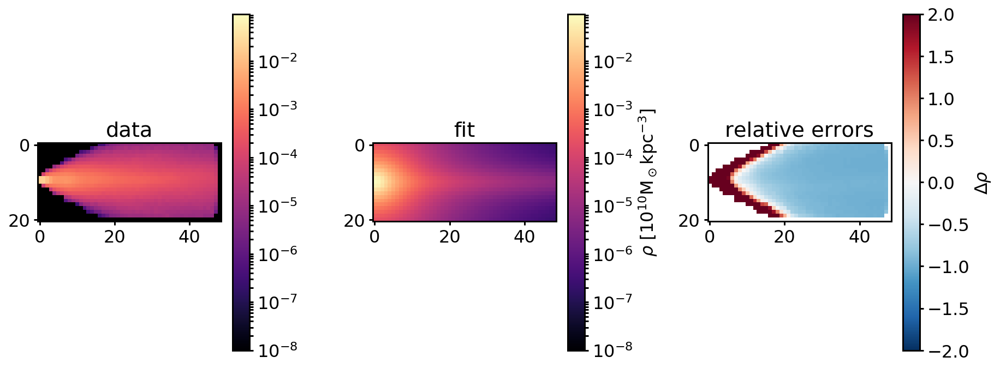

(21, 49)
a and b: 0.7016723346667524, 1.4920881041695953
Rho mean galpy: 0.0010663605415879751
Rho mean data: 0.00033879189738258395
110.926257035 117.1251829752916
Circular velocity ar R=8kpc: 110.92625703534709 km/s and its error compared to the data: -0.05292564572771861 km/s
Multiply rho error with 0.002801123975695979
Error: 260399358333459.6
Error multiplied by vcirc error: 729410885883.7021
data max: 0.019812705986395618, fit max: 0.06595925097156341, chosen max: 0.06595925097156341


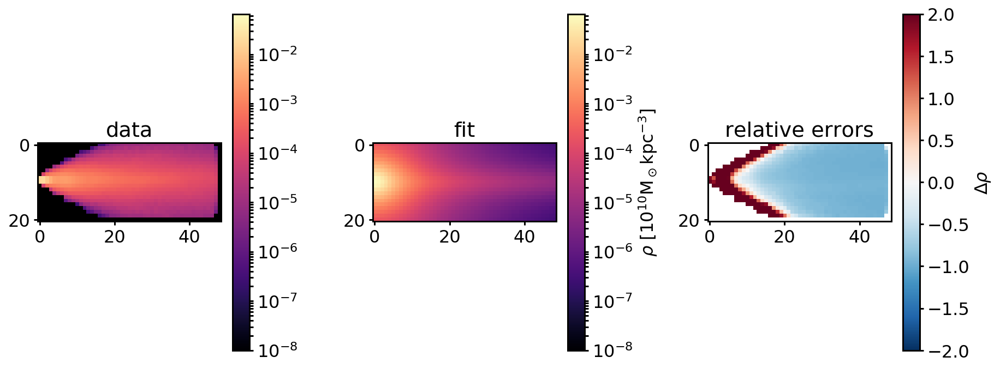

(21, 49)
a and b: 0.42358856377591625, 1.5829050031690617
Rho mean galpy: 0.0012148954190665975
Rho mean data: 0.00033879189738258395
111.886833503 117.1251829752916
Circular velocity ar R=8kpc: 111.88683350302517 km/s and its error compared to the data: -0.0447243653260417 km/s
Multiply rho error with 0.0020002688538172412
Error: 347933037681799.0
Error multiplied by vcirc error: 695959618488.9231
data max: 0.019812705986395618, fit max: 0.08095740492539859, chosen max: 0.08095740492539859


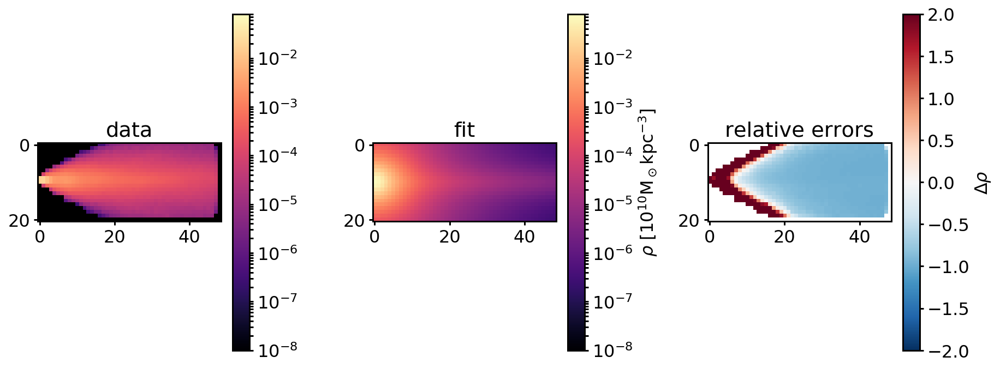

(21, 49)
a and b: 0.3793850490022175, 1.6036475746567427
Rho mean galpy: 0.0012377317799335357
Rho mean data: 0.00033879189738258395
112.002432802 117.1251829752916
Circular velocity ar R=8kpc: 112.00243280200692 km/s and its error compared to the data: -0.04373739313060756 km/s
Multiply rho error with 0.0019129595578613174
Error: 367910930003269.75
Error multiplied by vcirc error: 703798729991.401
data max: 0.019812705986395618, fit max: 0.08303564902653002, chosen max: 0.08303564902653002


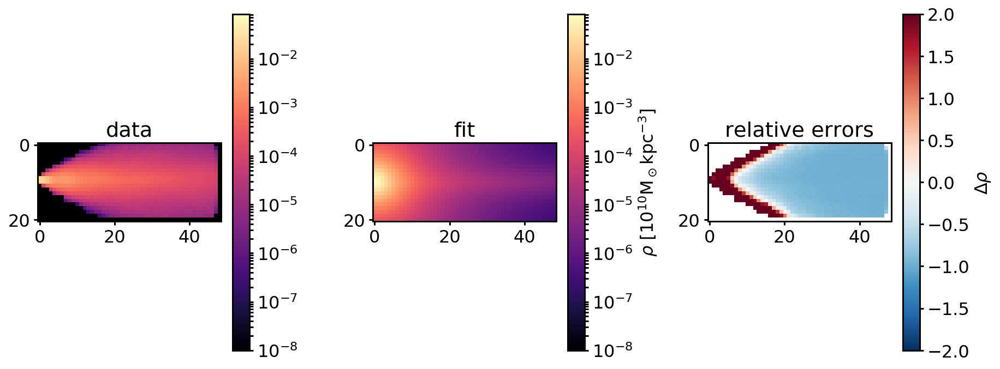

(21, 49)
a and b: 0.18242572505718613, 1.1608688642330862
Rho mean galpy: 0.0019272481989484713
Rho mean data: 0.00033879189738258395
114.708041003 117.1251829752916
Circular velocity ar R=8kpc: 114.70804100303536 km/s and its error compared to the data: -0.020637252475124376 km/s
Multiply rho error with 0.0004258961897220272
Error: 1926980793075052.2
Error multiplied by vcirc error: 820693777438.1948
data max: 0.019812705986395618, fit max: 0.25601037690138334, chosen max: 0.25601037690138334


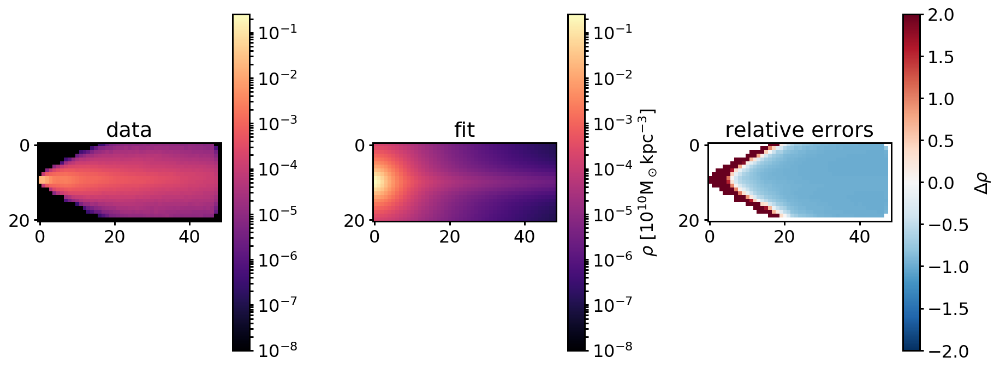

(21, 49)
a and b: 0.320405215492511, 1.3927300682907682
Rho mean galpy: 0.0014541225852005616
Rho mean data: 0.00033879189738258395
113.252064377 117.1251829752916
Circular velocity ar R=8kpc: 113.25206437661883 km/s and its error compared to the data: -0.03306819678130043 km/s
Multiply rho error with 0.001093505638366808
Error: 651732859091064.1
Error multiplied by vcirc error: 712673556124.999
data max: 0.019812705986395618, fit max: 0.12788304617879304, chosen max: 0.12788304617879304


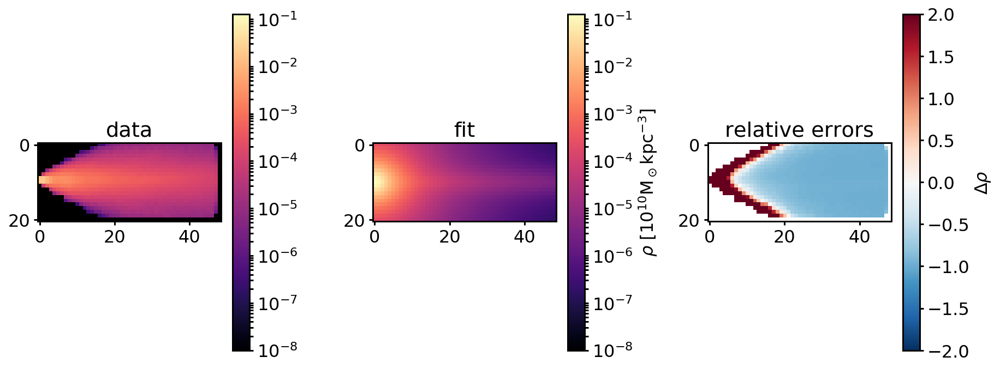

(21, 49)
a and b: 0.19958100675144408, 1.44993396588112
Rho mean galpy: 0.001545010570087993
Rho mean data: 0.00033879189738258395
113.52430261 117.1251829752916
Circular velocity ar R=8kpc: 113.52430261017992 km/s and its error compared to the data: -0.03074386117177985 km/s
Multiply rho error with 0.0009451849997496728
Error: 830495397502197.4
Error multiplied by vcirc error: 784971792080.2188
data max: 0.019812705986395618, fit max: 0.13890942699752273, chosen max: 0.13890942699752273


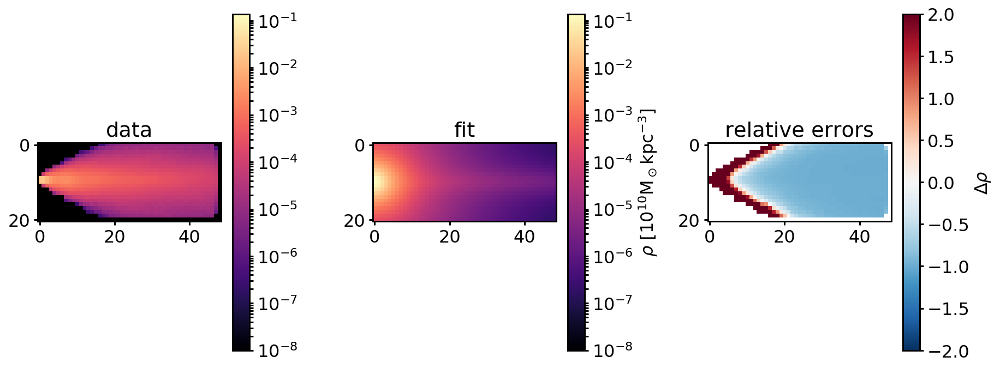

(21, 49)
a and b: 0.3717120977889836, 1.3391516194550679
Rho mean galpy: 0.00144299720927853
Rho mean data: 0.00033879189738258395
113.261935315 117.1251829752916
Circular velocity ar R=8kpc: 113.2619353154605 km/s and its error compared to the data: -0.03298391995379908 km/s
Multiply rho error with 0.0010879389755186252
Error: 649215677755056.8
Error multiplied by vcirc error: 706307039347.4663
data max: 0.019812705986395618, fit max: 0.13028949563605158, chosen max: 0.13028949563605158


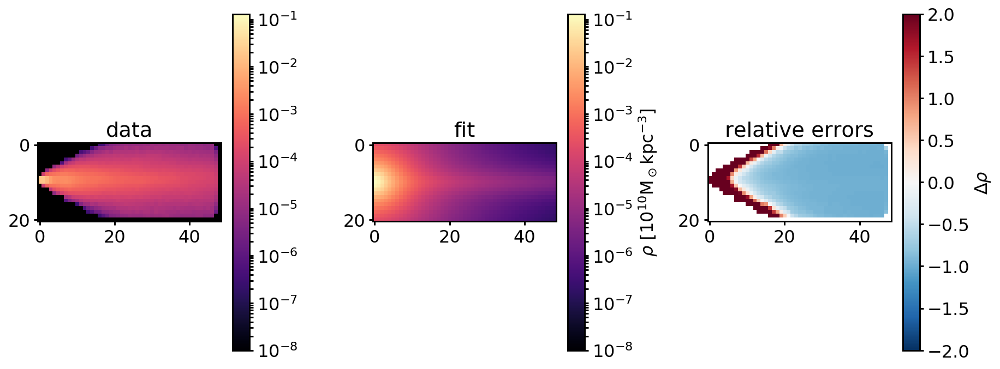

(21, 49)
a and b: 0.4775772582469484, 1.598889743357509
Rho mean galpy: 0.0011637356451286204
Rho mean data: 0.00033879189738258395
111.535693091 117.1251829752916
Circular velocity ar R=8kpc: 111.53569309146265 km/s and its error compared to the data: -0.04772235775297008 km/s
Multiply rho error with 0.0022774234295024638
Error: 305771323431557.5
Error multiplied by vcirc error: 696370776053.0048
data max: 0.019812705986395618, fit max: 0.07381479580113173, chosen max: 0.07381479580113173


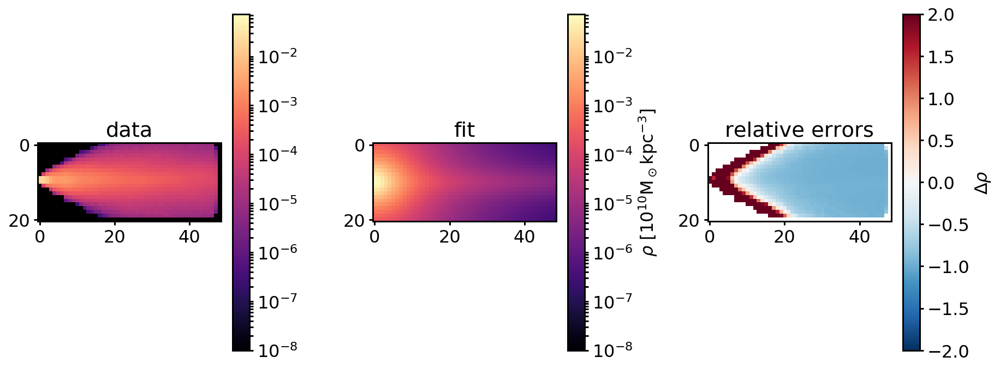

(21, 49)
a and b: 0.5881284356067136, 1.5889964716867948
Rho mean galpy: 0.001091923035490224
Rho mean data: 0.00033879189738258395
111.014247496 117.1251829752916
Circular velocity ar R=8kpc: 111.01424749616166 km/s and its error compared to the data: -0.052174394301002555 km/s
Multiply rho error with 0.0027221674206764877
Error: 259923584539541.06
Error multiplied by vcirc error: 707555513698.9895
data max: 0.019812705986395618, fit max: 0.06551514617060543, chosen max: 0.06551514617060543


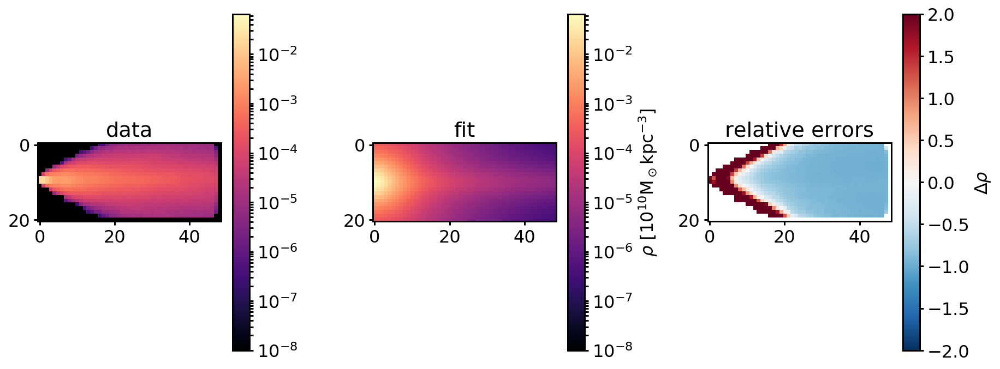

(21, 49)
a and b: 0.43095639285227527, 1.5396799226862135
Rho mean galpy: 0.001236300263293247
Rho mean data: 0.00033879189738258395
112.063075507 117.1251829752916
Circular velocity ar R=8kpc: 112.06307550690859 km/s and its error compared to the data: -0.04321963338534031 km/s
Multiply rho error with 0.0018679367099632225
Error: 370533222361379.9
Error multiplied by vcirc error: 692132608309.7871
data max: 0.019812705986395618, fit max: 0.0857356298303346, chosen max: 0.0857356298303346


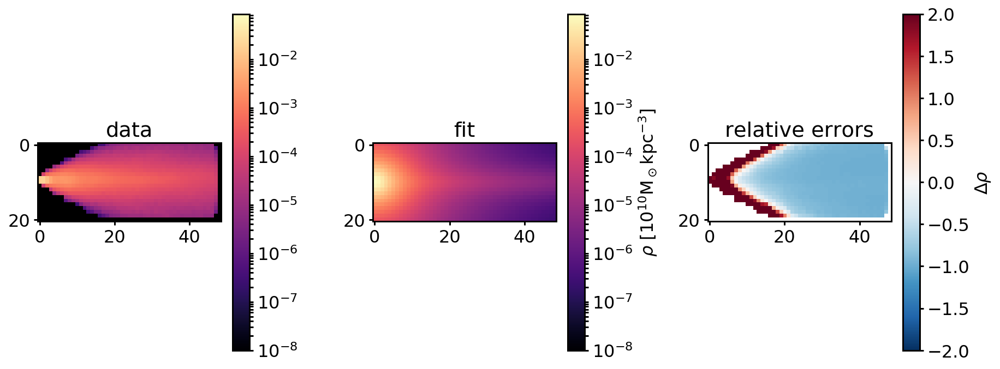

(21, 49)
a and b: 0.4180820219593686, 1.3511143823629457
Rho mean galpy: 0.0013831142319222847
Rho mean data: 0.00033879189738258395
113.004960063 117.1251829752916
Circular velocity ar R=8kpc: 113.00496006296814 km/s and its error compared to the data: -0.03517794216118874 km/s
Multiply rho error with 0.0012374876146959402
Error: 565768335672119.0
Error multiplied by vcirc error: 700131308181.3826
data max: 0.019812705986395618, fit max: 0.11912834499111635, chosen max: 0.11912834499111635


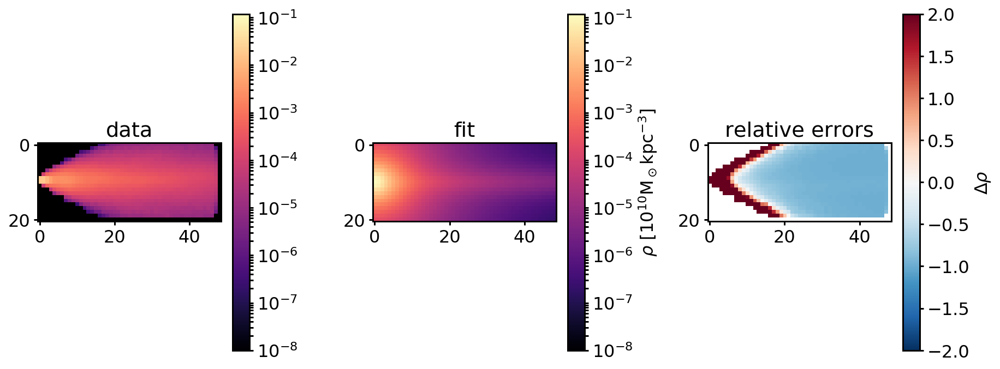

(21, 49)
a and b: 0.36588837528295315, 1.4338333345943652
Rho mean galpy: 0.0013712502112672373
Rho mean data: 0.00033879189738258395
112.867612124 117.1251829752916
Circular velocity ar R=8kpc: 112.8676121242897 km/s and its error compared to the data: -0.036350601491910176 km/s
Multiply rho error with 0.0013213662288236623
Error: 529184628101184.75
Error multiplied by vcirc error: 699246696385.5148
data max: 0.019812705986395618, fit max: 0.11137014538212942, chosen max: 0.11137014538212942


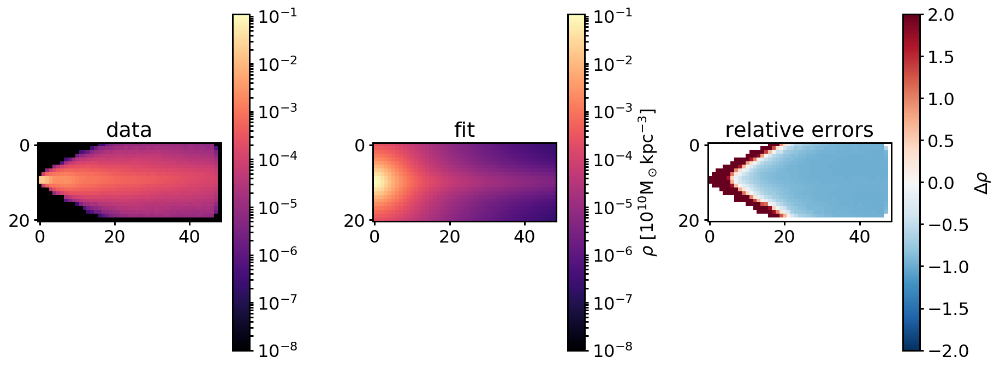

(21, 49)
a and b: 0.6099703593791768, 1.4878942935168111
Rho mean galpy: 0.0011297690181780247
Rho mean data: 0.00033879189738258395
111.426439321 117.1251829752916
Circular velocity ar R=8kpc: 111.4264393211626 km/s and its error compared to the data: -0.048655152627007474 km/s
Multiply rho error with 0.0023673238771573925
Error: 298276223657808.25
Error multiplied by vcirc error: 706116426253.4681
data max: 0.019812705986395618, fit max: 0.07402558126044574, chosen max: 0.07402558126044574


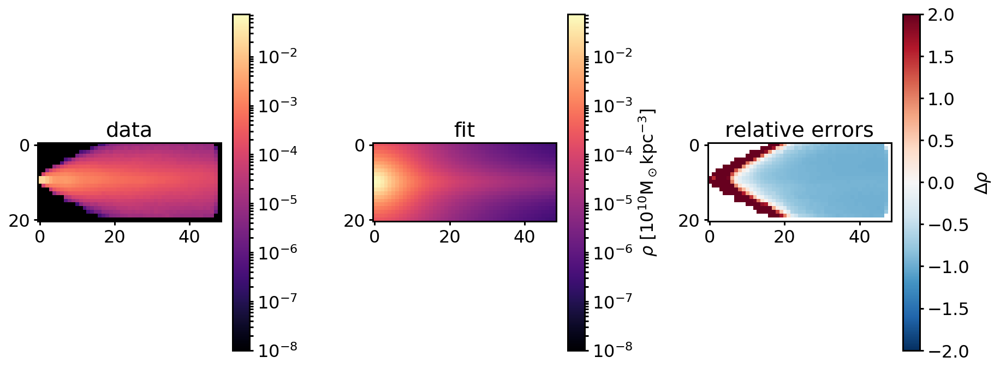

(21, 49)
a and b: 0.383611408579422, 1.4012650143464025
Rho mean galpy: 0.0013788661816452334
Rho mean data: 0.00033879189738258395
112.934652941 117.1251829752916
Circular velocity ar R=8kpc: 112.93465294113834 km/s and its error compared to the data: -0.035778215475977336 km/s
Multiply rho error with 0.0012800807026454642
Error: 545336176703748.1
Error multiplied by vcirc error: 698074316252.9249
data max: 0.019812705986395618, fit max: 0.11479403483948661, chosen max: 0.11479403483948661


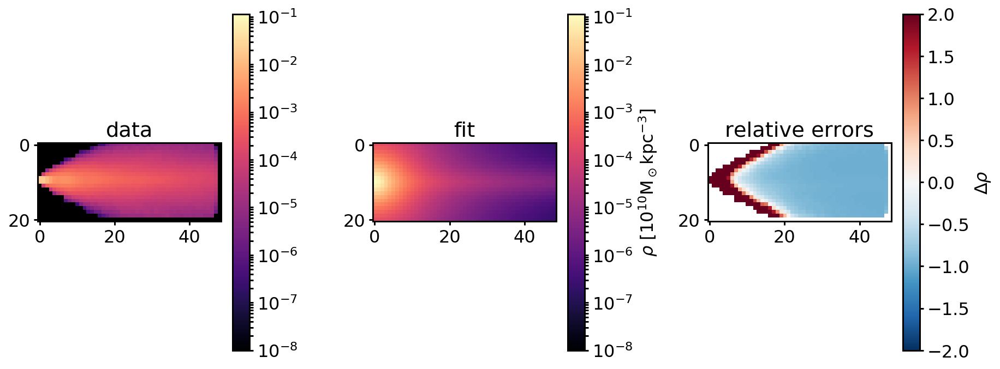

(21, 49)
a and b: 0.4200024839455603, 1.3522207091921323
Rho mean galpy: 0.0013802520011989986
Rho mean data: 0.00033879189738258395
112.99142873 117.1251829752916
Circular velocity ar R=8kpc: 112.99142872960947 km/s and its error compared to the data: -0.035293470974164215 km/s
Multiply rho error with 0.001245629093404172
Error: 561870213087871.0
Error multiplied by vcirc error: 699881884139.4537
data max: 0.019812705986395618, fit max: 0.11856854602612302, chosen max: 0.11856854602612302


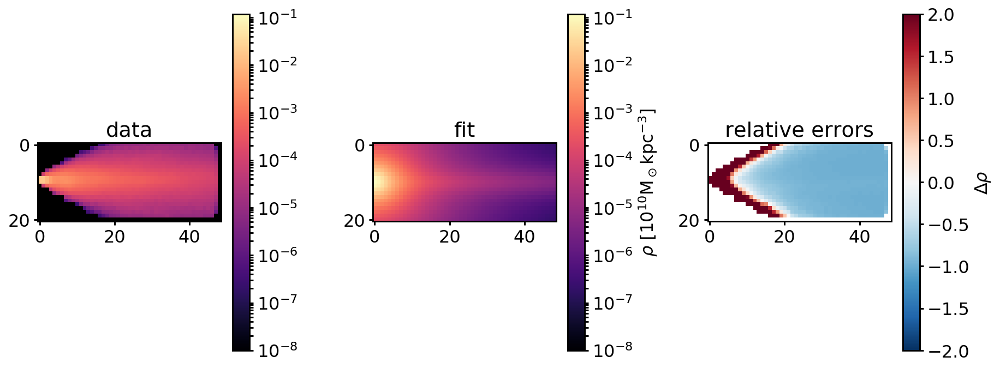

(21, 49)
a and b: 0.3676311459661452, 1.527774829263729
Rho mean galpy: 0.0012994351251995105
Rho mean data: 0.00033879189738258395
112.42452804 117.1251829752916
Circular velocity ar R=8kpc: 112.42452803990244 km/s and its error compared to the data: -0.04013359736975429 km/s
Multiply rho error with 0.0016107056378375484
Error: 434407359197998.8
Error multiplied by vcirc error: 699702382578.3376
data max: 0.019812705986395618, fit max: 0.09507940345107031, chosen max: 0.09507940345107031


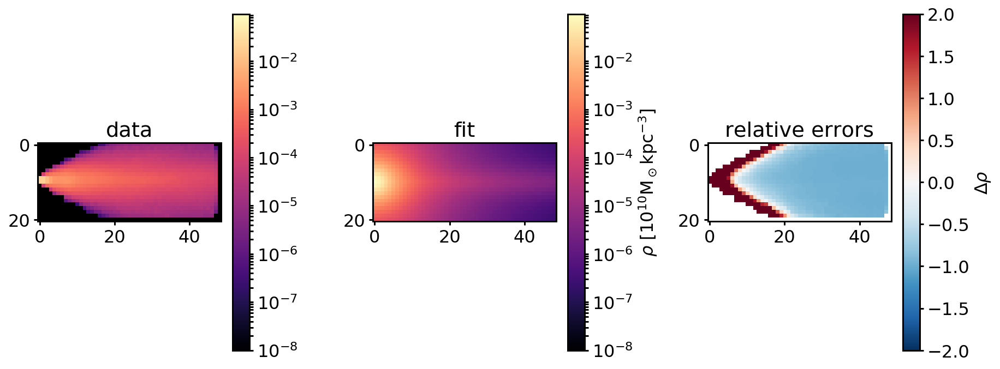

(21, 49)
a and b: 0.4445511174244636, 1.4465195721258128
Rho mean galpy: 0.00128679192999973
Rho mean data: 0.00033879189738258395
112.445009868 117.1251829752916
Circular velocity ar R=8kpc: 112.44500986822776 km/s and its error compared to the data: -0.03995872610974835 km/s
Multiply rho error with 0.0015966997923138845
Error: 432533414189707.6
Error multiplied by vcirc error: 690626012605.5215
data max: 0.019812705986395618, fit max: 0.09771010028088067, chosen max: 0.09771010028088067


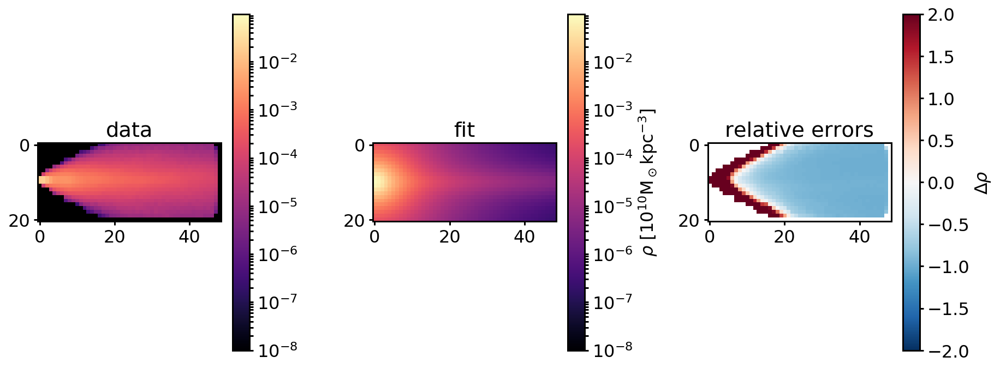

(21, 49)
a and b: 0.43943953589916784, 1.6759079315741925
Rho mean galpy: 0.00114776714613872
Rho mean data: 0.00033879189738258395
111.336530458 117.1251829752916
Circular velocity ar R=8kpc: 111.33653045816561 km/s and its error compared to the data: -0.049422783128946234 km/s
Multiply rho error with 0.0024426114922108523
Error: 289813383789994.0
Error multiplied by vcirc error: 707901501841.9536
data max: 0.019812705986395618, fit max: 0.0690767300867249, chosen max: 0.0690767300867249


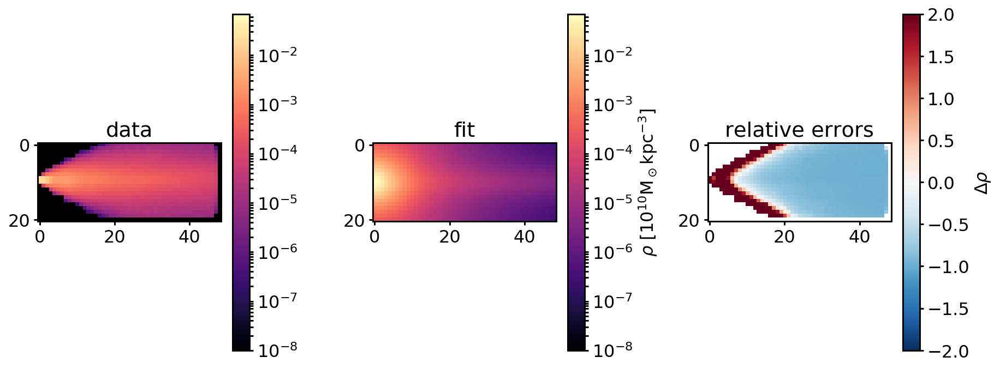

(21, 49)
a and b: 0.6743803451555257, 1.3530564083501933
Rho mean galpy: 0.001156838279790917
Rho mean data: 0.00033879189738258395
111.782730154 117.1251829752916
Circular velocity ar R=8kpc: 111.7827301544383 km/s and its error compared to the data: -0.04561318655084044 km/s
Multiply rho error with 0.0020805627873217714
Error: 353000157814717.56
Error multiplied by vcirc error: 734438992268.0139
data max: 0.019812705986395618, fit max: 0.08407228965458503, chosen max: 0.08407228965458503


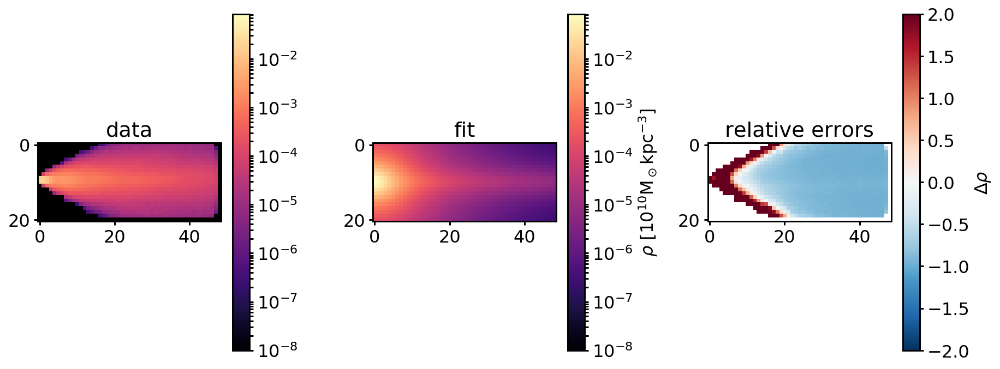

(21, 49)
a and b: 0.3972380468643468, 1.44872457566793
Rho mean galpy: 0.0013290746313999726
Rho mean data: 0.00033879189738258395
112.655842716 117.1251829752916
Circular velocity ar R=8kpc: 112.65584271612828 km/s and its error compared to the data: -0.038158661917362016 km/s
Multiply rho error with 0.0014560834793235341
Error: 476546450720593.0
Error multiplied by vcirc error: 693891414024.5222
data max: 0.019812705986395618, fit max: 0.10390759943459653, chosen max: 0.10390759943459653


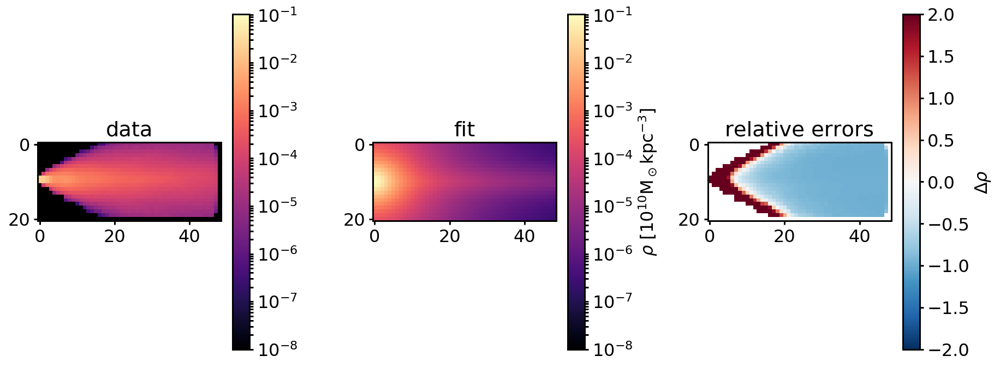

(21, 49)
a and b: 0.386256152936471, 1.2734388213554675
Rho mean galpy: 0.0014844512093101438
Rho mean data: 0.00033879189738258395
113.481332293 117.1251829752916
Circular velocity ar R=8kpc: 113.4813322928675 km/s and its error compared to the data: -0.031110736306749542 km/s
Multiply rho error with 0.0009678779135481042
Error: 740163488059974.2
Error multiplied by vcirc error: 716387892507.975
data max: 0.019812705986395618, fit max: 0.14366760394310313, chosen max: 0.14366760394310313


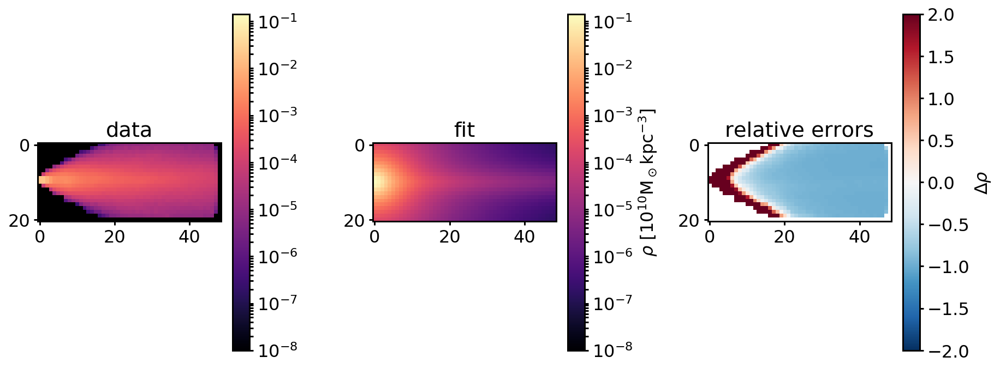

(21, 49)
a and b: 0.31480535331813275, 1.4522561754885543
Rho mean galpy: 0.0014094183316269774
Rho mean data: 0.00033879189738258395
113.014492435 117.1251829752916
Circular velocity ar R=8kpc: 113.01449243513437 km/s and its error compared to the data: -0.035096555973145434 km/s
Multiply rho error with 0.0012317682411761303
Error: 578531454315379.2
Error multiplied by vcirc error: 712616671947.1235
data max: 0.019812705986395618, fit max: 0.11618429097156993, chosen max: 0.11618429097156993


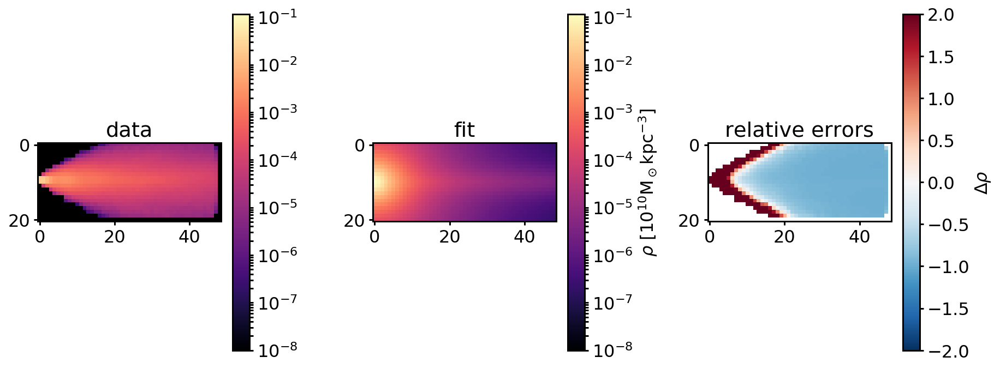

(21, 49)
a and b: 0.37481491202301864, 1.5028395983932836
Rho mean galpy: 0.0013106771454368929
Rho mean data: 0.00033879189738258395
112.508151495 117.1251829752916
Circular velocity ar R=8kpc: 112.50815149508527 km/s and its error compared to the data: -0.03941963088484838 km/s
Multiply rho error with 0.0015539072990976921
Error: 448746237737765.06
Error multiplied by vcirc error: 697310054263.3413
data max: 0.019812705986395618, fit max: 0.09803791561821534, chosen max: 0.09803791561821534


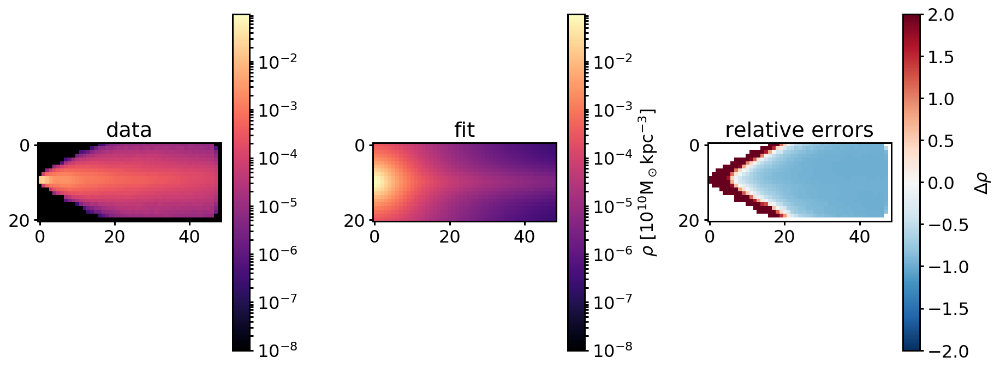

differential_evolution step 9: f(x)= 6.89739e+11
(21, 49)
a and b: 0.4953424756390783, 1.6221786978446082
Rho mean galpy: 0.0011377742150601295
Rho mean data: 0.00033879189738258395
111.325311478 117.1251829752916
Circular velocity ar R=8kpc: 111.3253114780171 km/s and its error compared to the data: -0.049518569362645266 km/s
Multiply rho error with 0.0024520887117231104
Error: 285477985954571.5
Error multiplied by vcirc error: 700017346804.6534
data max: 0.019812705986395618, fit max: 0.06978139478613796, chosen max: 0.06978139478613796


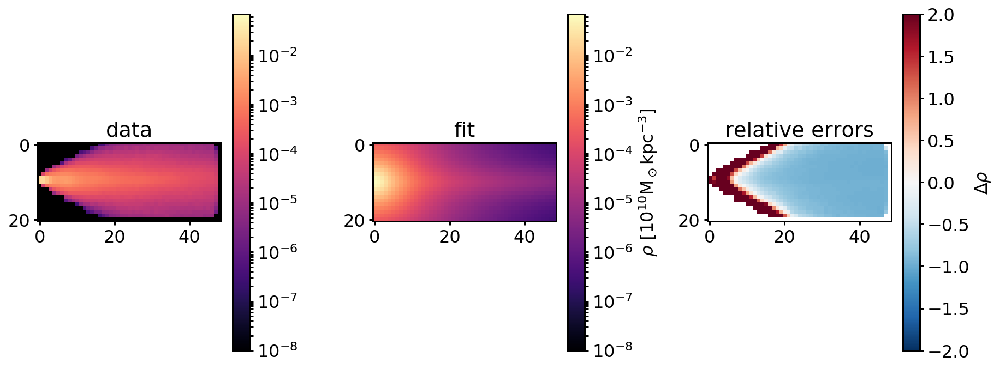

(21, 49)
a and b: 0.35234567764790015, 1.581380998427256
Rho mean galpy: 0.0012756554868866615
Rho mean data: 0.00033879189738258395
112.241830298 117.1251829752916
Circular velocity ar R=8kpc: 112.2418302981448 km/s and its error compared to the data: -0.04169344758400051 km/s
Multiply rho error with 0.0017383435714397979
Error: 406880878477563.75
Error multiplied by vcirc error: 707298759443.2506
data max: 0.019812705986395618, fit max: 0.08909932430307668, chosen max: 0.08909932430307668


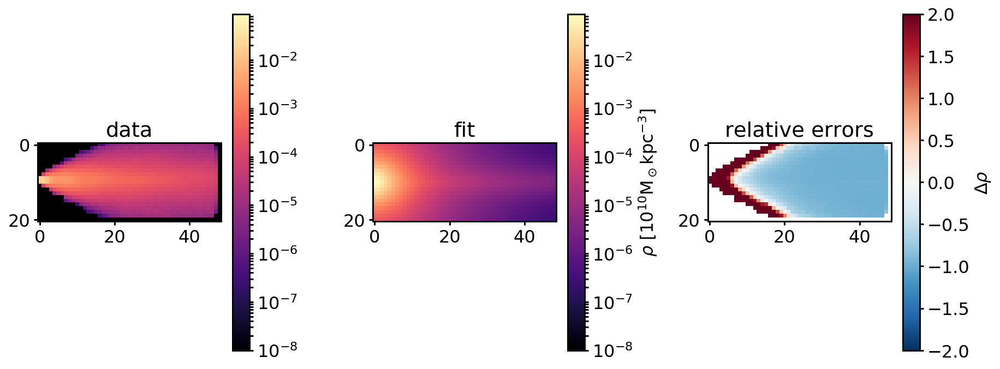

(21, 49)
a and b: 0.45565391201049366, 1.4647127272326592
Rho mean galpy: 0.001264570804392103
Rho mean data: 0.00033879189738258395
112.305861868 117.1251829752916
Circular velocity ar R=8kpc: 112.30586186787548 km/s and its error compared to the data: -0.04114675413939619 km/s
Multiply rho error with 0.0016930553762079174
Error: 407493947494595.5
Error multiplied by vcirc error: 689909818577.9117
data max: 0.019812705986395618, fit max: 0.09345860766316796, chosen max: 0.09345860766316796


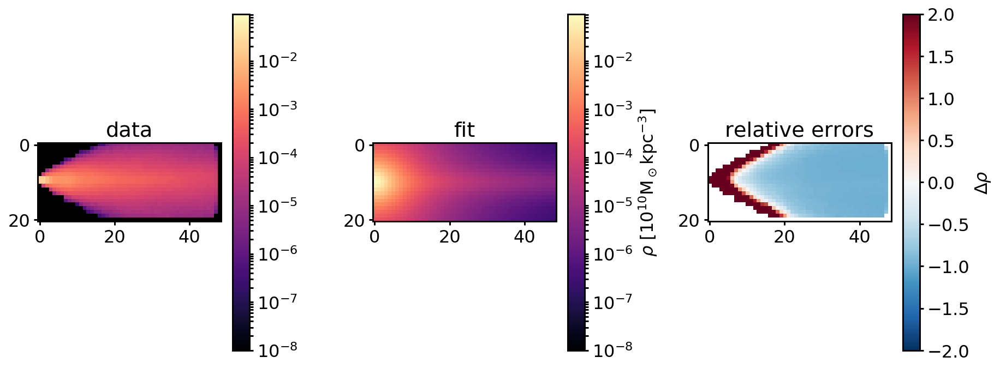

(21, 49)
a and b: 0.40934611061728354, 1.4618467025307738
Rho mean galpy: 0.0013081376785343542
Rho mean data: 0.00033879189738258395
112.538431615 117.1251829752916
Circular velocity ar R=8kpc: 112.53843161530858 km/s and its error compared to the data: -0.03916110304775891 km/s
Multiply rho error with 0.0015335919919171922
Error: 451414408841665.9
Error multiplied by vcirc error: 692285522435.6122
data max: 0.019812705986395618, fit max: 0.09998491380768708, chosen max: 0.09998491380768708


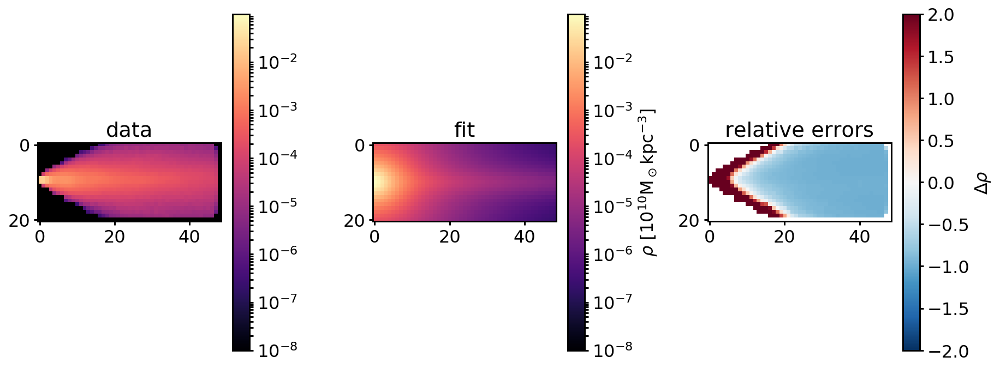

(21, 49)
a and b: 0.39372129547698176, 1.5415003061285844
Rho mean galpy: 0.0012667183644634343
Rho mean data: 0.00033879189738258395
112.234643171 117.1251829752916
Circular velocity ar R=8kpc: 112.23464317073146 km/s and its error compared to the data: -0.04175481036893517 km/s
Multiply rho error with 0.001743464188945736
Error: 399176160849342.56
Error multiplied by vcirc error: 695949341521.6716
data max: 0.019812705986395618, fit max: 0.08979989724472105, chosen max: 0.08979989724472105


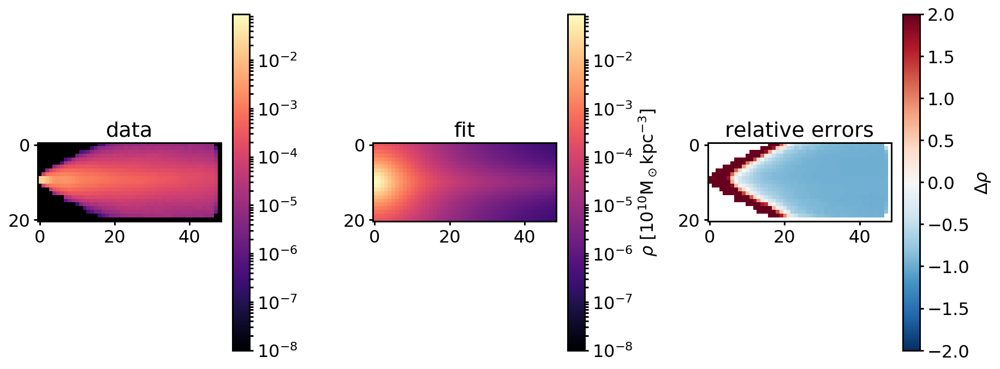

(21, 49)
a and b: 0.4484122961251735, 1.5388600679169864
Rho mean galpy: 0.0012224770285650835
Rho mean data: 0.00033879189738258395
111.981622393 117.1251829752916
Circular velocity ar R=8kpc: 111.981622392543 km/s and its error compared to the data: -0.04391506977482087 km/s
Multiply rho error with 0.0019285333533273854
Error: 358479902353236.94
Error multiplied by vcirc error: 691340448185.7617
data max: 0.019812705986395618, fit max: 0.08391588505484342, chosen max: 0.08391588505484342


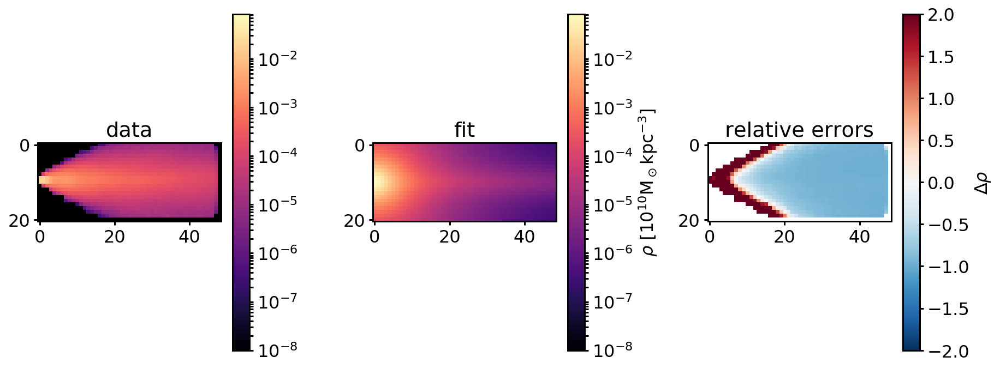

(21, 49)
a and b: 0.410993253840064, 1.4849250298320762
Rho mean galpy: 0.001290306314815424
Rho mean data: 0.00033879189738258395
112.422105143 117.1251829752916
Circular velocity ar R=8kpc: 112.42210514297373 km/s and its error compared to the data: -0.04015428375731979 km/s
Multiply rho error with 0.0016123665040633558
Error: 429179538756911.0
Error multiplied by vcirc error: 691994712521.0042
data max: 0.019812705986395618, fit max: 0.09606941056353155, chosen max: 0.09606941056353155


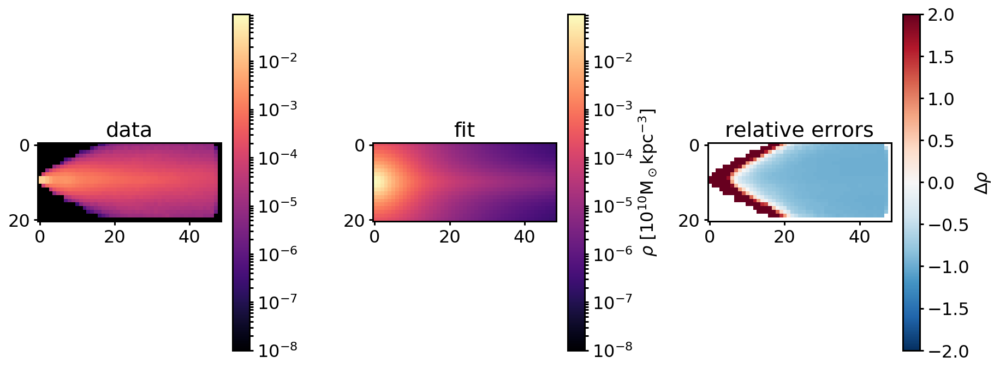

(21, 49)
a and b: 0.5044240756715377, 1.397881607519861
Rho mean galpy: 0.0012667248736656536
Rho mean data: 0.00033879189738258395
112.391852044 117.1251829752916
Circular velocity ar R=8kpc: 112.39185204449957 km/s and its error compared to the data: -0.04041258088613234 km/s
Multiply rho error with 0.0016331766938781887
Error: 426083312303695.0
Error multiplied by vcirc error: 695869335304.8164
data max: 0.019812705986395618, fit max: 0.09757046463263785, chosen max: 0.09757046463263785


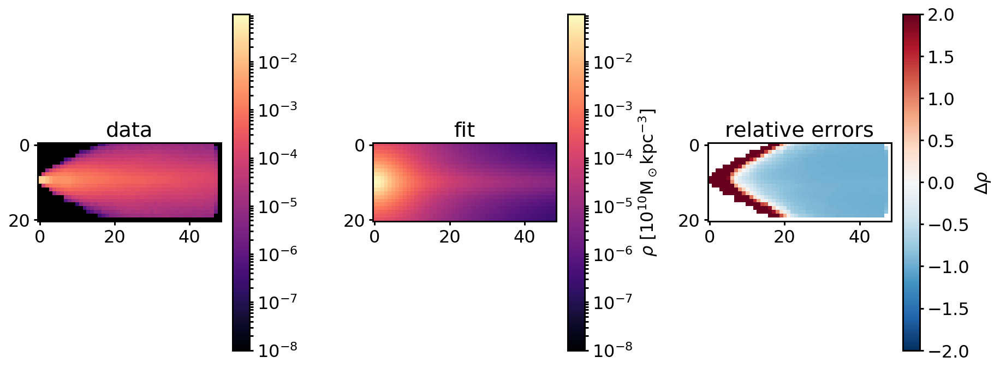

(21, 49)
a and b: 0.33057970709450846, 1.5420598752988919
Rho mean galpy: 0.0013234165146983198
Rho mean data: 0.00033879189738258395
112.531659338 117.1251829752916
Circular velocity ar R=8kpc: 112.53165933762736 km/s and its error compared to the data: -0.03921892389814469 km/s
Multiply rho error with 0.001538123991728465
Error: 461758846104848.0
Error multiplied by vcirc error: 710242359586.7188
data max: 0.019812705986395618, fit max: 0.09774687903813649, chosen max: 0.09774687903813649


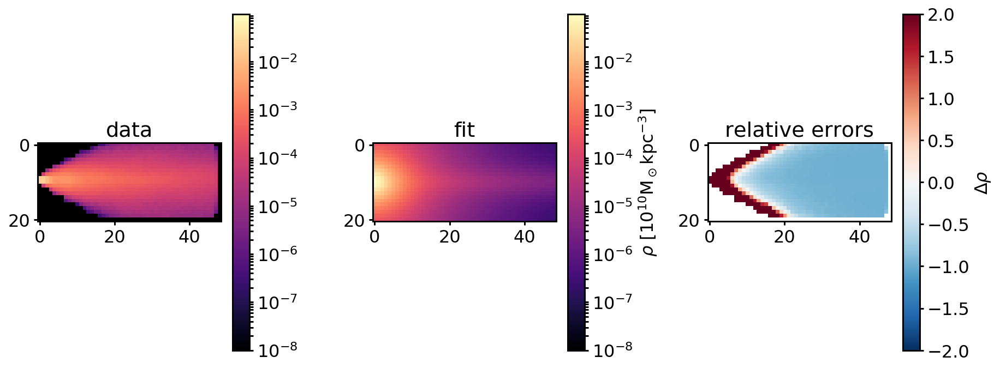

(21, 49)
a and b: 0.5461477578303562, 1.4617726727264633
Rho mean galpy: 0.0011918762636027825
Rho mean data: 0.00033879189738258395
111.879768086 117.1251829752916
Circular velocity ar R=8kpc: 111.87976808550208 km/s and its error compared to the data: -0.044784688967325445 km/s
Multiply rho error with 0.0020056683659000814
Error: 346936842304060.4
Error multiplied by vcirc error: 695840249574.519
data max: 0.019812705986395618, fit max: 0.0834221359682575, chosen max: 0.0834221359682575


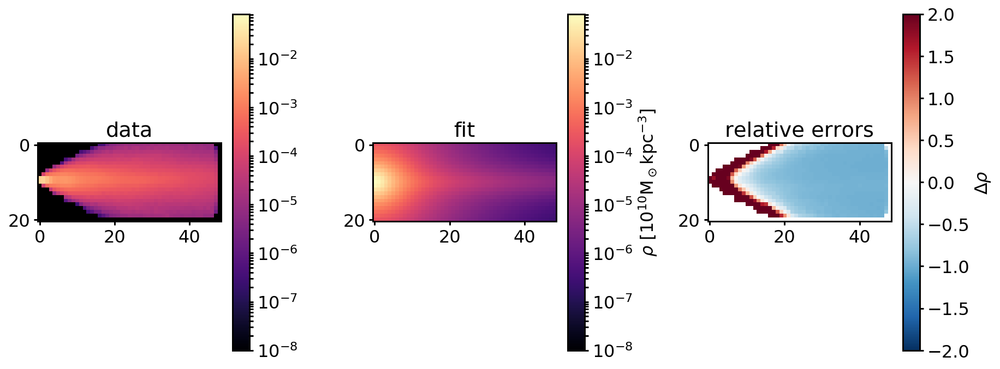

(21, 49)
a and b: 0.4252311207542503, 1.537865976784898
Rho mean galpy: 0.0012422500478348427
Rho mean data: 0.00033879189738258395
112.099808596 117.1251829752916
Circular velocity ar R=8kpc: 112.099808595573 km/s and its error compared to the data: -0.04290601091977579 km/s
Multiply rho error with 0.0018409257730479195
Error: 376119201825681.5
Error multiplied by vcirc error: 692407532379.1091
data max: 0.019812705986395618, fit max: 0.08662705453277313, chosen max: 0.08662705453277313


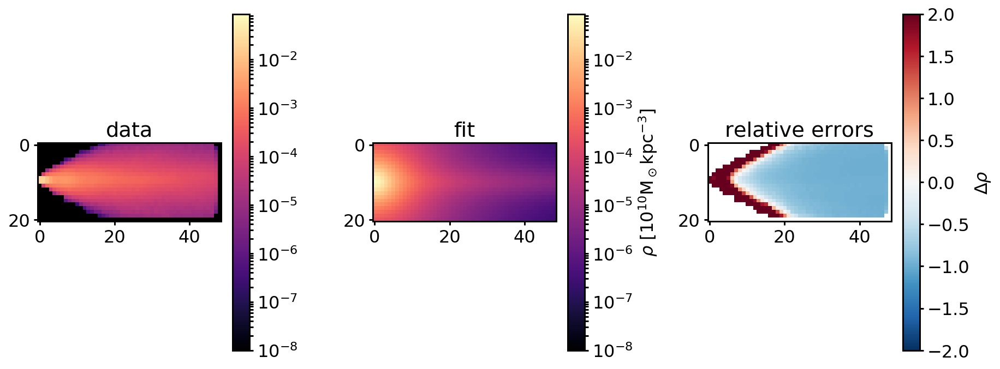

(21, 49)
a and b: 0.4596007768329411, 1.4415575280773718
Rho mean galpy: 0.001276756804210112
Rho mean data: 0.00033879189738258395
112.397292551 117.1251829752916
Circular velocity ar R=8kpc: 112.39729255062626 km/s and its error compared to the data: -0.040366130532856585 km/s
Multiply rho error with 0.0016294244941956167
Error: 423879529531256.6
Error multiplied by vcirc error: 690679688006.3438
data max: 0.019812705986395618, fit max: 0.0965157931467999, chosen max: 0.0965157931467999


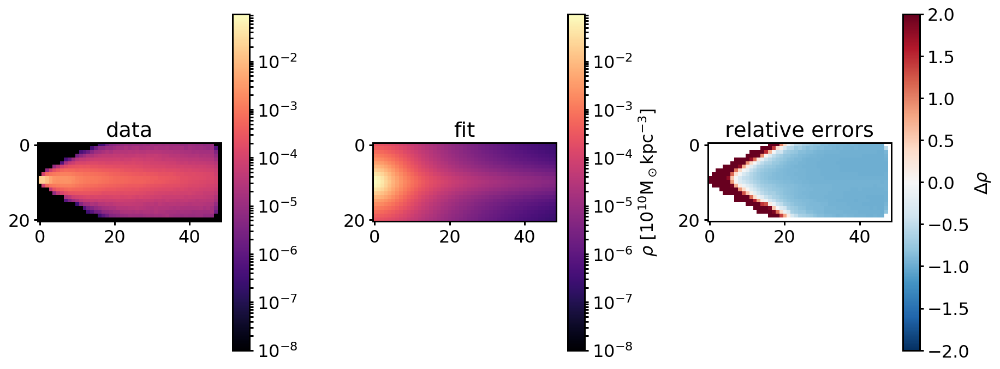

(21, 49)
a and b: 0.3876674375589735, 1.4283968125032742
Rho mean galpy: 0.0013536596010036768
Rho mean data: 0.00033879189738258395
112.793276358 117.1251829752916
Circular velocity ar R=8kpc: 112.79327635796133 km/s and its error compared to the data: -0.036985270863944854 km/s
Multiply rho error with 0.0013679102608793682
Error: 508720493479620.9
Error multiplied by vcirc error: 695883982950.3892
data max: 0.019812705986395618, fit max: 0.10896915408892813, chosen max: 0.10896915408892813


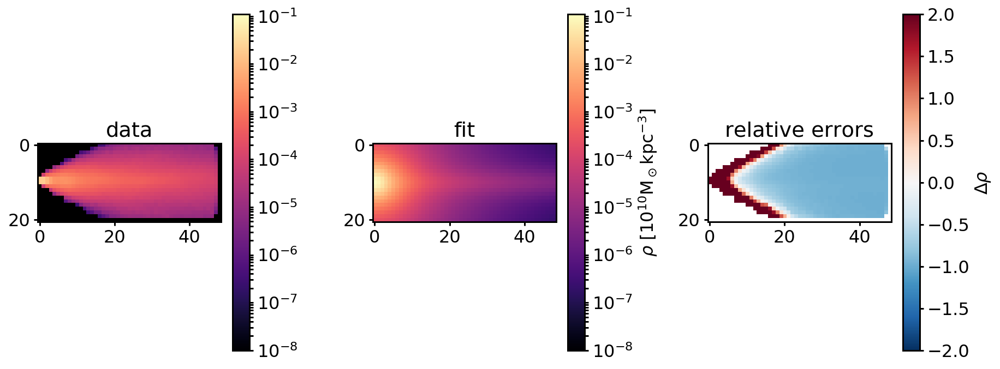

(21, 49)
a and b: 0.3809883609410738, 1.5604456370961062
Rho mean galpy: 0.001264957470401113
Rho mean data: 0.00033879189738258395
112.204727983 117.1251829752916
Circular velocity ar R=8kpc: 112.20472798325018 km/s and its error compared to the data: -0.04201022245642442 km/s
Multiply rho error with 0.0017648587908382666
Error: 396228436818032.06
Error multiplied by vcirc error: 699287239898.4086
data max: 0.019812705986395618, fit max: 0.08863991528731983, chosen max: 0.08863991528731983


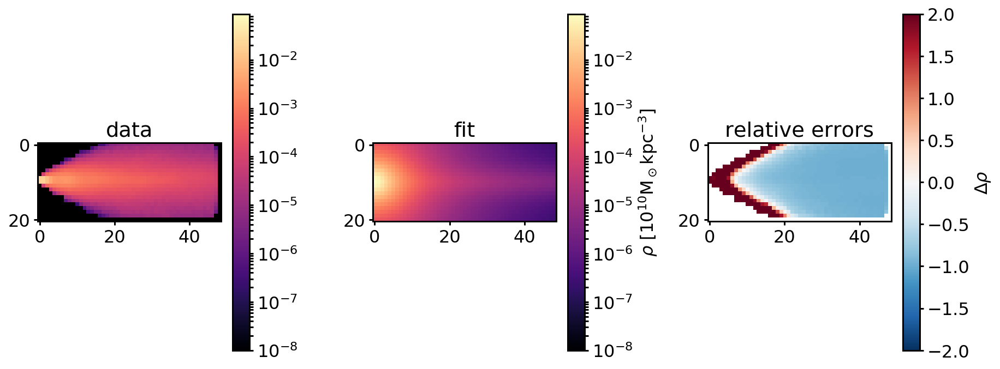

(21, 49)
a and b: 0.452233260666441, 1.4797615899702423
Rho mean galpy: 0.0012574949927839068
Rho mean data: 0.00033879189738258395
112.250150762 117.1251829752916
Circular velocity ar R=8kpc: 112.25015076212831 km/s and its error compared to the data: -0.04162240851475727 km/s
Multiply rho error with 0.0017324248905693385
Error: 398144456341496.0
Error multiplied by vcirc error: 689755366208.205
data max: 0.019812705986395618, fit max: 0.0916457773439392, chosen max: 0.0916457773439392


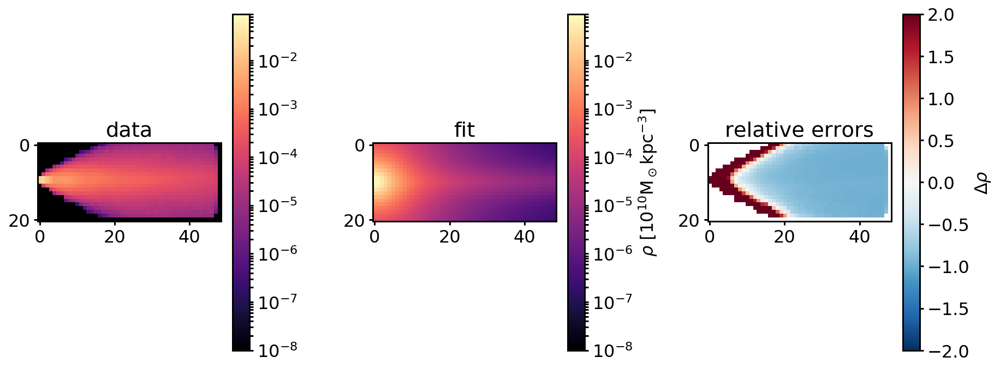

(21, 49)
a and b: 0.4674172579107436, 1.4677400674538172
Rho mean galpy: 0.001252417414622007
Rho mean data: 0.00033879189738258395
112.234952283 117.1251829752916
Circular velocity ar R=8kpc: 112.23495228266306 km/s and its error compared to the data: -0.04175217121035503 km/s
Multiply rho error with 0.0017432438007787994
Error: 395747989320065.4
Error multiplied by vcirc error: 689885229052.8784
data max: 0.019812705986395618, fit max: 0.09155836689996952, chosen max: 0.09155836689996952


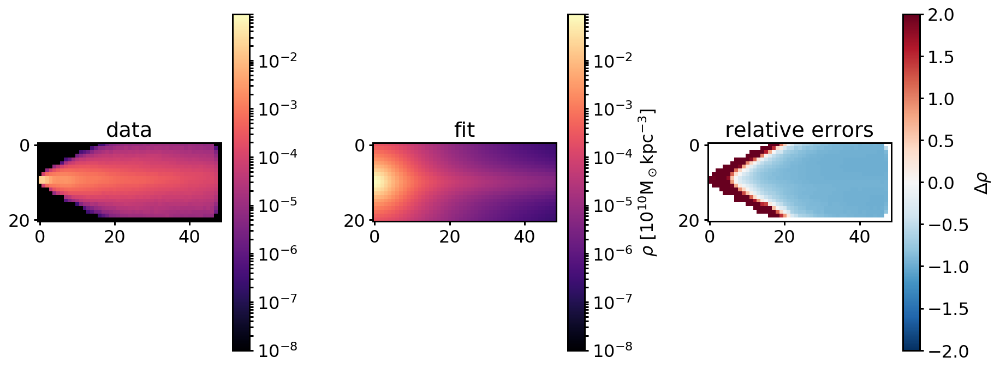

(21, 49)
a and b: 0.4743117940408945, 1.5197556753782793
Rho mean galpy: 0.0012134856792520951
Rho mean data: 0.00033879189738258395
111.948195384 117.1251829752916
Circular velocity ar R=8kpc: 111.94819538357419 km/s and its error compared to the data: -0.044200465350047985 km/s
Multiply rho error with 0.0019536811371607924
Error: 353396191293355.7
Error multiplied by vcirc error: 690423472874.296
data max: 0.019812705986395618, fit max: 0.08359466145540759, chosen max: 0.08359466145540759


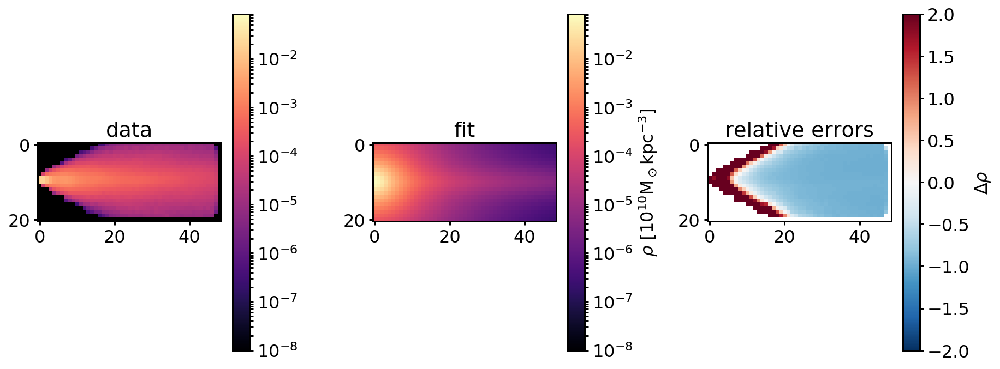

(21, 49)
a and b: 0.5057286541493058, 1.468085276212133
Rho mean galpy: 0.0012202369044051514
Rho mean data: 0.00033879189738258395
112.047559579 117.1251829752916
Circular velocity ar R=8kpc: 112.0475595793427 km/s and its error compared to the data: -0.043352106412675166 km/s
Multiply rho error with 0.0018794051304159114
Error: 367963191629026.9
Error multiplied by vcirc error: 691551910151.8063
data max: 0.019812705986395618, fit max: 0.08701592478017205, chosen max: 0.08701592478017205


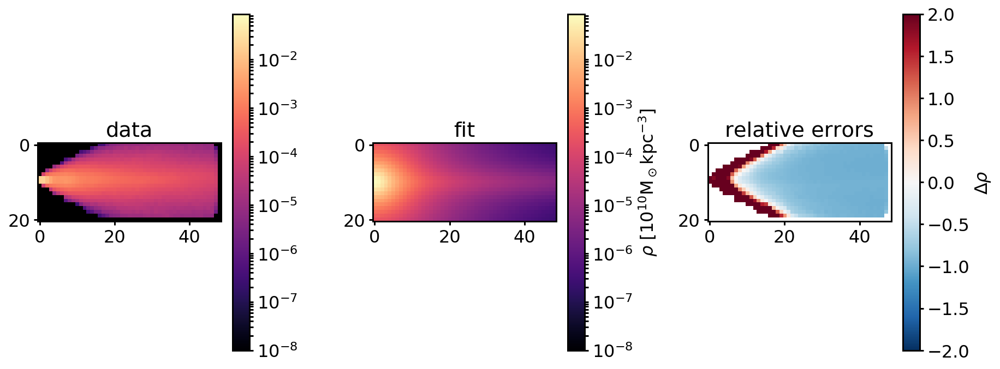

(21, 49)
a and b: 0.45307681331215566, 1.4552533167772128
Rho mean galpy: 0.001273208512113652
Rho mean data: 0.00033879189738258395
112.363242267 117.1251829752916
Circular velocity ar R=8kpc: 112.3632422672848 km/s and its error compared to the data: -0.0406568475458549 km/s
Multiply rho error with 0.0016529792523668875
Error: 417534389114168.5
Error multiplied by vcirc error: 690175682355.4033
data max: 0.019812705986395618, fit max: 0.095226627108325, chosen max: 0.095226627108325


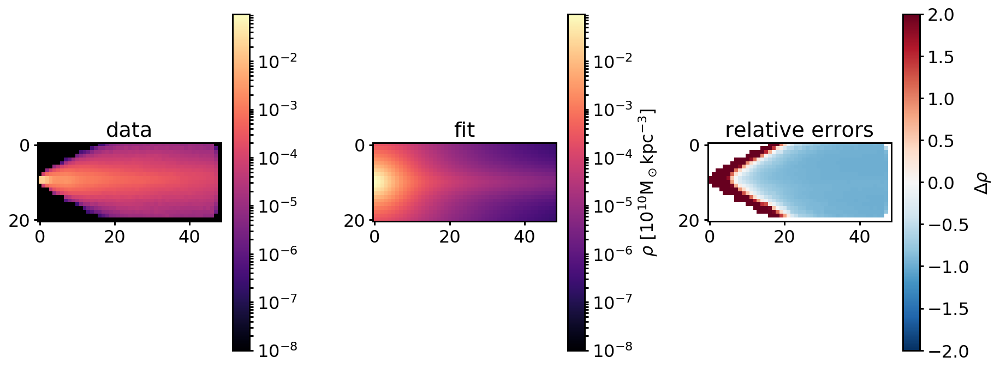

(21, 49)
a and b: 0.39710440727941965, 1.3356216161001684
Rho mean galpy: 0.0014179706165478238
Rho mean data: 0.00033879189738258395
113.166474822 117.1251829752916
Circular velocity ar R=8kpc: 113.16647482243052 km/s and its error compared to the data: -0.03379894957087236 km/s
Multiply rho error with 0.0011423689920943727
Error: 616125653980289.0
Error multiplied by vcirc error: 703842842340.949
data max: 0.019812705986395618, fit max: 0.126243416695421, chosen max: 0.126243416695421


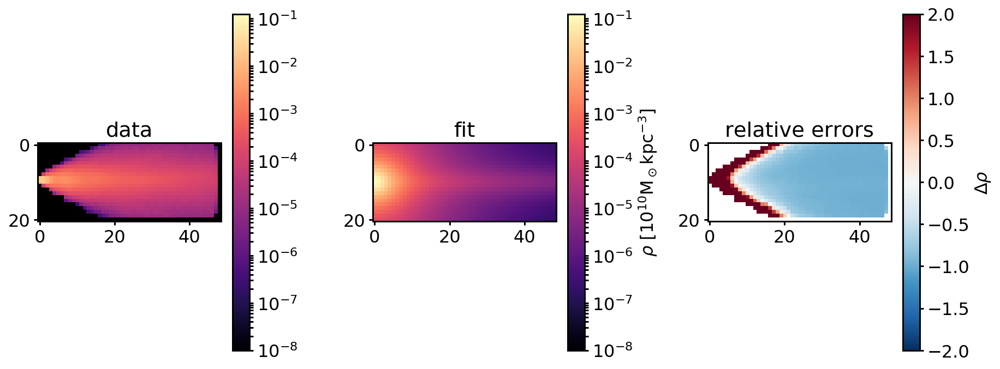

(21, 49)
a and b: 0.4899433835876108, 1.4012650143464025
Rho mean galpy: 0.0012772371331819465
Rho mean data: 0.00033879189738258395
112.44435986 117.1251829752916
Circular velocity ar R=8kpc: 112.44435985972257 km/s and its error compared to the data: -0.03996427580016229 km/s
Multiply rho error with 0.0015971433402314373
Error: 434851349318059.25
Error multiplied by vcirc error: 694519936553.9927
data max: 0.019812705986395618, fit max: 0.0989466178636783, chosen max: 0.0989466178636783


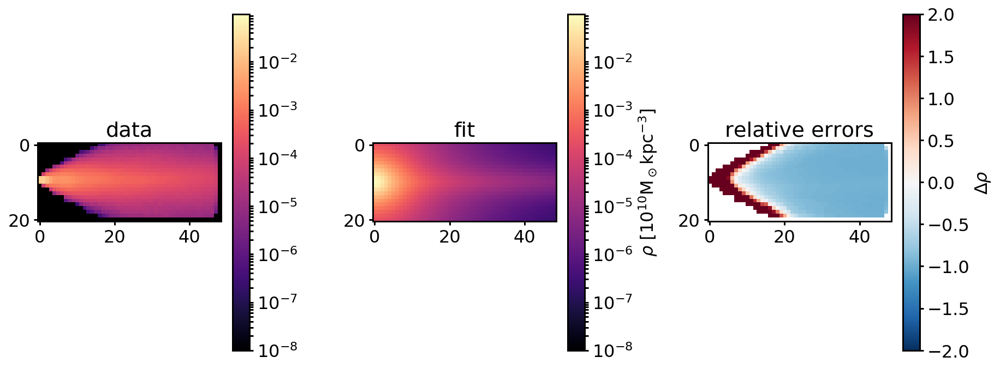

(21, 49)
a and b: 0.4274423381473511, 1.4890566326752508
Rho mean galpy: 0.001272811429296734
Rho mean data: 0.00033879189738258395
112.324331676 117.1251829752916
Circular velocity ar R=8kpc: 112.32433167589534 km/s and its error compared to the data: -0.04098906125430798 km/s
Multiply rho error with 0.0016801031425094115
Error: 411116600594633.3
Error multiplied by vcirc error: 690718292596.83
data max: 0.019812705986395618, fit max: 0.09333317755062784, chosen max: 0.09333317755062784


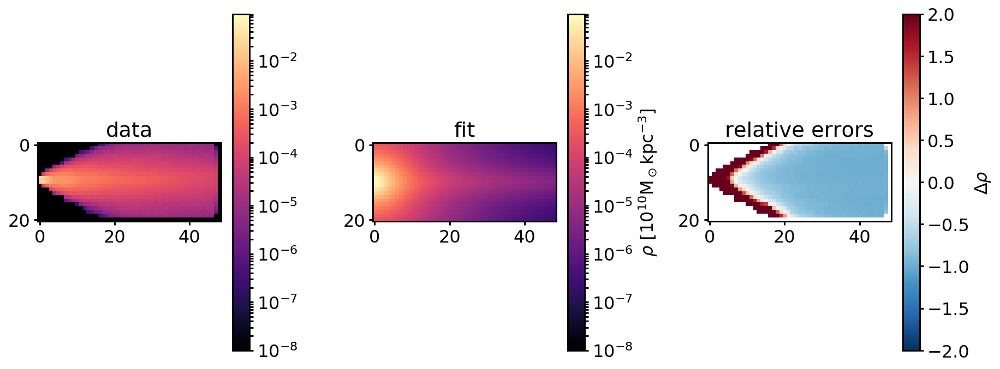

(21, 49)
a and b: 0.3676311459661452, 1.4271762204616745
Rho mean galpy: 0.0013747185930502884
Rho mean data: 0.00033879189738258395
112.889856321 117.1251829752916
Circular velocity ar R=8kpc: 112.88985632055966 km/s and its error compared to the data: -0.03616068335727089 km/s
Multiply rho error with 0.001307595020864808
Error: 534704798334211.75
Error multiplied by vcirc error: 699177331934.3367
data max: 0.019812705986395618, fit max: 0.11236019521080116, chosen max: 0.11236019521080116


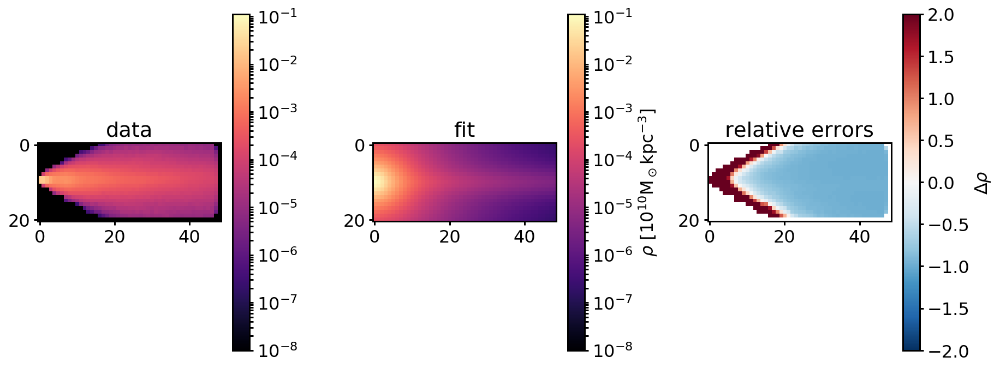

(21, 49)
a and b: 0.4445511174244636, 1.4705460708355316
Rho mean galpy: 0.0012703425479439017
Rho mean data: 0.00033879189738258395
112.331018354 117.1251829752916
Circular velocity ar R=8kpc: 112.33101835411937 km/s and its error compared to the data: -0.04093197124126237 km/s
Multiply rho error with 0.0016754262696955296
Error: 411836282462931.75
Error multiplied by vcirc error: 690001326452.1442
data max: 0.019812705986395618, fit max: 0.09397260934737564, chosen max: 0.09397260934737564


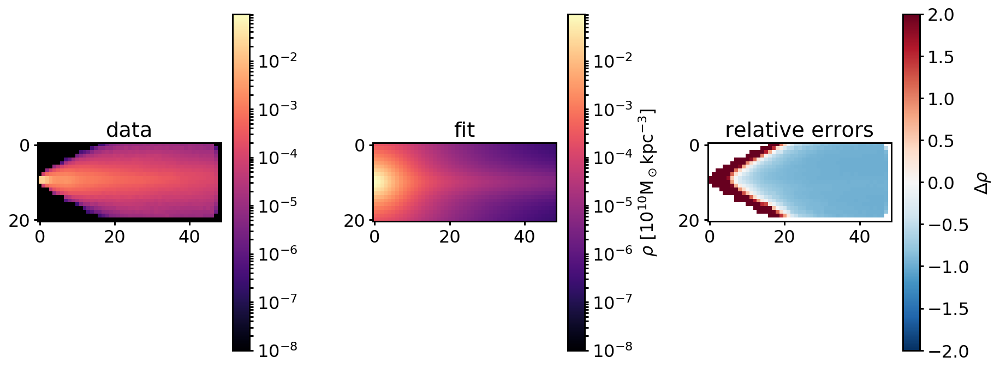

(21, 49)
a and b: 0.4334149059509409, 1.4064606874534946
Rho mean galpy: 0.001325650620160154
Rho mean data: 0.00033879189738258395
112.683973019 117.1251829752916
Circular velocity ar R=8kpc: 112.68397301917591 km/s and its error compared to the data: -0.037918488947441736 km/s
Multiply rho error with 0.001437811804057261
Error: 482229864668739.1
Error multiplied by vcirc error: 693355791689.6487
data max: 0.019812705986395618, fit max: 0.10602599143907701, chosen max: 0.10602599143907701


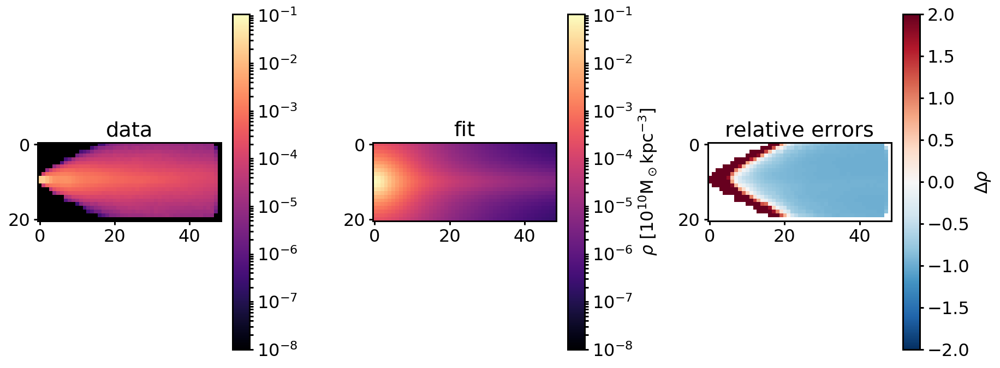

(21, 49)
a and b: 0.44663975718416893, 1.4439886121396304
Rho mean galpy: 0.001286665826419808
Rho mean data: 0.00033879189738258395
112.447097439 117.1251829752916
Circular velocity ar R=8kpc: 112.4470974389001 km/s and its error compared to the data: -0.039940902695352616 km/s
Multiply rho error with 0.0015952757081196258
Error: 432954395999034.75
Error multiplied by vcirc error: 690681630660.8651
data max: 0.019812705986395618, fit max: 0.09783700389349727, chosen max: 0.09783700389349727


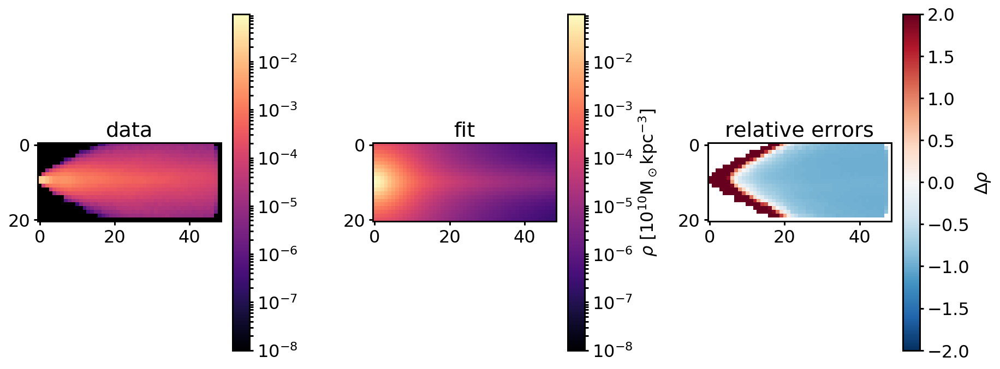

(21, 49)
a and b: 0.4384702953147315, 1.5592448713159193
Rho mean galpy: 0.001217723354382497
Rho mean data: 0.00033879189738258395
111.930213918 117.1251829752916
Circular velocity ar R=8kpc: 111.93021391819752 km/s and its error compared to the data: -0.04435398882740688 km/s
Multiply rho error with 0.0019672763249017344
Error: 352273318686978.6
Error multiplied by vcirc error: 693018959747.4568
data max: 0.019812705986395618, fit max: 0.08236230812570669, chosen max: 0.08236230812570669


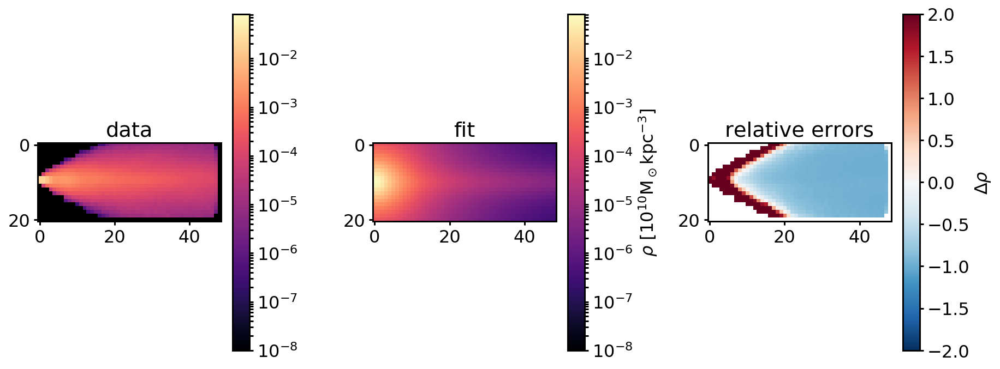

(21, 49)
a and b: 0.4110953837980631, 1.5025116289960319
Rho mean galpy: 0.0012780404725886195
Rho mean data: 0.00033879189738258395
112.33812233 117.1251829752916
Circular velocity ar R=8kpc: 112.33812232985525 km/s and its error compared to the data: -0.040871318394834065 km/s
Multiply rho error with 0.0016704646673319013
Error: 414395637453696.9
Error multiplied by vcirc error: 692233270662.881
data max: 0.019812705986395618, fit max: 0.09336656827839171, chosen max: 0.09336656827839171


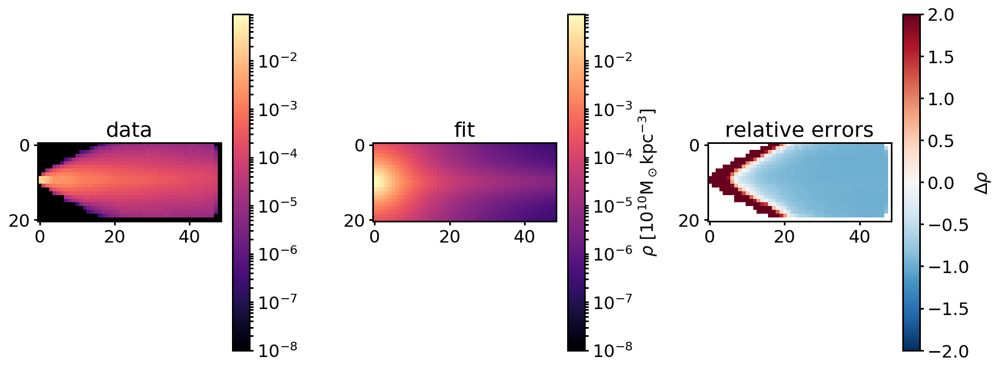

(21, 49)
a and b: 0.4409866016203443, 1.495842521908897
Rho mean galpy: 0.0012564901752490057
Rho mean data: 0.00033879189738258395
112.226909718 117.1251829752916
Circular velocity ar R=8kpc: 112.22690971781444 km/s and its error compared to the data: -0.04182083761192914 km/s
Multiply rho error with 0.0017489824585633469
Error: 394579858580306.2
Error multiplied by vcirc error: 690113251159.3616
data max: 0.019812705986395618, fit max: 0.09066921259619641, chosen max: 0.09066921259619641


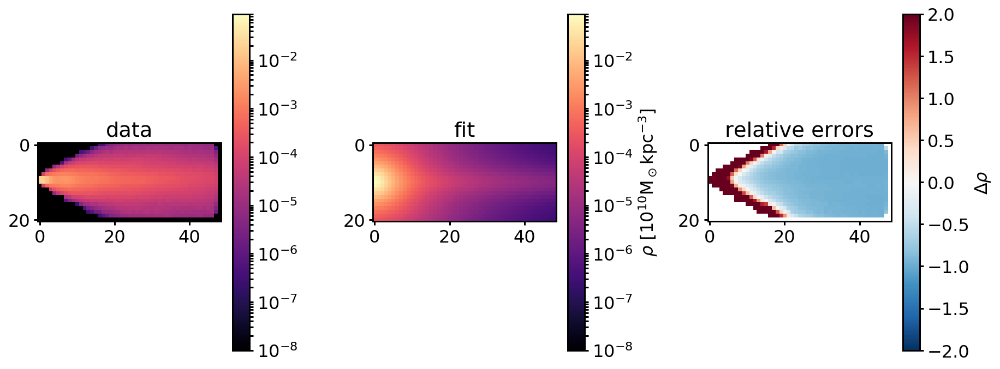

(21, 49)
a and b: 0.4721187637939446, 1.4908632699887814
Rho mean galpy: 0.0012334671192973797
Rho mean data: 0.00033879189738258395
112.100368343 117.1251829752916
Circular velocity ar R=8kpc: 112.10036834338611 km/s and its error compared to the data: -0.04290123186373597 km/s
Multiply rho error with 0.0018405156954260345
Error: 374786173464940.25
Error multiplied by vcirc error: 689799834690.887
data max: 0.019812705986395618, fit max: 0.08771039255366678, chosen max: 0.08771039255366678


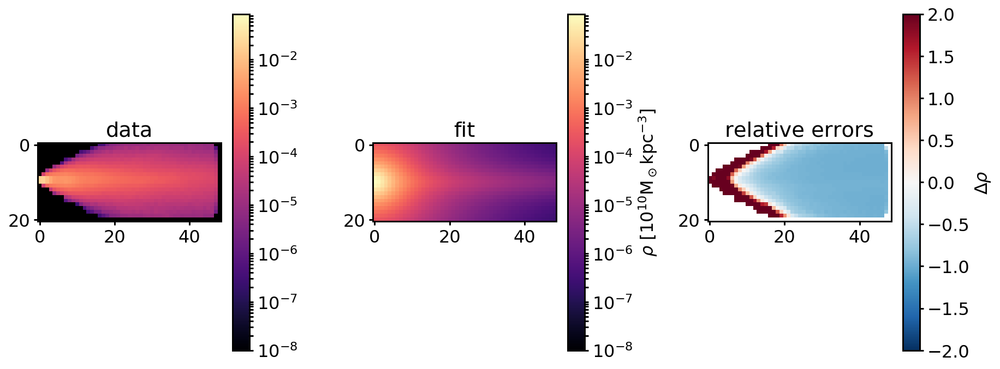

differential_evolution step 10: f(x)= 6.89739e+11
(21, 49)
a and b: 0.4542668255496123, 1.4908632699887814
Rho mean galpy: 0.001248441322722225
Rho mean data: 0.00033879189738258395
112.186893153 117.1251829752916
Circular velocity ar R=8kpc: 112.18689315257504 km/s and its error compared to the data: -0.04216249398524589 km/s
Multiply rho error with 0.0017776758990558955
Error: 388000342430291.75
Error multiplied by vcirc error: 689738857563.7642
data max: 0.019812705986395618, fit max: 0.0897954517436194, chosen max: 0.0897954517436194


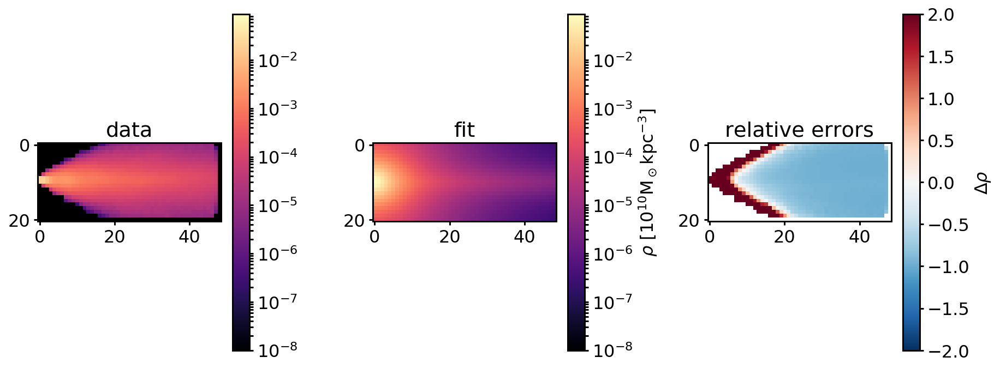

(21, 49)
a and b: 0.4542668355496123, 1.4908632699887814
Rho mean galpy: 0.001248441314240106
Rho mean data: 0.00033879189738258395
112.186893104 117.1251829752916
Circular velocity ar R=8kpc: 112.18689310428496 km/s and its error compared to the data: -0.04216249439754045 km/s
Multiply rho error with 0.0017776759338226295
Error: 388000334773398.4
Error multiplied by vcirc error: 689738857441.7938
data max: 0.019812705986395618, fit max: 0.08979545055609847, chosen max: 0.08979545055609847


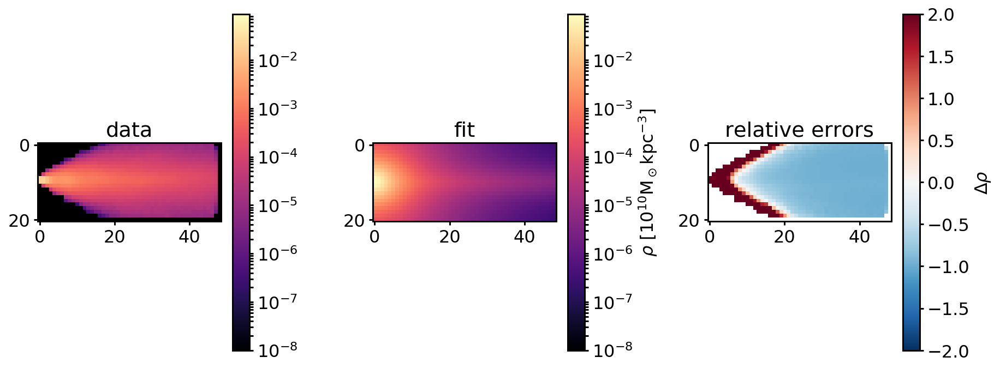

(21, 49)
a and b: 0.4542668255496123, 1.4908632799887813
Rho mean galpy: 0.0012484413161760342
Rho mean data: 0.00033879189738258395
112.186893104 117.1251829752916
Circular velocity ar R=8kpc: 112.18689310428496 km/s and its error compared to the data: -0.04216249439754045 km/s
Multiply rho error with 0.0017776759338226295
Error: 388000334879229.25
Error multiplied by vcirc error: 689738857629.9269
data max: 0.019812705986395618, fit max: 0.08979545031693105, chosen max: 0.08979545031693105


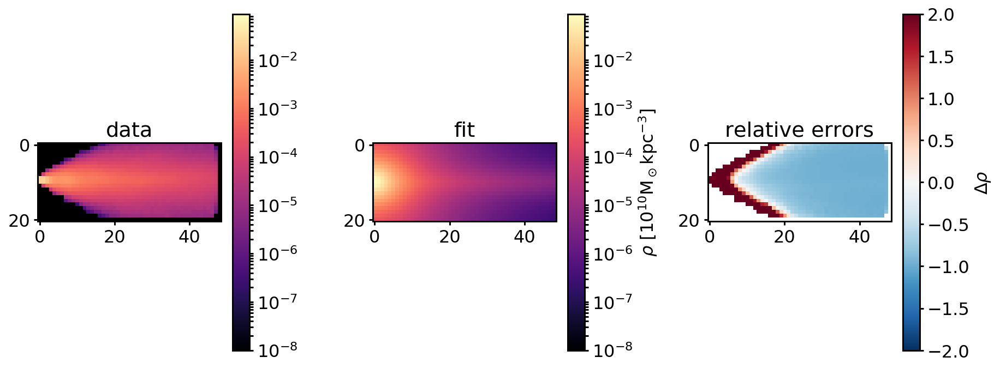

(21, 49)
a and b: 10.0, 0.1
Rho mean galpy: 0.00037556752626597464
Rho mean data: 0.00033879189738258395
57.3039521717 117.1251829752916
Circular velocity ar R=8kpc: 57.30395217168456 km/s and its error compared to the data: -0.5107461033057832 km/s
Multiply rho error with 0.26086158204204174
Error: 2.2676936253328096e+17
Error multiplied by vcirc error: 5.915541466909698e+16
data max: 0.019812705986395618, fit max: 0.020291745968398084, chosen max: 0.020291745968398084


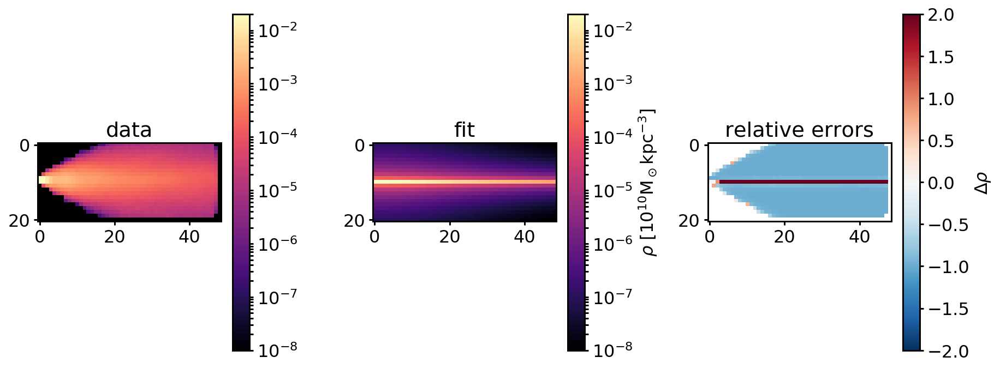

(21, 49)
a and b: 10.00000001, 0.1
Rho mean galpy: 0.00037556752583329237
Rho mean data: 0.00033879189738258395
57.3039521194 117.1251829752916
Circular velocity ar R=8kpc: 57.30395211938922 km/s and its error compared to the data: -0.5107461037522741 km/s
Multiply rho error with 0.2608615824981288
Error: 2.2676936243224717e+17
Error multiplied by vcirc error: 5.915541474616771e+16
data max: 0.019812705986395618, fit max: 0.02029174592784097, chosen max: 0.02029174592784097


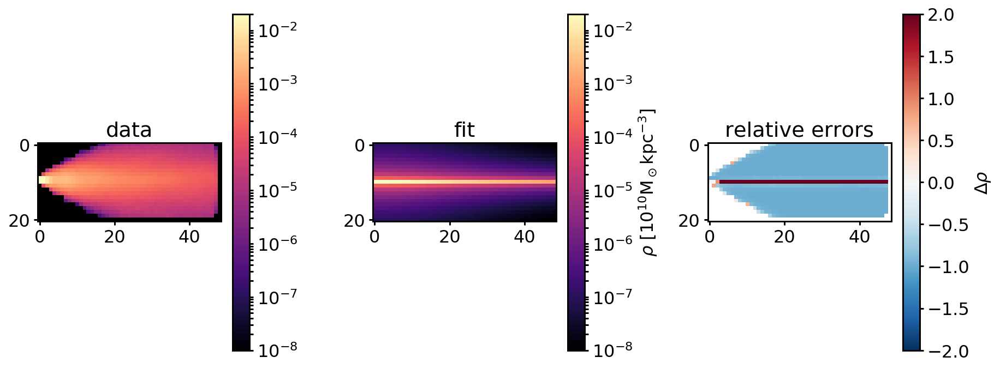

(21, 49)
a and b: 10.0, 0.10000001
Rho mean galpy: 0.00037556749064197225
Rho mean data: 0.00033879189738258395
57.3039521194 117.1251829752916
Circular velocity ar R=8kpc: 57.30395211938922 km/s and its error compared to the data: -0.5107461037522741 km/s
Multiply rho error with 0.2608615824981288
Error: 2.2676927159928365e+17
Error multiplied by vcirc error: 5.91553910513371e+16
data max: 0.019812705986395618, fit max: 0.020291743938204907, chosen max: 0.020291743938204907


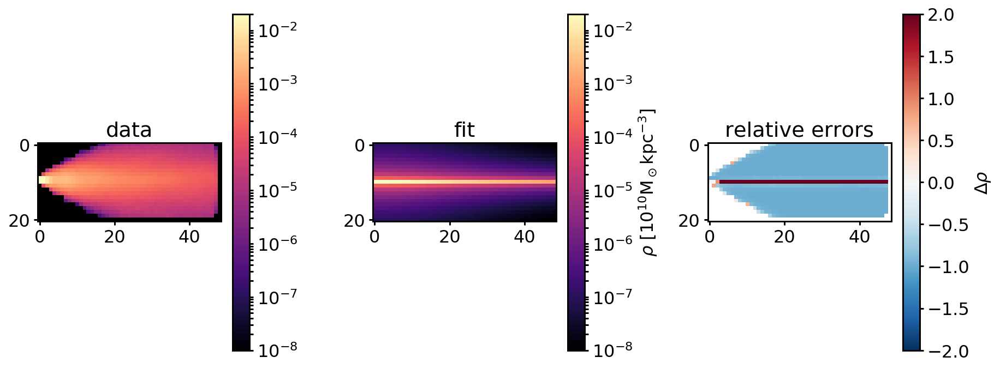

(21, 49)
a and b: 3.5780917687213103, 1.035705630870876
Rho mean galpy: 0.0004014016775972123
Rho mean data: 0.00033879189738258395
94.4327530894 117.1251829752916
Circular velocity ar R=8kpc: 94.43275308943358 km/s and its error compared to the data: -0.1937450965659977 km/s
Multiply rho error with 0.03753716244336777
Error: 136656631963045.28
Error multiplied by vcirc error: 5129702192960.355
data max: 0.019812705986395618, fit max: 0.013315432330839585, chosen max: 0.019812705986395618


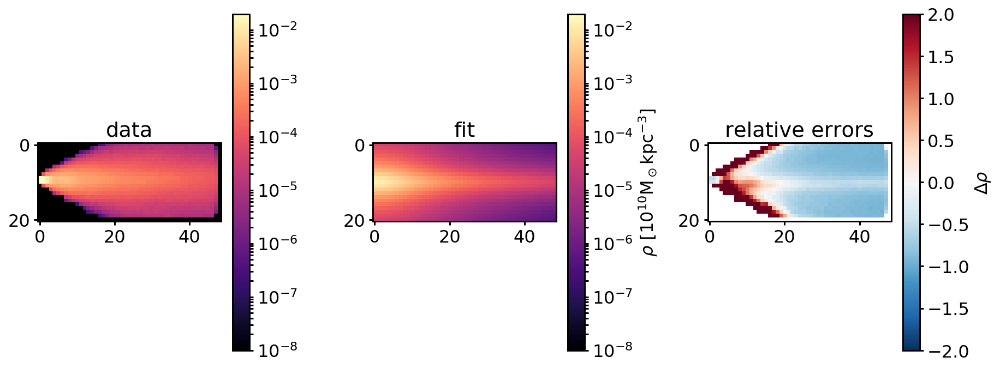

(21, 49)
a and b: 3.5780917787213102, 1.035705630870876
Rho mean galpy: 0.00040140167656802834
Rho mean data: 0.00033879189738258395
94.4327530128 117.1251829752916
Circular velocity ar R=8kpc: 94.43275301280534 km/s and its error compared to the data: -0.19374509722023991 km/s
Multiply rho error with 0.03753716269688022
Error: 136656631696519.77
Error multiplied by vcirc error: 5129702217599.9
data max: 0.019812705986395618, fit max: 0.013315432264316215, chosen max: 0.019812705986395618


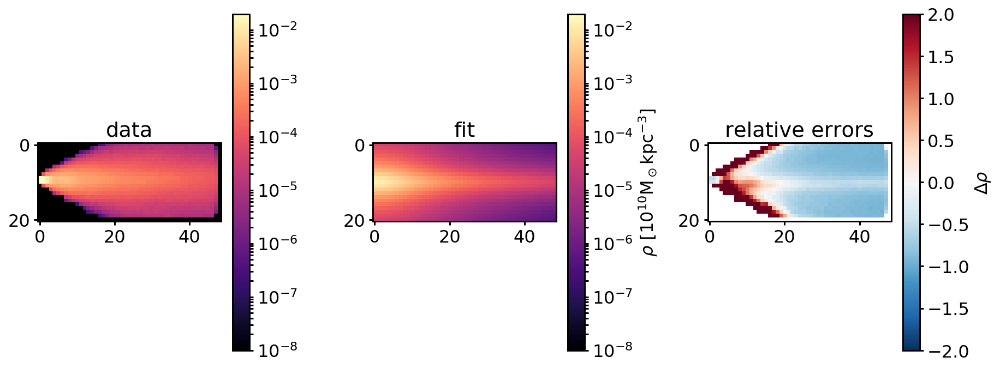

(21, 49)
a and b: 3.5780917687213103, 1.035705640870876
Rho mean galpy: 0.0004014016769981586
Rho mean data: 0.00033879189738258395
94.4327530128 117.1251829752916
Circular velocity ar R=8kpc: 94.43275301280534 km/s and its error compared to the data: -0.19374509722023991 km/s
Multiply rho error with 0.03753716269688022
Error: 136656629751592.53
Error multiplied by vcirc error: 5129702144592.851
data max: 0.019812705986395618, fit max: 0.013315432175541186, chosen max: 0.019812705986395618


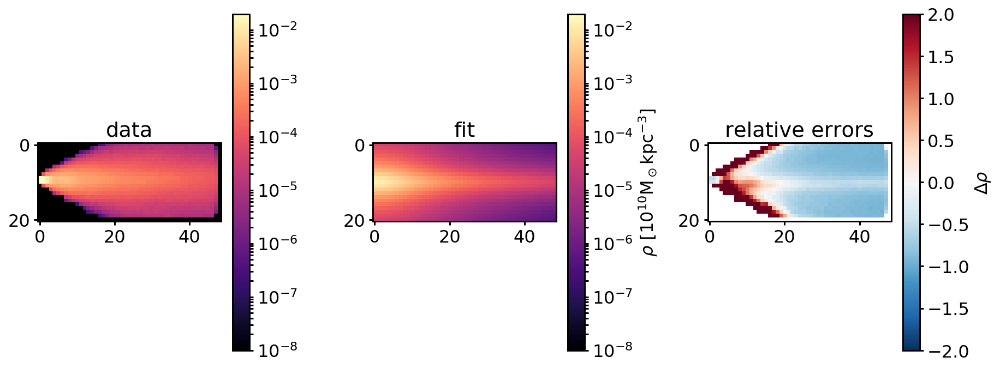

(21, 49)
a and b: 0.47057344767487613, 1.4884873098234248
Rho mean galpy: 0.0012362737111131549
Rho mean data: 0.00033879189738258395
112.119428359 117.1251829752916
Circular velocity ar R=8kpc: 112.11942835890474 km/s and its error compared to the data: -0.042738499861663844 km/s
Multiply rho error with 0.0018265793704254404
Error: 377625765581036.4
Error multiplied by vcirc error: 689763433151.4343
data max: 0.019812705986395618, fit max: 0.08821858878734758, chosen max: 0.08821858878734758


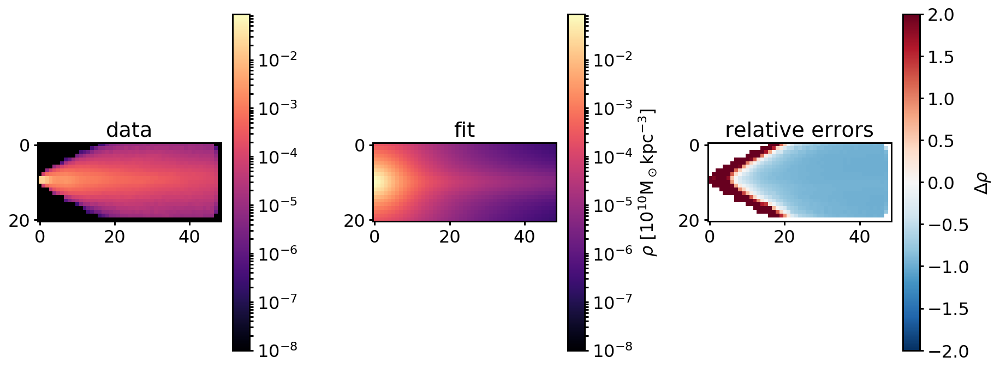

(21, 49)
a and b: 0.4705734576748761, 1.4884873098234248
Rho mean galpy: 0.0012362737027820116
Rho mean data: 0.00033879189738258395
112.11942831 117.1251829752916
Circular velocity ar R=8kpc: 112.11942831033707 km/s and its error compared to the data: -0.04273850027632847 km/s
Multiply rho error with 0.001826579405869729
Error: 377625758342396.25
Error multiplied by vcirc error: 689763433314.16
data max: 0.019812705986395618, fit max: 0.08821858762969252, chosen max: 0.08821858762969252


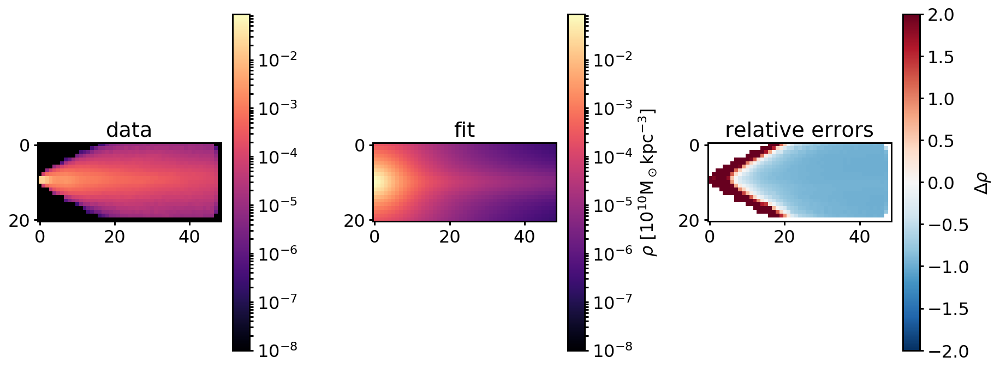

(21, 49)
a and b: 0.47057344767487613, 1.4884873198234247
Rho mean galpy: 0.0012362737046935916
Rho mean data: 0.00033879189738258395
112.11942831 117.1251829752916
Circular velocity ar R=8kpc: 112.11942831033707 km/s and its error compared to the data: -0.04273850027632847 km/s
Multiply rho error with 0.001826579405869729
Error: 377625758268442.75
Error multiplied by vcirc error: 689763433179.078
data max: 0.019812705986395618, fit max: 0.08821858739312917, chosen max: 0.08821858739312917


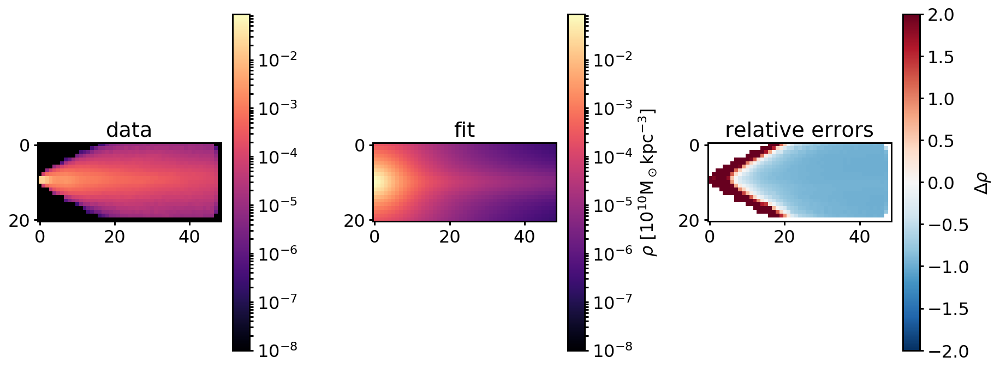

(21, 49)
a and b: 0.46153223541471955, 1.4898046617563787
Rho mean galpy: 0.001242993343108199
Rho mean data: 0.00033879189738258395
112.156882012 117.1251829752916
Circular velocity ar R=8kpc: 112.15688201191524 km/s and its error compared to the data: -0.04241872530883858 km/s
Multiply rho error with 0.0017993482568267024
Error: 383300604844541.9
Error multiplied by vcirc error: 689691275167.6471
data max: 0.019812705986395618, fit max: 0.08908781552869474, chosen max: 0.08908781552869474


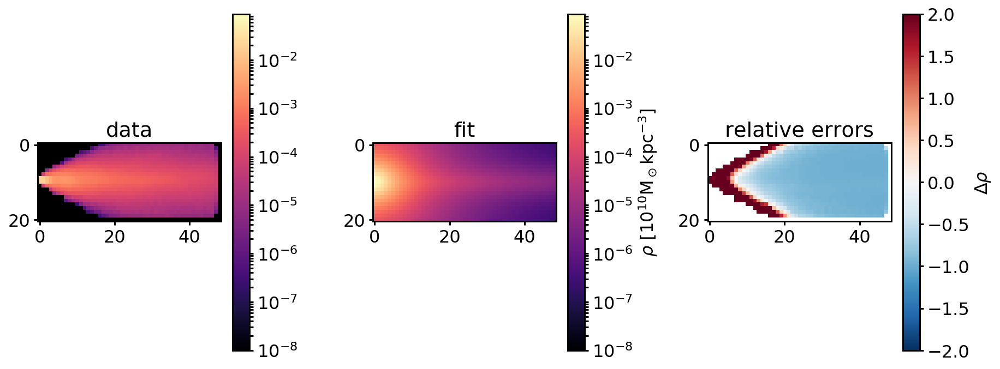

(21, 49)
a and b: 0.46153224541471954, 1.4898046617563787
Rho mean galpy: 0.0012429933346938251
Rho mean data: 0.00033879189738258395
112.156881964 117.1251829752916
Circular velocity ar R=8kpc: 112.15688196350132 km/s and its error compared to the data: -0.042418725722190534 km/s
Multiply rho error with 0.0017993482918944289
Error: 383300597378304.8
Error multiplied by vcirc error: 689691275174.767
data max: 0.019812705986395618, fit max: 0.08908781435460296, chosen max: 0.08908781435460296


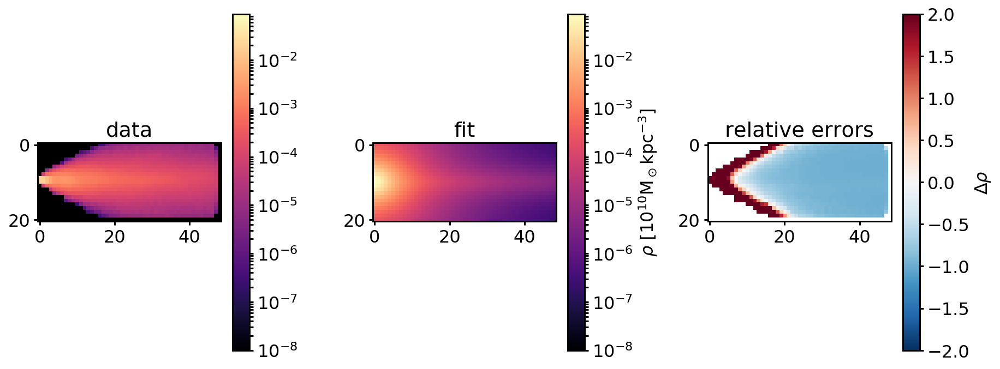

(21, 49)
a and b: 0.46153223541471955, 1.4898046717563787
Rho mean galpy: 0.0012429933366188454
Rho mean data: 0.00033879189738258395
112.156881964 117.1251829752916
Circular velocity ar R=8kpc: 112.15688196350132 km/s and its error compared to the data: -0.042418725722190534 km/s
Multiply rho error with 0.0017993482918944289
Error: 383300597401498.1
Error multiplied by vcirc error: 689691275216.4998
data max: 0.019812705986395618, fit max: 0.08908781411660238, chosen max: 0.08908781411660238


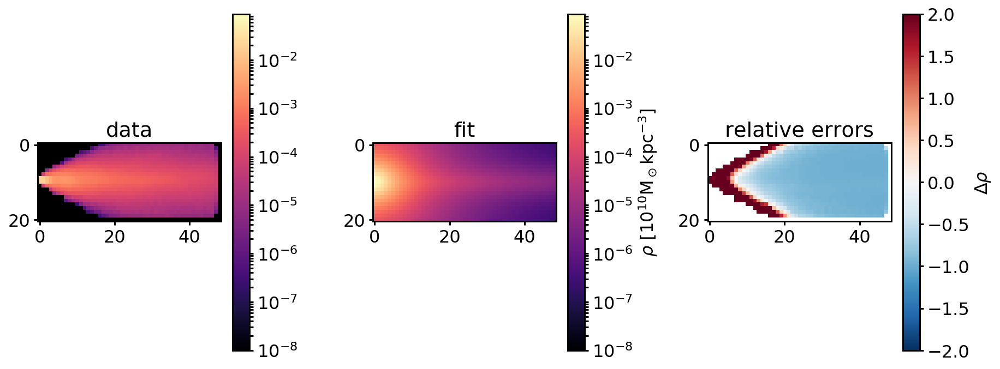

(21, 49)
a and b: 0.4611622692727805, 1.487046378758106
Rho mean galpy: 0.0012450979274013754
Rho mean data: 0.00033879189738258395
112.172017338 117.1251829752916
Circular velocity ar R=8kpc: 112.17201733784566 km/s and its error compared to the data: -0.04228950181013455 km/s
Multiply rho error with 0.0017884019633493734
Error: 385641224214162.6
Error multiplied by vcirc error: 689681522533.0643
data max: 0.019812705986395618, fit max: 0.08952215282909881, chosen max: 0.08952215282909881


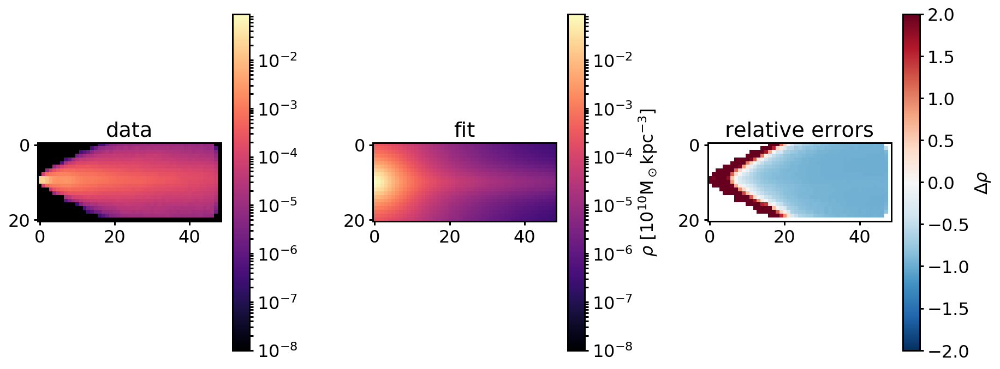

(21, 49)
a and b: 0.4611622792727805, 1.487046378758106
Rho mean galpy: 0.0012450979189590817
Rho mean data: 0.00033879189738258395
112.172017289 117.1251829752916
Circular velocity ar R=8kpc: 112.17201728949414 km/s and its error compared to the data: -0.042289502222953745 km/s
Multiply rho error with 0.0017884019982652099
Error: 385641216686827.3
Error multiplied by vcirc error: 689681522536.1488
data max: 0.019812705986395618, fit max: 0.08952215164746313, chosen max: 0.08952215164746313


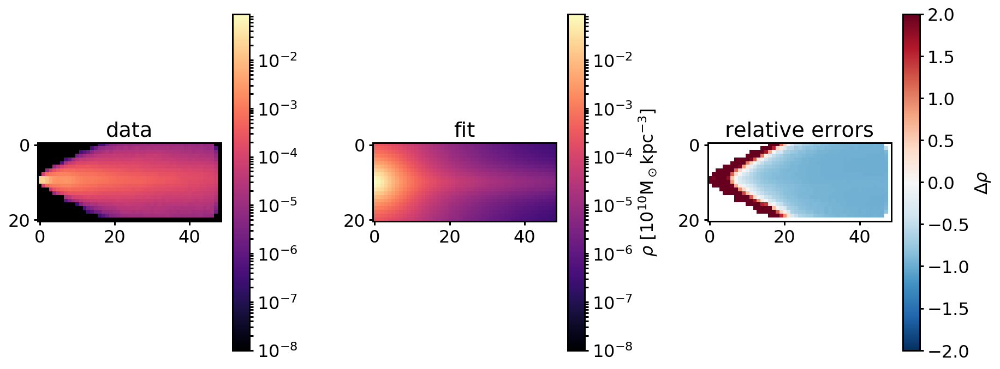

(21, 49)
a and b: 0.4611622692727805, 1.487046388758106
Rho mean galpy: 0.0012450979208915758
Rho mean data: 0.00033879189738258395
112.172017289 117.1251829752916
Circular velocity ar R=8kpc: 112.17201728949414 km/s and its error compared to the data: -0.042289502222953745 km/s
Multiply rho error with 0.0017884019982652099
Error: 385641216696553.75
Error multiplied by vcirc error: 689681522553.5436
data max: 0.019812705986395618, fit max: 0.08952215140781832, chosen max: 0.08952215140781832


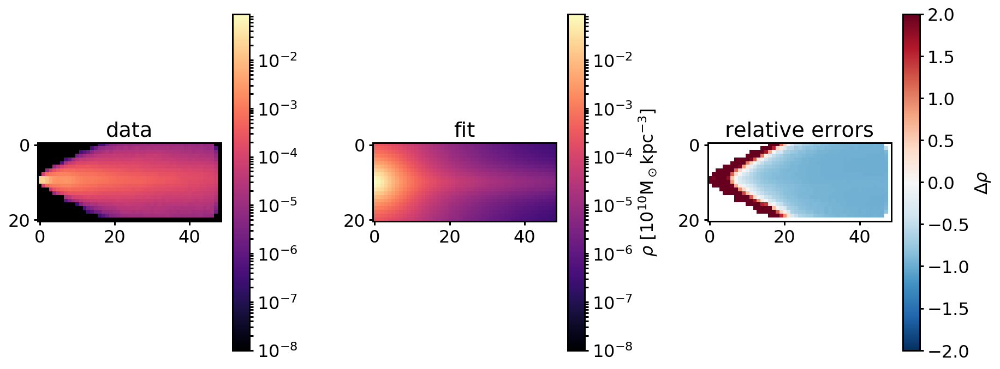

(21, 49)
a and b: 0.46088544817180704, 1.4850546681379038
Rho mean galpy: 0.0012466299572349503
Rho mean data: 0.00033879189738258395
112.182980901 117.1251829752916
Circular velocity ar R=8kpc: 112.18298090122614 km/s and its error compared to the data: -0.042195896292499646 km/s
Multiply rho error with 0.0017804936639273855
Error: 387352932569977.5
Error multiplied by vcirc error: 689679442144.5367
data max: 0.019812705986395618, fit max: 0.08983868415027493, chosen max: 0.08983868415027493


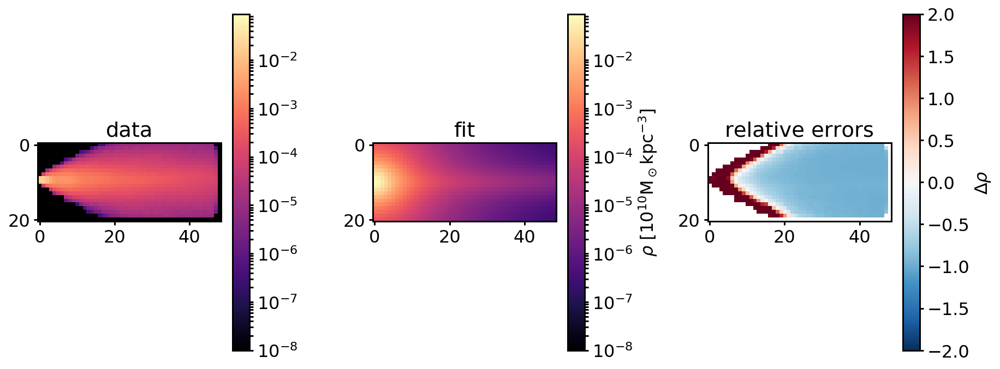

(21, 49)
a and b: 0.46088545817180704, 1.4850546681379038
Rho mean galpy: 0.0012466299487723074
Rho mean data: 0.00033879189738258395
112.182980853 117.1251829752916
Circular velocity ar R=8kpc: 112.18298085291988 km/s and its error compared to the data: -0.0421958967049324 km/s
Multiply rho error with 0.001780493698733325
Error: 387352924997860.06
Error multiplied by vcirc error: 689679442144.612
data max: 0.019812705986395618, fit max: 0.08983868296313283, chosen max: 0.08983868296313283


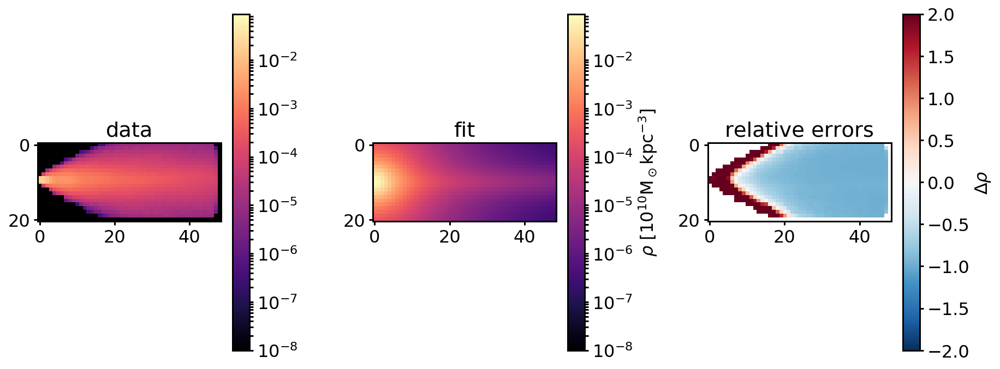

(21, 49)
a and b: 0.46088544817180704, 1.4850546781379037
Rho mean galpy: 0.0012466299507102392
Rho mean data: 0.00033879189738258395
112.182980853 117.1251829752916
Circular velocity ar R=8kpc: 112.18298085291988 km/s and its error compared to the data: -0.0421958967049324 km/s
Multiply rho error with 0.001780493698733325
Error: 387352924997799.4
Error multiplied by vcirc error: 689679442144.504
data max: 0.019812705986395618, fit max: 0.0898386827222895, chosen max: 0.0898386827222895


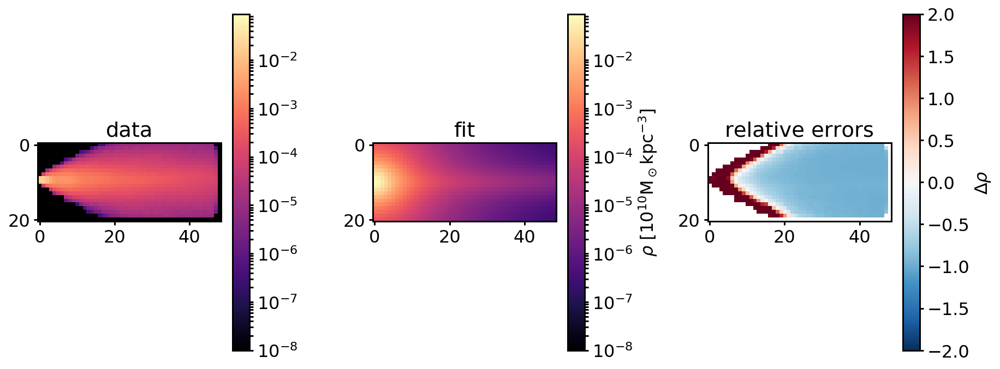

(21, 49)
a and b: 0.4608813208862526, 1.4850574337778524
Rho mean galpy: 0.0012466316455106029
Rho mean data: 0.00033879189738258395
112.182987479 117.1251829752916
Circular velocity ar R=8kpc: 112.18298747882358 km/s and its error compared to the data: -0.042195840133804605 km/s
Multiply rho error with 0.0017804889245975953
Error: 387353963620154.8
Error multiplied by vcirc error: 689679442124.6655
data max: 0.019812705986395618, fit max: 0.08983877918859995, chosen max: 0.08983877918859995


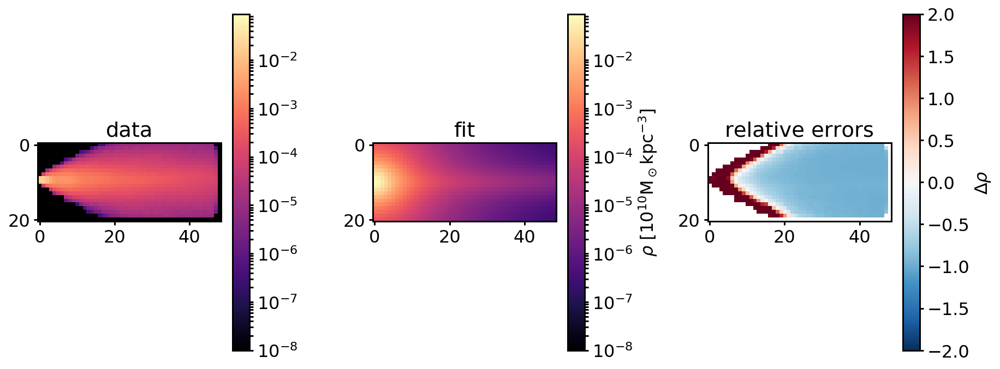

(21, 49)
a and b: 0.4608813308862526, 1.4850574337778524
Rho mean galpy: 0.0012466316370479402
Rho mean data: 0.00033879189738258395
112.182987431 117.1251829752916
Circular velocity ar R=8kpc: 112.18298743051734 km/s and its error compared to the data: -0.042195840546237116 km/s
Multiply rho error with 0.0017804889594034681
Error: 387353956047969.6
Error multiplied by vcirc error: 689679442124.6661
data max: 0.019812705986395618, fit max: 0.08983877800145554, chosen max: 0.08983877800145554


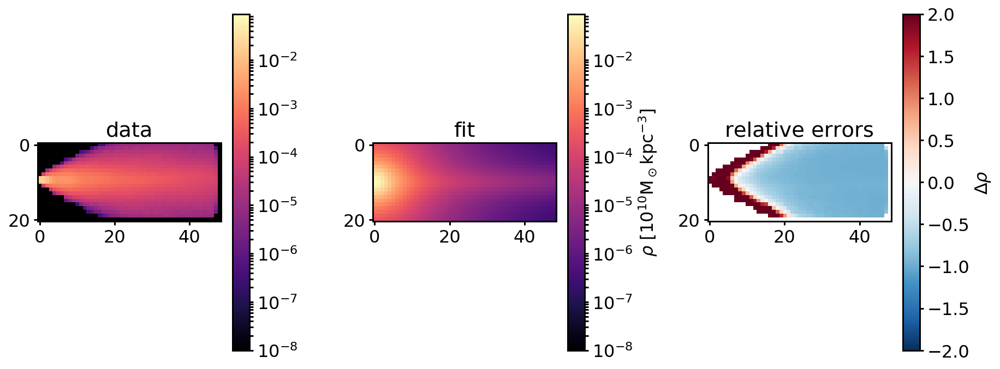

(21, 49)
a and b: 0.4608813208862526, 1.4850574437778523
Rho mean galpy: 0.001246631638985873
Rho mean data: 0.00033879189738258395
112.182987431 117.1251829752916
Circular velocity ar R=8kpc: 112.18298743051734 km/s and its error compared to the data: -0.042195840546237116 km/s
Multiply rho error with 0.0017804889594034681
Error: 387353956047969.0
Error multiplied by vcirc error: 689679442124.665
data max: 0.019812705986395618, fit max: 0.08983877776061279, chosen max: 0.08983877776061279


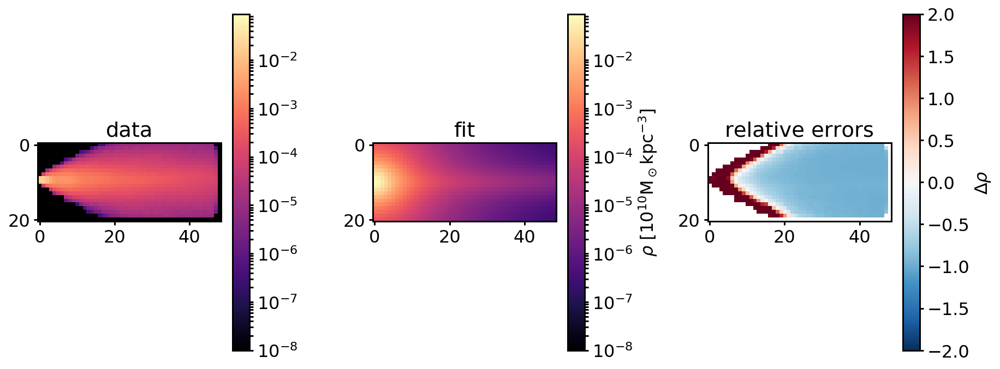

     fun: 689679442124.66553
     jac: array([ 61035.15625, -48828.125  ])
 message: 'Optimization terminated successfully.'
    nfev: 354
     nit: 10
 success: True
       x: array([ 0.46088132,  1.48505743])


In [286]:

args = (R_kpc_disk, z_kpc_disk, M_disk_10Msun, dR_kpc, dz_kpc, 8.) 
bounds = ((0.1, 10.), (0.1,5.))

res = opt.differential_evolution( rel_rho_error_scipydifferentialevolution, bounds=bounds, args=args,strategy='best1bin', maxiter=1000,tol=0.01,atol=1e-7, disp=True)

print(res)

In [287]:
res

     fun: 689679442124.66553
     jac: array([ 61035.15625, -48828.125  ])
 message: 'Optimization terminated successfully.'
    nfev: 354
     nit: 10
 success: True
       x: array([ 0.46088132,  1.48505743])

In [41]:
### fit disk

# try to integrate numerically for poisson process
# take eq 2.69b (w/o mass) B&T08
# if that does not work fit to binned densities


def rho_MND(R_kpc, z_kpc, phi, a_kpc = 5., b_kpc = 1., specific = True, mass_10Msun = None):
    """
    INPUT:
        R_kpc, z_kpc: 
    """
    #a_kpc = args[0]
    #b_kpc = args[1]
    if specific == True:
        first_fac_kpc2 = b_kpc**2 / (4. * np.pi)
    else:
        first_fac_kpc2 = (mass_10Msun * b_kpc**2) / (4. * np.pi) # * 10^10M_sun
    bzsqrt_kpc = np.sqrt(z_kpc**2 + b_kpc**2)
    abz_sqrt_kpc = (a_kpc + bzsqrt_kpc)
    numerator_kpc3 = a_kpc * R_kpc**2 + (a_kpc + 3. * bzsqrt_kpc) * abz_sqrt_kpc**2
    denominator_kpc8 = (R_kpc**2 + abz_sqrt_kpc**2)**(5./2.) * bzsqrt_kpc**3
    rho_kpc_3 = first_fac_kpc2 * numerator_kpc3 / denominator_kpc8 # * 10^10 M_sun if not specific density
    return (rho_kpc_3)



## PART FOR THE FIT TO THE DENSITY
def disk_dens(R_kpc, z_kpc, dR_kpc, dz_kpc, M_10Msun): 
    
    Rmin_kpc, Rmax_kpc = np.min(R_kpc), np.max(R_kpc)
    zmin_kpc, zmax_kpc = np.min(z_kpc), np.max(z_kpc)
    
    Rbins, zbins = np.arange(Rmin_kpc, Rmax_kpc, dR_kpc), np.arange(zmin_kpc, zmax_kpc, dz_kpc)
    mbins, volbins = np.zeros((len(zbins), len(Rbins))), np.zeros((len(zbins), len(Rbins))) 
    for i in range(len(zbins)):
        for j in range(len(Rbins)):
            inbin = (Rbins[j] <= R_kpc) & (R_kpc < (Rbins[j] + dR_kpc)) & (zbins[i] <= z_kpc) & (z_kpc < (zbins[i] + dz_kpc))
            mbins[i,j] = np.sum(M_10Msun[inbin])
            volbins[i,j] = np.pi * dz_kpc * (2. * Rbins[j] * dR_kpc + dR_kpc**2)
       
    rho = mbins / volbins
    return(rho, Rbins, zbins)    

def MNdens(x, a_kpc, b_kpc):
    '''
    INPUT: 
        x: R_kpc, z_kpc, Mass_tot
    '''
    R_kpc, z_kpc, mass_10Msun = x[0], x[1], x[2]
    first_fac_kpc2 = (mass_10Msun * b_kpc**2) / (4. * np.pi) # * 10^10M_sun
    bzsqrt_kpc = np.sqrt(z_kpc**2 + b_kpc**2)
    abz_sqrt_kpc = (a_kpc + bzsqrt_kpc)
    numerator_kpc3 = a_kpc * R_kpc**2 + (a_kpc + 3. * bzsqrt_kpc) * abz_sqrt_kpc**2
    denominator_kpc8 = (R_kpc**2 + abz_sqrt_kpc**2)**(5./2.) * bzsqrt_kpc**3
    rho_kpc_3 = first_fac_kpc2 * numerator_kpc3 / denominator_kpc8 # * 10^10 M_sun if not specific density
    print(np.log(rho_kpc_3))
    return(np.log(rho_kpc_3))


def fit_dens_MND(R_kpc, z_kpc, dR_kpc, dz_kpc, M_tot_disk_stars_10Msun, M_diskstars_10Msun, snapnr):
    rho_data, R_data, z_data = disk_dens(R_kpc, z_kpc, dR_kpc, dz_kpc, M_diskstars_10Msun)
    
    side_x = R_data
    side_y = z_data
    X1, X2 = np.meshgrid(side_x, side_y)
    size = X1.shape
    x1_1d = X1.reshape((1, np.prod(size)))
    x2_1d = X2.reshape((1, np.prod(size)))
    size2 = x1_1d.shape
    x3_1d = np.repeat(M_tot_disk_stars_10Msun, size2[1])
    x3_1d = x3_1d.reshape((size2))
    xdata = np.vstack((x1_1d, x2_1d, x3_1d))
    z = rho_data
    Z = z.reshape(size2[1])
    ydata = Z
    bounds = (0, np.inf)
    
    
    popt, pcov = opt.curve_fit(MNdens, xdata, ydata, bounds = bounds)
    z_fit = MNdens(xdata, *popt)
    Z_fit = z_fit.reshape(size)
    
    z_fit_max = np.abs(Z_fit).max()
    z_max = np.abs(z).max()
    
    if z_max > z_fit_max:
        zmax = z_max
    else:
        zmax = z_fit_max
    zmin = 1e-8


    fig, axes = plt.subplots(1,3, figsize = (13,5), sharey= True)
    axes[0].set_title("data")
    im0 = axes[0].pcolormesh(X1, X2, z, vmin = zmin, vmax = zmax, norm=LogNorm(), cmap=cmap)
    axes[0].axis('equal')
    #cbar0 = plt.colorbar(im0, ax= axes[0])
    axes[0].set_ylabel('z [kpc]')
    axes[0].set_xlabel('R [kpc]')
    

    axes[1].set_title("fit")
    im1 = axes[1].pcolormesh(X1, X2, Z_fit, vmin = zmin, vmax = zmax, norm=LogNorm(), cmap=cmap)
    axes[1].axis('equal')
    cbar1 = plt.colorbar(im1, ax = axes[1])
    cbar1.set_label('$\\rho\ [10^{10} \mathrm{M}_\odot \mathrm{kpc}^{-3}]$')
    axes[1].set_xlabel('R [kpc]')
    
    axes[2].set_title("relative errors")

    z_rel = np.where((z == 0), np.nan, ((Z_fit - z) / z))
    relmax = np.max([np.min(z_rel[np.isfinite(z_rel)]), np.max(z_rel[np.isfinite(z_rel)])])
    relmin = -relmax
    
    im2 = axes[2].pcolormesh(X1, X2, z_rel, vmin = -2, vmax = 2, cmap=plt.cm.RdBu_r)
    im2.cmap.set_under('black')
    axes[2].axis('equal')
    cbar2 = plt.colorbar(im2, ax = axes[2])
    cbar2.set_label('$\Delta_\\rho$')
    axes[2].set_xlabel('R [kpc]')
    
    fig.tight_layout()
    #fig.savefig(plotdir + '/potential/MND_best_fit_snap_{}.png'.format(snapnr), format = 'png', dpi = 300, bbox_inches = 'tight')
    plt.show()
    return(popt)
    
    
def v_circ_MND_func(R_kpc_data, z_kpc_data, M_tot_10Msun, R0_kpc, z0_kpc = 0.):
    a_MND_kpc, b_MND_kpc = fit_MND(R_kpc_data, z_kpc_data, _REFR0_kpc = R0_kpc)
    denom = (R0_kpc**2 + (a_MND_kpc + np.sqrt(z0_kpc**2 + b_MND_kpc**2))**2)**(3./2.)
    v_circ = R0_kpc * np.sqrt(43.01e3* M_tot_10Msun / denom)
    return(a_MND_kpc, b_MND_kpc, v_circ)

def v_circ_MND_ab(R_kpc, z_kpc, a_MND_kpc, b_MND_kpc, M_tot_10Msun):
    denom = (R_kpc**2 + (a_MND_kpc + np.sqrt(z_kpc**2 + b_MND_kpc**2))**2)**(3./2.)
    v_circ = R_kpc * np.sqrt(43.01e3* M_tot_10Msun / denom)
    return(v_circ)

def v_circ_MND_dens_func(R_kpc, z_kpc, dR_kpc, dz_kpc, M_tot_disk_stars_10Msun, M_diskstars_10Msun, R0_kpc, z0_kpc, snapnr):
    a_MND_kpc, b_MND_kpc = fit_dens_MND(R_kpc, z_kpc, dR_kpc, dz_kpc, M_tot_disk_stars_10Msun, M_diskstars_10Msun, snapnr)
    denom = (R0_kpc**2 + (a_MND_kpc + np.sqrt(z0_kpc**2 + b_MND_kpc**2))**2)**(3./2.)
    v_circ = R0_kpc * np.sqrt(43.01e3* M_tot_disk_stars_10Msun / denom)
    return(a_MND_kpc, b_MND_kpc, v_circ)

def MND(R_kpc, z_kpc, dR_kpc, dz_kpc, M_tot_disk_stars_10Msun, M_diskstars_10Msun, R0_kpc, snapnr, z0_kpc = 0.):
    print('Start MND fit at', datetime.datetime.now().time())
    a_MND_kpc, b_MND_kpc, v_circ = v_circ_MND_dens_func(R_kpc, z_kpc, dR_kpc, dz_kpc, M_tot_disk_stars_10Msun, M_diskstars_10Msun, R0_kpc, z0_kpc = 0., snapnr = snapnr)
    print('MND: a[kpc], b[kpc], vcirc [km/s]:', a_MND_kpc, b_MND_kpc, v_circ)
    return(a_MND_kpc, b_MND_kpc, v_circ)

In [15]:
### fit bulge

def rho_data(M_stars_10Msun, r_kpc, dr_kpc, log = True):
    x = r_kpc
    y = M_stars_10Msun
    
    n_bins = int(np.max(r_kpc)/dr_kpc)
    log_bins_for_x = np.logspace(np.log10(np.min(x)), np.log10(np.max(x)), num=n_bins)
    bin_centers,  bin_edges, _ = stats.binned_statistic(x, x, statistic = 'mean', bins = log_bins_for_x)
    bin_averages, _, _ = stats.binned_statistic(x, y, statistic = 'mean', bins = log_bins_for_x)
    bin_stdevs,   _, _ = stats.binned_statistic(x, y, statistic = 'std',  bins = log_bins_for_x)
    bin_sums,     _, _ = stats.binned_statistic(x, y, statistic = 'sum',  bins = log_bins_for_x)
    
    bin_mass_std = bin_sums*bin_stdevs/bin_averages

    
    '''
    rmin_kpc, rmax_kpc = np.min(r_kpc), np.max(r_kpc)

    rbins_kpc = np.arange(rmin_kpc, rmax_kpc, dr_kpc)
    rbins_log_kpc = np.logspace(np.log10(rmin_kpc), np.log10(rmax_kpc), 97)
    mbins_10Msun = np.zeros(len(rbins_kpc))
    volbins_kpc3 = np.zeros(len(rbins_kpc))
    if log == False:
        for i in range(len(rbins_kpc)):
            inbin = (rbins_kpc[i] <= r_kpc) & (r_kpc < (rbins_kpc[i] + dr_kpc)) # spherical shells
            mbins_10Msun[i] = np.sum(M_stars_10Msun[inbin])
            volbins_kpc3[i] = 4./3. * np.pi * dr_kpc * (3. * rbins_kpc[i]**2 + 3. * rbins_kpc[i] * dr_kpc + dr_kpc**2)
    elif log == True:
        mbins_10Msun = np.zeros(len(rbins_log_kpc))
        volbins_kpc3 = np.zeros(len(rbins_log_kpc))
        dr_log_kpc = np.log(rbins_log_kpc[1]/rbins_log_kpc[0])
        for i in range(len(rbins_log_kpc)):
            inbin = (rbins_log_kpc[i] <= r_kpc) & (r_kpc < (rbins_log_kpc[i] + dr_log_kpc)) # spherical shells
            mbins_10Msun[i] = np.sum(M_stars_10Msun[inbin])
            volbins_kpc3[i] = 4./3. * np.pi * dr_log_kpc * (3. * rbins_log_kpc[i]**2 + 3. * rbins_log_kpc[i] * dr_log_kpc + dr_log_kpc**2)
    '''
    
    Mbins_10Msun = bin_sums
    volbins_kpc3 = 4./3. * np.pi * (bin_edges[1:]**3-bin_edges[:-1]**3)
    
    
    rho_10Msun_kpc3 = Mbins_10Msun / volbins_kpc3
    rho_std_10Msun_kpc3 = bin_mass_std / volbins_kpc3
    return(bin_centers, rho_10Msun_kpc3, rho_std_10Msun_kpc3)

'''
def HB(v0_kms, a_HB_kpc, r_kpc, z_kpc, _REFR0_kpc, normalize = True):
    HB = HernquistPotential(a_HB_kpc, normalize=normalize)
    rho_model_galpy = evaluateDensities(HB, r_kpc, z_kpc) 
    rho_model_10Msun_kpc3 = rho_model_galpy * bovy_conversion.dens_in_msolpc3(v0_kms, _REFR0_kpc) * 10.
    return(rho_model_10Msun_kpc3)
'''


def Hernquistdens(r_kpc, a_HB_kpc, amp_10Msun):
    rho_10Msun_kpc3 = amp_10Msun / (4. * np.pi * a_HB_kpc**3.) * (1. / ((r_kpc / a_HB_kpc) * (1. + r_kpc / a_HB_kpc)**3))
    return(np.log(rho_10Msun_kpc3))
    
def fit_HB(M_stars_10Msun, r_kpc, dr_kpc, snapnr):
    bin_centers, rho_data_10Msun_kpc3, rho_std_10Msun_kpc3 = rho_data(M_stars_10Msun, r_kpc, dr_kpc)
    rbins_kpc = bin_centers
    #print(rbins_kpc)
    rho_data_10Msun_kpc3 = np.log(rho_data_10Msun_kpc3)
    
    fig, ax = plt.subplots()
    ax.errorbar(rbins_kpc, rho_data_10Msun_kpc3, yerr =rho_std_10Msun_kpc3, fmt='', marker = 'o', color = 'grey', label = 'data')
    ax.set_xlabel('r [kpc]')
    ax.set_ylabel('log$_{10}$($\\rho$) [$10^{10}\mathrm{M}_\odot \mathrm{kpc}^{-3}$]')
    #print(rho_data_10Msun_kpc3, rbins_kpc)
    #print(rho_data_10Msun_kpc3)
    rho_data_10Msun_kpc3 = np.where(np.isinf(rho_data_10Msun_kpc3), rho_data_10Msun_kpc3[-2] ,rho_data_10Msun_kpc3)
    #print(rho_data_10Msun_kpc3)
    bounds = (0, np.inf)
    popt, pcov = opt.curve_fit(Hernquistdens, rbins_kpc, rho_data_10Msun_kpc3, bounds = bounds)
    a_HB_kpc = popt[0]
    ax.plot(rbins_kpc, Hernquistdens(rbins_kpc, popt[0], popt[1]),'g-', label = 'fit')
    ax.legend()
    fig.savefig(plotdir + 'potential/spheroid_density_fit_snap_{}.png'.format(snapnr))
    plt.show()
    return(a_HB_kpc)

def v_circ_HB_func(M_stars_10Msun, r_kpc, dr_kpc, r0_kpc, snapnr):
    a_HB_kpc = fit_HB(M_stars_10Msun, r_kpc, dr_kpc, snapnr)
    M_tot_10Msun = np.sum(M_stars_10Msun)
    vcirc = np.sqrt(43.01e3* M_tot_10Msun * r0_kpc)/ (r0_kpc + a_HB_kpc)
    #vcirc = np.sqrt(43.01e3 * M_enc / r_kpc)
    return(a_HB_kpc, vcirc)

def v_circ_HB_func_justr(r_kpc, a_HB_kpc, M_tot_10Msun):
    vcirc = np.sqrt(43.01e3* M_tot_10Msun * r_kpc)/ (r_kpc + a_HB_kpc)
    return(vcirc)
    
def v_circ_HB_a(r_kpc_spher, M_spher_10Msun):#, a_HB_kpc, M_stars_10Msun):
    """
    INPUT:
    """
    #M_tot_10Msun = np.sum(M_stars_10Msun)
    #vcirc = np.sqrt(43.01e3* M_tot_10Msun * r_kpc)/ (r_kpc + a_HB_kpc)

    r_kpc = np.linspace(np.min(r_kpc_spher), np.max(r_kpc_spher), 25)
    v_circ_shell = np.zeros(len(r_kpc))
    for i, item in enumerate(r_kpc):
        mass_mask = np.where((r_kpc_spher<=item))
        mass_10Msun  = np.sum(M_spher_10Msun[mass_mask])
        v_circ_shell[i] = np.sqrt(43.01e3 * mass_10Msun / item)
    return(v_circ_shell)

def HB(M_stars_10Msun, r_kpc, dr_kpc, r0_kpc, snapnr):
    print('Start HB fit at', datetime.datetime.now().time())
    a_HB_kpc, vcirc = v_circ_HB_func(M_stars_10Msun, r_kpc, dr_kpc, r0_kpc, snapnr)
    print('HB: a[kpc], vcirc [km/s]:', a_HB_kpc, vcirc)
    return(a_HB_kpc, vcirc)

def HB2(r_kpc_spher, M_spher_10Msun):
    vcirc = v_circ_HB_a(r_kpc_spher, M_spher_10Msun)
    return(vcirc)

$v_{circ_{tot}} = \sqrt{\frac{GM(<R_0)}{R_0}} $

$G = 43.01 \cdot 10^{3} \frac{kpc}{10^{10} M_\odot}\frac{km^2}{s^2}$

In [16]:
def v_circ_tot_func(r_kpc):
    try:
        test = len(r_kpc)
        types = ( s.type == 0) + (s.type == 1) + (s.type == 2) + (s.type == 3) + (s.type == 4)

        #mass_mask    = np.zeros(len(r_kpc))
        #mass_10Msun  = np.zeros(len(r_kpc))
        v_circ_shell = np.zeros(len(r_kpc))

        for i, item in enumerate(r_kpc):
            mass_mask    = np.where( (types) & (s.halo == 0) & ((1000. * s.r()) < (item)))
            mass_10Msun  = np.sum(s.mass[mass_mask])
            v_circ_shell[i] = np.sqrt(43.01e3 * mass_10Msun / item)

        v_circ =  v_circ_shell
    except:
        mass_10Msun = np.sum(s.mass[((1000. * s.r()) <= r_kpc) ] )
        v_circ = np.sqrt(43.01e3 * mass_10Msun / r_kpc)
        
    return(v_circ)

In [17]:
def circvel_data(R_circ_stars_kpc, v_phi_circ_stars, Galrad, N = 25):
    indisk = R_circ_stars_kpc < Galrad
    #R_circ_stars_kpc[i_r_circ_stars_in]
    v_mean_kms, R_bin_edges, binnum = stats.binned_statistic(R_circ_stars_kpc[indisk], np.abs(vphi_circ_stars_kms[indisk]), statistic = 'mean', bins = N)
    v_std_kms, R_bin_edges_std, binnum_std = stats.binned_statistic(R_circ_stars_kpc[indisk], np.abs(vphi_circ_stars_kms[indisk]), statistic = np.std, bins = N)
    R_bins_kpc = R_bin_edges[:-1] + 1./2. * (R_bin_edges[1:] - R_bin_edges[:-1])
    return(v_mean_kms, v_std_kms, R_bins_kpc)


In [18]:
### fit halo (variably)

def v_circ_NFW_func(r_kpc, v_circ_MND, v_circ_HB, v_circ_tot = None):
    try:
        if v_circ_tot == None:
            v_circ_tot = v_circ_tot_func(r_kpc)
    except ValueError:
        pass
        #continue

    v_circ_NFW = np.sqrt(v_circ_tot**2 - v_circ_MND**2 - v_circ_HB**2) #could be negative! then its nan vals
    return(v_circ_NFW)


In [19]:
#_____function that sets-up galpy potential_____
def setup_galpy_potential(a_MND_kpc, b_MND_kpc, a_NFWH_kpc, a_HB_kpc, n_MND, n_NFWH, n_HB, _REFR0_kpc):
    
    #test input:
    if (a_MND_kpc <= 0.) or (b_MND_kpc <= 0.) or (a_NFWH_kpc <= 0.) or (a_HB_kpc <= 0.) \
       or (n_MND <= 0.) or (n_NFWH <= 0.) or (n_HB <= 0.) or (n_MND >= 1.) or (n_NFWH >= 1.) or (n_HB >= 1.):
        raise ValueError('Error in setup_galpy_potential: '+\
                         'The input parameters for the scaling profiles do not correspond to a physical potential.')
    if np.fabs(n_MND + n_NFWH + n_HB - 1.) > 1e-7:
        raise ValueError('Error in setup_galpy_potential: '+\
                         'The sum of the normalization does not add up to 1.')
        
    #trafo to galpy units:
    a_MND  = a_MND_kpc  / _REFR0_kpc
    b_MND  = b_MND_kpc  / _REFR0_kpc
    a_NFWH = a_NFWH_kpc / _REFR0_kpc
    a_HB   = a_HB_kpc   / _REFR0_kpc
    
    #setup potential:
    disk = MiyamotoNagaiPotential(
                a = a_MND,
                b = b_MND,
                normalize = n_MND)
    halo = NFWPotential(
                a = a_NFWH,
                normalize = n_NFWH)
    bulge = HernquistPotential(
                a = a_HB,
                normalize = n_HB) 
     
    return [disk,halo,bulge]


In [ ]:
#_____function for scipy.differential_evolution that sums the relative error squares_____
def rel_pot_error_scipydifferentialevolution(x,*args):
    
    # read fitting parameters:
    v0_tot_kms = x[0]
    a_NFWH_kpc = x[1]
        
    
    # read data:
    
    a_MND_kpc     = args[0]
    b_MND_kpc     = args[1]
    a_HB_kpc      = args[2]    
    v0_MND_kms    = args[3]
    v0_HB_kms     = args[4]
    R_kpc_data    = args[5]
    z_kpc_data    = args[6]
    pot_kms2_data = args[7]
    _REFR0_kpc    = args[8]
    
    
    v0_NFWH_kms = np.sqrt(v0_tot_kms**2 - v0_HB_kms**2 - v0_MND_kms**2)
    
    n_NFWH = v0_NFWH_kms**2 / v0_tot_kms**2
    n_HB   = v0_HB_kms**2   / v0_tot_kms**2
    n_MND  = v0_MND_kms**2  / v0_tot_kms**2
    # setup potential (and check if parameters are physical):
    try:
        pot_galpy_model = setup_galpy_potential(a_MND_kpc, b_MND_kpc, a_NFWH_kpc, a_HB_kpc, n_MND, n_NFWH, n_HB, _REFR0_kpc)
    except Exception as e:
        return np.inf

    # calculate potential values at (R,z) for this potential:
    #print(R_kpc_data)
    #print(z_kpc_data)
    #print(_REFR0_kpc)
    #print(v0_tot_kms)
    pot_kms2_model = evaluatePotentials(pot_galpy_model,
                                   R_kpc_data / _REFR0_kpc,
                                   z_kpc_data / _REFR0_kpc) * (v0_tot_kms)**2
    
    #calculate sum of relative error squares:
    err_square = ((pot_kms2_model - pot_kms2_data) / pot_kms2_data)**2
    err = np.sum(err_square[np.isfinite(err_square)])
    return err

snapnr  : 127
03:48:28.314534
Found 1783163 stars.
Rotated pos.
Rotated vel.

galrad  : 0.02408556640148163
redshift: 2.220446049250313e-16
time    : 0.9999999999999998
center  : [ 0.  0.  0.]

Load snapshot.
level   : 4
halo	: 24
snapnr  : 127
basedir : /virgo/simulations/Auriga/level4_MHD/
halodir : /virgo/simulations/Auriga/level4_MHD/halo_24/
snappath: /virgo/simulations/Auriga/level4_MHD/halo_24/output/

Found 1783163 stars.
Rotated pos.
Rotated vel.

galrad  : 0.02408556640148163
redshift: 2.220446049250313e-16
time    : 0.9999999999999998
center  : [ 0.  0.  0.]

Carry out decomposition.
computing star properties
computing histograms
Calculate disk indices.
Calculate spheroid indices.
Calculate halo indices.
Load positions and masses of simulation data.
computing star properties
computing histograms
Galpy potentials not initialized.
Set plot options.
computing star properties
computing histograms


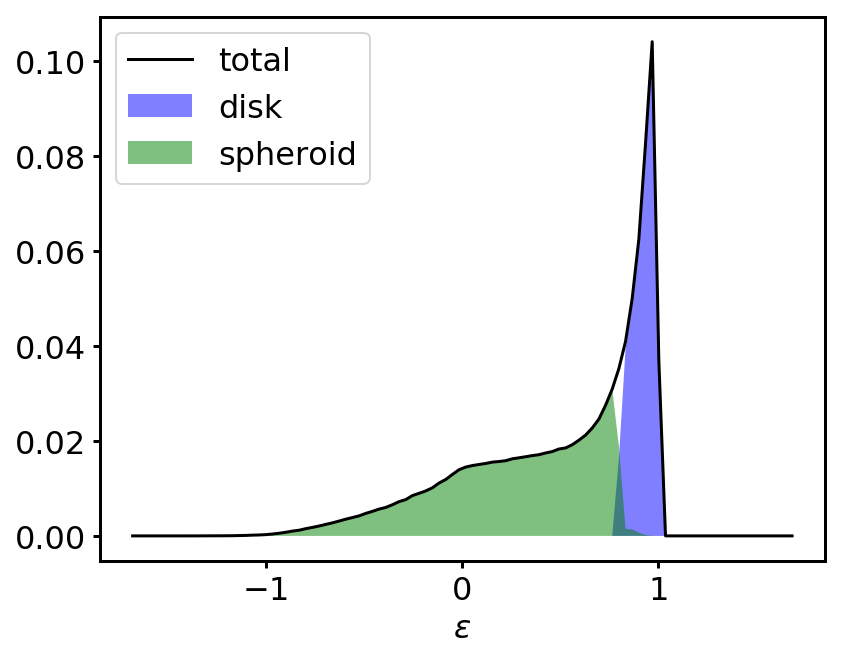

D/T ratio = 0.37928551585575626


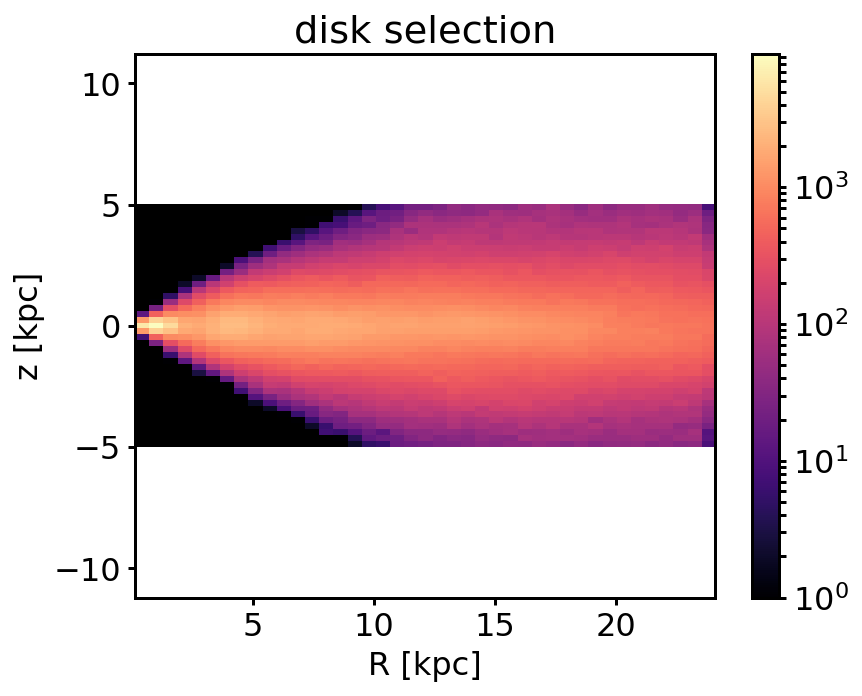

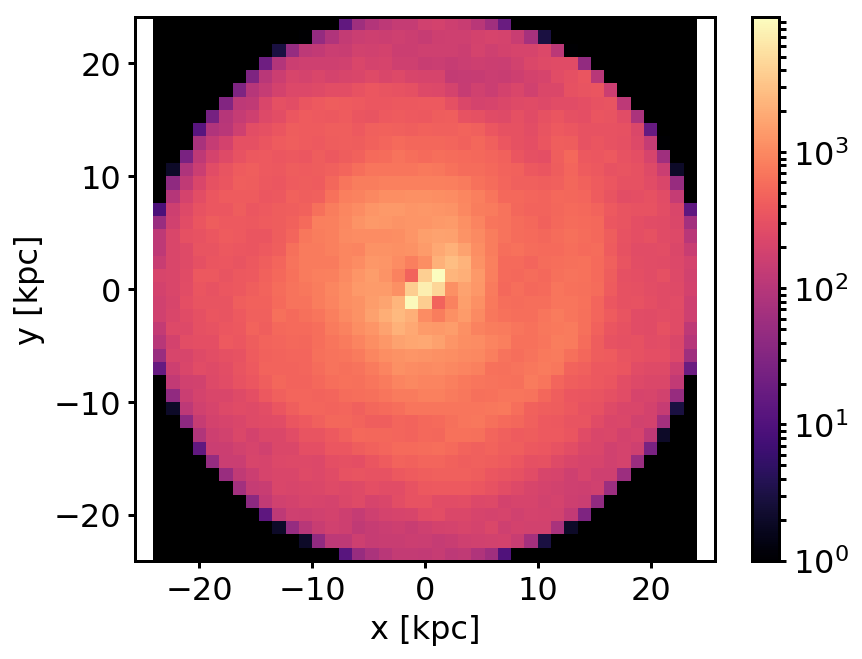

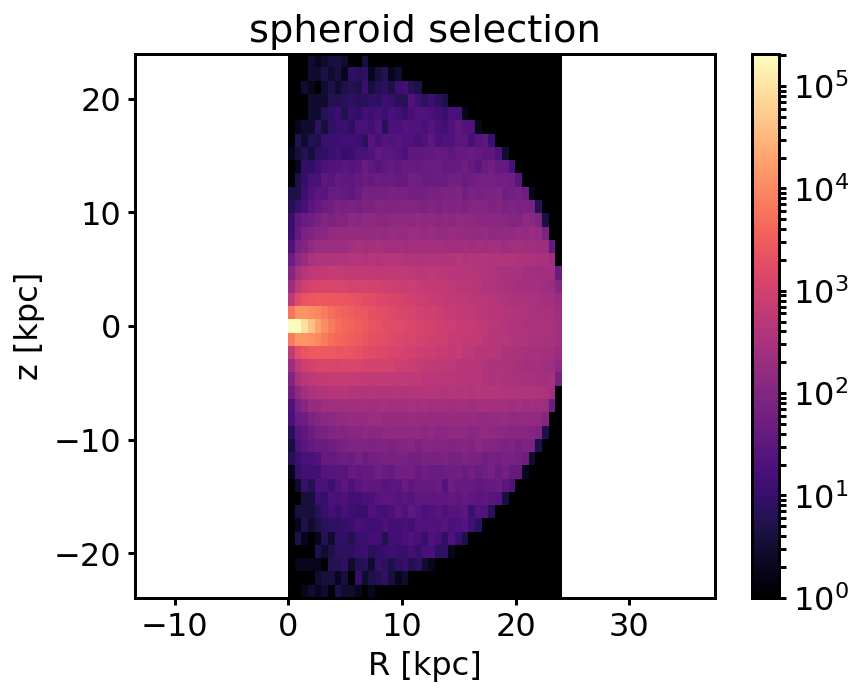

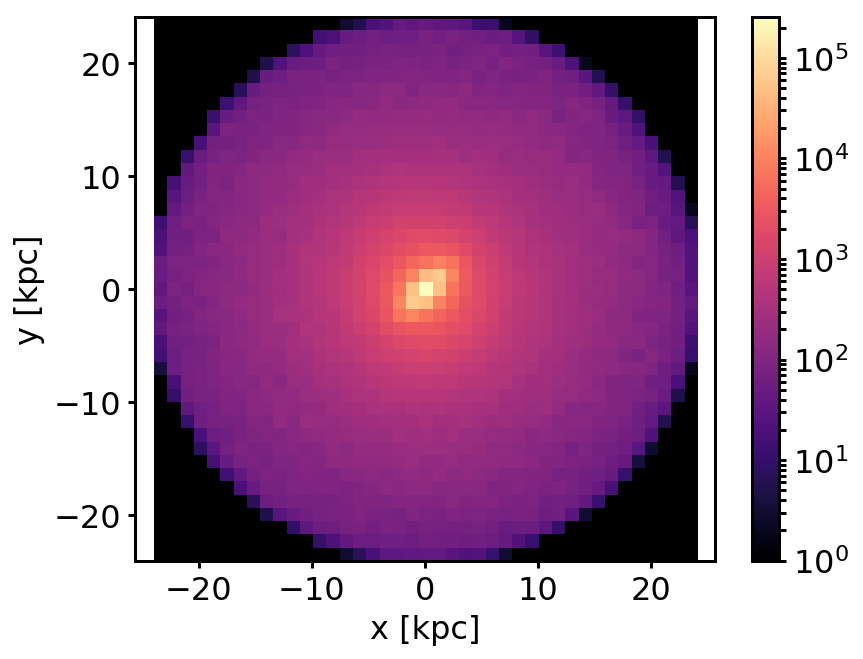

In [273]:
### get everything together somehow 

level = 4
startsnap = 127
endsnap = 128

#j = 0

for halo_number in [24]:  # range(1, 31):
    halodir = basedir+"halo_{0}/".format(halo_number)
    snappath = halodir+"output/"
    for snapnr in range(startsnap,endsnap,1):
        print("snapnr  : {0}".format(snapnr))
        print(datetime.datetime.now().time())
        try:
            s, sf = eat_snap_and_fof(level, halo_number, snapnr, snappath, loadonlytype=[1,2,3,4], 
            haloid=0, galradfac=0.1, verbose=True)    
        except KeyError:
            print('\n\n', snapnr, 'not read in.\n\n')
            continue
            
        try: 
            # Clean negative and zero values of gmet to avoid RuntimeErrors
            # later on (e.g. dividing by zero)
            s.data['gmet'] = np.maximum( s.data['gmet'], 1e-40 )
        except:
            continue

            
        Galrad = 1000. * s.galrad
        R0_kpc = 8.
        z0_kpc = 0.
        r0_kpc = R0_kpc
        dr_kpc = 0.5
        _REFR0_kpc = R0_kpc
        dR_kpc = 0.5
        dz_kpc = 0.5
        
        
        getIDs = True
        saveIDs = False
        if getIDs == True:
            
            decompobj = decomposition(machine = 'virgo', snapnr = snapnr, use_masses = False, use_n = True, galpyinputfile = None, galpyinputdata = None, have_galpy_potential = False)
            disk_ID, spheroid_ID = decompobj._decomp(circ_val = 0.8, plotter = True, savefig = False, include_zmax = True, zmax = 0.005, Gcosmo = 43.0071) 
            if saveIDs == True:
                np.savetxt(filedir + 'auriga/disk_spheroid_IDs_dec18/spheroid_IDs_snap_{}'.format(snapnr), (spheroid_ID))
                np.savetxt(filedir + 'auriga/disk_spheroid_IDs_dec18/disk_IDs_snap_{}'.format(snapnr), (disk_ID))

        else: 
            disk_ID = np.loadtxt(filedir + 'auriga/disk_spheroid_IDs_dec18/disk_IDs_snap_{}'.format(snapnr), unpack = True)
            spheroid_ID = np.loadtxt(filedir + 'auriga/disk_spheroid_IDs_dec18/spheroid_IDs_snap_{}'.format(snapnr), unpack = True)
        disk_to_total_ratio = len(disk_ID)/(len(disk_ID) + len(spheroid_ID))
        print('D/T ratio = {}'.format(disk_to_total_ratio))
        data_saved = (disk_ID, spheroid_ID)
        header = 'disk\tspheroid'
        formt = '%d'
        

        ## get data from simulations

        i_stars = np.where( (s.halo == 0) & (s.type == 4) & (s.r() <= s.galrad) & (s.r() > 0.) )
        #j = np.where( s.data[i_stars]['age'] > 0. )
        #i_stars = i_stars[j]
        i_spheroid = np.isin(s.id, spheroid_ID)
        i_disk = np.isin(s.id, disk_ID)
        i_dm = np.where( (s.halo == 0) & ((s.type == 1) + (s.type == 2) + (s.type == 3)) )
        
        galrad_kpc = 1000. * s.galrad
        
        # choice of R_kpc_data and z_kpc_data
        (x_kpc, y_kpc, z_kpc), (vx_kpc, vy_kpc, vz_kpc), rxyz_kpc, rxy_kpc = get_cartesian_vectors(s, sf, i_stars)
        (R_kpc, phi, z_kpc), (vR_kms, vphi_kms, vz_kms) = get_cylindrical_vectors(s, sf, i_stars)
        #print('istars', len(i_stars[0]), 'idisk', np.sum(i_disk), 'i_spher', np.sum(i_spheroid))

        (x_kpc_disk, y_kpc_disk, z_kpc_disk), (vx_kpc_disk, vy_kpc_disk, vz_kpc_disk), rxyz_kpc_disk, rxy_kpc_disk = get_cartesian_vectors(s, sf, i_disk)
        (R_kpc_disk, phi_disk, z_kpc_disk), (vR_kms_disk, vphi_kms_disk, vz_kms_disk) = get_cylindrical_vectors(s, sf, i_disk)
        
        (x_kpc_spher, y_kpc_spher, z_kpc_spher), (vx_kpc_spher, vy_kpc_spher, vz_kpc_spher), rxyz_kpc_spher, rxy_kpc_spher = get_cartesian_vectors(s, sf, i_spheroid)
        (R_kpc_spher, phi_spher, z_kpc_spher), (vR_kms_spher, vphi_kms_spher, vz_kms_spher) = get_cylindrical_vectors(s, sf, i_spheroid)

        
        #R_kpc_data = R_kpc[i_disk][i_stars]
        #z_kpc_data = z_kpc[i_disk][i_stars]
        r_kpc_spher = 1000. * s.r()[i_spheroid]
        #print(np.max(r_kpc))
        
        
        plt.hist2d(R_kpc_disk, z_kpc_disk, 41, norm=LogNorm())
        plt.colorbar()
        plt.axis('equal')
        plt.xlabel('R [kpc]')
        plt.ylabel('z [kpc]')
        plt.title('disk selection')
        plt.show()
        plt.hist2d(x_kpc_disk, y_kpc_disk, 41, norm=LogNorm())
        plt.xlabel('x [kpc]')
        plt.ylabel('y [kpc]')
        plt.axis('equal')
        plt.colorbar()
        plt.show()        
        
        plt.hist2d(R_kpc_spher, z_kpc_spher, 41, norm=LogNorm())
        plt.axis('equal')
        plt.xlabel('R [kpc]')
        plt.ylabel('z [kpc]')
        plt.colorbar()
        plt.title('spheroid selection')
        plt.show()
        plt.hist2d(x_kpc_spher, y_kpc_spher, 41, norm=LogNorm())
        plt.xlabel('x [kpc]')
        plt.ylabel('y [kpc]')
        plt.axis('equal')
        plt.colorbar()
        plt.show()
        
        
        
        M_disk_10Msun = s.mass[i_disk]
        break
        M_disk_tot_10Msun = np.sum(s.mass[i_disk])
        M_spher_10Msun = s.mass[i_spheroid]
        
        r_kpc_binned = np.linspace(np.min(r_kpc_spher), np.max(r_kpc_spher), 25)
        
        # try differential evolution method
        args = (R_kpc_disk, z_kpc_disk, M_disk_10Msun, dR_kpc, dz_kpc, _REFR0_kpc) 
        bounds = ((0., 20.), (0,20.))

        res = opt.differential_evolution( rel_rho_error_scipydifferentialevolution, bounds=bounds, args=args,strategy='best1bin', maxiter=1000,tol=0.01,atol=1e-7, disp=False)
        
        print(res)
        
        #print(r_kpc_binned)
        
        ## fit single parts
        res1 = MND(R_kpc_disk, z_kpc_disk, dR_kpc = 0.5, dz_kpc = 1., M_tot_disk_stars_10Msun = M_disk_tot_10Msun, M_diskstars_10Msun = M_disk_10Msun, R0_kpc = R0_kpc, snapnr = snapnr, z0_kpc = 0.)
        a_MND_kpc, b_MND_kpc, v_circ_MND = res1
        res = fit_dens_MND(R_kpc_disk, z_kpc_disk, dR_kpc = 0.5, dz_kpc = 1., M_tot_disk_stars_10Msun = M_disk_tot_10Msun, M_diskstars_10Msun = M_disk_10Msun, snapnr = snapnr)
        #a_MND_kpc, b_MND_kpc, v_circ_MND = MND(R_kpc_data[i_disk], z_kpc_data[i_disk], M_stars_tot_10Msun, R0_kpc, z0_kpc = 0.)
        a_HB_kpc, v_circ_HB = HB(M_spher_10Msun, r_kpc_spher, dr_kpc, r0_kpc, snapnr)
        v_circ_test1 = HB2(r_kpc_spher, M_spher_10Msun)
        v_circ_test2 = v_circ_HB_func_justr(r_kpc_binned, a_HB_kpc, np.sum(M_spher_10Msun))
        
        plt.plot(r_kpc_binned, v_circ_test1, 'r-', label = '$\sqrt{\\frac{GM(<r)}{r}}$')
        plt.plot(r_kpc_binned, v_circ_test2, 'g--', label = '$\\frac{\sqrt{GMr}}{r+a}$')
        plt.legend()
        plt.show()
        #rot curves
        
        
        #### GUESS OK WITH THE SPHEROID AND DISK FIT 
        
        r_kpc           = np.linspace(0, 1000. * s.galrad, 100)
        v_circ_disk     = v_circ_MND_ab(R_kpc=r_kpc, z_kpc=0., a_MND_kpc=a_MND_kpc, b_MND_kpc=b_MND_kpc, M_tot_10Msun=M_disk_tot_10Msun)
        v_circ_spheroid = v_circ_HB_func_justr(r_kpc, a_HB_kpc, np.sum(M_spher_10Msun))
        v_circ_tot      = v_circ_tot_func(r_kpc=r_kpc)
        v_circ_halo     = v_circ_NFW_func(r_kpc, v_circ_disk, v_circ_spheroid, v_circ_tot)

        
        v0_MND_kms = v_circ_MND_ab(R0_kpc, z0_kpc, a_MND_kpc=a_MND_kpc, b_MND_kpc=b_MND_kpc, M_tot_10Msun=M_disk_tot_10Msun)
        v0_HB_kms  = v_circ_HB_func_justr(R0_kpc, a_HB_kpc, np.sum(M_spher_10Msun))
        print(v0_MND_kms, v0_HB_kms)
        v0_circ_tot = v_circ_tot_func(r_kpc=R0_kpc)
        print('v0_circ_tot =', v0_circ_tot)
        
        # calculate very kinematkally cold particles in disk as data for the circ vel plot
        ID_disk_circ, ID_spher_circ = decompobj._decomp(circ_val = 0.95, include_zmax = True, zmax = 0.005, plotter = False, savefig = False, Gcosmo = 43.0071)
        i_disk_circ= np.isin(s.id, ID_disk_circ)
        (R_circ_stars_kpc, phi_circ_stars_, z_circ_stars_kpc), (vR_circ_stars_kms, vphi_circ_stars_kms, vz_circ_stars_kms) = get_cylindrical_vectors(s, sf, i_disk_circ)

        v_mean_data, v_std_data, R_bins_data = circvel_data(R_circ_stars_kpc, vphi_circ_stars_kms, Galrad, N = 25)
        
        fig, ax = plt.subplots()
        ax.errorbar(R_bins_data, v_mean_data, yerr = v_std_data, fmt = 'o', color = 'grey', label = 'data')
        ax.plot(r_kpc, v_circ_spheroid, 'g:', label = 'spheroid')
        ax.plot(r_kpc, v_circ_disk, 'b-.', label = 'disk')
        ax.plot(r_kpc, v_circ_halo, '--', color = 'orange', label = 'halo')
        ax.plot(r_kpc, v_circ_tot, 'k-', label = 'total')
        ax.set_xlabel('R [kpc]')
        ax.set_ylabel('$\mathrm{v}_{\mathrm{circ}}$ [km s$^{-1}$]')
        ax.legend()  
        fig.tight_layout()
        fig.savefig(plotdir + '/potential/best_fit_circular_velocity_via_formula_snap_{}.png'.format(snapnr), format = 'png', dpi = 300, bbox_inches = 'tight')
        plt.show()
        # calculate v_circ NFW
        #v_circ_NFW = v_circ_NFW_func(v_circ_MND, v_circ_HB, R0_kpc)
        #print(v_circ_NFW, v_circ_MND, v_circ_HB)
        #nn = 35
        #R0_ref = r_kpc[nn]
        #print(R0_ref)
        #v0_ref = v_circ_tot[nn]
        #n_NFW  = v_circ_halo[nn]** 2      / v_circ_tot[nn] **2
        #n_HB   = v_circ_spheroid[nn] ** 2 / v_circ_tot[nn] **2
        #n_MND  = v_circ_disk[nn] ** 2     / v_circ_tot[nn] **2
        #print(r_kpc[30], n_NFW + n_HB + n_MND )
        
        part_num = 100001
        
        i_dm, = np.where( (s.halo == 0) & (s.r() < s.galrad) & (s.r() > 0.) & ((s.type == 1) + (s.type == 2) + (s.type == 3) ))


        r_kpc_dm = 1000. * s.r()[i_dm]
        (x_kpc_dm, y_kp_dmc, z_kpc_dm), (vx_kpc_dm, vy_kpc_dm, vz_kpc_dm), rxyz_kpc_dm, rxy_kpc_dm = get_cartesian_vectors(s, sf, i_dm)
        (R_kpc_dm, phi_rad_dm, z_kpc_dm), (vR_kms_dm, vphi_kms_dm, vz_kms_dm) = get_cylindrical_vectors(s, sf, i_dm) 
        pot_kms2_dm = s.pot[i_dm]

        # draw random sample out of data
        try:
            rand_samp = np.array(random.sample(list(enumerate(pot_kms2_dm)), part_num))
            rand_ind = rand_samp[:,0].astype(int)
            pot_kms2_dm_data = rand_samp[:, 1]
            r_kpc_dm_data = r_kpc_dm[rand_ind]
            x_kpc_dm_data = x_kpc_dm[rand_ind]
            R_kpc_dm_data = R_kpc_dm[rand_ind]
            z_kpc_dm_data = z_kpc_dm[rand_ind]
        except ValueError:        
            pot_kms2_dm_data = pot_kms2_dm
            r_kpc_dm_data = r_kpc_dm
            x_kpc_dm_data = x_kpc_dm
            R_kpc_dm_data = R_kpc_dm
            z_kpc_dm_data = z_kpc_dm
        lower_floor = 1e-3
        bounds = ((5./6. * v0_circ_tot, 400.), #REF_V0_kms
                 (lower_floor, 400.)) #a_NFWH
        args = (a_MND_kpc, b_MND_kpc, a_HB_kpc, v0_MND_kms, v0_HB_kms, R_kpc_dm_data, z_kpc_dm_data, pot_kms2_dm_data, R0_kpc)

        print(args)
        plt.hist2d(x_kpc_dm_data, z_kpc_dm_data, 21, norm=LogNorm())
        plt.axis('equal')
        plt.title('{} random DM parts'.format(part_num))
        plt.xlabel('x [kpc]')
        plt.ylabel('z [kpc]')
        plt.colorbar()
        plt.show()
        #plt.hist2d(x_kpc_spher, y_kpc_spher, 21, norm=LogNorm())
        #plt.axis('equal')
        #plt.colorbar()
        #plt.show()

        #fitting:
        res = opt.differential_evolution(
                    rel_pot_error_scipydifferentialevolution,
                    bounds=bounds,
                    args=args,#, MND, HB, NFWH),
                    strategy='best1bin',
                    maxiter=1000,tol=0.01,atol=1e-7,
                    disp=False
                    )
        

        v0_kms_bestfit     = res.x[0]
        a_NFWH_kpc_bestfit = res.x[1]
    
        # make pot plot to see goodness of DM fit

        v0_NFWH_kms = np.sqrt(v0_kms_bestfit**2 - v0_HB_kms**2 - v0_MND_kms**2)
        print('halo comparison from different fitting methods: method 1: {}; method 2:{}'.format(v_circ_halo, v0_NFWH_kms))
        print('total velocity comparison from different fitting methods: method 1: {}; method 2:{}'.format(v_circ_tot, v0_kms_bestfit))


        n_NFWH = v0_NFWH_kms**2 / v0_kms_bestfit**2
        n_HB   = v0_HB_kms**2   / v0_kms_bestfit**2
        n_MND  = v0_MND_kms**2  / v0_kms_bestfit**2
        # setup potential (and check if parameters are physical):
        print('a_MND_kpc = {}\tb_MND_kpc = {}\ta_NFWH_kpc = {}\ta_HB_kpc = {}\tn_MND = {}\tn_NFWH = {}\tn_HB = {}\tR0_kpc'.format(a_MND_kpc, b_MND_kpc, a_NFWH_kpc_bestfit, a_HB_kpc, n_MND, n_NFWH, n_HB, R0_kpc))
        try:
            pot_galpy_model = setup_galpy_potential(a_MND_kpc, b_MND_kpc, a_NFWH_kpc_bestfit, a_HB_kpc, n_MND, n_NFWH, n_HB, R0_kpc) #
        except Exception as e:
            print("eroorrrr")


        pot_kms2_model = evaluatePotentials(pot_galpy_model,
                                       R_kpc_dm_data / R0_kpc,
                                       z_kpc_dm_data / R0_kpc) * (v0_kms_bestfit)**2

        
         
        plt.plot(r_kpc_dm_data, pot_kms2_dm_data, 'k.', label = 'data')
        plt.plot(r_kpc_dm_data, pot_kms2_model, 'y.', label = 'best fit', alpha = 0.3)
        plt.legend()
        plt.show()
        
        # save data 
        
        data_saved = np.array([snapnr, R0_kpc, v0_kms_bestfit, a_MND_kpc, b_MND_kpc, a_HB_kpc, a_NFWH_kpc_bestfit, v0_MND_kms, v0_HB_kms, v0_NFWH_kms])
        print(len(data_saved), np.shape(data_saved))
        print(data_saved)
        formt = '%3.12f'
        
        np.savetxt(filedir + 'potential/potential_params_dec18/pot_snap_{}'.format(snapnr), data_saved, fmt = formt)
        print('Snapshot = ', snapnr)
        print('v0_tot_kms at R0_kpc =', R0_kpc, ':', v0_kms_bestfit)
        print('Stellar Disk - a_MND_kpc =', a_MND_kpc, 'b_MND_kpc =', b_MND_kpc, 'v0_MND_kms =', v0_MND_kms)
        print('Stellar Spheroid - a_HB_kp c=', a_HB_kpc, 'v0_HB_kms =', v0_HB_kms)
        print('DM Halo - a_NFWH_kpc =', a_NFWH_kpc_bestfit, 'v0_NFWH_kms =', v0_NFWH_kms)



In [ ]:
v0_NFWH_kms = np.sqrt(v0_kms_bestfit**2 - v0_HB_kms**2 - v0_MND_kms**2)
print('v0_tot_kms at R0_kpc =', R0_kpc, ':', v0_kms_bestfit)
print('Stellar Disk - a_MND_kpc =', a_MND_kpc, 'b_MND_kpc =', b_MND_kpc, 'v0_MND_kms =', v0_MND_kms)
print('Stellar Spheroid - a_HB_kp c=', a_HB_kpc, 'v0_HB_kms =', v0_HB_kms)
print('DM Halo - a_NFWH_kpc =', a_NFWH_kpc_bestfit, 'v0_NFWH_kms =', v0_NFWH_kms)


In [ ]:
v0_NFWH_kms = np.sqrt(v0_kms_bestfit**2 - v0_HB_kms**2 - v0_MND_kms**2)
print('v0_tot_kms at R0_kpc =', R0_kpc, ':', v0_kms_bestfit)
print('Stellar Disk - a_MND_kpc:', a_MND_kpc, 'b_MND_kpc:', b_MND_kpc, 'v0_MND_kms:', v0_MND_kms)
print('Stellar Spheroid - a_HB_kpc:', a_HB_kpc, 'v0_HB_kms:', v0_HB_kms)
print('DM Halo - a_NFWH_kpc:', a_NFWH_kpc_bestfit, 'v0_NFWH_kms:', v0_NFWH_kms)


In [ ]:
n_NFW = v_circ_halo[35] ** 2 / v_circ_tot[35] **2
n_HB = v_circ_spheroid[35] ** 2 / v_circ_tot[35] **2
n_MND = v_circ_disk[35] ** 2 / v_circ_tot[35] **2
print(r_kpc[65], n_NFW + n_HB + n_MND )

In [ ]:

v_circ_NFW = v_circ_NFW_func(v_circ_MND, v_circ_HB, R0_kpc)
print(v_circ_NFW, v_circ_MND, v_circ_HB)
print(np.sqrt(v_circ_NFW**2 + v_circ_HB**2 + v_circ_MND**2))

In [ ]:
a_HB_kpc

In [ ]:
print(a_MND_kpc, b_MND_kpc, a_HB_kpc
     )

In [ ]:
plt.plot(r_kpc, v_circ_spheroid, 'k.', label = 'spheroid')
plt.plot(r_kpc, v_circ_disk, 'g-', label = 'disk')
plt.plot(r_kpc, v_circ_halo, 'r--', label = 'halo')
plt.plot(r_kpc, v_circ_tot, 'b-.', label = 'total')
plt.xlabel('R [kpc]')
plt.ylabel('$v_{circ} \ [km/s]$')
plt.legend()

In [ ]:
level = 4

j = 0
startsnap = 127
endsnap = 128
for halo_number in [24]:  # range(1, 31):
    halodir = basedir+"halo_{0}/".format(halo_number)
    snappath = halodir+"output/"
    for snapnr in range(startsnap,endsnap,1):
        #print("level   : {0}".format(level))
        #print("halo    : {0}".format(halo_number))
        print("snapnr  : {0}".format(snapnr))
        print(datetime.datetime.now().time())
        #print("basedir : {0}".format(basedir))
        #print("halodir : {0}".format(halodir))
        #print("snappath: {0}\n".format(snappath))
        try:
            s, sf = eat_snap_and_fof(level, halo_number, snapnr, snappath, loadonlytype=[1,2,3,4], 
            haloid=0, galradfac=0.1, verbose=False, rotate_disk=False, do_rotation=False, use_principal_axis=False) 
        except KeyError:
            print('\n\n', snapnr, 'not read in.\n\n')
            continue

            

In [ ]:
def potential_fit(maxr_Mpc, _REFR0_kpc = 8., mask_num = 2, part_num = 1501, \
                  v0_kms_init = 150., a_MND_kpc_init = 6., b_MND_kpc_init = 1., \
                  a_NFWH_kpc_init = 10., a_HB_kpc_init = 2., n_MND_init = 0.2, n_NFWH_init = 0.6, \
                  fitroutine = 'emcee', nwalkers = 50, nstep = 1000, \
                  comp_mask = None, MND = True, HB = True, NFWH = True, \
                  grav_rad_HB_kpc = 2., \
                  res_arr = [], plot = False, verbose = False):
    
    if comp_mask is None:   
        ### selection masks
        # select ALL particles belonging to the main galaxy within maxr
        if mask_num == 0:
            mask, = np.where( (s.halo == 0) & (s.r() < maxr_Mpc) & (s.r() > 0.) )
            parts_to_fit = 'all'
        # select GAS particles belonging to the main galaxy within maxr
        if mask_num == 1:
            mask, = np.where( (s.halo == 0) & (s.r() < maxr_Mpc) & (s.r() > 0.) & (s.type == 0) )
            parts_to_fit = 'gas'
        # select DM particles belonging to the main galaxy within maxr
        if mask_num == 2:
            mask, = np.where( (s.halo == 0) & (s.r() < maxr_Mpc) & (s.r() > 0.) & ((s.type == 1) + (s.type == 2) + (s.type == 3) ))
            parts_to_fit = 'DM'
        # select STAR particles belonging to the main galaxy within maxr
        if mask_num == 3:
            mask, = np.where( (s.halo == 0) & (s.r() < maxr_Mpc) & (s.r() > 0.) & (s.type == 4) )
            parts_to_fit = 'star'

        if verbose == True:
            print('The potential is fitted to ' + str(part_num) + ' random selected ' + parts_to_fit + ' particles.')

        # select data with mask
        r_kpc = 1000. * s.r()[mask]
        (R_kpc, phi_rad, z_kpc), (vR_kms, vphi_kms, vz_kms) = get_cylindrical_vectors(s, sf, mask) 
        pot_kms2 = s.pot[mask]

        # draw random sample out of data
        try:
            rand_samp = np.array(random.sample(list(enumerate(pot_kms2)), part_num))
            rand_ind = rand_samp[:,0].astype(int)
            pot_kms2_data = rand_samp[:, 1]
            r_kpc_data = r_kpc[rand_ind]
            R_kpc_data = R_kpc[rand_ind]
            z_kpc_data = z_kpc[rand_ind]
        except ValueError:        
            pot_kms2_data = pot_kms2
            r_kpc_data = r_kpc
            R_kpc_data = R_kpc
            z_kpc_data = z_kpc
            
    else:
        mask = comp_mask
        ## check that the right IDs are selected
        if (MND == 1) * (HB == 1) * (NFWH == 1):
            if np.sum((s.type[mask] == 1) + (s.type[mask] == 2) + (s.type[mask] == 3) + (s.type[mask] == 4)) != np.sum(mask):
                raise ValueError('IDs might be chosen wrong.')
        elif (MND == 1) * (HB == 1) * (NFWH == 0):
            if np.sum(np.where(s.type[mask] != 4)) != 0:
                raise ValueError('IDs might be chosen wrong.')            
        elif (MND == 1) * (HB == 0) * (NFWH == 1):
            if np.sum((s.type[mask] == 1) + (s.type[mask] == 2) + (s.type[mask] == 3) + (s.type[mask] == 4)) != np.sum(mask):
                raise ValueError('IDs might be chosen wrong.')            
        elif (MND == 0) * (HB == 1) * (NFWH == 1):
            if np.sum((s.type[mask] == 1) + (s.type[mask] == 2) + (s.type[mask] == 3) + (s.type[mask] == 4)) != np.sum(mask):
                raise ValueError('IDs might be chosen wrong.')           
        elif (MND == 1) * (HB == 0) * (NFWH == 0):
            if np.sum(np.where(s.type[mask] != 4)) != 0:
                raise ValueError('IDs might be chosen wrong.')
        elif (MND == 0) * (HB == 1) * (NFWH == 0):
            if np.sum(np.where(s.type[mask] != 4)) != 0:
                raise ValueError('IDs might be chosen wrong.')          
        elif (MND == 0) * (HB == 0) * (NFWH == 1):
            if np.sum((s.type[mask] == 1) + (s.type[mask] == 2) + (s.type[mask] == 3)) != np.sum(mask):
                raise ValueError('IDs might be chosen wrong.')
        
        if (MND == 0) * (HB == 1) * (NFWH == 0):
            mask = np.where(((1000. * s.r()[comp_mask]) < grav_rad_HB_kpc))
        
        r_kpc = 1000. * s.r()[mask]
        (R_kpc, phi_rad, z_kpc), (vR_kms, vphi_kms, vz_kms) = get_cylindrical_vectors(s, sf, mask) 
        pot_kms2 = s.pot[mask] 
        pot_kms2_data = pot_kms2
        r_kpc_data = r_kpc
        R_kpc_data = R_kpc
        z_kpc_data = z_kpc
                    

    if fitroutine == 'emcee': # maybe implement diff ev but not now
        # _____prepare MCMC_____
        ndim, nwalkers, nstep = 7, nwalkers, nstep

        # initial values for fit:
        # init values as input of function
        initial_guess = np.array([v0_kms_init, a_MND_kpc_init, b_MND_kpc_init, a_NFWH_kpc_init, \
                                  a_HB_kpc_init, n_MND_init, n_NFWH_init])
        initial_guess_width = np.fabs(0.2 * initial_guess)
        p0 = np.array([np.random.randn(ndim) * np.array(initial_guess_width) + initial_guess \
                                                      for i in range(nwalkers)])
        # fiitting boundaries:
        boundaries = np.array([[0.,np.inf],[0.,np.inf],[0.,np.inf],[0.,np.inf],[0.,np.inf],[0.,1.],[0.,1.]])
        for pp in range(ndim):
            p0[(p0[:,pp] < boundaries[pp,0]),pp] = initial_guess[pp] + np.random.uniform() * 0.1
            p0[(p0[:,pp] > boundaries[pp,1]),pp] = initial_guess[pp] - np.random.uniform() * 0.1

        # _____run MCMC_____
        sampler = emcee.EnsembleSampler(nwalkers, ndim,
                                       lnprob_MCMC,
                                       args = [R_kpc_data, z_kpc_data, pot_kms2_data, _REFR0_kpc])
        sampler.run_mcmc(p0, nstep)

        # result:
        burnin = int(nwalkers / 2.) # check what this is used for. #1000
        final_samples = sampler.chain[:, burnin:, :].reshape((-1, ndim))
        chain_samples = sampler.chain

        median = np.median(final_samples,axis=0)
        std = np.std(final_samples,axis=0)

        v0_kms_bestfit     = median[0]
        a_MND_kpc_bestfit  = median[1]
        b_MND_kpc_bestfit  = median[2]
        a_NFWH_kpc_bestfit = median[3]
        a_HB_kpc_bestfit   = median[4]
        n_MND_bestfit      = median[5]
        n_NFWH_bestfit     = median[6]
        n_HB_bestfit       = 1. - (n_MND_bestfit + n_NFWH_bestfit)

        v0_kms_bestfit_err     = std[0]
        a_MND_kpc_bestfit_err  = std[1]
        b_MND_kpc_bestfit_err  = std[2]
        a_NFWH_kpc_bestfit_err = std[3]
        a_HB_kpc_bestfit_err   = std[4]
        n_MND_bestfit_err      = std[5]
        n_NFWH_bestfit_err     = std[6]
        n_HB_bestfit_err       = (n_MND_bestfit_err + n_NFWH_bestfit_err)

        
        
        # save potential parameters with errors and snapnr:
        pot_bestfit = np.array([v0_kms_bestfit, v0_kms_bestfit_err, a_MND_kpc_bestfit, a_MND_kpc_bestfit_err, \
                            b_MND_kpc_bestfit, b_MND_kpc_bestfit_err, a_NFWH_kpc_bestfit, a_NFWH_kpc_bestfit_err, \
                            a_HB_kpc_bestfit, a_HB_kpc_bestfit_err, n_MND_bestfit, n_MND_bestfit_err, \
                            n_NFWH_bestfit, n_NFWH_bestfit_err, n_HB_bestfit, n_HB_bestfit_err])
        
        res_arr = np.append(res_arr, pot_bestfit)
    
    elif fitroutine == 'diffev':
        lower_floor = 1e-3
        bounds = ((lower_floor,400.), #vcirc
                  (lower_floor,500.), #a_MND
                  (lower_floor,100.), #b_MND
                  (lower_floor,500.), #a_NFWH
                  (lower_floor,500.), #a_HB
                  (0., 1.), #n_MND
                  (0., 1.)) #n_NFWH

        #fitting:
        res = opt.differential_evolution(
                    rel_pot_error_scipydifferentialevolution,
                    bounds=bounds,
                    args=(R_kpc_data,z_kpc_data,pot_kms2_data, _REFR0_kpc, MND, HB, NFWH),
                    strategy='best1bin',
                    maxiter=1000,tol=0.01,atol=1e-7,
                    disp=False
                    )
        
        v0_kms_bestfit     = res.x[0]
        a_MND_kpc_bestfit  = res.x[1]
        b_MND_kpc_bestfit  = res.x[2]
        a_NFWH_kpc_bestfit = res.x[3]
        a_HB_kpc_bestfit   = res.x[4]
        n_MND_bestfit      = res.x[5]
        n_NFWH_bestfit     = res.x[6]
        n_HB_bestfit       = 1. - (n_MND_bestfit + n_NFWH_bestfit)


        pot_bestfit = np.array([v0_kms_bestfit, a_MND_kpc_bestfit, b_MND_kpc_bestfit, a_NFWH_kpc_bestfit, \
                            a_HB_kpc_bestfit, n_MND_bestfit, n_NFWH_bestfit, n_HB_bestfit])
        res_arr = np.append(res_arr, pot_bestfit)

   
    
    # generate potential measurements:
    if plot == True:
        pot_galpy_bestfit = setup_galpy_potential(a_MND_kpc_bestfit,b_MND_kpc_bestfit,
                                               a_NFWH_kpc_bestfit,a_HB_kpc_bestfit,
                                               n_MND_bestfit,n_NFWH_bestfit,n_HB_bestfit, _REFR0_kpc)
        pot_kms2_bestfit = evaluatePotentials(pot_galpy_bestfit,
                                           R_kpc_data/_REFR0_kpc,
                                           z_kpc_data/_REFR0_kpc) * (v0_kms_bestfit)**2
                               
        plotDensities(pot_galpy_bestfit,rmin=0.1,zmax=0.25,zmin=-0.25,nrs=101,nzs=101)
        plt.show()
                               
                               
    if fitroutine == 'emcee':
        sampler.reset()

                               
    return res_arr

In [ ]:
fitroutine = 'diffev' #emcee
dopotfit = False
if dopotfit == True:
#### path = /hits/universe/GigaGalaxy/level4_MHD/halo_24/output/*
    level = 4

    j = 0
    startsnap = 60
    endsnap = 128
    for halo_number in [24]:  # range(1, 31):
        halodir = basedir+"halo_{0}/".format(halo_number)
        snappath = halodir+"output/"
        for snapnr in range(startsnap,endsnap,1):
            #print("level   : {0}".format(level))
            #print("halo    : {0}".format(halo_number))
            print("snapnr  : {0}".format(snapnr))
            print(datetime.datetime.now().time())
            #print("basedir : {0}".format(basedir))
            #print("halodir : {0}".format(halodir))
            #print("snappath: {0}\n".format(snappath))
            try:
                s, sf = eat_snap_and_fof(level, halo_number, snapnr, snappath, loadonlytype=[1,2,3], 
                haloid=0, galradfac=0.1, verbose=False, rotate_disk=False, do_rotation=False, use_principal_axis=False) 
            except KeyError:
                print('\n\n', snapnr, 'not read in.\n\n')
                continue

            if fitroutine == 'emcee':
                file = filedir + 'potential_params_emcee_10000_with_initeqbestfit.txt'
                savefile = filedir + 'potential_params_emcee_10000_with_initeqbestfit_safetyfile.txt'
                firstline = "#snapnr\tv0_kms_bestfit\tv0_kms_bestfit_err\ta_MND_kpc_bestfit\ta_MND_kpc_bestfit_err\tb_MND_kpc_bestfit\tb_MND_kpc_bestfit_err\ta_NFWH_kpc_bestfit\ta_NFWH_kpc_bestfit_err\ta_HB_kpc_bestfit\ta_HB_kpc_bestfit_err\tn_MND_bestfit\tn_MND_bestfit_err\tn_NFWH_bestfit\tn_NFWH_bestfit_err\tn_HB_bestfit\tn_HB_bestfit_err\n"
                if j == 0:
                    res_arr = potential_fit(maxr_Mpc = 2. * s.galrad, part_num = 175000, nstep = 2000)
                    res_arr = np.insert(res_arr, 0, snapnr)
                    j +=1
                    v0_kms_bestfit      = res_arr[int(17 * (snapnr - startsnap )) + 1]
                    a_MND_kpc_bestfit   = res_arr[int(17 * (snapnr - startsnap )) + 3]
                    b_MND_kpc_bestfit   = res_arr[int(17 * (snapnr - startsnap )) + 5]
                    a_NFWH_kpc_bestfit  = res_arr[int(17 * (snapnr - startsnap )) + 7]
                    a_HB_kpc_bestfit    = res_arr[int(17 * (snapnr - startsnap )) + 9]
                    n_MND_bestfit       = res_arr[int(17 * (snapnr - startsnap )) + 11]
                    n_NFWH_bestfit      = res_arr[int(17 * (snapnr - startsnap )) + 13]
                    n_HB_bestfit        = res_arr[int(17 * (snapnr - startsnap )) + 15]


                else:
                    res_arr = potential_fit(maxr_Mpc = 2. * s.galrad, part_num = 175000, nstep = 2000, res_arr=res_arr, \
                                            v0_kms_init = v0_kms_bestfit, a_MND_kpc_init = a_MND_kpc_bestfit, \
                                            b_MND_kpc_init = b_MND_kpc_bestfit, a_NFWH_kpc_init = a_NFWH_kpc_bestfit, \
                                            a_HB_kpc_init = a_HB_kpc_bestfit, n_MND_init = n_MND_bestfit, \
                                            n_NFWH_init = n_NFWH_bestfit)
                    res_arr = np.insert(res_arr, 17 * (snapnr - startsnap ), snapnr)

                    v0_kms_bestfit      = res_arr[int(17 * (snapnr - startsnap )) + 1]
                    a_MND_kpc_bestfit   = res_arr[int(17 * (snapnr - startsnap )) + 3]
                    b_MND_kpc_bestfit   = res_arr[int(17 * (snapnr - startsnap )) + 5]
                    a_NFWH_kpc_bestfit  = res_arr[int(17 * (snapnr - startsnap )) + 7]
                    a_HB_kpc_bestfit    = res_arr[int(17 * (snapnr - startsnap )) + 9]
                    n_MND_bestfit       = res_arr[int(17 * (snapnr - startsnap )) + 11]
                    n_NFWH_bestfit      = res_arr[int(17 * (snapnr - startsnap )) + 13]
                    n_HB_bestfit        = res_arr[int(17 * (snapnr - startsnap )) + 15]

                #print(res_arr)

                if (snapnr % 10) ==0:
                    f = open(file, 'w') # existing file will be overwritten
                    f.write(firstline)
                    f.close()
                    f = open(file,'ab') # open file in append and binary mode to make savetxt work and append
                    np.savetxt(f,res_arr)
                    f.close()
                    
            elif fitroutine == 'diffev':
                file = filedir + 'potential_params_diffev.txt'
                savefile = filedir + 'potential_params_diffev_safetyfile.txt'
                firstline = "#snapnr\tv0_kms_bestfit\ta_MND_kpc_bestfit\tb_MND_kpc_bestfit\ta_NFWH_kpc_bestfit\ta_HB_kpc_bestfit\tn_MND_bestfit\tn_NFWH_bestfit\tn_HB_bestfit\n"
                if j == 0:
                    res_arr = potential_fit(maxr_Mpc = 2. * s.galrad, fitroutine = 'diffev')
                    res_arr = np.insert(res_arr, 0, snapnr)
                    j +=1
                    '''
                    v0_kms_bestfit      = res_arr[int(9 * (snapnr - startsnap )) + 1]
                    a_MND_kpc_bestfit   = res_arr[int(9 * (snapnr - startsnap )) + 2]
                    b_MND_kpc_bestfit   = res_arr[int(9 * (snapnr - startsnap )) + 3]
                    a_NFWH_kpc_bestfit  = res_arr[int(9 * (snapnr - startsnap )) + 4]
                    a_HB_kpc_bestfit    = res_arr[int(9 * (snapnr - startsnap )) + 5]
                    n_MND_bestfit       = res_arr[int(9 * (snapnr - startsnap )) + 6]
                    n_NFWH_bestfit      = res_arr[int(9 * (snapnr - startsnap )) + 7]
                    n_HB_bestfit        = res_arr[int(9 * (snapnr - startsnap )) + 8]
                    '''
                    res_len = len(res_arr)

                else:
                    res_arr = potential_fit(maxr_Mpc = 2. * s.galrad, res_arr=res_arr, fitroutine = 'diffev')
                    res_arr = np.insert(res_arr, res_len * (snapnr - startsnap ), snapnr)

                    '''
                    v0_kms_bestfit      = res_arr[int(9 * (snapnr - startsnap )) + 1]
                    a_MND_kpc_bestfit   = res_arr[int(9 * (snapnr - startsnap )) + 2]
                    b_MND_kpc_bestfit   = res_arr[int(9 * (snapnr - startsnap )) + 3]
                    a_NFWH_kpc_bestfit  = res_arr[int(9 * (snapnr - startsnap )) + 4]
                    a_HB_kpc_bestfit    = res_arr[int(9 * (snapnr - startsnap )) + 5]
                    n_MND_bestfit       = res_arr[int(9 * (snapnr - startsnap )) + 6]
                    n_NFWH_bestfit      = res_arr[int(9 * (snapnr - startsnap )) + 7]
                    n_HB_bestfit        = res_arr[int(9 * (snapnr - startsnap )) + 8]
                    '''
                #print(res_arr)

                if (snapnr % 10) ==0:
                    f = open(file, 'w') # existing file will be overwritten
                    f.write(firstline)
                    f.close()
                    f = open(file,'ab') # open file in append and binary mode to make savetxt work and append
                    np.savetxt(f,res_arr)
                    f.close()
    if fitroutine == 'emcee':     
        res_arr = res_arr.reshape(endsnap-startsnap,17) # instead of 4 number of simulations fitted
    elif fitroutine == 'diffev':
        res_arr = res_arr.reshape(endsnap-startsnap,9)
            

    np.savetxt(savefile, res_arr)

    f = open(file, 'w') # existing file will be overwritten
    f.write(firstline)
    f.close()
    f = open(file,'ab') # open file in append and binary mode to make savetxt work and append
    np.savetxt(f,res_arr)
    f.close()


In [ ]:
### fit disk stars to MND pot, and bulge stars the HB pot; keep'em fixed ###
### save their params for every snapshot since 60 or 70 ###
### then have varying potential for halo (DM particles) ###
level = 4

fitroutine = 'diffev'

jdisk  = 0
jbulge = 0
jhalo  = 0

startsnap = 60
endsnap = 128
for halo_number in [24]:  # range(1, 31):
    halodir = basedir + "halo_{0}/".format(halo_number)
    snappath = halodir + "output/"
    
    for snapnr in range(startsnap, endsnap, 1):
        print("snapnr  : {0}".format(snapnr))
        s, sf = eat_snap_and_fof(level, halo_number, snapnr, snappath, loadonlytype=[4], 
            haloid=0, galradfac=0.1, verbose=True) 

        # Clean negative and zero values of gmet to avoid RuntimeErrors
        # later on (e.g. dividing by zero)
        s.data['gmet'] = np.maximum( s.data['gmet'], 1e-40 )
    
        print('start decomposition')
        disk_ID, spheroid_ID, bulge_ID, halo_ID = decomp(s, r_cutoff_Mpc = s.galrad)
        
        idisk = np.isin(s.id, disk_ID)
        ibulge = np.isin(s.id, bulge_ID)
        ispheroid = np.isin(s.id, spheroid_ID)
        ihalo = np.isin(s.id, halo_ID)        
        ihalo = np.where((s.type == 1) + (s.type == 2) + (s.type == 3))
        ## fit disk
        '''
        print('start disk fit')
        if fitroutine == 'diffev':
            file_disk = filedir + 'potential_params_MND_diffev.txt'
            savefile_disk = filedir + 'potential_params_MND_diffev_safetyfile.txt'
            firstline_disk = "#snapnr\tv0_kms_bestfit\ta_MND_kpc_bestfit\tb_MND_kpc_bestfit\ta_NFWH_kpc_bestfit\ta_HB_kpc_bestfit\tn_MND_bestfit\tn_NFWH_bestfit\tn_HB_bestfit\n"
            if jdisk == 0:
                res_arr_disk = potential_fit(maxr_Mpc = 2. * s.galrad, comp_mask = idisk, MND = True, HB = False, NFWH = False, fitroutine = 'diffev')
                res_arr_disk = np.insert(res_arr_disk, 0, snapnr)
                jdisk +=1
                res_len_disk = len(res_arr_disk)
            else:
                res_arr_disk = potential_fit(maxr_Mpc = 2. * s.galrad, comp_mask = idisk, MND = True, HB = False, NFWH = False, res_arr=res_arr_disk, fitroutine = 'diffev', plot= True)
                res_arr_disk = np.insert(res_arr_disk, res_len_disk * (snapnr - startsnap ), snapnr)
        '''
        
        
        ## fit bulge 
        print('start bulge fit')
        # according to B&T 2008 p71 the gravitational radius of the Hernquist profile = 6a; 
        # a is one fitting component
        # take i_spheroid for first fit, for 2nd and further fit tries set as radius for stars to be fitted 6 * a_HB of the prior fit        
        if fitroutine == 'diffev':
            file_bulge = filedir + 'potential_params_HB_diffev_rg6a.txt'
            savefile_bulge = filedir + 'potential_params_HB_diffev_safetyfile_rg6a.txt'
            firstline_bulge = "#snapnr\tv0_kms_bestfit\ta_MND_kpc_bestfit\tb_MND_kpc_bestfit\ta_NFWH_kpc_bestfit\ta_HB_kpc_bestfit\tn_MND_bestfit\tn_NFWH_bestfit\tn_HB_bestfit\n"
            if jbulge == 0:
                res_arr_bulge = potential_fit(maxr_Mpc = s.galrad, comp_mask = ispheroid, MND = False, HB = True, NFWH = False, grav_rad_HB_kpc = s.galrad, fitroutine = 'diffev')
                res_arr_bulge = np.insert(res_arr_bulge, 0, snapnr)
                jbulge +=1
                res_len_bulge = len(res_arr_bulge)
                a_HB_kpc_bestfit = res_arr_bulge[int(res_len_bulge * (snapnr - startsnap )) + 5]
            else:
                res_arr_bulge = potential_fit(maxr_Mpc = s.galrad, comp_mask = ispheroid, MND = False, HB = True, NFWH = False, grav_rad_HB_kpc = 6. * a_HB_kpc_bestfit, res_arr=res_arr_bulge, fitroutine = 'diffev', plot = True)
                res_arr_bulge = np.insert(res_arr_bulge, res_len_bulge * (snapnr - startsnap ), snapnr)
                a_HB_kpc_bestfit = res_arr_bulge[int(res_len_bulge * (snapnr - startsnap )) + 5]

        
        
        
        ## fit halo (variable)
print('save everything')        
if fitroutine == 'diffev':
    '''
    res_arr_disk = res_arr_disk.reshape(endsnap-startsnap,res_len_disk)
    np.savetxt(savefile_disk, res_arr_disk)

    f = open(file_disk, 'w') # existing file will be overwritten
    f.write(firstline_disk)
    f.close()
    f = open(file_disk,'ab') # open file in append and binary mode to make savetxt work and append
    np.savetxt(f,res_arr_disk)
    f.close()
    '''
    
    res_arr_bulge = res_arr_bulge.reshape(endsnap-startsnap,res_len_bulge)
    np.savetxt(savefile_bulge, res_arr_bulge)

    f = open(file_bulge, 'w') # existing file will be overwritten
    f.write(firstline_bulge)
    f.close()
    f = open(file_bulge,'ab') # open file in append and binary mode to make savetxt work and append
    np.savetxt(f,res_arr_bulge)
    f.close()

In [ ]:
diskfile = filedir + 'potential_params_MND_diffev.txt'
bulgefile = filedir + 'potential_params_HB_diffev.txt'
bulgefile6a = filedir + 'potential_params_HB_diffev_rg6a.txt'
v0_kms_disk, a_MND_kpc, b_MND_kpc = np.loadtxt(diskfile, usecols = (1,2,3), unpack=True)
v0_kms_bulge, a_HB_kpc = np.loadtxt(bulgefile, usecols=(1,5), unpack=True)
v0_kms_bulge6a, a_HB_kpc6a = np.loadtxt(bulgefile6a, usecols=(1,5), unpack=True)


snapnr = np.arange(60,128,1)



labelsdisk = ["v0_kms","a_MND_kpc","b_MND_kpc"]
labelsbulge = ["v0_kms", "a_HB_kpc"]

paramsdisk = np.vstack([v0_kms_disk, a_MND_kpc, b_MND_kpc])
paramsbulge = np.vstack([v0_kms_bulge, a_HB_kpc])
paramsbulge6a = np.vstack([v0_kms_bulge6a, a_HB_kpc6a])

ndim = 3
f, axes = plt.subplots(ndim, 1, figsize=(12,6))
for ii in range(ndim):
    axes[ii].set_xlim(59,131)
    axes[ii].set_ylabel(labelsdisk[ii])
    if ii == (ndim - 1):
        axes[ii].set_xlabel('Snapshot number')
    #axes[ii,1].set_ylabel(labels[ii])
    axes[ii].plot(snapnr, paramsdisk[ii], 'k.')    
    #axes[ii,1].set_yscale('log', nonposy="clip")
    #zz = np.polyfit(snapnr[4:], params[ii][4:], jj, w = (1./params_err[ii][4:]), full = True)
    #p = np.poly1d(zz[0])
    #xp = np.linspace(np.min(snapnr[4:]), np.max(snapnr[4:]), int (np.max(snapnr[4:]) - np.min(snapnr[4:])))
    #axes[ii].plot(xp, p(xp), 'g-', label = str(jj ) + ' polynoms')
    #axes[ii].legend()
    #fitted_params.append(p(xp))
f.tight_layout()

#fitted_params = np.array(fitted_params)
#keep normalization of n_vals"
#normfac = (fitted_params[5] + fitted_params[6] + fitted_params[7])
#fitted_params[5] = fitted_params[5] / normfac
#fitted_params[6] = fitted_params[6] / normfac
#fitted_params[7] = fitted_params[7] / normfac

ndim = 4
f, axes = plt.subplots(ndim, 1, figsize=(12,6))
for ii in range(ndim):
    
    if ii == (ndim - 1):
        axes[ii].set_xlim(59,131)
        axes[ii].set_ylabel(labelsbulge[ii-2])
        axes[ii].set_xlabel('Snapshot number')
        axes[ii].plot(snapnr[14:], paramsbulge[ii-2][14:], 'r.', label = 'grav radius = a_HB') 
        axes[ii].plot(snapnr[14:], paramsbulge6a[ii-2][14:], 'g.', label = 'grav radius = 6 * a_HB' )
    elif ii == (ndim - 2):
        axes[ii].set_xlim(59,131)
        axes[ii].set_ylabel(labelsbulge[ii-1])
        axes[ii].set_xlabel('Snapshot number')
        axes[ii].plot(snapnr[2:], paramsbulge[ii-1][2:], 'r.', label = 'grav radius = a_HB') 
        axes[ii].plot(snapnr[2:], paramsbulge6a[ii-1][2:], 'g.', label = 'grav radius = 6 * a_HB' )
    #axes[ii,1].set_ylabel(labels[ii])
    else:
        axes[ii].set_ylabel(labelsbulge[ii])
        axes[ii].set_xlim(59,131)
        axes[ii].plot(snapnr, paramsbulge[ii], 'r.', label = 'grav radius = a_HB') 
        axes[ii].plot(snapnr, paramsbulge6a[ii], 'g.', label = 'grav radius = 6 * a_HB' ) 
    
    #axes[ii,1].set_yscale('log', nonposy="clip")
    #zz = np.polyfit(snapnr[4:], params[ii][4:], jj, w = (1./params_err[ii][4:]), full = True)
    #p = np.poly1d(zz[0])
    #xp = np.linspace(np.min(snapnr[4:]), np.max(snapnr[4:]), int (np.max(snapnr[4:]) - np.min(snapnr[4:])))
    #axes[ii].plot(xp, p(xp), 'g-', label = str(jj ) + ' polynoms')
    axes[ii].legend()
    #fitted_params.append(p(xp))
f.tight_layout()

#fitted_params.reshape(int(len(fitted_params)/7),7)
    #display(f)
#f.savefig(plotdir + 'parameter_evolution_lin_'+ str(jj)+'polynomsfit.png', dpi = 300, bbox_inches = 'tight', format = 'png')

In [ ]:
for i in range(len(snapnr)):
    diskpot = MiyamotoNagaiPotential(a_MND_kpc[i], b_MND_kpc[i], normalize = 0.5)
    bulgepot = HernquistPotential(a_HB_kpc[i], normalize = 0.5)
    pot = [diskpot, bulgepot]
    plotDensities(pot,rmin=0.1,zmax=0.25,zmin=-0.25,nrs=101,nzs=101, log = True )
    plt.text(1.2, 0.2, 'Snap ' + str(i+60), color = 'red')#, horizontalalignment='center',verticalalignment='center')#, transform=ax.transAxes)
    plt.show()


In [ ]:
np.sum(s.mass[ibulge])

In [ ]:
np.sum(s.mass[idisk])